# Introduction to Data Mining & Machine Learning


Today we will cover the basics of [Scikit-Learn](http://scikit-learn.org), a popular package containing a collection of tools for machine learning written in Python. 

For Scikit-Learn's own introduction, see [http://scikit-learn.org/stable/tutorial/basic/tutorial.html#](http://scikit-learn.org/stable/tutorial/basic/tutorial.html#).

In general, we are interested in taking a set of $n$ samples of data and then predicting properties of unknown data.

In the simplest case the data will be one dimensional, but generally we will be dealing with multi-dimensional data.

We can break machine learning into a few distinct categories. Common to all of these is the concept of **training sets** and **test sets**, which is just like they sound: training data will be used to make predictions about the test data.  

**The categories of maching learning are:** 
* [Supervised learning](https://en.wikipedia.org/wiki/Supervised_learning), where our training set has "labels".  The 
[Scikit-Learn tools for supervised learning](http://scikit-learn.org/stable/supervised_learning.html#supervised-learning) can further be broken into two subcategories:
    * [classification](https://en.wikipedia.org/wiki/Statistical_classification): where the data can be separated into two or more "classes" and we can use the labels from the training data to predict the labels for the test data.
    * [regression](https://en.wikipedia.org/wiki/Regression_analysis): where instead of having training data with discrete labels, the "truth" is a continuous property and we are trying to predict the values of that property for the test data.
    
    
* [Unsupervised learning](https://en.wikipedia.org/wiki/Unsupervised_learning), where our training set does not have labels, yet we would like to empirically determine something about the data.  The [Scikit-Learn tools for unsupervised learning](http://scikit-learn.org/stable/unsupervised_learning.html#unsupervised-learning) include those that 
    * can help determine if the data can be represented as belonging to distinct groups ([clustering](https://en.wikipedia.org/wiki/Cluster_analysis)).
    * can determine the distribution of the data within the parameter space ([density estimation](https://en.wikipedia.org/wiki/Density_estimation)).
    * can better visualize the data (and hope to learn something in so doing) by projecting a high-dimensional space down to 2-3 dimensions ([dimensionality reduction](https://en.wikipedia.org/wiki/Dimensionality_reduction)).
    
    
This lecture is a broad overview. The rest of the class from here on will then deal with them in some detail.
    

## About Scikit-Learn

Let's get to grips with using Scikit-Learn for machine learning/data mining by taking a look at two very simple machine learning tasks.

The first is a **classification** task: the figure shows a collection of two-dimensional data, colored according to two different class labels. We wish to determine a classification algorithm that can be used to draw a dividing boundary between the two clusters of points:

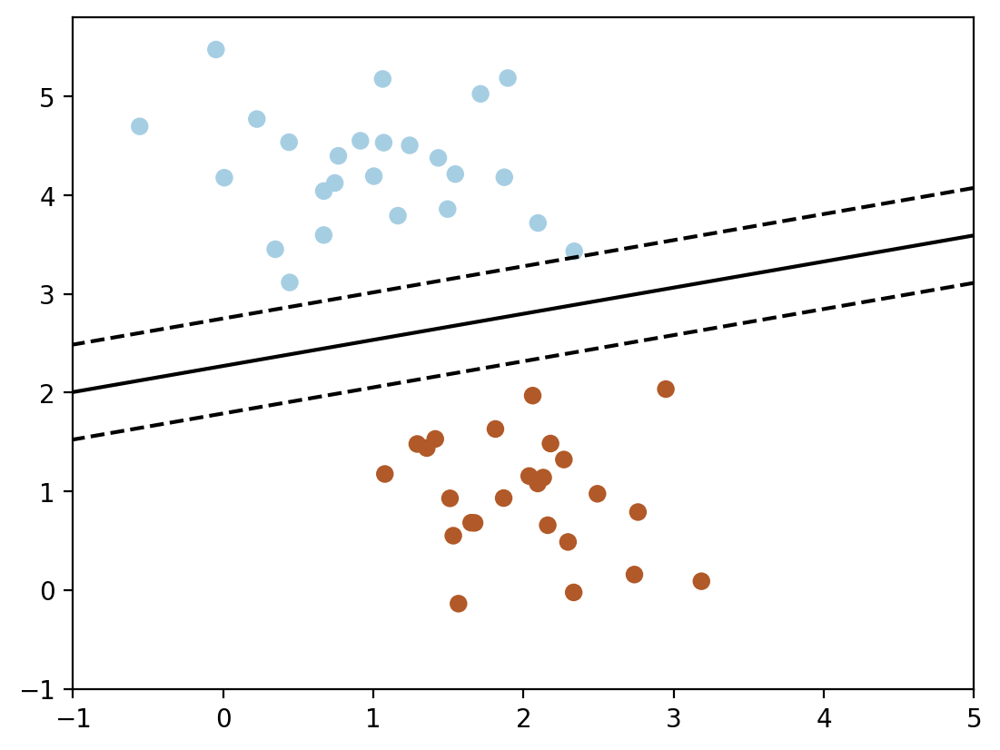

In [29]:
from matplotlib import pyplot as plt
%matplotlib inline
%config InlineBackend.figure_format='retina'

# G. Richards 2016, based on sgd_separator.py by Jake Vanderplas

import numpy as np
import matplotlib.pyplot as plt
from sklearn.linear_model import SGDClassifier
#from sklearn.datasets.samples_generator import make_blobs
from sklearn.datasets import make_blobs

# we create 50 separable points
X, Y = make_blobs(n_samples=50, centers=2, random_state=0, cluster_std=0.60)

# fit the model
clf = SGDClassifier(loss="hinge", alpha=0.01, fit_intercept=True)
clf.fit(X, Y)

# plot the line, the points, and the nearest vectors to the plane
xx = np.linspace(-1, 5, 10)
yy = np.linspace(-1, 5, 10)

X1, X2 = np.meshgrid(xx, yy)
Z = np.empty(X1.shape)
for (i, j), val in np.ndenumerate(X1):
    x1 = val
    x2 = X2[i, j]
    #p = clf.decision_function([x1, x2])
    p = clf.decision_function(np.array([x1,x2]).reshape(1,-1))
    Z[i, j] = p[0]
levels = [-1.0, 0.0, 1.0]
linestyles = ['dashed', 'solid', 'dashed']
colors = 'k'

#ax = plt.axes()
plt.contour(X1, X2, Z, levels, colors=colors, linestyles=linestyles)
plt.scatter(X[:, 0], X[:, 1], c=Y, cmap=plt.cm.Paired)
plt.axis('tight')
plt.show()

This may seem like a trivial task, but it is a simple version of a very important concept. By drawing this separating line, we have **"learned"** a model that can ***generalize*** to new data. If you were to drop another point onto the plane that is unlabeled, this algorithm could now *predict* the color of the point.

The next simple task we'll look at is a **regression** task. This is a simple best-fit line to a set of data.

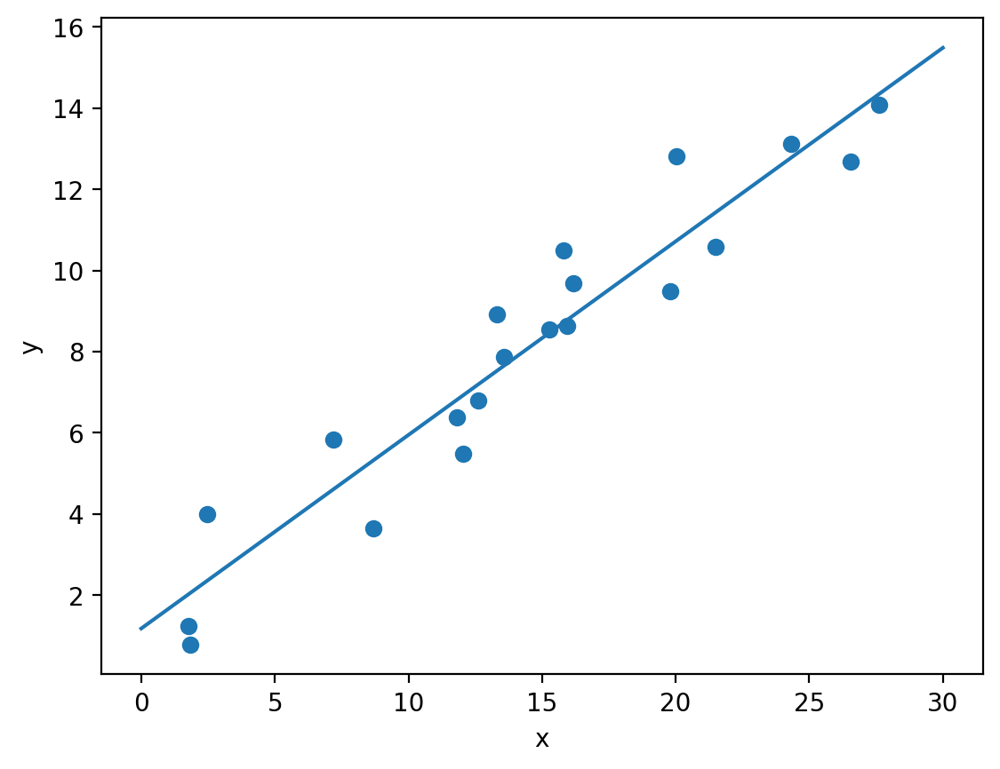

In [2]:
from matplotlib import pyplot as plt
%matplotlib inline
%config InlineBackend.figure_format='retina'

# G. Richards 2016, based on linear_regression.py by Jake Vanderplas

import numpy as np
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression

a = 0.5
b = 1.0

# x from 0 to 10
x = 30 * np.random.random(20)

# y = a*x + b with noise
y = a * x + b + np.random.normal(size=x.shape)

# create a linear regression classifier
clf = LinearRegression()
clf.fit(x[:, None], y)

#GTR: Note that these all do the same thing
#print x[:, None]
#print x[:, np.newaxis]
#print x.reshape(-1,1)
#But only the first one actually is readable

# predict y from the data
x_new = np.linspace(0, 30, 100)
y_new = clf.predict(x_new[:, None])

# plot the results
ax = plt.axes()
ax.scatter(x, y)
ax.plot(x_new, y_new)

ax.set_xlabel('x')
ax.set_ylabel('y')

ax.axis('tight')
plt.show()

- This is another example of fitting a model to data, such that the model can make generalizations about new data. 
- The model has been **learned** from the training data and can be used to predict the result of test data.
- We might be given an $x$-value, and the model would allow us to predict the $y$ value.  
- Again, this might seem like a trivial problem, but it is a basic example of a type of operation that is fundamental to machine learning tasks.

## Representation of Data in Scikit-learn

In order to use Scikit-Learn, we need to understand the input and output of its algorithms.

Most ML algorithms implemented in Scikit-Learn expect data to be stored in an **N-dimensional array or matrix**.  The arrays can be either ``numpy`` arrays, or in some cases ``scipy.sparse`` matrices. The size of the array is expected to be `[n_samples, n_features]`.

- **n_samples**   
  The number of samples: each sample is an item to process (e.g. classify).
  A sample can be a document, a picture, a sound, a video, an astronomical object,
  a row in database or CSV file,
  or whatever you can describe with a fixed set of quantitative traits.
  
  
- **n_features**  
  The number of features or distinct traits that can be used to describe each
  item in a quantitative manner.  Features are generally real-valued, but may be boolean or
  discrete-valued in some cases. Often we call them "dimensions".

The number of features must be fixed in advance. However it can be very high dimensional
(e.g. millions of features) with most of them being zeros for a given sample. This is a case
where `scipy.sparse` matrices can be useful, in that they are
much more memory-efficient than numpy arrays.

## A Simple Example: the Iris Dataset

As an example of a simple dataset, we're going to take a look at the
iris data stored by Scikit-Learn.
The data consists of measurements of three different species of irises, which we picture here:

Iris Setosa

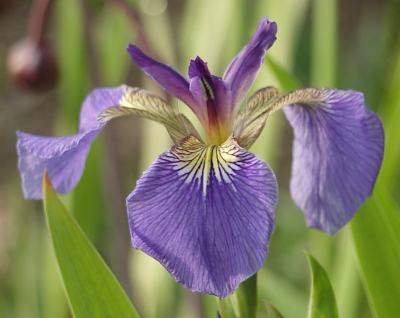

Iris Versicolor

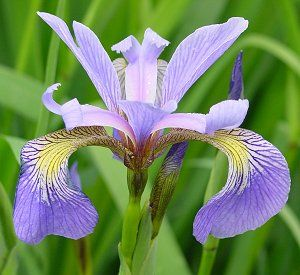

Iris Virginica

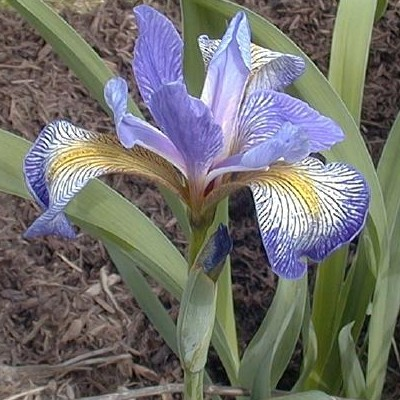

### Loading the Iris Data with Scikit-Learn

Scikit-learn has a very straightforward set of data on these iris species.  The data consist of
the following:

- **Features/attributes in the Iris dataset:**
  1. sepal length in cm
  2. sepal width in cm
  3. petal length in cm
  4. petal width in cm

Scikit-learn refers to the "labels" as "targets".  So, every time you see "target", just think "label" and it will make more sense.  
- **The target classes are:**
  1. Iris Setosa
  2. Iris Versicolour
  3. Iris Virginica
  
``Scikit-Learn`` embeds a copy of the iris CSV file along with a helper function to load it into numpy arrays:

In [1]:
# Execute this cell
from sklearn.datasets import load_iris
iris = load_iris()

`iris` is a dictionary, so we can look at the "keys" of the dictionary as follows:

In [2]:
print(iris.keys())

dict_keys(['data', 'target', 'frame', 'target_names', 'DESCR', 'feature_names', 'filename', 'data_module'])


* `target_names` were defined above
* `data` is the `[n_samples, n_features]` data array
* `target` is the list of labels for all of the entries in `data`
* `DESCR` is a README file with all of the information about the data set
* `feature_names` were defined above

In [3]:
print(iris.DESCR)

.. _iris_dataset:

Iris plants dataset
--------------------

**Data Set Characteristics:**

    :Number of Instances: 150 (50 in each of three classes)
    :Number of Attributes: 4 numeric, predictive attributes and the class
    :Attribute Information:
        - sepal length in cm
        - sepal width in cm
        - petal length in cm
        - petal width in cm
        - class:
                - Iris-Setosa
                - Iris-Versicolour
                - Iris-Virginica
                
    :Summary Statistics:

    ============== ==== ==== ======= ===== ====================
                    Min  Max   Mean    SD   Class Correlation
    ============== ==== ==== ======= ===== ====================
    sepal length:   4.3  7.9   5.84   0.83    0.7826
    sepal width:    2.0  4.4   3.05   0.43   -0.4194
    petal length:   1.0  6.9   3.76   1.76    0.9490  (high!)
    petal width:    0.1  2.5   1.20   0.76    0.9565  (high!)
    ============== ==== ==== ======= ===== ===========

If you are curious, the data come from measurements made in Quebec by botanist Dr. Edgar Anderson and first used for Sir Ronald Fisher's 1936 [classification paper](https://onlinelibrary.wiley.com/doi/10.1111/j.1469-1809.1936.tb02137.x), see [https://en.wikipedia.org/wiki/Iris_flower_data_set](https://en.wikipedia.org/wiki/Iris_flower_data_set). Fisher is a pioneer of statistics.

We can query the database to determine the shape of the data and find that there are 150 objects with 4 measurements each:

In [4]:
print(iris.data.shape)
n_samples, n_features = iris.data.shape
print(n_samples, n_features)

(150, 4)
150 4


Now let's look at both the first entry in `data` and the full $N\times M$ data array. The first entry shows the values of the 4 features for the first object.

Note the structure of the full data array. It is an `n_samples` array of arrays with `n_features`.  Scikit-learn is very picky about this exact format and it isn't always what you would generate naturally (particulary in the case where we have only one feature). More on this later.

In [5]:
#print(iris.data[0])
#print(iris.data)

We can also inpect the shape of the target (labels) array, which is an `n_samples`-dimensional array, print the values of those labels, and also learn how those numerical values relate to the names of the iris species:

In [6]:
# The shape of the target (labels) array is just an n_samples X 1 array
print(iris.target.shape)

# Here we see that the labels are given numerical values
print(iris.target)

# Use target_names to translate those numerical values to names
print(iris.target_names)
print(iris.target_names[0])

(150,)
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2]
['setosa' 'versicolor' 'virginica']
setosa


i.e., $0 = $ setosa, $1 = $ versicolor, and $2 = $ virginica.

This data is four dimensional, but we can visualize two of the dimensions
at a time using a simple scatter-plot.

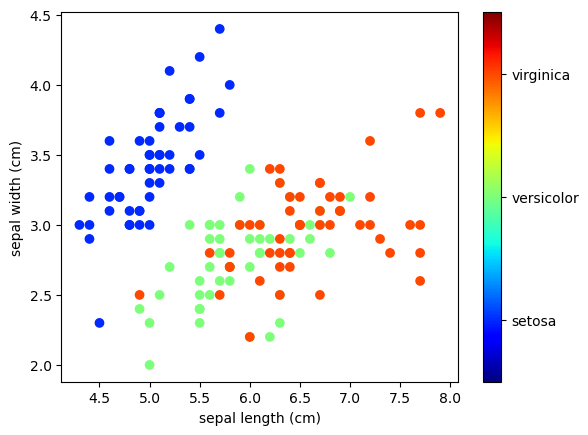

In [7]:
import numpy as np
import matplotlib.pyplot as plt

x_index = 0
y_index = 1

# this formatter will label the colorbar with the correct target names
formatter = plt.FuncFormatter(lambda i, *args: iris.target_names[int(i)])

plt.scatter(iris.data[:, x_index], iris.data[:, y_index], 
            c=iris.target, cmap=plt.colormaps['jet'])

plt.colorbar(ticks=[0, 1, 2], format=formatter)
plt.clim(-0.5, 2.5)
plt.xlabel(iris.feature_names[x_index])
plt.ylabel(iris.feature_names[y_index]);

### Quick Exercise:

Try to change `x_index` and `y_index` in the above script to find a combination of two parameters that maximally separate the three classes.

This is a poor's man preview of **dimensionality reduction**, which we'll see later.

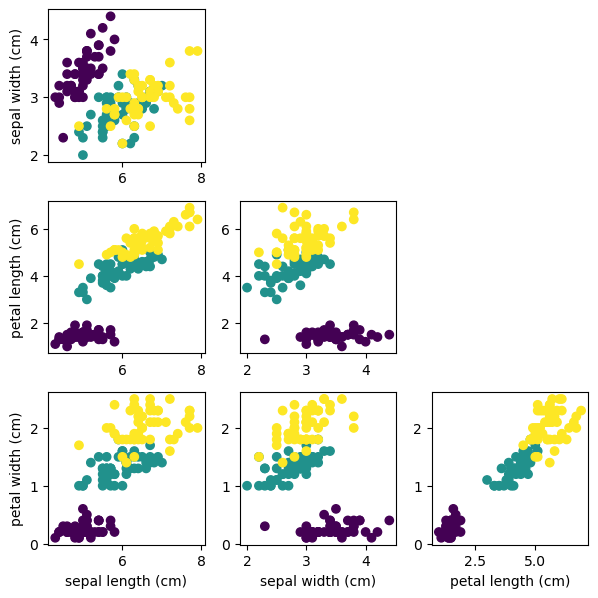

In [10]:
ndims = 4

fig, axes = plt.subplots(ndims, ndims, figsize=(2 * ndims, 2 * ndims))

for i in range(ndims):
    for j in range(ndims):
        ax = axes[i, j]
            
        if i <= j:
            # Upper triangle: hide plots
            ax.set_visible(False)
        else:
            # Lower triangle: scatter plot placeholders
            ax.scatter(iris.data[:, j], iris.data[:, i], 
            c=iris.target)
            
            if j == 0:
                ax.set_ylabel(iris.feature_names[i])
            if i == ndims - 1:
                ax.set_xlabel(iris.feature_names[j])

plt.tight_layout()



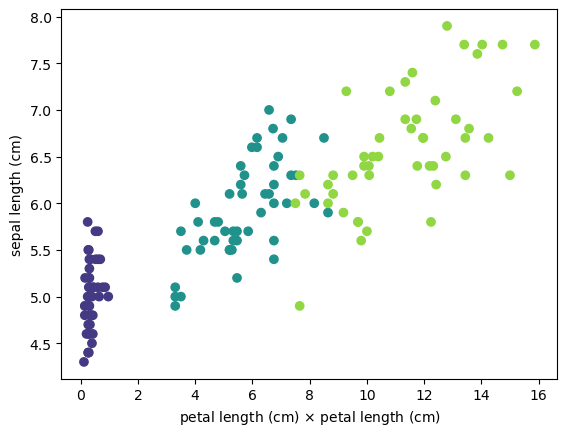

In [12]:
# this formatter will label the colorbar with the correct target names
formatter = plt.FuncFormatter(lambda i, *args: iris.target_names[int(i)])

# Try some combinations: 
plt.scatter(iris.data[:, 2]*iris.data[:, 3], iris.data[:, 0], 
            c=iris.target)

#plt.colorbar(ticks=[0, 1, 2], format=formatter)
plt.clim(-0.5, 2.5)
plt.xlabel(iris.feature_names[2]+' $\\times$ '+iris.feature_names[2])
plt.ylabel(iris.feature_names[0]);

## Other Available Data

Data in scikit-learn come in three flavors:
- **Packaged Data:** these small datasets are packaged with the scikit-learn installation,
  and can be downloaded using the tools in ``sklearn.datasets.load_*``
  

- **Downloadable Data:** these larger datasets are available for download, and scikit-learn
  includes tools which streamline this process.  These tools can be found in
  ``sklearn.datasets.fetch_*``
  
  
- **Generated Data:** there are several datasets which are generated from models based on a
  random seed.  These are available in the ``sklearn.datasets.make_*``

You can explore the available dataset loaders, fetchers, and generators using IPython's
tab-completion functionality.  After importing the ``datasets`` submodule from ``sklearn`` (see cells below),
type

    datasets.load_ + TAB

or

    datasets.fetch_ + TAB

or

    datasets.make_ + TAB

to see a list of available functions.

In [13]:
from sklearn import datasets

In [14]:
# Type datasets.fetch_<TAB> in IPython to see all possibilities
datasets.load_wine


<function sklearn.datasets._base.load_wine(*, return_X_y=False, as_frame=False)>

A similar interface to [datasets](http://www.astroml.org/examples/datasets/#) is available in ``astroML``:

In [15]:
from astroML import datasets

# Use tab completion to explore datasets
quasars = datasets.fetch_dr7_quasar()

In [16]:
print(quasars)


[(b'000006.53+0030', 2.72280000e-02,  0.515341, 1.8246, 20.384, 0.065, 20.461, 0.034, 20.324, 0.038, 20.093, 0.041, 20.042, 0.121,  0.   , 0.   , 0., 0., 0., 0., 193034571183292416)
 (b'000008.13+0016', 3.39000000e-02,  0.276301, 1.8373, 20.242, 0.054, 20.206, 0.024, 19.941, 0.032, 19.485, 0.032, 19.178, 0.068, 17.351, 0.291, 0., 0., 0., 0., 193034571195875328)
 (b'000009.26+1517', 3.86040000e-02, 15.298477, 1.1985, 19.916, 0.042, 19.807, 0.036, 19.374, 0.017, 19.148, 0.023, 19.312, 0.069,  0.   , 0.   , 0., 0., 0., 0., 211612125330669568)
 ...
 (b'235958.72+0033', 3.59994688e+02,  0.562592, 1.6937, 19.874, 0.05 , 19.872, 0.028, 19.711, 0.03 , 19.386, 0.026, 19.353, 0.069,  0.   , 0.   , 0., 0., 0., 0., 193034571158126592)
 (b'235959.06-0909', 3.59996092e+02, -9.162233, 1.2834, 18.421, 0.021, 18.352, 0.015, 18.14 , 0.024, 18.114, 0.022, 18.045, 0.036, 17.41 , 0.32 , 0., 0., 0., 0., 183182689220689920)
 (b'235959.44+0008', 3.59997675e+02,  0.14487 , 1.3542, 20.999, 0.113, 20.864, 0.038,

## Basic Principles of Machine Learning

Now we can dive into the basic principles of machine learning, and how to utilize them via Scikit-Learn.

After briefly introducing scikit-learn's ***Estimator*** object, we'll get an introduction to **supervised learning**, including ***classification*** and ***regression*** problems, and **unsupervised learning**, including ***dimensionality reduction*** and ***clustering*** problems.

### The Scikit-Learn Estimator Object

Every algorithm in scikit-learn generates an `Estimator` object. 

All the **parameters** of an estimator can be set when it is instantiated, and have suitable default values.  

Let's take a look at all of the parameters, attributes and methods in the [LinearRegression module](http://scikit-learn.org/stable/modules/generated/sklearn.linear_model.LinearRegression.html).

In [17]:
from sklearn.linear_model import LinearRegression

In [18]:
# Instantiate a LinearRegression estimator object, call it `model`
model = LinearRegression()

print(model)

LinearRegression()


With our model instantiated, we are ready to input some data.  So let's make a simple test case.

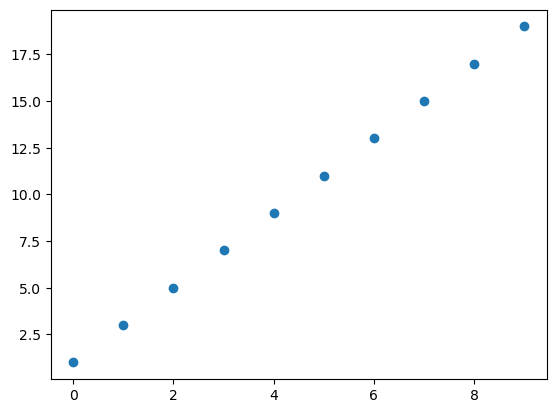

In [19]:
x_train = np.arange(10)    # An array of 10 integers
y_train = 2 * x_train + 1  # Some operation performed on that array
plt.plot(x_train, y_train, 'o');

Now we'd like to `fit` that data to determine the model parameters that we would need to `predict` the $y$ values of any new measurement of $x$.  

Scikit-Learn breaks this into two steps:
1. **fitting**
2. **predicting**
    
where the syntax of the fit looks like:

In [21]:
# fit the model on our data
#model.fit(x_train, y_train) DOESN'T WORK!

What the heck!

- That's because `Scikit-Learn` wants the training **features** as a multi-dimensional array. Even if there is only one dimension, like we have here. 


- In that case, it is looking for a column array instead of the row array that we gave it, i.e. instead of an array of shape $(10,)$ which is the standard, it wants an array of shape $(10,1)$.


- Their standard syntax is to call this multi-dimensional training array, $X$, (capital $x$) and the training "labels" (which can be continuous) simply $y$.


- If your $x$ is 1-D, then we have to turn it into something that looks like it is $N$-D.  All of the following yield the same result.  I personally like using `np.newaxis` since it is (sort of) readable.  The `reshape` syntax looks like it used to be widely used, but has now mostly been replaced with the `np.newaxis` syntax.  


- The effect of all three is to turn $x$ into a `n_samples` by 1-D *array* rather than an array of `n_samples`.

In [23]:
# All of these give the same result.
#print(x_train.reshape(-1,1))
#print(x_train[:, np.newaxis])
#print(x_train[:, None])

X = x_train[:, None]
y = y_train
print(y)

[ 1  3  5  7  9 11 13 15 17 19]


Note that you can produce random $X$s in the correct format with
```
N = 10
X = np.random.random(size=(N, 1))
```

And you can go backward with
```
X.squeeze()
```

In [44]:
x_train[:,np.newaxis].shape

y_train.shape

(10,)

In [25]:
# Now we can fit the model on our data

X=x_train[:,np.newaxis]
model.fit(X, y_train)

LinearRegression()

**Estimated Model parameters**

All the estimated parameters are attributes of the estimator object ending with an *underscore*:

In [26]:
# Let's look at the fit parameters, which are indicated by an underscore at the end
print(model.coef_)
print(model.intercept_)

[2.]
1.0


The model found a line with a slope 2 and intercept 1, as we'd expect. Awesome!

Now that you've fitted the model, you can use it!

In [37]:
model.predict([[3.5]])

array([8.])

(make sure you understand the shape, why did I use `[[3]]`?)

### Supervised Learning: Classification and Regression

In **Supervised Learning**, we have a dataset consisting of both ***features*** and ***labels***. The task is to construct an estimator that is able to predict the label of an object given the set of features. A relatively simple example is predicting the species of iris given a set of measurements of its flower.

Some more complicated examples are:

- given a multicolor image of an object through a telescope, determine
  whether that object is a star, a quasar, or a galaxy.
  
  
- given a photograph of a person, identify the person in the photo.


- given a list of movies a person has watched and their personal rating
  of the movie, recommend a list of movies they would like
  (So-called *recommender systems*: a famous example is the [Netflix Prize](http://en.wikipedia.org/wiki/Netflix_prize)).

The commonality of these tasks is that there are one or more unknown properties of an object that must be determined from other observed quantities.

Supervised learning is further broken down into two categories, 
1. **classification** (discrete labels)
2. **regression** (continuous labels)

For example, the task of determining whether an object is a star, a galaxy, or a quasar is a classification problem: the label is from three distinct categories. On the other hand, we might wish to estimate the age of an object based on such observations: this would be a regression problem, because the label (age) is a continuous quantity.

### Classification Example
[K nearest neighbors (kNN)](http://scikit-learn.org/stable/modules/generated/sklearn.neighbors.KNeighborsClassifier.html#sklearn.neighbors.KNeighborsClassifier) is one of the simplest learning strategies: given a new, unknown observation, look up in your reference database which ones have the closest features and assign the predominant class.

Let's try it out on our iris classification problem.  First see if you can do a kNN fit on the iris data using the 5 nearest neighbors.

In [28]:
from sklearn import neighbors, datasets

iris = datasets.load_iris()
X, y = iris.data, iris.target

# create the model
knn = neighbors.KNeighborsClassifier(n_neighbors=5) #Complete with number of neighbors

# Meaning of n_neighbors
# It’s an integer (e.g., 3, 5, 10).
# For classification, the algorithm looks at the n_neighbors closest training samples and uses majority vote to assign a class.
# For regression, it computes the average (or weighted average) of the values of the n_neighbors closest samples.

# fit the model
knn.fit(X, y)

KNeighborsClassifier()

Ok now let's figure out what kind of iris has a 3cm x 5cm sepal and 4cm x 2cm petal using the predict method. 

We now have multiple features, but we still need those in a `n_samples=1` by `n_feaures=4` array.

Now let's predict

In [53]:
# What kind of iris has 3cm x 5cm sepal and 4cm x 2cm petal?
# call the "predict" method:
Xtest = [[3,5,4,2]]
result = knn.predict(Xtest)
print(result)
print(iris.target_names[result]) # Complete such that the name rather than the number is output.

[1]
['versicolor']


In some sense the whole point of classification is that there isn't necessarily going to be a cut and dry "right" answer. So, we might want to do probabilistic predictions instead.

In [54]:
knn.predict_proba(Xtest)

array([[0. , 0.8, 0.2]])

We could even visualize the full parameter space so that we could determine the classification by eye.  To make things simpler, we have done this in 2-D rather than 4-D.  Note that it isn't perfect, but does a really good job of classifying at least the red sources.

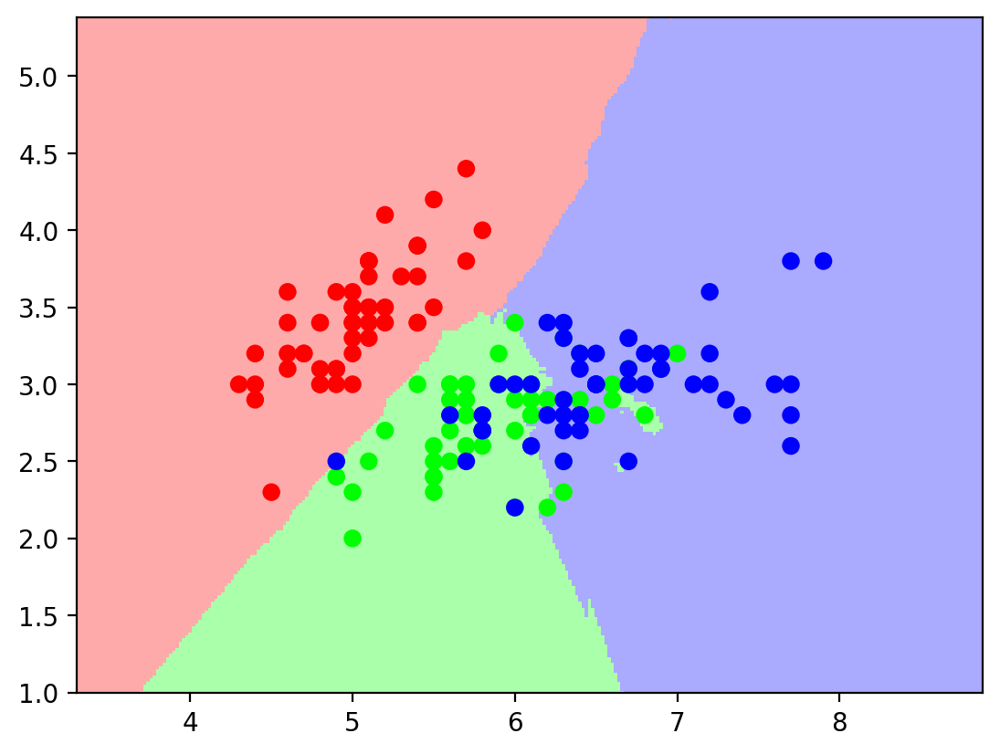

In [56]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from sklearn import neighbors, datasets

n_neighbors = 15

# import some data to play with
iris = datasets.load_iris()

# we only take the first two features
X = iris.data[:, :2]  
y = iris.target

h = .02  # step size in the mesh

# Create color maps
cmap_light = ListedColormap(['#FFAAAA', '#AAFFAA', '#AAAAFF'])
cmap_bold = ListedColormap(['#FF0000', '#00FF00', '#0000FF'])

# we create an instance of Neighbours Classifier and fit the data.
model =  neighbors.KNeighborsClassifier(n_neighbors)
model.fit(X, y)

# Plot the decision boundary. For that, we will assign a color to each 
# point in the mesh [x_min, x_max]x[y_min, y_max].

x_min, x_max = X[:, 0].min() - 1, X[:, 0].max() + 1
y_min, y_max = X[:, 1].min() - 1, X[:, 1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, h),
                     np.arange(y_min, y_max, h))

Z = model.predict(np.c_[xx.ravel(), yy.ravel()])

# Put the result into a color plot
Z = Z.reshape(xx.shape)
plt.figure()
plt.pcolormesh(xx, yy, Z, cmap=cmap_light, shading='auto')

#Now overplot the training points                     
plt.scatter(X[:, 0], X[:, 1], c=y, cmap=cmap_bold)
plt.xlim(xx.min(), xx.max())
plt.ylim(yy.min(), yy.max())

plt.show()

### The syntax is very consistent across sklearn...

Let's do the same, but now using [``sklearn.svm.SVC``](http://scikit-learn.org/stable/modules/generated/sklearn.svm.SVC.html) to predict what type of iris has a 3cm x 5cm sepal and 4cm x 2cm petal. This is **Support Vector Machine Classification** (see [Textbook](http://press.princeton.edu/titles/10159.html) Sec 9.6).  The details are not important now, let's just use it.

In [57]:
from sklearn.svm import SVC
iris = datasets.load_iris()
X, y = iris.data, iris.target
Xtest = np.array([[3,5,4,2],])

In [58]:
model = SVC()
model.fit(X,y)
result = model.predict(Xtest)
print(iris.target_names[result])

['versicolor']


# Palmer Penguins

344 istances, 3 targets (Adelie, Gentoo, Chinstrap), 5 attributes (island,bill_lenght_mm,bill_depth_mm, flipper_lenght_mm,body_mass_g). (sex and year not influent?)


<div style="display: flex; justify-content: center; gap: 20px;">
    <div>
        <img src="images/adelie_penguin.png" width="200"/>
        <p style="text-align: center;">Adelie</p>
    </div>
    <div>
        <img src="images/gentoo_penguin.png" width="200"/>
        <p style="text-align: center;">Gentoo</p>
    </div>
    <div>
        <img src="images/chinstrap_penguin.png" width="200"/>
        <p style="text-align: center;">Chinstrap</p>
    </div>
</div>


In [29]:
from palmerpenguins import load_penguins
penguins = load_penguins()

In [30]:
penguins.head(len(penguins))


,species,island,bill_length_mm,bill_depth_mm,flipper_length_mm,body_mass_g,sex,year
0,Adelie,Torgersen,39.1,18.7,181.0,3750.0,male,2007
1,Adelie,Torgersen,39.5,17.4,186.0,3800.0,female,2007
2,Adelie,Torgersen,40.3,18.0,195.0,3250.0,female,2007
3,Adelie,Torgersen,NaN,NaN,NaN,NaN,NaN,2007
4,Adelie,Torgersen,36.7,19.3,193.0,3450.0,female,2007
...,...,...,...,...,...,...,...,...
339,Chinstrap,Dream,55.8,19.8,207.0,4000.0,male,2009
340,Chinstrap,Dream,43.5,18.1,202.0,3400.0,female,2009
341,Chinstrap,Dream,49.6,18.2,193.0,3775.0,male,2009
342,Chinstrap,Dream,50.8,19.0,210.0,4100.0,male,2009


Text(0, 0.5, 'Body Mass')

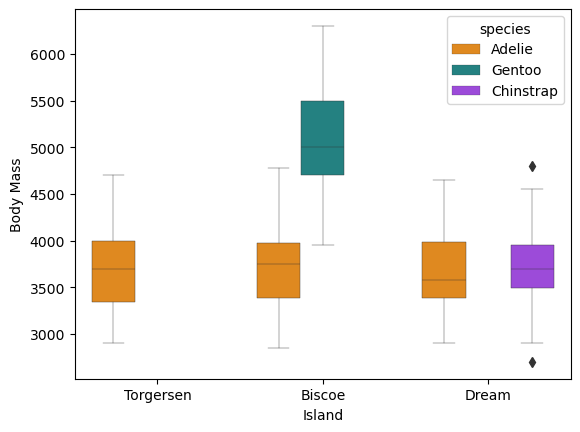

In [31]:
import seaborn as sns

g = sns.boxplot(x = 'island',y ='body_mass_g',hue = 'species',data = penguins,palette=['#FF8C00','#159090','#A034F0'],linewidth=0.3)
g.set_xlabel('Island')
g.set_ylabel('Body Mass')

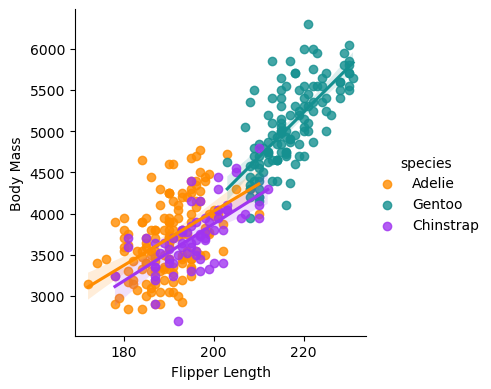

In [32]:
g = sns.lmplot(x="flipper_length_mm",y="body_mass_g",hue="species",height=4,data=penguins,palette=['#FF8C00','#159090','#A034F0'])
g.set_xlabels('Flipper Length')
g.set_ylabels('Body Mass')

Model Accuracy: 0.78


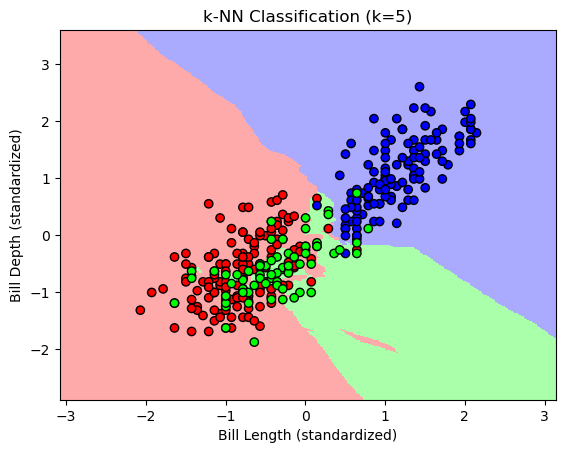

In [36]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.neighbors import KNeighborsClassifier

# Drop rows with missing values
penguins = penguins.dropna()

# Select features (bill length & bill depth) and target (species)
#X = penguins[['bill_length_mm', 'bill_depth_mm']].values
X = penguins[['flipper_length_mm', 'body_mass_g']].values
y = penguins['species'].values

# Encode species labels into numbers
label_encoder = LabelEncoder()
y = label_encoder.fit_transform(y)

# Standardize features
scaler = StandardScaler()
X = scaler.fit_transform(X)

# Split into training & testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train k-NN classifier
n_neighbors = 5  # Adjust as needed
model = KNeighborsClassifier(n_neighbors=n_neighbors)
model.fit(X_train, y_train)

# Evaluate accuracy
accuracy = model.score(X_test, y_test)
print(f"Model Accuracy: {accuracy:.2f}")

# Plot decision boundary
h = 0.02  # Step size for mesh
x_min, x_max = X[:, 0].min() - 1, X[:, 0].max() + 1
y_min, y_max = X[:, 1].min() - 1, X[:, 1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, h),
                     np.arange(y_min, y_max, h))

Z = model.predict(np.c_[xx.ravel(), yy.ravel()])
Z = Z.reshape(xx.shape)

# Define colormap
cmap_light = ListedColormap(['#FFAAAA', '#AAFFAA', '#AAAAFF'])
cmap_bold = ListedColormap(['#FF0000', '#00FF00', '#0000FF'])

plt.figure()
plt.pcolormesh(xx, yy, Z, cmap=cmap_light, shading='auto')

# Plot training points
plt.scatter(X[:, 0], X[:, 1], c=y, cmap=cmap_bold, edgecolor='k')
plt.xlabel("Bill Length (standardized)")
plt.ylabel("Bill Depth (standardized)")
plt.title(f"k-NN Classification (k={n_neighbors})")

plt.show()

### Regression Example

OK, that was a **classification** example. The simplest possible **regression** example is just fitting a line to data:

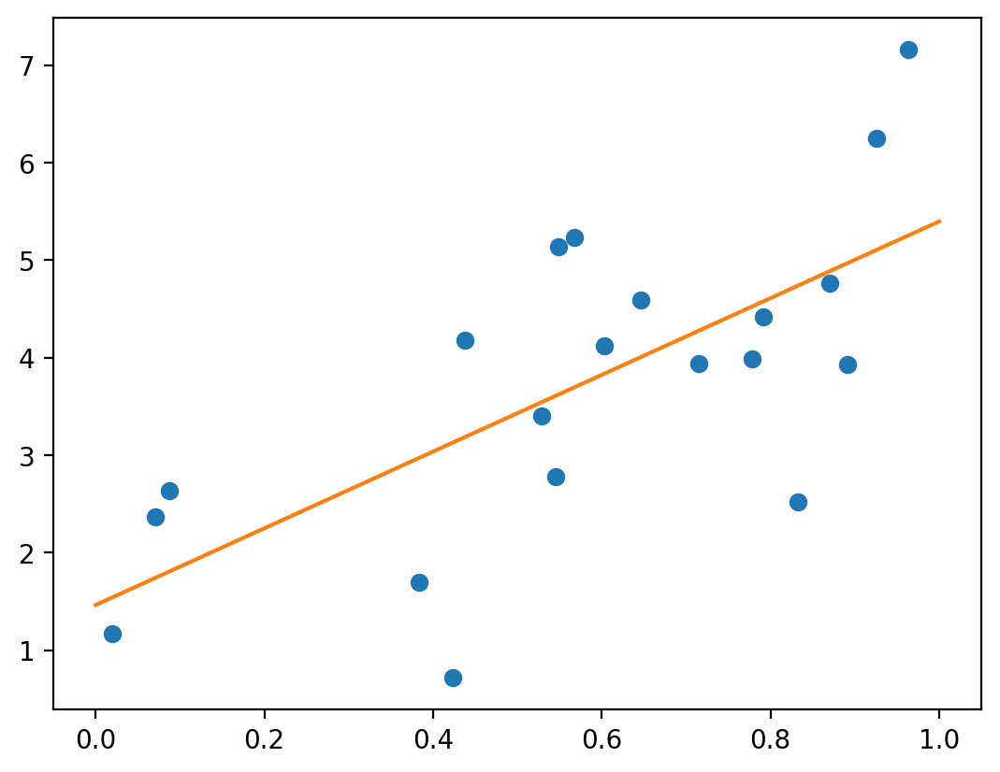

In [92]:
# Create some simple data

np.random.seed(0)
x = np.random.random(size=20) # 20 random numbers between 0 an 1
y = 3 * x + 2 + np.random.randn(20) # some operation performed on that array
X = x[:,np.newaxis]

# Fit a Linear Regression
modelLR = LinearRegression()
#modelRF = 
modelLR.fit(X,y)

# Plot the data and the model prediction
x_test = np.linspace(0, 1, 100)
X_test = x_test[:,np.newaxis]
y_predLR = modelLR.predict(X_test)

plt.plot(x, y, 'o')
plt.plot(X_test, y_predLR)

Now we modify the above code to add a line using the [`RandomForestRegressor`](http://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomForestRegressor.html) imported from `sklearn.ensemble` as well (see [Textbook](http://press.princeton.edu/titles/10159.html) Sec 9.6). Again, details (or even the result!) are not important for now. Just notice that one just need to change the flavour of the regressor.

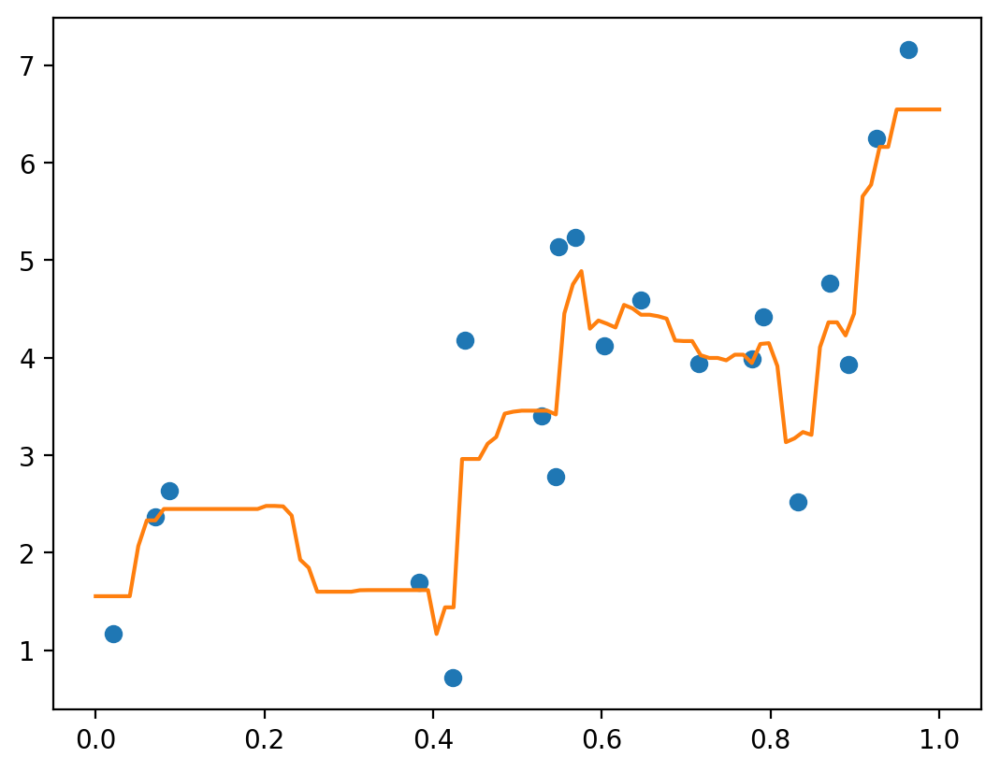

In [61]:
from sklearn.ensemble import RandomForestRegressor 

# Fit a Linear Regression
modelLR = RandomForestRegressor()
#modelRF = 
modelLR.fit(X,y)

# Plot the data and the model prediction
x_test = np.linspace(0, 1, 100)
X_test = x_test[:,None]
y_predLR = modelLR.predict(X_test)

plt.plot(x, y, 'o')
plt.plot(X_test, y_predLR)

## Unsupervised Learning: Dimensionality Reduction and Clustering

**Unsupervised Learning** addresses a different sort of problem. 
- Here the data has no labels.
- We are interested in finding similarities between the objects in question. 
- In a sense, you can think of unsupervised learning as ***a means of discovering labels from the data itself***.

Unsupervised learning comprises tasks such as ***dimensionality reduction***, ***clustering***, and
***density estimation***. 

For example, in the iris data discussed above, we can use unsupervised methods to determine combinations of the measurements which best display the structure of the data. As we'll see below, such a projection of the data can be used to visualize the four-dimensional dataset in two dimensions. Some more involved unsupervised learning problems are:

- given detailed observations of distant galaxies, determine which features or combinations of
  features best summarize the information.
  
  
- given a mixture of two sound sources (for example, a person talking over some music, or a gravitational-wave talking over detector noise),
  separate the two (this is called the [blind source separation](http://en.wikipedia.org/wiki/Blind_signal_separation) problem).
  
  
- given a video, isolate a moving object and categorize in relation to other moving objects which have been seen.

Sometimes the two may even be combined: e.g., unsupervised learning can be used to find useful
features in heterogeneous data, and then these features can be used within a supervised
framework.

### Dimensionality Reduction: PCA

**[Principle Component Analysis (PCA)](http://scikit-learn.org/stable/modules/decomposition.html#principal-component-analysis-pca)** is a dimension reduction technique that can find the combinations of variables that explain the most variance. (see [Textbook](http://press.princeton.edu/titles/10159.html) Sec 7.3)

Consider the iris dataset. It cannot be visualized in a single 2D plot, as it has 4 features. We are going to extract 2 combinations of sepal and petal dimensions to visualize it.

The process starts in the same way as the other Scikit-Learn examples that we have done:

In [37]:
X, y = iris.data, iris.target
from sklearn.decomposition import PCA
pca = PCA(n_components=2)
pca.fit(X)

PCA(n_components=2)

But now we can't do a `predict` step since we don't have training data.  Instead we are going to use the `transform()` method.  As usual, when using a new piece of code first look at the [docs](http://scikit-learn.org/stable/modules/generated/sklearn.decomposition.PCA.html#sklearn.decomposition.PCA).

Reduced dataset shape: (150, 2)
Projection of the 2 components:
0.361 x sepal length (cm) + -0.085 x sepal width (cm) + 0.857 x petal length (cm) + 0.358 x petal width (cm)
0.657 x sepal length (cm) + 0.730 x sepal width (cm) + -0.173 x petal length (cm) + -0.075 x petal width (cm)


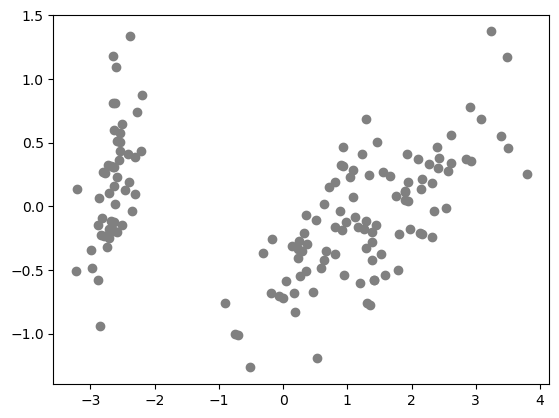

In [38]:
X_reduced = pca.transform(X)
print("Reduced dataset shape:", X_reduced.shape)

plt.scatter(X_reduced[:, 0], X_reduced[:, 1], 
            c='gray')

print("Projection of the 2 components:")
for component in pca.components_:
    print(" + ".join("%.3f x %s" % (value, name) for value, name in 
                     zip(component, iris.feature_names)))

- **This projection maximizes the separation of the classes.** 
- We can use this either just for visualization or to actually help define the classes.
- From the separation of points in the PCA projection, we can easily see there are either two or three distinct classes.

Note how this is completely unsupervised. We've only used `X` and not `y`. The algorithm doesn't know anything about 'setosa' 'versicolor' and 'virginica', but it still figures out that there are different datasets in there. 

### Clustering: K-means

**[Clustering](http://scikit-learn.org/stable/modules/clustering.html)** groups together observations that are homogeneous with respect to a given criterion, finding ''clusters'' in the data. 

Note that these clusters will uncover relevant hidden structure of the data only if the criterion used highlights it.

Let's look at ***[`KMeans`](http://scikit-learn.org/stable/modules/clustering.html#k-means)*** (see [Textbook](http://press.princeton.edu/titles/10159.html) Sec 6.4.2).  Note that here the [parameters, attributes, and methods](http://scikit-learn.org/stable/modules/generated/sklearn.cluster.KMeans.html#sklearn.cluster.KMeans) allow for *either* `predict` or `transform`.


In [65]:
from sklearn.cluster import KMeans

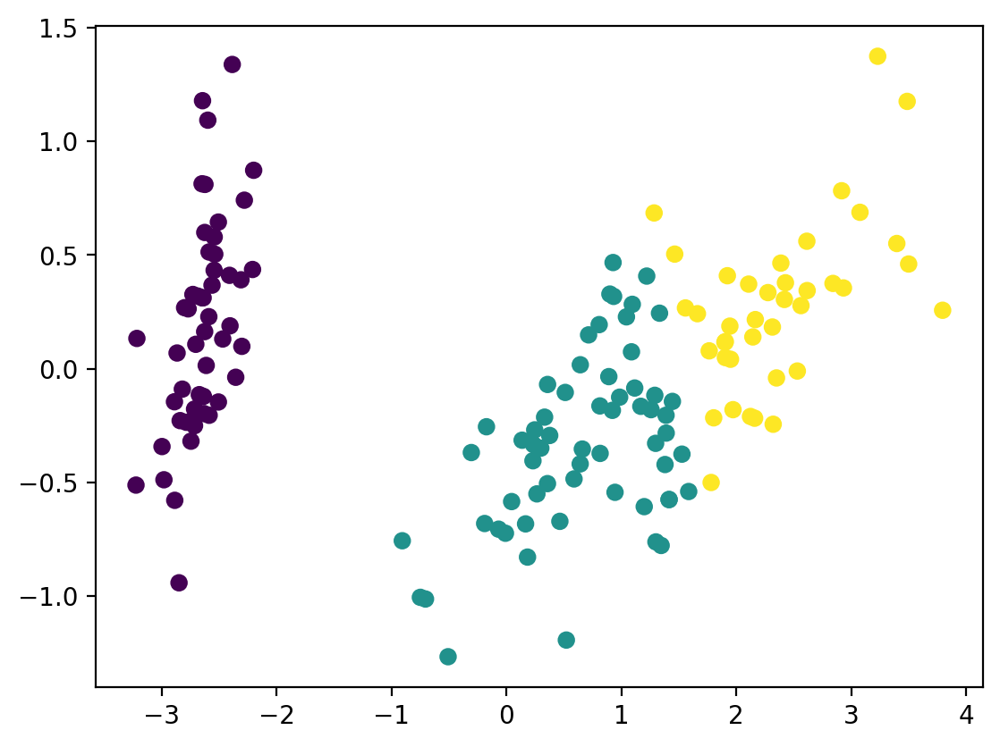

In [66]:
k_means = KMeans(n_clusters=3,n_init='auto')
k_means.fit(X_reduced)
y_pred = k_means.predict(X_reduced)

plt.scatter(X_reduced[:, 0], X_reduced[:, 1], 
            c=y_pred, cmap='viridis');

Not the colors here are the predictions. When asked to find three "clusters" in the data, our machine learning approach identifies those three.


Let's look at the true values... Now the colors are the real labels (somethigng that in practice you might not have when applying these tools to a unknown research problem)


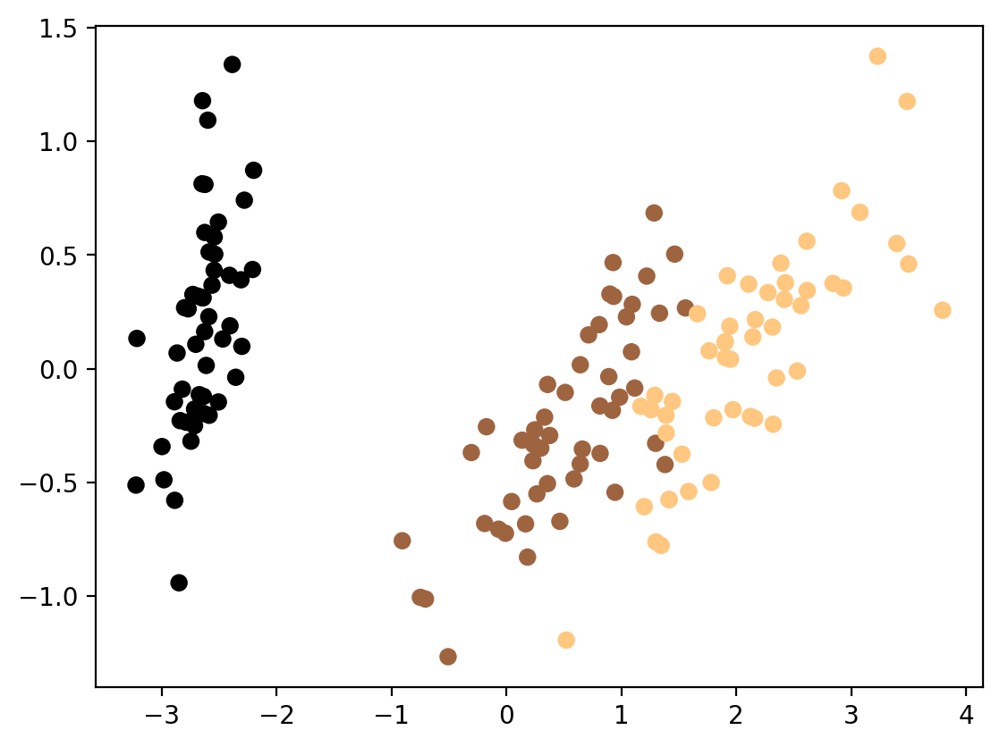

In [67]:
plt.scatter(X_reduced[:, 0], X_reduced[:, 1], 
            c=y, cmap="copper")

So `Kmeans` did roughly what we might have expected by eye from the application of `PCA`.  The dark objects are all classified correctly, but there are some errors on the yellow-green border.

### Recap: Scikit-learn's estimator interface

Scikit-learn strives to have a uniform interface (API) across all methods, and we'll see examples of these below. Given a scikit-learn ***estimator*** object named `model`, the following methods are available:

- Available in **all Estimators**
     - `model.fit()`: fit training data. For supervised learning applications, this accepts two arguments: the data `X` and the labels `y` [e.g., `model.fit(X, y)`].  For unsupervised learning applications, this accepts only a single argument, the data `X` [e.g., `model.fit(X)`].
  
  
- Available in **supervised estimators**
    - `model.predict()`: given a trained model, predict the label of a new set of data. This method accepts one argument, the new data `X_new` [e.g., `model.predict(X_new)`], and returns the learned label for each object in the array.
    - `model.predict_proba()`: For classification problems, some estimators also provide this method, which returns the probability that a new observation has each categorical label. In this case, the label with the highest probability is returned by `model.predict()`.
    - `model.score()`: For classification or regression problems, most (all?) estimators implement a score method.  Scores are between 0 and 1, with a larger score indicating a better fit.
    
    
- Available in **unsupervised estimators**
    - `model.transform()`: given an unsupervised model, transform new data into the new basis. This also accepts one argument `X_new`, and returns the new representation of the data based on the unsupervised model.
    - `model.fit_transform()`: some estimators implement this method, which more efficiently performs a fit and a transform on the same input data.

## Model Validation

An important aspect of ML is **model validation**:
> *determining how well your model will generalize from the training data to future unlabeled data.* 

Let's look at an example using the ***nearest neighbor classifier***. This is a very simple classifier. It stores all training data, and for any unknown quantity, simply returns the label of the closest training point.

With the iris data, it very easily returns the correct prediction for each of the input points:

In [126]:
from sklearn.neighbors import KNeighborsClassifier
X, y = iris.data, iris.target
clf = KNeighborsClassifier(n_neighbors=1)
clf.fit(X, y)
y_pred = clf.predict(X)
print('Element-wise check: ' + str(y==y_pred))
print('All-at-once check: ' + str(np.all(y == y_pred))) # To check all at once.

Element-wise check: [ True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True]
All-at-once check: True


See what happens if we used more than the first nearest neighbor.

A more useful way to look at the results is to view the **confusion matrix**, or the matrix showing the frequency of inputs and outputs:

In [70]:
from sklearn.metrics import confusion_matrix
print(confusion_matrix(y, y_pred))

[[50  0  0]
 [ 0 50  0]
 [ 0  0 50]]


Read each element of the matrix as "*the number of observations known to be in row-$i$ and predicted to be in column-$j$*".

For each class, all 50 training samples are correctly identified. But this **does not mean that our model is perfect!** In particular, such a model generalizes poorly to new data. We can simulate this by splitting our data into a ***training set*** and a ***test set***. Scikit-learn contains some convenient routines to do this: here we will apply [`train_test_split`](http://scikit-learn.org/stable/modules/generated/sklearn.model_selection.train_test_split.html#sklearn.model_selection.train_test_split):

In [71]:
from sklearn.model_selection import train_test_split
Xtrain, Xtest, ytrain, ytest = train_test_split(X, y,test_size=0.5)
clf.fit(Xtrain, ytrain)

KNeighborsClassifier(n_neighbors=1)

In [72]:
ypred = clf.predict(Xtrain)
print(confusion_matrix(ytrain, ypred))

[[26  0  0]
 [ 0 25  0]
 [ 0  0 24]]


In [73]:
ypred = clf.predict(Xtest)
print(confusion_matrix(ytest, ypred))

[[24  0  0]
 [ 0 24  1]
 [ 0  2 24]]


This paints a better picture of the true performance of our classifier: apparently there is some confusion between the second and third species, which we might anticipate given what we've seen of the data above.

This is why it's **extremely important** to use a train/test split when evaluating your models.  We'll go into more depth on model evaluation later.

## Flow Chart: How to Choose your Estimator

In the mean time, I remind you of this the [Scikit-Learn algorithm cheat sheet](http://scikit-learn.org/stable/tutorial/machine_learning_map/) which gives a nice summary of which algorithms to choose in various situations.



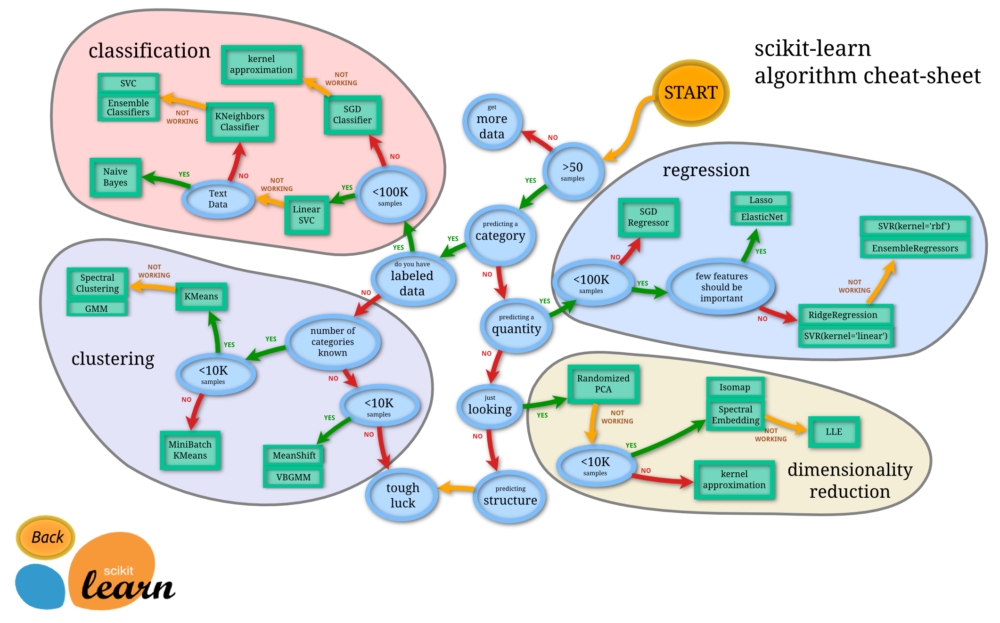

In [9]:
from IPython.display import Image
Image("http://scikit-learn.org/dev/_static/ml_map.png")

## How do we determine the optimal algorithm?

We've seen already several times that our algorithms have hyperparameters (the number of bins in an histogram, the bandwidth of a KDE, the number of component in PCA, etc etc). Picking by hand is not satisfactory. Often we have some astrophysical knowledge ("I know that there are two distinct formation processes at play for these kind of stars") but let's now look at how we can do this in a purely **data-driven** fashion using [cross validation](https://en.wikipedia.org/wiki/Cross-validation_(statistics)). See [this guide](https://scikit-learn.org/stable/modules/cross_validation.html) as well.

To avoid fooling ourselves into thinking our model is better than it is, we set aside some of the data as the "***test***" set--that provides an independent check on the the fit from the ***training data***. 

That's fine if our model has no parameters, or has parameters that are all fixed ahead of time.  But what if we want to try to use the data to not only fit a model, but decide what the best model parameters are?  In that case, we need to set aside some of the training data as a "***validation***" set.  

This divsion will become crucial when we'll look at deep learning stategies. The reason is that deep learning can behave like a black box which is hard to control. Testing and validating is essentially the *only* way to make sure one is doing something meaninful. So:

- **Training** data are used for the actual fit
- **Validation** data are used to optimize the parameters of the algorithm
- **Test** data are used at the very end to evaluate the overall performance.


There are some obvious issues here. Splitting the data not only does leave us less data for training (and we know less data is bad for machine learning!), but it also means that it matters which objects are in each of the training, validation, and test sets.  We can solve both of these problems with **cross validation**.

With our KDE example, we are just trying to map the density, not predict the value, so we really only need two sets: training and validation. There are a number of different ways to do this.

1. You could **randomly sample** to decide which data goes into the training or test sets. We don't just do this once, but rather many times so that each data point is treated both as a training point and as a test point at some stage.


2. We could do this in a more ordered way (e.g., to make sure that each object gets sampled as training/test the same number of times) and do a **$K$-fold cross validation**. Here $K$ is the number of "experiments" that need to be done so that each data point appears in a test sample once.


3. We can take $K$-fold cross validation to the extreme by having $K\equiv N$, so that in each experiment we leave out just one object. This is called **"Leave-One-Out" cross validation**.


A 5-fold cross-validation would look like this:

![](https://scikit-learn.org/stable/_images/grid_search_cross_validation.png)


But note this dramatically increases the computational cost! So often we're stuck with running only once (which is the usual test/training approach of deep learning).






Ok let's say it again

- The *training* set is used to learn the model parameters
- The *validation* set is used to tune the (hyper)parameters of the algorithm
- The *test* set is used to test the final performance

(I *think* ML people use words "learn" and "tune" with this different flavor).  

- If you're only learning the parameters, you don't need a validation set: test-train splitting. 
- If you're also tuning the hyperparameters: K-fold cross validation
    - Train your algorithm K times
    - Pick the best hyperparameters
    - Run your algorithm again on the full training set.
    - Evaluate performance of the final model on the test set.

Let's go back to our problem of trying to determine the best bandwidth for our Kernel Density Estimate. We can do this in Scikit-Learn with [`GridSearchCV`](http://scikit-learn.org/0.17/modules/generated/sklearn.grid_search.GridSearchCV.html) and replot our histogram above as follows:

In [49]:
import numpy as np
import scipy.stats as stats
import pylab as plt 


np.random.seed(0)
N = 1000
mu_gamma_f = [(5, 1.0, 0.1),
              (7, 0.5, 0.5),
              (9, 0.1, 0.1),
              (12, 0.5, 0.2),
              (14, 1.0, 0.1)]
true_pdf = lambda x: sum([f * stats.cauchy(mu, gamma).pdf(x)
                          for (mu, gamma, f) in mu_gamma_f])
x = np.concatenate([stats.cauchy(mu, gamma).rvs(int(f * N))
                    for (mu, gamma, f) in mu_gamma_f])
np.random.shuffle(x)
x = x[x > -10]
x = x[x < 30]

#print(len(x))

981


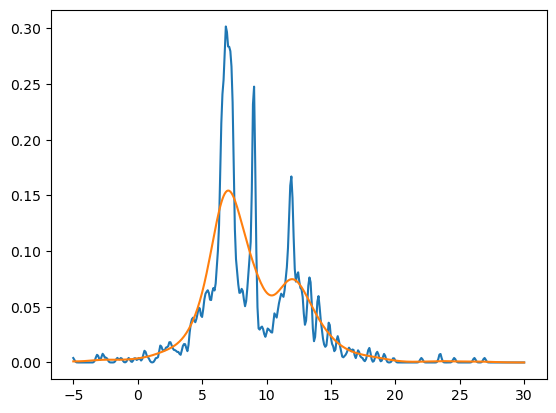

In [56]:
from sklearn.neighbors import KernelDensity

def kde_sklearn(data, bandwidth = 1.0):
    kde_skl = KernelDensity(bandwidth = bandwidth)
    kde_skl.fit(data[:, np.newaxis])
    log_pdf = kde_skl.score_samples(xgrid[:, np.newaxis]) # sklearn returns log(density)
    return np.exp(log_pdf)

xgrid =np.linspace(-5,30,400)
pdf = kde_sklearn(x,bandwidth=0.1)   # the function returns an array defined over 400 points
plt.plot(xgrid,pdf)
pdf = kde_sklearn(x,bandwidth=1)
plt.plot(xgrid,pdf)
#plt.hist(x,bins=100)

**KDE** is a non-parametric way to estimate the probability density function (PDF) of a dataset. Think of it as a smoothed histogram.

Instead of binning points like in a histogram, KDE:
- Places a kernel (typically a Gaussian) on each data point.
- The kernel is a little "bump" centered on the point.

All these bumps are added together to form a smooth curve. The bandwidth controls the width of the bump:
- Small bandwidth: too wiggly (overfits).
- Large bandwidth: too flat (underfits).

**GridSearchCV** is an algorithm used to automatically find the best parameters for a model by exhaustively testing combinations of hyperparameters using cross-validation.

- You define a model (e.g. KernelDensity()).
- You define a parameter grid (e.g. different bandwidth values).
- It splits your data into K folds (e.g. 5 for 5-fold CV).

For each parameter combination: 

- It trains the model on K-1 folds.
- It evaluates on the remaining fold.
- Repeats this for each of the K folds.
- Averages the performance (e.g. log-likelihood for KDE).
- It selects the parameter set with the best average score.



In [52]:
# Performing bandwidth selection for Kernel Density Estimation (KDE) using cross-validation.
from sklearn.model_selection import GridSearchCV

bwrange = np.linspace(0.01,1.0, 40) # Test 40 bandwidths from 0.1 to 1.0
#print(bwrange)
K = 5 # Do 5-fold cross validation
grid = GridSearchCV(KernelDensity(), {'bandwidth': bwrange}, cv= K) # Try each bandwidth with K-folds
grid.fit(x[:, None]) #Fit the histogram data that we started the lecture with.
h_opt = grid.best_params_['bandwidth']
print(h_opt)

0.41615384615384615


Note this is a grid search, not a root finder. It just a convenient wrapper to try all bandwidths and return the best one. 

For difficult things, you might need a root finder (how you find a maximum? We've done it at lenght!)

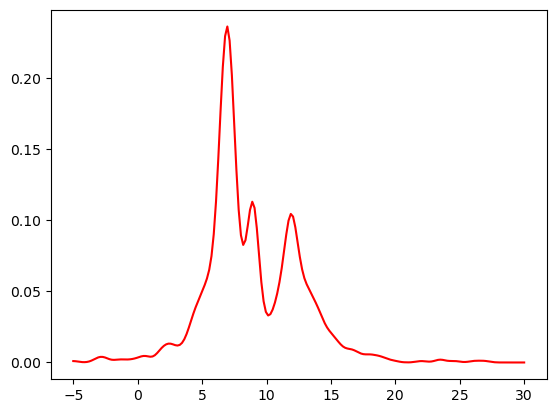

In [53]:
pdf = kde_sklearn(x,bandwidth=h_opt)
plt.plot(xgrid,pdf,c='red');

**Cross-Validation — What's Happening Internally?**

Let’s break it down with an example. Suppose:

- You have 100 data points.
- You use 5-fold cross-validation.
- You test one candidate bandwidth, say $h=0.2$

Here’s what scikit-learn does internally:
For Each Fold (5 total folds):

- Split the data:

  80 points → training set

  20 points → validation set

- Fit KDE on the training set:

  It stores the 80 training points.

  It remembers the current bandwidth $h=0.2$

- Evaluate log-likelihood on the validation set:

  For each point $x_{val}$ in the 20 validation points:

  Compute the KDE estimate $f^h(x_{val})$

  Compute the log-likelihood: $\log f^h(x_{val})$
        Sum these log-likelihoods over the 20 points

- Repeat for all 5 folds:

  So you get 5 log-likelihood sums.

- Average them:

  This gives the mean log-likelihood for this bandwidth $h$.

This above is repeated for every value in bwrange (like $h=0.01$, $h=0.02$, .., $h=1$)
You get a score (average log-likelihood) for each.

The bandwidth $h$ with the highest average log-likelihood across folds is chosen as h_opt.


**Why use K-fold cross-validation instead of just computing the log-likelihood of all points for each bandwidth?**

Then you're testing on the same data you trained on. This leads to:

- Overfitting the noise in the data for small bandwidths.
- Too-optimistic log-likelihood scores, especially for small hh, where the estimate spikes around each point.
- Choosing a bandwidth that's too small, giving a spiky, non-generalizable density.

With K-fold cross-validation, for each bandwidth $h$, you:

- Fit KDE only on the training subset (e.g., 80% of data),
- Evaluate the log-likelihood on a separate validation fold (the 20% held out),
- Repeat this K times and average.

This gives:

- A much more realistic estimate of performance on unseen data.
- Penalizes bandwidths that overfit (i.e., small $h$).
- Rewards bandwidths that generalize well (i.e., balance smoothness and accuracy).
  

# Clustering <a class="anchor" id="two"></a>

> *[Clustering](https://en.wikipedia.org/wiki/Cluster_analysis) algorithms attempt to group together similar objects in a data set.* 

This process allows us to put new objects into the resulting classes and to identify rare objects that do not fit any particular mold. **Clustering is inherently an "unsupervised" process** as we do not know the classification of the objects. Since we have no metric for determining when we are right, it is a bit of a dark art, but it also can be very powerful. Scikit-Learn's clustering suite is summarized at [http://scikit-learn.org/stable/modules/clustering.html](http://scikit-learn.org/stable/modules/clustering.html).

### $K$-Means Clustering <a class="anchor" id="twoa"></a>

We start with [$K$-means clustering](http://scikit-learn.org/stable/modules/generated/sklearn.cluster.KMeans.html), which is one of the simplest methods.  $K$-means seeks to minimize the following

$$\sum_{k=1}^{K}\sum_{i\in C_k}||x_i - \mu_k||^2$$

where $\mu_k = \frac{1}{N_k}\sum_{i\in C_k} x_i$

In words, this says to
  * Take every object in class $C_k$ (as determined by which centroid it is closest to, specifically $C_k(x_i) = \arg \min_k ||x_i-\mu_k||)$
  * Compute the mean of the objects in that class
  * Subtract that mean from each member of that class and square the norm
  * Do that for each class and sum
  * Shift the centroids of the *pre-determined* number of classes until this sum is minimized
  * Do this multiple times with different starting centroids and take the result with the minimum sum
  


K-means works iteratively through these main steps:
1. Initialize centroids: pick K initial cluster centroids. Usually, they’re chosen randomly from the data points (or using methods like K-means++ for better initial guesses).

2. Assignment step. For each point in the dataset:

    - Calculate the distance (usually Euclidean) from the point to each centroid.

    - Assign the point to the cluster with the nearest centroid.

3. Update step. For each cluster:

    - Recalculate the centroid as the mean of all points assigned to that cluster.

4. Repeat steps 2 and 3 until:

    - Cluster assignments don’t change anymore, or

    - The centroids don’t move significantly, or

    - You hit a maximum number of iterations.

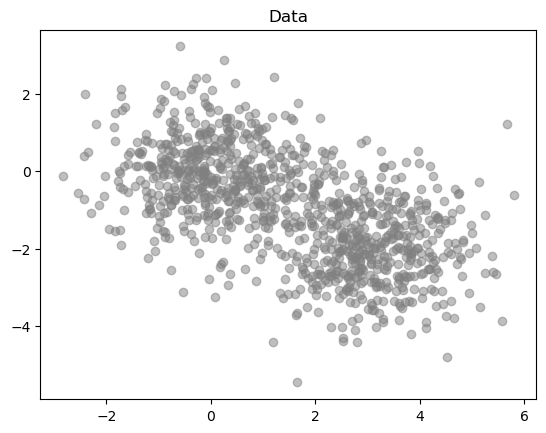

In [92]:
# Generate mock data

mode1= np.random.normal(size=(500,2))
mode2= np.random.normal(loc=[3.0,-2.0], size=(500,2))

#X = np.random.normal(size=(1000,2)) #1000 points in 2D
X = np.concatenate([mode1,mode2]) # 1000  points in 2D

plt.title('Data')
plt.scatter(X[:,0],X[:,1],color='gray',alpha=0.5)


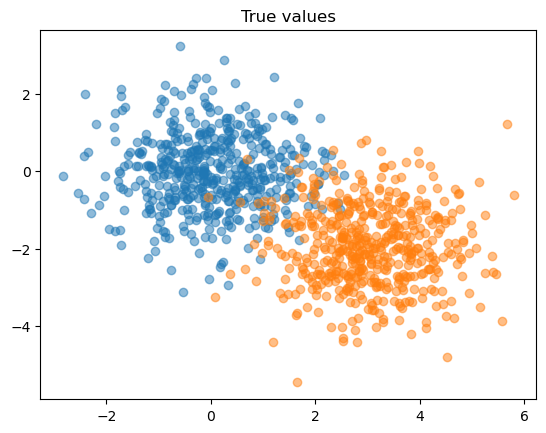

In [93]:
plt.title('True values')
plt.scatter(mode1[:,0],mode1[:,1],color='C0',alpha=0.5)
plt.scatter(mode2[:,0],mode2[:,1],color='C1',alpha=0.5);


A typical scikit-learn call will look something like this

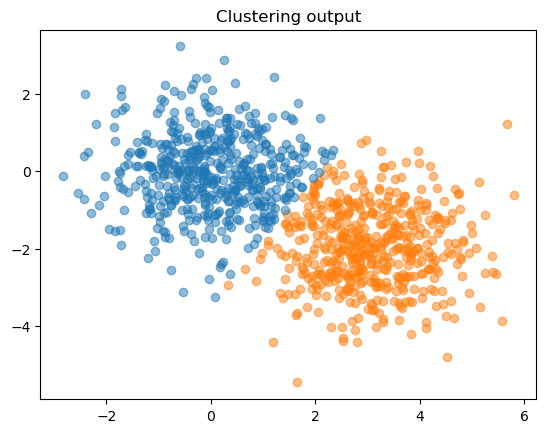

In [94]:

from sklearn.cluster import KMeans
from sklearn import preprocessing

clf = KMeans(n_clusters=2,n_init='auto') #Try 2 clusters to start with
clf.fit(X)
centers = clf.cluster_centers_ #location of the clusters
labels = clf.predict(X) #labels for each of the points     THIS IS THE CLUSTERING RESULT

# plot the data color-coded by cluster id
colors = ['C1', 'C0', 'C2']
for ii in range(2):
    plt.scatter(X[labels==ii,0], X[labels==ii,1], 
                color=colors[ii],alpha=0.5)

# To get some information on these try:
# KMeans?
# help(clf)
plt.title('Clustering output');

In [95]:
print(labels)

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 0 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 0 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 0 1 1 1 1 0 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 

The algorithm does a pretty good job, but it's not perfect

Compute the confusion matrix (but remember this is an **unsupervised** method: we didn't use the true labels in any way).

In [96]:
confusion_matrix = np.zeros([2,2])
for i in range(500): # points of the first class
    j = labels[i]
    confusion_matrix[0,j] += 1
for i in range(500,1000): # points of the second class
    j = labels[i]
    confusion_matrix[1,j] += 1

# KMeans assigns arbitrary integer labels (e.g., 0 and 1), but it doesn’t know which cluster corresponds to which true class. So:
# label 0 might refer to the first true class or the second — it’s random.
# The confusion matrix built this way can be flipped (rows still represent true classes, but columns might not represent the predicted classes in the same order).

print(confusion_matrix)

[[ 18. 482.]
 [478.  22.]]


Here is an example of **K-means clustering on some multi-dimensional data**.

In [10]:
# Execute the next few cells
from astropy.table import Table
t = Table.read('./data/cruz_all_dist.dat', format="ascii")

# Turn these data into a properly formatted Scikit-Learn array
X = np.vstack([ t['col2'], t['col3'], t['col4'], t['col5'] ]).T
print(X)

[[13.03636039 -0.11023487  9.04241732  0.        ]
 [13.33267828 -0.10360584  9.35453197  0.68184119]
 [13.14338559 -0.16142859  9.30932842  0.82017946]
 ...
 [ 6.77437708 -0.12553107  5.54210446  7.41862726]
 [ 6.71834403  0.04474092  5.56965196  7.44040775]
 [ 7.02729337  0.12547728  5.55979252  7.49615526]]


This is multi-dimensional data, which is tough to visualize in terms of the raw data and the clusters. Let's do some quick dimensional reduction-- we'll look at this in detail in a few lectures.

Text(0, 0.5, 'Eigenvalue 2')

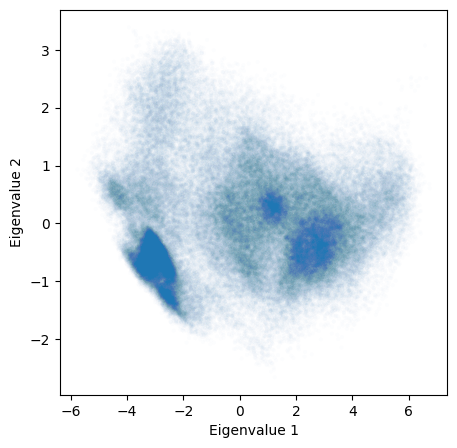

In [11]:
# Project onto 2 axes with PCA
from sklearn.decomposition import PCA
pca = PCA(n_components=2) # 2 components
pca.fit(X) # Do the fitting


fig = plt.figure(figsize=(5, 5))
ax = fig.add_subplot()


X_reduced = pca.transform(X)

ax.scatter(X_reduced[:,0], X_reduced[:,1], 
            marker=".", color='C0', 
            alpha=0.01, edgecolors='None')
ax.set_xlabel('Eigenvalue 1')
ax.set_ylabel('Eigenvalue 2')

The above image shows the data projected into **two linear combinations that encompass the directions of greatest variance**. We'll do $K$-means clustering in these dimensions.

In [12]:
# Compute the KMeans clustering
n_clusters = 6
scaler = preprocessing.StandardScaler()
clf = KMeans(n_clusters, n_init='auto')
clf.fit(scaler.fit_transform(X_reduced))

KMeans(n_clusters=6, n_init='auto')

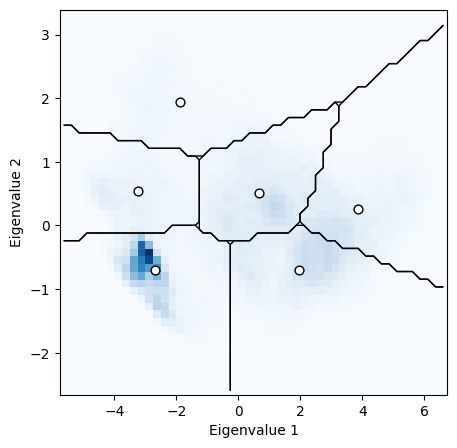

In [13]:
# Make some plots
fig = plt.figure(figsize=(5, 5))
ax = fig.add_subplot()

# Compute a 2D histogram  of the input
H, xedges, yedges = np.histogram2d(X_reduced[:,0], X_reduced[:,1], 50)

# plot density
ax.imshow(H.T, origin='lower', interpolation='nearest', aspect='auto',
          extent=[xedges[0], xedges[-1],
                  yedges[0], yedges[-1]],
          cmap='Blues')

# plot cluster centers
cluster_centers = scaler.inverse_transform(clf.cluster_centers_)
ax.scatter(cluster_centers[:, 0], cluster_centers[:, 1],
           s=40, c='w', edgecolors='k')

# plot cluster boundaries
x_centers = 0.5 * (xedges[1:] + xedges[:-1])
y_centers = 0.5 * (yedges[1:] + yedges[:-1])

Xgrid = np.meshgrid(x_centers, y_centers)
Xgrid = np.array(Xgrid).reshape((2, 50 * 50)).T

H = clf.predict(scaler.transform(Xgrid)).reshape((50, 50))

for i in range(n_clusters):
    Hcp = H.copy()
    flag = (Hcp == i)
    Hcp[flag] = 1
    Hcp[~flag] = 0

    ax.contour(x_centers, y_centers, Hcp, [-0.5, 0.5],
               linewidths=1, colors='k')

    H = clf.predict(scaler.transform(Xgrid)).reshape((50, 50))
    
ax.set_xlim(xedges[0], xedges[-1])
ax.set_ylim(yedges[0], yedges[-1])

ax.set_xlabel('Eigenvalue 1')
ax.set_ylabel('Eigenvalue 2')

plt.show()

The above figure displays the underlying density of samples, the cluster centers, and the cluster boundaries! Very powerful!

### Mean-shift Clustering <a class="anchor" id="twob"></a>

**Mean-shift clustering** works by finding the modes in a kernel density estimator of the distribution. Clustering is achieved by the ***mean-shift algorithm***:

1. The KDE of the dataset is computed.
2. This allows the gradient of the distribution to be calculated. Easy to do since it's a bunch of overlapping Gaussians.
3. Each data point is shifted in the direction of increasing gradient, which drives the points toward the modes. 
4. This process is iterated until all points have converged with clusters of other points at each of several distinct modes.
5. Each data point is then associated with a cluster of other points.


Let's try this using the same dataset as in $K$-means.

In [14]:
# Compute the Mean-shift clustering
from sklearn.cluster import MeanShift

scaler = preprocessing.StandardScaler()
bandwidth = 0.4
#bandwidth = estimate_bandwidth(X_reduced) # this takes a long time...beware
ms = MeanShift(bandwidth=bandwidth, 
               bin_seeding=True, 
               cluster_all=False)
ms.fit(scaler.fit_transform(X_reduced))

MeanShift(bandwidth=0.4, bin_seeding=True, cluster_all=False)

[-1  0  1  2  3  4  5  6]
0.4
number of estimated clusters : 7


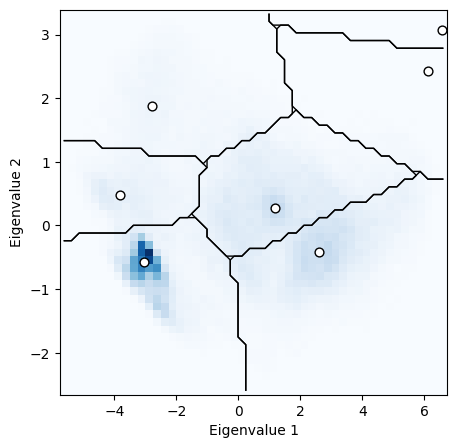

In [15]:
labels_unique = np.unique(ms.labels_)
n_clusters = len(labels_unique[labels_unique >= 0])
print(labels_unique)
print(bandwidth)
print("number of estimated clusters :", n_clusters)

# Make some plots
fig = plt.figure(figsize=(5, 5))
ax = fig.add_subplot()

# Compute a 2D histogram  of the input
H, xedges, yedges = np.histogram2d(X_reduced[:,0], X_reduced[:,1], 50)

# plot density
ax.imshow(H.T, origin='lower', interpolation='nearest', aspect='auto',
          extent=[xedges[0], xedges[-1],
                  yedges[0], yedges[-1]],
          cmap='Blues')

# plot cluster centers
cluster_centers = scaler.inverse_transform(ms.cluster_centers_)
ax.scatter(cluster_centers[:, 0], cluster_centers[:, 1],
           s=40, c='w', edgecolors='k')

# plot cluster boundaries
x_centers = 0.5 * (xedges[1:] + xedges[:-1])
y_centers = 0.5 * (yedges[1:] + yedges[:-1])

Xgrid = np.meshgrid(x_centers, y_centers)
Xgrid = np.array(Xgrid).reshape((2, 50 * 50)).T

H = ms.predict(scaler.transform(Xgrid)).reshape((50, 50))

for i in range(n_clusters):
    Hcp = H.copy()
    flag = (Hcp == i)
    Hcp[flag] = 1
    Hcp[~flag] = 0

    ax.contour(x_centers, y_centers, Hcp, [-0.5, 0.5],
               linewidths=1, colors='k')
 
    H = ms.predict(scaler.transform(Xgrid)).reshape((50, 50))
    
ax.set_xlim(xedges[0], xedges[-1])
ax.set_ylim(yedges[0], yedges[-1])

ax.set_xlabel('Eigenvalue 1')
ax.set_ylabel('Eigenvalue 2')

plt.show()

Mean-shift will not only estimate cluster centers and boundaries, but also the number of clusters!

-----
-----

**Disclaimer** Here below is something I (probably) won't have time to cover, but I'll leave it here in case you need it in your research (looking at you my cosmology friend). At least you know where to start from. And there's a nice example with quasars and galaxies, together with a sweet application of bootstrapping...

-----
-----

## Correlation functions <a class="anchor" id="three"></a>

> ***Correlation functions*** *tell us how far (and on what scales) a distribution of data samples differs from a random distribution.*

They have been used extensively in astrophysics, e.g., 
- examining fluctuations and structure on varying scales of the galaxy density distribution in terms of luminosity, galaxy type, age of the Universe.
- examining the two-point correlation function of temperature fluctuations of the cosmic microwave background to unveil the composition of the Universe.
- searching for long-timescale correlations in time-series data to examine noise in AGN lightcurves or find GW signals in pulsar-timing data.


![](https://www.astroml.org/_images/fig_corr_diagram_1.png)


One of the most prominent is the **two-point correlation function** which characterizes the excess probability of finding pairs of points at varying separations when compared to a random distribution. It can be described in terms of the power spectrum of fluctuations, $P(k)$ where $k=2\pi/\lambda$ and $\lambda$ is the scale/wavelength of the fluctuation:

$$ \xi(r) = \frac{1}{2\pi^2}\int dk\, k^2 P(k)\frac{\sin(kr)}{kr}.$$

This correlation function can be used to describe the density fluctuations of sources by

$$ \xi(r) = \left\langle \frac{\delta\rho(x)}{\rho}\frac{\delta\rho(x+r)}{\rho}\right\rangle,$$

where $\delta\rho(x)/\rho = (\rho-\bar\rho)/\rho$ is the density contrast relative to the mean $\bar\rho$ at position $x$.

In many situations in astronomy or cosmology, the spatial correlation function or angular correlation function is modeled as a power-law, e.g. $w(\theta) = (\theta/\theta_0)^\delta$ (this is astronomy after all, where power-laws rule supreme). Angular correlation functions are often used because we care about *projected structure* on different scales, rather than depth clustering, e.g., in the CMB this kind of angular clustering is indicative of fluctuations in the primordial density field that can unveil the composition of the Universe at the time of last scattering.

Higher $n$-point correlation functions can be computed (see the image above), but the two-point function is the most common. Why? When dealing with large populations of sources spread across the Universe, we can often invoke the central limit theorem to describe the statistical distribution of sources-- hence **correlations can be approximated as obeying Gaussian statistics, which are entirely defined by the mean and two-point correlators (i.e. the variance)**.

In [25]:
# Execute this cell to implement AstroML's two-point correlation function on some random data
from astroML.correlation import two_point_angular

RA = 40 * np.random.random(1000)
DEC = 10 * np.random.random(1000) # ra and dec in degrees

bins = np.linspace(0.1, 10.0, 11) # edges for the 10 bins to evaluate
corr = two_point_angular(RA, DEC, bins, method='landy-szalay')
print(corr)

[-0.03403874  0.00417118 -0.0078108   0.00966819  0.00328674 -0.00535222
 -0.00236845 -0.01210325 -0.00981953  0.01292201]


Now try the example from Figure 6.17 of the textbook. This computes the angular correlation function for a subset of the SDDS spectroscopic galaxy sample in the range $0.08<z<0.12$. This may take a minute or so to run.

data size:
  red gals:  38017
  blue gals: 16883
@pickle_results: using precomputed results from 'correlation_functions.pkl'


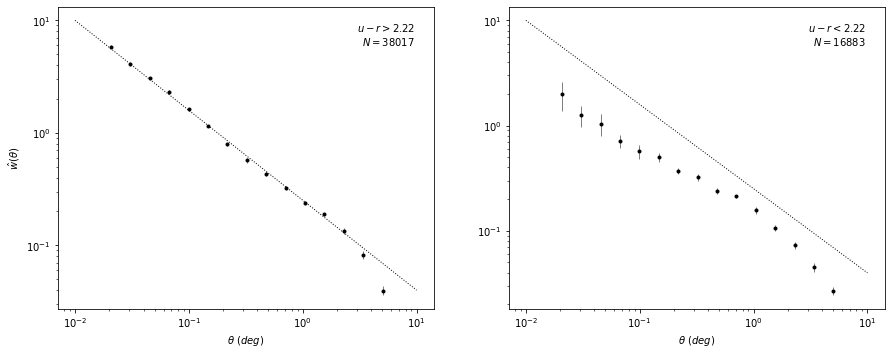

In [26]:
# Author: Jake VanderPlas
# License: BSD
#   The figure produced by this code is published in the textbook
#   "Statistics, Data Mining, and Machine Learning in Astronomy" (2013)
#   For more information, see http://astroML.github.com
#   To report a bug or issue, use the following forum:
#    https://groups.google.com/forum/#!forum/astroml-general

from __future__ import print_function, division

from astroML.utils.decorators import pickle_results
from astroML.datasets import fetch_sdss_specgals
from astroML.correlation import bootstrap_two_point_angular

#------------------------------------------------------------
# Get data and do some quality cuts
data = fetch_sdss_specgals()
m_max = 17.7

# redshift and magnitude cuts
data = data[data['z'] > 0.08]
data = data[data['z'] < 0.12]
data = data[data['petroMag_r'] < m_max]

# RA/DEC cuts
RAmin, RAmax = 140, 220
DECmin, DECmax = 5, 45
data = data[data['ra'] < RAmax]
data = data[data['ra'] > RAmin]
data = data[data['dec'] < DECmax]
data = data[data['dec'] > DECmin]

ur = data['modelMag_u'] - data['modelMag_r']
flag_red = (ur > 2.22)
flag_blue = ~flag_red

data_red = data[flag_red]
data_blue = data[flag_blue]

print("data size:")
print("  red gals: ", len(data_red))
print("  blue gals:", len(data_blue))


#-----------------------------------------------------------
# Set up correlation function computation
#  This calculation takes a long time with the bootstrap resampling,
#  so we'll save the results.
@pickle_results("correlation_functions.pkl")
def compute_results(Nbins=16, Nbootstraps=10,  method='landy-szalay', rseed=0):
    np.random.seed(rseed)
    bins = 10 ** np.linspace(np.log10(1 / 60.), np.log10(6), 16)

    results = [bins]
    for D in [data_red, data_blue]:
        results += bootstrap_two_point_angular(D['ra'],
                                               D['dec'],
                                               bins=bins,
                                               method=method,
                                               Nbootstraps=Nbootstraps)

    return results

(bins, r_corr, r_corr_err, r_bootstraps,
 b_corr, b_corr_err, b_bootstraps) = compute_results()

bin_centers = 0.5 * (bins[1:] + bins[:-1])

#------------------------------------------------------------
# Plot the results
corr = [r_corr, b_corr]
corr_err = [r_corr_err, b_corr_err]
bootstraps = [r_bootstraps, b_bootstraps]
labels = ['$u-r > 2.22$\n$N=%i$' % len(data_red),
          '$u-r < 2.22$\n$N=%i$' % len(data_blue)]

fig = plt.figure(figsize=(14, 6))
fig.subplots_adjust(bottom=0.2, top=0.9,
                    left=0.13, right=0.95)

for i in range(2):
    ax = fig.add_subplot(121 + i, xscale='log', yscale='log')

    ax.errorbar(bin_centers, corr[i], corr_err[i],
                fmt='.k', ecolor='gray', lw=1)

    t = np.array([0.01, 10])
    ax.plot(t, 10 * (t / 0.01) ** -0.8, ':k', linewidth=1)

    ax.text(0.95, 0.95, labels[i],
            ha='right', va='top', transform=ax.transAxes)
    ax.set_xlabel(r'$\theta\ (deg)$')
    if i == 0:
        ax.set_ylabel(r'$\hat{w}(\theta)$')


plt.show()

The left panel shows red galaxies with $u-r>2.22$ and the right panel shows blue galaxies with $u-r<2.22$. Uncertainties are derived from $10$ bootstrap samplings (do you remember boostrapping? If not see previous lecture...). There is significantly greater correlation structure on small angular scales in red galaxies than in blue galaxies. 

With tens of thousands of galaxies in each sample, this code has been optimized using **Scikit-Learn's ball-tree method for computing the correlation function-- further details given in Chapter 2, Section 2.52**.

# Dimensional Reduction: I

*Davide Gerosa (Milano-Bicocca)* 

##### Reading:

- [Textbook](http://press.princeton.edu/titles/10159.html) Chapter 7.

This course is based on previous work by many people. See [here]((https://github.com/dgerosa/astrostatistics_bicocca_2024/blob/main/README.md) for credits.


## Curse of Dimensionality <a class="anchor" id="one"></a>

You really want to buy a car. Like, right now--you don't want to wait. But... you are picky, and have certain things that you would like it to have. 

Each of those things has a probability between 0 and 1 of being on the the car dealer's lot. You want a red car, which has a probability of being on the lot of $p_{\rm red}$; you want good gas mileage, $p_{\rm gas}$; you want leather seats, $p_{\rm leather}$; and you want a sunroof, $p_{\rm sunroof}$. The probability that the dealer has a car on the lot that meets all of those requirements is 

$$p_{\rm red} \times p_{\rm gas} \times p_{\rm leather} \times p_{\rm sunroof},$$

or $p^n$ where $n$ is the number of features (assuming equal probability for each).

If the probability of each of these is $50\%$, then the probability of you driving off with your car of choice is **only $0.5\times0.5\times0.5\times0.5 = 0.0625$**. Not very good. Imagine if you also wanted other things. **This is the [Curse of Dimensionality](https://en.wikipedia.org/wiki/Curse_of_dimensionality).**

Let's illustrate the curse of dimensionality with two figures from [here.](https://medium.freecodecamp.org/the-curse-of-dimensionality-how-we-can-save-big-data-from-itself-d9fa0f872335)

* **In the first example we are trying to find a box holding some treasure, which gets harder and harder with more dimensions, despite there just being 5 boxes in each dimension:**
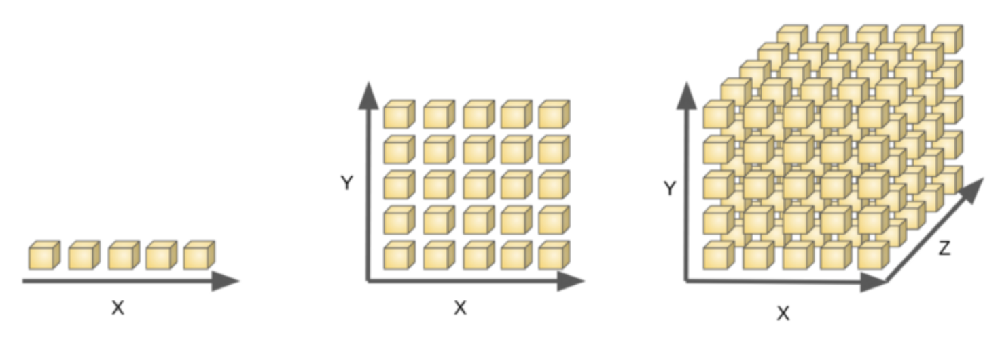

* **In the next example we inscribe a circle in a square. The area outside of the circle grows larger and larger as the number of dimensions increase:**
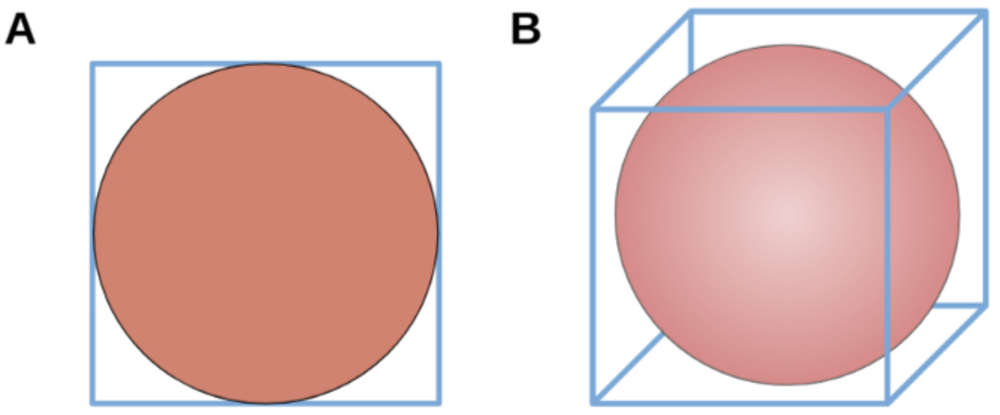

* Mathematically we can describe this as: 
> the more dimensions that your data span, the more points are needed to uniformly sample the space.  
* Another consequence of this is the general statement that most of the volume of a $D$-dimensional hypercube is in the corners!

Let's work this out mathematically and numerically. For $D$ dimensions with coordinates $[-1,1]$ (i.e. in a hypercube), the fraction of points in a hypersphere (with radius $r$, as illustrated above) is

$$f_D = \frac{V_D(r)}{(2r)^D} = \frac{\pi^{D/2}}{D2^{D-1}\Gamma(D/2)}$$

which tends to $0$ as $D$ tends to infinity! 

**This was a homework from a few lectures ago...** [Here](https://davidegerosa.com/nsphere/) is the solution, where I compute the volume with a Monte Carlo


D=2	N=1000000	N_in=785550	V=3.14220		Sol=3.14159		diff=0.00019	t=0.04s
D=3	N=1000000	N_in=523683	V=4.18946		Sol=4.18879		diff=0.00016	t=0.05s
D=4	N=1000000	N_in=309082	V=4.94531		Sol=4.93480		diff=0.00213	t=0.06s
D=5	N=1000000	N_in=163686	V=5.23795		Sol=5.26379		diff=0.00491	t=0.07s
D=6	N=1000000	N_in=080812	V=5.17197		Sol=5.16771		diff=0.00082	t=0.09s
D=7	N=1000000	N_in=037162	V=4.75674		Sol=4.72477		diff=0.00677	t=0.09s
D=8	N=1000000	N_in=015771	V=4.03738		Sol=4.05871		diff=0.00526	t=0.10s
D=9	N=1000000	N_in=006580	V=3.36896		Sol=3.29851		diff=0.02136	t=0.11s
D=10	N=1000000	N_in=002441	V=2.49958		Sol=2.55016		diff=0.01983	t=0.13s
D=11	N=1000000	N_in=000893	V=1.82886		Sol=1.88410		diff=0.02932	t=0.14s
D=12	N=1000000	N_in=000319	V=1.30662		Sol=1.33526		diff=0.02145	t=0.16s
D=13	N=1000000	N_in=000106	V=0.86835		Sol=0.91063		diff=0.04643	t=0.16s
D=14	N=1000000	N_in=000044	V=0.72090		Sol=0.59926		diff=0.20297	t=0.17s
D=15	N=1000000	N_in=000017	V=0.55706		Sol=0.38144		diff=0.46039	t=0.22s


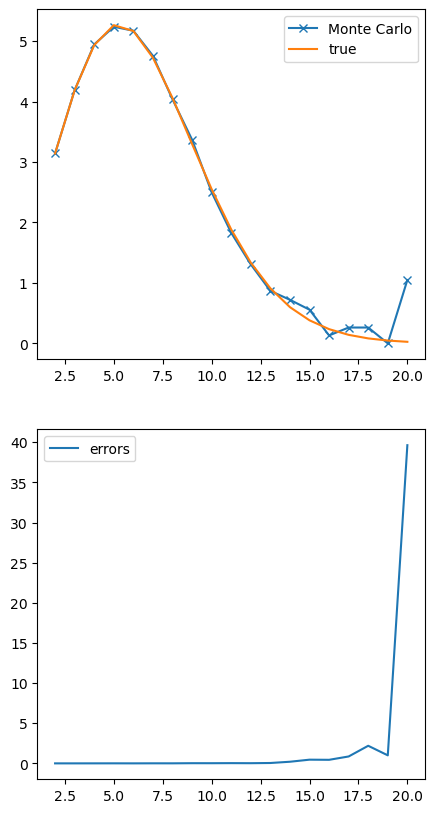

In [2]:
'''
Calculate the volume of the n-dimensional spehere a function of the dimension using a simple hit-or-miss Monte Carlo.
'''

from __future__ import print_function, division
import numpy as np
import scipy.special
import pylab as plt
import time

Dmax = 20 # Largest dimension
N = int(1e6) # Monte Carlo samples

data = []

for D in np.arange(2,Dmax+1): # Loop
    t0=time.time()

    all = np.random.uniform(-1,1, D*N).reshape(N,D) # Generate points in cube

    distance = np.sum(all**2,axis=1)**0.5 # Distance from cube center

    Ninside = np.sum(distance<=1) # Number of points within sphere
    fractioninside = Ninside/N # Fraction of points within sphere
    cube = 2**D # Volume of the cube (from -1 to 1)
    sphere = fractioninside * cube # Volume of the sphere

    solution = np.pi**(D/2) / scipy.special.gamma( D/2 + 1) # True value
    diff= np.abs(sphere-solution)/solution # Error

    t=time.time()-t0
    print("D=%i\tN=%i\tN_in=%06d\tV=%.5f\t\tSol=%.5f\t\tdiff=%.5f\tt=%.2fs" %(D,N,Ninside,sphere,solution,diff,t))

    data.append([D,sphere,solution,diff]) # Store data


# Plots...
dims, my,true,errors = np.array(data).T
fig, axs= plt.subplots(2, 1,figsize=(5,10))
axs[0].plot(dims,my,label='Monte Carlo',ls='-',marker='x')
axs[0].plot(dims,true,label='true',ls='-')
axs[1].plot(dims,errors,label='errors')
[ax.legend() for ax in axs]
plt.show()

* Note that this works in the opposite direction too: let's say you want to find "rare" objects in 10 dimensions, where we'll define rare as $<1\%$ of the population.
* Then you'll need to accept objects from $63\%$ of the distribution in all 10 dimensions! *Why $63\%$? Because it's the tenth root of $0.01$.* 
* So are those really "rare" or are they just a particular 1% of the population?

In [4]:
import numpy as np
# p^10 = 0.01, solve for p
p = (0.01)**(0.1)
print(p)

0.6309573444801932


*N.B. Dimensionality isn't just measuring $D$ features for $N$ objects. It could be a spectrum with $D$ values or an image with $D$ pixels, etc. In the book the examples used are spectra of galaxies from the SDSS project. But we can trivially insert data of our choice instead.*

For example: the SDSS comprises a sample of 357 million sources and each source has 448 measured attributes.
Let's normalize the data range to [-1,1]. On average, any box of volume 1 contains only $2^{448} / (357\times 10^{6})\sim 2$ sources!

See also [this article](https://towardsdatascience.com/the-curse-of-dimensionality-50dc6e49aa1e).

## Principal Component Analysis (PCA) <a class="anchor" id="two"></a>

In **[Principal Component Analysis (PCA)](https://en.wikipedia.org/wiki/Principal_component_analysis)** we seek to take a data set like the one shown below and apply a transform to the data such that the new axes are aligned with the maximal variance of the data. 

As can be seen in the Figure, this is basically just the same as doing *regression by minimizing the square of the perpendicular distances to the new axes*. Note that we haven't made any changes to the data, we have just defined new axes.  

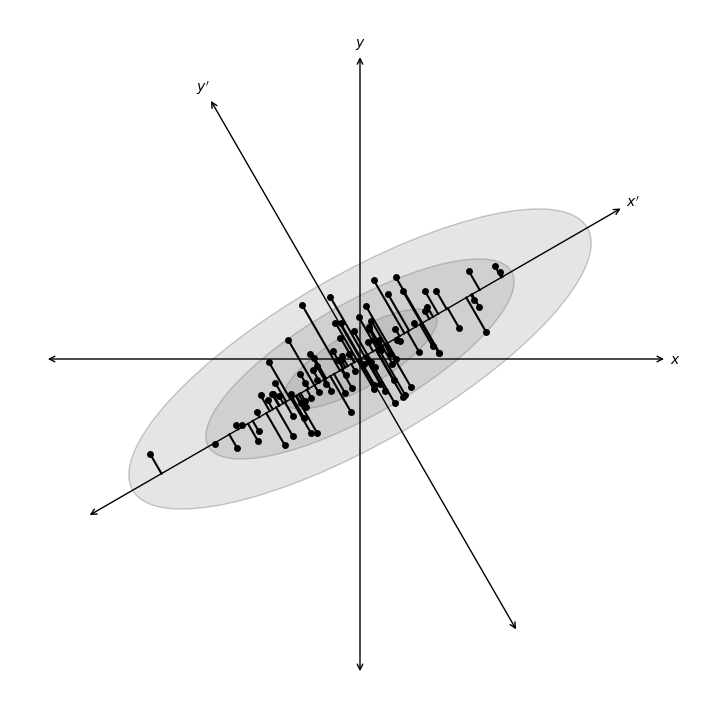

In [7]:
from matplotlib.patches import Ellipse

# Set parameters and draw the random sample
np.random.seed(42)
r = 0.9

sigma1 = 0.25
sigma2 = 0.08
rotation = np.pi / 6
s = np.sin(rotation)
c = np.cos(rotation)

X = np.random.normal(0, [sigma1, sigma2], size=(100, 2)).T
R = np.array([[c, -s],[s, c]])
X = np.dot(R, X) #Same data, now rotated by R matrix.

#------------------------------------------------------------
# Plot the diagram
fig = plt.figure(figsize=(7, 7), facecolor='w')
ax = plt.axes((0, 0, 1, 1), xticks=[], yticks=[], frameon=False)

# draw axes
ax.annotate(r'$x$', (-r, 0), (r, 0),
            ha='center', va='center',
            arrowprops=dict(arrowstyle='<->', 
                            color='k', lw=1))
ax.annotate(r'$y$', (0, -r), (0, r),
            ha='center', va='center',
            arrowprops=dict(arrowstyle='<->', 
                            color='k', lw=1))

# draw rotated axes
ax.annotate(r'$x^\prime$', (-r * c, -r * s), (r * c, r * s),
            ha='center', va='center',
            arrowprops=dict(color='k', 
                            arrowstyle='<->', 
                            lw=1))
ax.annotate(r'$y^\prime$', (r * s, -r * c), (-r * s, r * c),
            ha='center', va='center',
            arrowprops=dict(color='k', 
                            arrowstyle='<->', 
                            lw=1))

# scatter points
ax.scatter(X[0], X[1], s=25, 
           lw=0, c='k', zorder=2)

# draw lines
vnorm = np.array([s, -c])
for v in (X.T):
    d = np.dot(v, vnorm)
    v1 = v - d * vnorm
    ax.plot([v[0], v1[0]], [v[1], v1[1]], '-k')

# draw ellipses
for sigma in (1, 2, 3):
    ax.add_patch(Ellipse((0, 0), 2 * sigma * sigma1, 2 * sigma * sigma2,
                         angle=rotation * 180. / np.pi,
                         ec='k', fc='gray', alpha=0.2, zorder=1))

ax.set_xlim(-1, 1)
ax.set_ylim(-1, 1)

plt.show()

Note that the points are correlated along a particular direction which doesn't align with the initial choice of axes. So, we should rotate our axes to align with this correlation. 

We'll choose the rotation to maximize the ability to discriminate between the data points:
*   the first axis, or **principal component**, is the direction of maximal variance
*   the second principal component is orthogonal to the first component and maximizes the residual variance
*   ...

**PCA is a dimensional reduction process because we can generally account for *nearly all* of the variance in the data set with fewer than the original $K$ dimensions.** See more below.

### Derivation of PCA

We start with a data set $\{x_i\}$ that consists of $N$ objects for which we measure $K$ features. The data is initially prepared by subtracting the mean for each feature in $\{x_i\}$ and writing $X$ as a $N\times K$ matrix.

The covariance of this matrix is the $K\times K$ matrix

$$C_X=\frac{1}{N-1}X^T X.$$

(the $N-1$ term is Bessel's correction, the covariances are derived from the data themselves).

**There are off-diagonal terms if there are correlations between the measurements (e.g., maybe two of the features are temperature dependent and the measurements were taken at the same time).**


* If $R$ is a projection of the data that is aligned with the maximal variance, then we have $Y= X R$ with covariance 

$$ C_{Y} = \frac{1}{N-1} R^T X^T X R =  R^T C_X R.$$

* $r_1$ is the first principal component of $R$ (the first column) with the constraint $r_1^T r_1=1$. It can be derived using *Langrange multipliers* with the following cost function:

$$ \phi(r_1,\lambda_1) = r_1^TC_X r_1 - \lambda_1(r_1^Tr_1-1). $$

* If we take derivative of $\phi(r_1,\lambda)$ with respect to $r_1$ and set it to 0 (i.e., we extremize the cost function), then we have

$$ C_Xr_1 - \lambda_1 r_1 = 0. $$

* $\lambda_1$ (**the largest eigenvalue of the matrix**) is the root of the equation $\det(C_X -
\lambda_1 {\bf I})=0$ for which the eigenvalue is

$$ \lambda_1 =  r_1^T C_X r_1.$$

* The columns of the full matrix, $R$ are the **eigenvectors (known here as principal components)**.

* The diagonal values of $C_Y$ are the variance contained within each component.

We aren't going to go through the linear algebra more than that here, nor discuss the most efficient means of computation. See the end of 7.3.1 or go through [Karen Leighly's PCA lecture notes](http://seminar.ouml.org/lectures/principal-components-analysis/) if you want to walk through the math in more detail. **But PCA essentially boils down to eigen-analysis of data matrices, which I'm sure you have met previously in a math methods context.**

### Preparing data for PCA

1. Subtract the mean of each dimension/feature/column (to **"center"** the data)
2. Divide by the variance in each dimension/feature/column (to **"whiten"** the data)
3. (For spectra and images) normalize each sample/row to yield an integral of unity.

Below is a typical call to the PCA algorithm.  Note that this example is somewhat backwards.  We are starting with `X` and then we are making it higher dimensional--to create a mock high-$D$ data set.  Then we are applying PCA as a dimensionality reduction technique.

In [4]:
#Example call from 7.3.2
import numpy as np
from sklearn.decomposition import PCA

X = np.random.normal(size=(100,3)) # 100 points in 3D
R = np.random.random((3,10)) # projection matrix
X = np.dot(X,R) # X is now 10-dim, with 3 intrinsic dims

pca = PCA(n_components=4) # n_components can be optionally set
pca.fit(X) 

eigenvalues = pca.transform(X) # compute the subspace projection of X, 4 eigenvalues for each of the 100 samples
mean = pca.mean_ # length 10 mean of the data
eigenvectors = pca.components_ # 4x10 matrix of components, multiply each by respective eigenvalue to reconstruct

# Reconstruction of object1
# Xreconstruct[0] = mean + eigenvectors*eigenvalues[0]

print(eigenvalues.shape)
print(eigenvectors.shape)

(100, 4)
(4, 10)


To illustrate what is happening, here is a PCA reconstruction of handwritten "3s" from [Hastie et al.](https://web.stanford.edu/~hastie/ElemStatLearn/) :

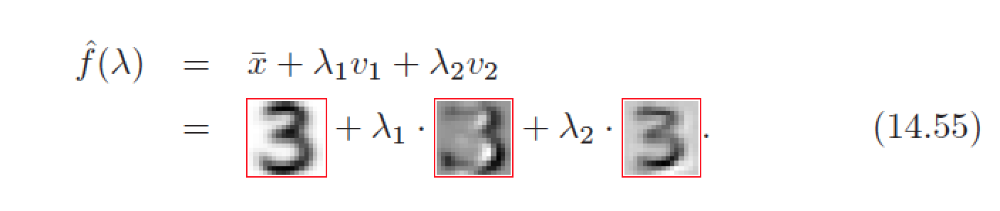

[Scikit-Learn's decomposition module](http://scikit-learn.org/stable/modules/classes.html#module-sklearn.decomposition) has a number of [PCA type implementations](http://scikit-learn.org/stable/modules/generated/sklearn.decomposition.PCA.html#sklearn.decomposition.PCA).

Let's now look at spectra of galaxies taken during the Sloan Digital Sky Survey.   In this sample there are 4000 spectra with flux measurements in 1000 bins.  15 example spectra are shown below and our example will use half of the spectra chosen at random.  

![Ivezic, Figure 7.1](http://www.astroml.org/_images/fig_spec_examples_1.png)

In [5]:
from sklearn.decomposition import PCA
#from sklearn.decomposition import RandomizedPCA

from astroML.datasets import sdss_corrected_spectra
from astroML.utils import pickle_results

#------------------------------------------------------------
# Download data
data = sdss_corrected_spectra.fetch_sdss_corrected_spectra()
spectra = sdss_corrected_spectra.reconstruct_spectra(data)
wavelengths = sdss_corrected_spectra.compute_wavelengths(data)
print('Number of spectra: ' + str(len(spectra)))
print('Number of wavelength bins: ' + str(len(wavelengths)))

#----------------------------------------------------------------------
# Compute PCA
np.random.seed(500)
nrows = 2000 # We'll just look at 2000 random spectra
n_components = 5 # Do the fit with 5 components, which is the mean plus 4
ind = np.random.randint(spectra.shape[0], size=nrows)

spec_mean = spectra[ind].mean(0) # Compute the mean spectrum, which is the first component
# spec_mean = spectra[:50].mean(0)

# use Randomized PCA for speed
# pca = RandomizedPCA(n_components - 1)
pca = PCA(n_components - 1, svd_solver='randomized')
pca.fit(spectra[ind])
pca_comp = np.vstack([spec_mean, pca.components_]) # Add the mean to the components
evals = pca.explained_variance_ratio_ 
print('Expained fractional variance of data encapsulated in the eigenvalues: ' + str(evals))

Number of spectra: 4000
Number of wavelength bins: 1000
Expained fractional variance of data encapsulated in the eigenvalues: [0.889316   0.06058311 0.02481432 0.01012148]


**Now let's plot the components (eigenvectors).** The left hand panels are just the *first 5 spectra for comparison* with the *first 5 PCA components*, which are shown on the right.  They are ordered by the size of their eigenvalues.

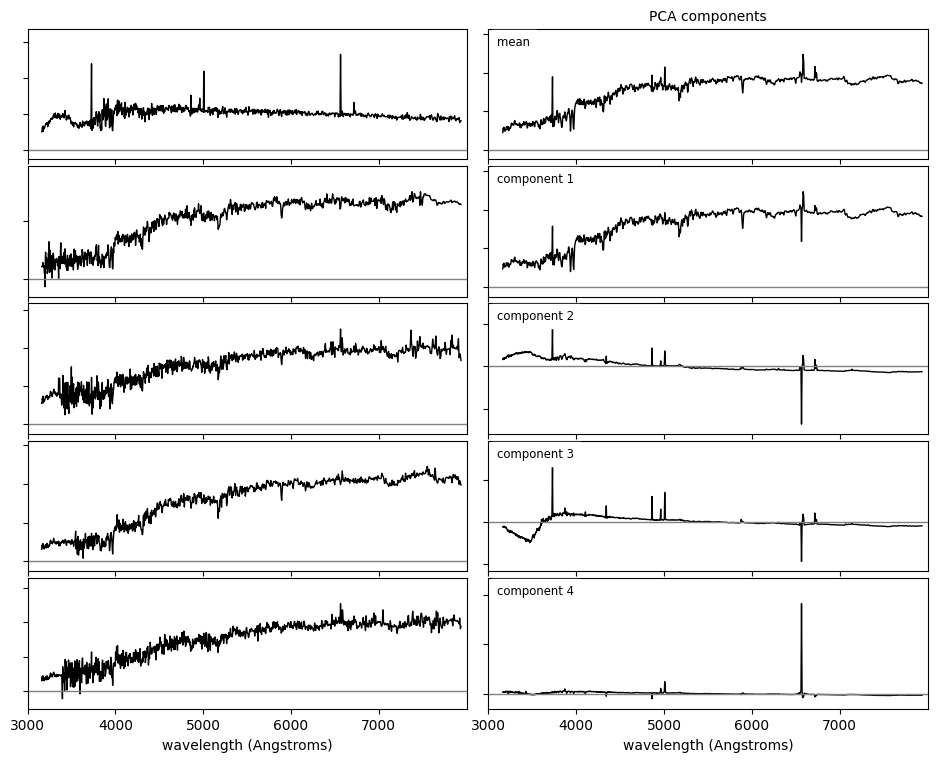

In [6]:
# Make plots
fig = plt.figure(figsize=(10, 8))
fig.subplots_adjust(left=0.05, right=0.95, wspace=0.05,
                    bottom=0.1, top=0.95, hspace=0.05)

titles = 'PCA components'

for j in range(n_components):
    
    # plot the components
    ax = fig.add_subplot(n_components, 2, 2*j+2)
    ax.yaxis.set_major_formatter(plt.NullFormatter())
    ax.xaxis.set_major_locator(plt.MultipleLocator(1000))
    
    if j < n_components - 1:
        ax.xaxis.set_major_formatter(plt.NullFormatter())
    else:
        ax.set_xlabel('wavelength (Angstroms)')
    ax.plot(wavelengths, pca_comp[j], '-k', lw=1)

    # plot zero line
    xlim = [3000, 7999]
    ax.plot(xlim, [0, 0], '-', c='gray', lw=1)
    ax.set_xlim(xlim)

    # adjust y limits
    ylim = plt.ylim()
    dy = 0.05 * (ylim[1] - ylim[0])    
    ax.set_ylim(ylim[0] - dy, ylim[1] + 4 * dy)

    # plot the first j spectra
    ax2 = fig.add_subplot(n_components, 2, 2*j+1)
    ax2.yaxis.set_major_formatter(plt.NullFormatter())
    ax2.xaxis.set_major_locator(plt.MultipleLocator(1000))
    if j < n_components - 1:
        ax2.xaxis.set_major_formatter(plt.NullFormatter())
    else:
        ax2.set_xlabel('wavelength (Angstroms)')
    ax2.plot(wavelengths, spectra[j], '-k', lw=1)
    
    # plot zero line
    ax2.plot(xlim, [0, 0], '-', c='gray', lw=1)
    ax2.set_xlim(xlim)

    if j == 0:
        ax.set_title(titles, fontsize='medium')
    if j == 0:
        label = 'mean'
    else:
        label = 'component %i' % j

    # adjust y limits
    ylim = plt.ylim()
    dy = 0.05 * (ylim[1] - ylim[0])    
    ax2.set_ylim(ylim[0] - dy, ylim[1] + 4 * dy)

    ax.text(0.02, 0.95, label, transform=ax.transAxes,
            ha='left', va='top', bbox=dict(ec='w', fc='w'),
            fontsize='small')

plt.show()

Now let's make **scree plots**.  These plots tell us how much of the variance is explained as a function of the each eigenvector.  Our plot won't look much like the textbook figure, so I've shown it below to explain where "scree" comes from.


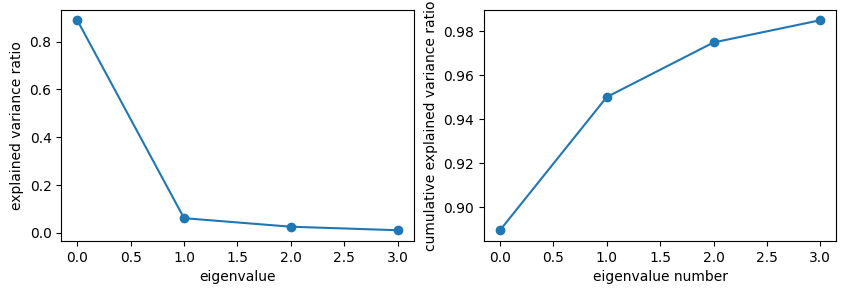

In [7]:
# Execute this cell
import numpy as np
from matplotlib import pyplot as plt

#----------------------------------------------------------------------
# Plot the results
fig = plt.figure(figsize=(10, 3))

ax = fig.add_subplot(121)

ax.plot(np.arange(n_components-1), evals)
ax.scatter(np.arange(n_components-1), evals)

ax.set_xlabel("eigenvalue")
ax.set_ylabel("explained variance ratio")

ax = fig.add_subplot(122)

ax.plot(np.arange(n_components-1), evals.cumsum())
ax.scatter(np.arange(n_components-1), evals.cumsum())

ax.set_xlabel("eigenvalue number")
ax.set_ylabel("cumulative explained variance ratio")

plt.show()

This is with many more components (Fig 7.5 in the textbook):
![Ivezic, Figure 7.5](http://www.astroml.org/_images/fig_eigenvalues_1.png)

How much of the variance is explained ([explained_variance_ratio_](https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.PCA.html)) by the first two components?

In [8]:
print("The first component explains {:.3f} of the variance in the data.".format(pca.explained_variance_ratio_[0]))
print("The second component explains {:.3f} of the variance in the data.".format(pca.explained_variance_ratio_[1]))
#print("All components explain {:.3f} of the variance in the data.".format(sum(pca.explained_variance_ratio_)))

The first component explains 0.889 of the variance in the data.
The second component explains 0.061 of the variance in the data.


***This is why PCA enables dimensionality reduction. We can use samples of measured data to train a data-driven basis that better explains it.***

How many components would we need to explain 99.5% of the variance?

In [9]:
for num_feats in np.arange(1,20, dtype = int):
    pca = PCA(n_components=num_feats)
    pca.fit(spectra[ind])
    if (sum(pca.explained_variance_ratio_)>0.995):
        break
print("{:d} features are needed to explain 99.5% of the variance".format(num_feats))

8 features are needed to explain 99.5% of the variance


Note that we would need 1000 components to encode *all* of the variance (that is the number of wavelenght bins, i.e. the dimensionality of the initial problem).

There is a MUCH easier way to do this.  Just give it a number of components between 0 and 1 and it will interpret that as a percentage of the variance.

In [10]:
pca995 = PCA(n_components=0.995)
pca995.fit(spectra[ind])
print("{:d} features are needed to explain 99.5% of the variance".format(pca995.n_components_))

8 features are needed to explain 99.5% of the variance


If you ever use sklearn's PCA, note that if you give it a dataset that is too big, it won't do the full PCA, but rather an approximated one using the `svd_solver="randomized"`, but you can force it to use something else.

### Interpreting the PCA

- The output eigenvectors are ordered by their associated eigenvalues 
- The eigenvalues reflect the variance within each eigenvector
- The sum of the eigenvalues is total variance of the system
- The projection of each spectrum onto the first few eigenspectra is a compression of the data 

Once we have the eigenvectors, we can reconstruct an observed spectrum, ${x}(k)$, in the eigenvector basis, ${e}_i(k)$, as 

$$ \begin{equation}
  {x}_i(k) = {\mu}(k) + \sum_j^R \theta_{ij} {e}_j(k).
\end{equation}
$$

where $\theta_{ij}$ denote the feature amplitudes in the compressed basis. The above equation would give a full (perfect) reconstruction of the data since it uses all of the eigenvectors. But if we truncate (i.e., $j<R$), then we will have reduced the dimensionality while still reconstructing the data with relatively little loss of information.

For example, we started with $4000\times1000$ floating point numbers. If we can explain nearly all of the variance with $8$ eigenvectors, then we have reduced the problem to $4000\times8$ (the eigenspectra) + $8\times1000$ (the component weights) floating point numbers! 

We compressed the data to only $(4000\times8 + 8\times1000)/(4000\times1000)=1\%$ of what it  while retaining 99.5\% of the information! (BTW, this is the essence of how file compression works. Saying going from a wav file to mp3, where this is done in Fourier space).

Execute the next cell to see how the reconstruction improves by adding more components.

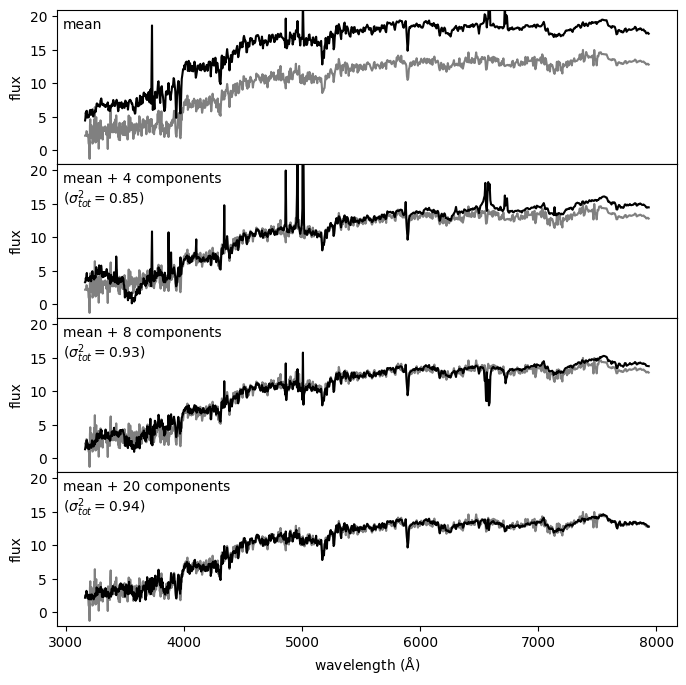

In [11]:
# Execute this cell
from sklearn.decomposition import PCA

from astroML.datasets import sdss_corrected_spectra
from astroML.decorators import pickle_results

#------------------------------------------------------------
# Download data
data = sdss_corrected_spectra.fetch_sdss_corrected_spectra()
spectra = sdss_corrected_spectra.reconstruct_spectra(data)
wavelengths = sdss_corrected_spectra.compute_wavelengths(data)

#------------------------------------------------------------
# Compute PCA components

# Eigenvalues can be computed using PCA as in the commented code below:

#from sklearn.decomposition import PCA
#pca = PCA()
#pca.fit(spectra)
#evals = pca.explained_variance_ratio_
#evals_cs = evals.cumsum()

#  because the spectra have been reconstructed from masked values, this
#  is not exactly correct in this case: we'll use the values computed
#  in the file compute_sdss_pca.py
evals = data['evals'] ** 2
evals_cs = evals.cumsum()
evals_cs /= evals_cs[-1]
evecs = data['evecs']
spec_mean = spectra.mean(0)

#------------------------------------------------------------
# Find the coefficients of a particular spectrum
spec = spectra[1]
coeff = np.dot(evecs, spec - spec_mean)

#------------------------------------------------------------
# Plot the sequence of reconstructions
fig = plt.figure(figsize=(8, 8))
fig.subplots_adjust(hspace=0)

for i, n in enumerate([0, 4, 8, 20]):
    ax = fig.add_subplot(411 + i)
    ax.plot(wavelengths, spec, '-', c='gray')
    ax.plot(wavelengths, spec_mean + np.dot(coeff[:n], evecs[:n]), '-k')

    if i < 3:
        ax.xaxis.set_major_formatter(plt.NullFormatter())

    ax.set_ylim(-2, 21)
    ax.set_ylabel('flux')

    if n == 0:
        text = "mean"
    elif n == 1:
        text = "mean + 1 component\n"
        text += r"$(\sigma^2_{tot} = %.2f)$" % evals_cs[n - 1]
    else:
        text = "mean + %i components\n" % n
        text += r"$(\sigma^2_{tot} = %.2f)$" % evals_cs[n - 1]

    ax.text(0.01, 0.95, text, ha='left', va='top', transform=ax.transAxes)

fig.axes[-1].set_xlabel(r'${\rm wavelength\ (\AA)}$')
plt.show()

### Caveats

* **PCA is a linear process**, whereas the variations in the data may not be.  So it may not always be appropriate to use and/or may require a relatively large number of components to fully describe any non-linearity.
* Note also that **PCA can be very impractical for large data sets** which exceed the memory per core as the computational requirement goes as $\mathscr{O}(D^3$) and the memory requirement goes as $\mathscr{O}(2D^2)$.


### How many components should I keep?

- We know how to answer this question already... Cross validation.  The answer of course depends on what you need to those components for.
- As a rule of thumb, one can use the scree plot and see where the curve becomes steep. If the gradient in the scree plot is close to zero, it means that adding more components doesn't add much new information. 


### Missing Data
We have assumed so far that there is no missing data (e.g., bad pixels in the spectrum, etc.).  But often the data set is incomplete. Once we have to PCAs, we can can actually use them to determine missing values.  

An example is shown below.
* Here, black are the observed spectra.
* Gray are the regions where we have no data.
* Blue is the PCA reconstruction, including the regions where there are no data. 

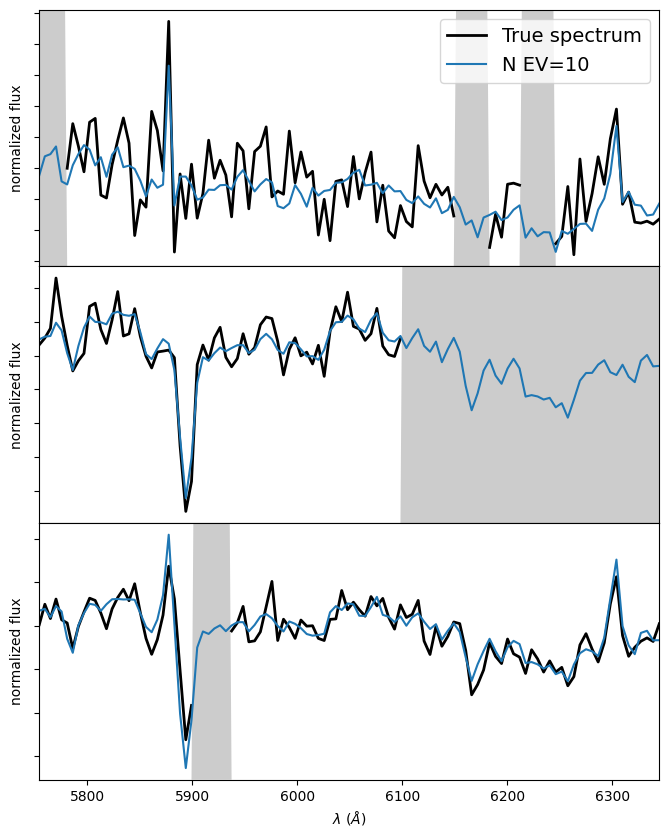

In [12]:
# Execute this cell
from matplotlib import ticker

from astroML.datasets import fetch_sdss_corrected_spectra
from astroML.datasets import sdss_corrected_spectra

#------------------------------------------------------------
# Get spectra and eigenvectors used to reconstruct them
data = fetch_sdss_corrected_spectra()
spec = sdss_corrected_spectra.reconstruct_spectra(data)
lam = sdss_corrected_spectra.compute_wavelengths(data)
evecs = data['evecs']
mu = data['mu']
norms = data['norms']
mask = data['mask']

#------------------------------------------------------------
# plot the results
i_plot = ((lam > 5750) & (lam < 6350))
lam = lam[i_plot]

specnums = [20, 8, 9]
subplots = [311, 312, 313]

fig = plt.figure(figsize=(8, 10))
fig.subplots_adjust(hspace=0)

for subplot, i in zip(subplots, specnums):
    ax = fig.add_subplot(subplot)

    # compute eigen-coefficients
    spec_i_centered = spec[i] / norms[i] - mu
    coeffs = np.dot(spec_i_centered, evecs.T)

    # blank out masked regions
    spec_i = spec[i]
    mask_i = mask[i]
    spec_i[mask_i] = np.nan

    # plot the raw masked spectrum
    ax.plot(lam, spec_i[i_plot], '-', color='k', lw=2,
            label='True spectrum')

    # plot reconstruction
    for nev in [10]:
        if nev == 0:
            label = 'mean'
        else:
            label = 'N EV=%i' % nev
        spec_i_recons = norms[i] * (mu + np.dot(coeffs[:nev], evecs[:nev]))
        ax.plot(lam, spec_i_recons[i_plot], label=label)

    # plot shaded background in masked region
    ylim = ax.get_ylim()
    mask_shade = ylim[0] + mask[i][i_plot].astype(float) * ylim[1]
    plt.fill(np.concatenate([lam[:1], lam, lam[-1:]]),
             np.concatenate([[ylim[0]], mask_shade, [ylim[0]]]),
             lw=0, fc='k', alpha=0.2)

    ax.set_xlim(lam[0], lam[-1])
    ax.set_ylim(ylim)
    ax.yaxis.set_major_formatter(ticker.NullFormatter())

    if subplot == 311:
        ax.legend(loc=1, prop=dict(size=14))

    ax.set_xlabel('$\lambda\ (\AA)$')
    ax.set_ylabel('normalized flux')

plt.show()

Which, if you ask me, is awesome.

How does this work? **PCA learns a data-driven basis that is a linear combination of features that best explain the observed data.** So it uses correlations across the features, which in this case are wavelengths. Those correlated features can be used to **interpolate across or reconstruct missing data**. 

The amplitudes of the reconstructed spectra in the compressed/PCA basis are given by

$$ \theta_i = \sum_j M^{-1}_{ij}F_j$$

where

$$ M_{ij} = \sum_k \mathbf{w}(k)\mathbf{e}_i(k)\mathbf{e}_j(k), \quad F_j = \sum_k \mathbf{w}(k)\mathbf{x}^\mathrm{obs}(k)\mathbf{e}_j(k)$$

and 
* $\sum_k$ sums over wavelengths or data features, 
* $\mathbf{x}^\mathrm{obs}(k)$ is the observed spectrum that is padded to include arbitrary entries for missing data, 
* $\mathbf{w}(k)$ are data weights that are $0$ for the missing data and $1/\sigma^2$ for the measured data, 
* $\mathbf{e}_i(k)$ are eigen-spectra.

With all of these in place, the PCA reconstruction of the missing data can be computed simply as $\sum_i \theta_i \mathbf{e}_i$.

The example that we have been using above is ***spectral PCA***.  Some examples from the literature include:
- [Francis et al. 1992](http://articles.adsabs.harvard.edu/cgi-bin/nph-iarticle_query?1992ApJ...398..476F&amp;data_type=PDF_HIGH&amp;whole_paper=YES&amp;type=PRINTER&amp;filetype=.pdf)
- [Connolly et al. 1995](http://articles.adsabs.harvard.edu/cgi-bin/nph-iarticle_query?1995AJ....110.1071C&amp;data_type=PDF_HIGH&amp;whole_paper=YES&amp;type=PRINTER&amp;filetype=.pdf)
- [Yip et al. 2004](http://iopscience.iop.org/article/10.1086/425626/meta;jsessionid=31BB5F11B85D2BF4180834DC71BA0B85.c3.iopscience.cld.iop.org)

## Astro examples

- Pusar profiles look like this (http://iopscience.iop.org/article/10.1086/425626/meta;jsessionid=31BB5F11B85D2BF4180834DC71BA0B85.c3.iopscience.cld.iop.org))
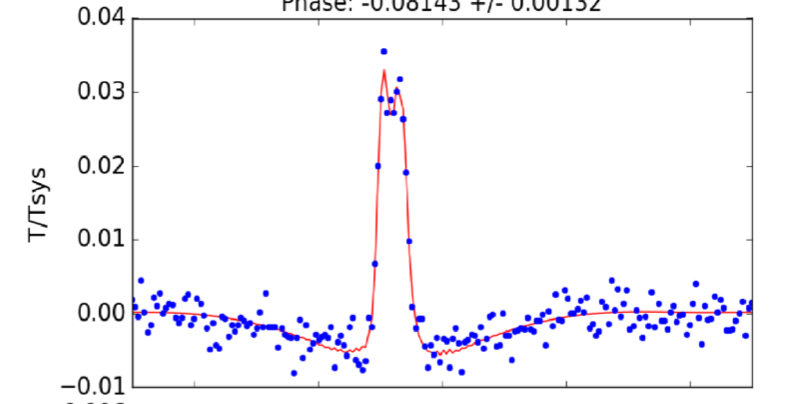

and these are the eigenpulses:
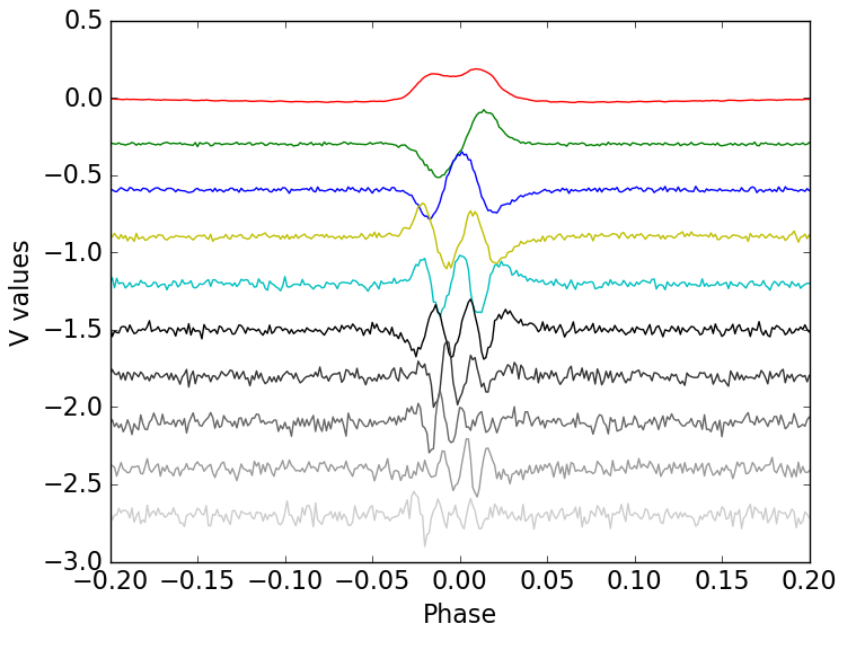

Both figures from [Yip et al. 2004].

- One can also do PCA on features that aren't ordered (as they were for the spectra).  E.g., if you have $D$ different parameters measured for your objects.  A classic example in astronomy is
[Boroson & Green 1992](http://articles.adsabs.harvard.edu/cgi-bin/nph-iarticle_query?1992ApJS...80..109B&amp;data_type=PDF_HIGH&amp;whole_paper=YES&amp;type=PRINTER&amp;filetype=.pdf), and other more recent examples use it to learn about [pulsar pulse-shape variations](https://arxiv.org/abs/1707.08581).

- Steve Taylor and I used PCA to learn a data-driven basis of binary black-hole demographic distributions for gravitational-wave population inference ([Taylor and Gerosa 2018]((https://arxiv.org/abs/1806.08365))).

- When detecting a signal, state-of-the-art gravitational-wave analysis make use of another tecnique called [matched filtering](https://en.wikipedia.org/wiki/Matched_filter) which, unfortunately, we do not have time to cover here. But PCA is used to classify instrumental artifacts, see e.g. [Powell et al 2005](https://arxiv.org/abs/1505.01299).

- For a more theory-driven thing, PCA can be used to disentangle the pletora of different **theories** that could give rise to quantum-inspired modifications of general relativity. Here you're doing dimensionality reduction in the space of physical theories, e.g. [Saleem et al 2021](https://arxiv.org/pdf/2110.10147.pdf)


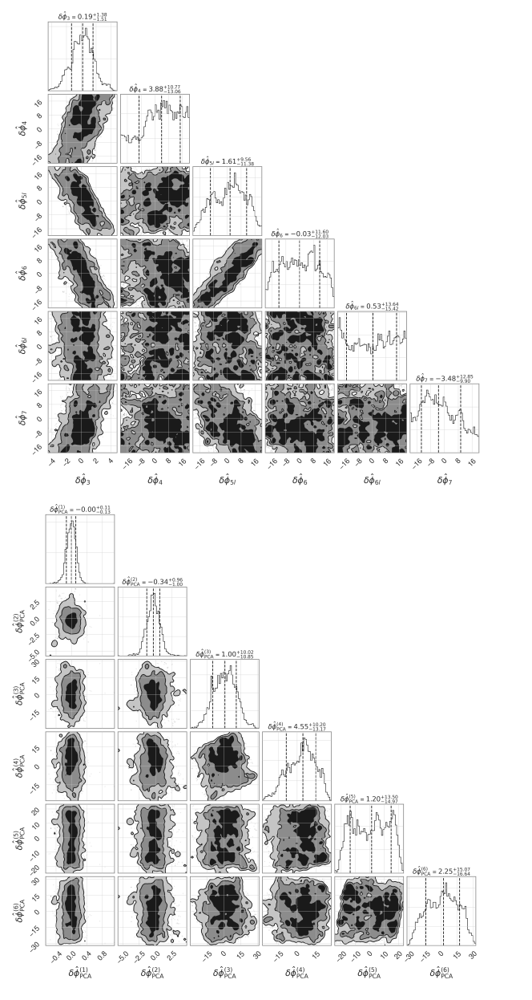

In density estimation, you could use PCA to extract the eigenmodes of a pdf. 


***At home*** You could revise the GRB excercise from our last lecture and see if PCA gives something better/nicer.

## Non-negative Matrix Factorization (NMF) <a class="anchor" id="three"></a>

One of the biggest drawbacks of PCA is that the eigenvectors are defined relative to the mean data vector, resulting in principal components that can be positive or negative. But for many physical systems we know a-priori that the data can be represented as a linear sum of positive components, e.g., spectra, or the pdfs of physical properties of events. 

**[Non-negative Matrix Factorization (NMF)](https://en.wikipedia.org/wiki/Non-negative_matrix_factorization)** treats the data as a linear sum of positive-definite components. 

NMF assumes that any data matrix with all positive elements can be factored into two matrices, $W$ and $Y$, with

$$ X = W Y, $$

where both $W$ and $Y$ are non-negative. 

So, $WY$ is an approximation of $X$. Minimizing the reconstruction error $|| (X - W Y)^2 ||$, 
nonnegative bases can be derived through an iterative process.

Note, however, that the iterative process does not guarantee nonlocal minima (like $K$-means and EM), but using 
random initialization and cross-validation can be used to find the global minimum.

An example from the astronomy literature is [Allen et al. 2008](http://arxiv.org/abs/0810.4231), which also uses SDSS data.

In Scikit-Learn the [NMF implementation](http://scikit-learn.org/stable/modules/generated/sklearn.decomposition.NMF.html) looks like (...don't worry about warnings):

In [13]:
# Execute this cell
from sklearn.decomposition import NMF

X = np.random.random((100,10)) # 100 points in 10-D, all +ve
nmf = NMF(n_components=3)
nmf.fit(X)

W = nmf.transform(X) # project to 3 dimension
Y = nmf.components_ # 3x10 array of components
err = nmf.reconstruction_err_ # how well 3 components capture the data

#print(W)
#print(Y)
#print(err)

/Users/dgerosa/box/lib/python3.11/site-packages/sklearn/decomposition/_nmf.py:1710: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


An example (and comparison to PCA) is given below.

In [14]:
# Execute the next 2 cells
# Example from Figure 7.4
# Author: Jake VanderPlas
# License: BSD
#from sklearn.decomposition import RandomizedPCA

from astroML.datasets import sdss_corrected_spectra
from astroML.decorators import pickle_results

#------------------------------------------------------------
# Download data
data = sdss_corrected_spectra.fetch_sdss_corrected_spectra()
spectra = sdss_corrected_spectra.reconstruct_spectra(data)
wavelengths = sdss_corrected_spectra.compute_wavelengths(data)

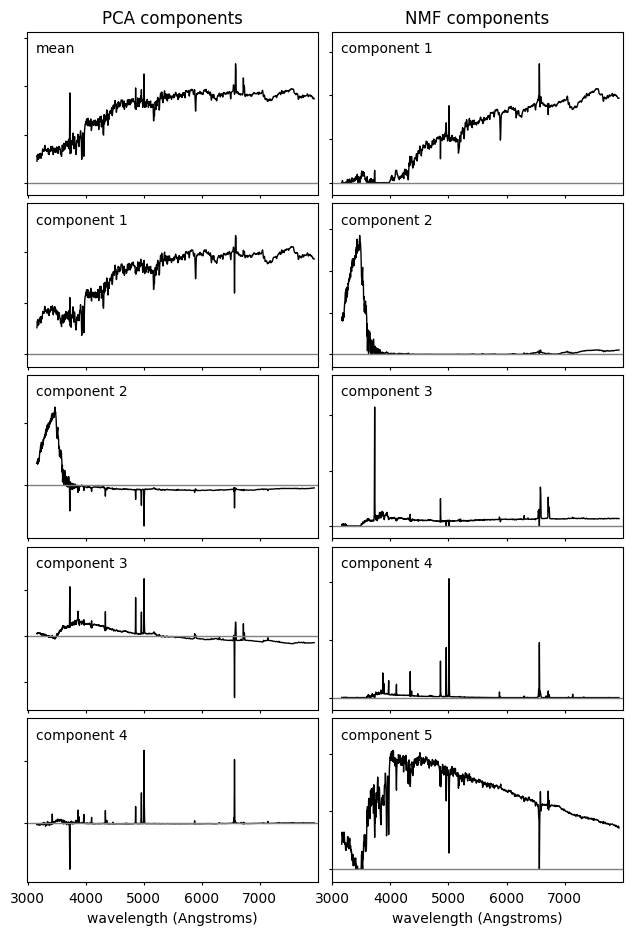

In [15]:
#----------------------------------------------------------------------
# Compute PCA, and NMF components
def compute_PCA_NMF(n_components=5):
    spec_mean = spectra.mean(0)

    # PCA: use randomized PCA for speed 
    #pca = RandomizedPCA(n_components - 1)
    pca = PCA(n_components - 1,svd_solver='randomized')
    pca.fit(spectra)
    pca_comp = np.vstack([spec_mean, pca.components_])

    # NMF requires all elements of the input to be greater than zero
    spectra[spectra < 0] = 0
    nmf = NMF(n_components)
    nmf.fit(spectra)
    nmf_comp = nmf.components_

    return pca_comp, nmf_comp

n_components = 5
decompositions = compute_PCA_NMF(n_components)

#----------------------------------------------------------------------
# Plot the results
fig = plt.figure(figsize=(10, 10))
fig.subplots_adjust(left=0.05, right=0.95, wspace=0.05,
                    bottom=0.1, top=0.95, hspace=0.05)

titles = ['PCA components', 'NMF components']

for i, comp in enumerate(decompositions):
    for j in range(n_components):
        ax = fig.add_subplot(n_components, 3, 3 * j + 1 + i)

        ax.yaxis.set_major_formatter(plt.NullFormatter())
        ax.xaxis.set_major_locator(plt.MultipleLocator(1000))
        if j < n_components - 1:
            ax.xaxis.set_major_formatter(plt.NullFormatter())
        else:
            ax.set_xlabel('wavelength (Angstroms)')

        ax.plot(wavelengths, comp[j], '-k', lw=1)

        # plot zero line
        xlim = [3000, 7999]
        ax.plot(xlim, [0, 0], '-', c='gray', lw=1)
        ax.set_xlim(xlim)

        if j == 0:
            ax.set_title(titles[i])

        if titles[i].startswith('PCA') or titles[i].startswith('ICA'):
            if j == 0:
                label = 'mean'
            else:
                label = 'component %i' % j
        else:
            label = 'component %i' % (j + 1)

        ax.text(0.03, 0.94, label, transform=ax.transAxes,
                ha='left', va='top')

        for l in ax.get_xticklines() + ax.get_yticklines(): 
            l.set_markersize(2) 

        # adjust y limits
        ylim = plt.ylim()
        dy = 0.05 * (ylim[1] - ylim[0])
        ax.set_ylim(ylim[0] - dy, ylim[1] + 4 * dy)

plt.show()

See how all the NMF bases/components are positive? This can be very useful for some specific physical applications.

## Independent Component Analysis (ICA) <a class="anchor" id="four"></a>

For data where the **components are statistically independent** (or nearly so) **[Independent Component Analysis (ICA)](https://en.wikipedia.org/wiki/Independent_component_analysis)** has become a popular method for separating mixed components.  

***The classical example is the so-called "cocktail party" problem.*** This is illustrated in the following figure from *Hastie, Tibshirani, & Friedman*. Think of the "source signals" as two voices at a party. You are trying to concentrate on just one voice.  What you hear is something like the "measured signals" pattern. You could run the data through PCA and that would do an excellent job of reconstructing the signal with reduced dimensionality, but it wouldn't actually isolate the different physical components (bottom-left panel). ICA on the other hand can (bottom-right panel).

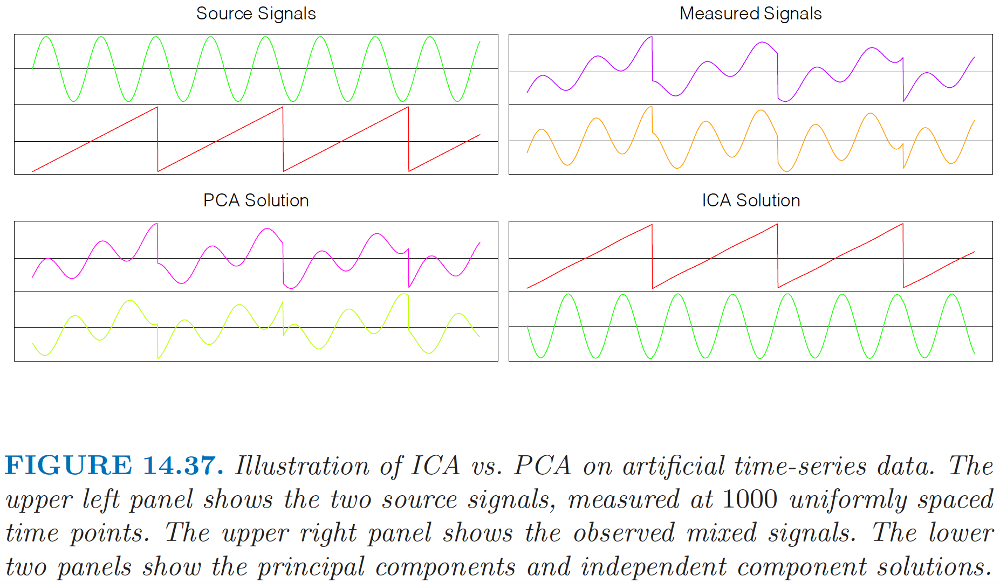

You can find this image (as well as the entire textbook for free!) [here](https://web.stanford.edu/~hastie/ElemStatLearn//printings/ESLII_print12_toc.pdf).

[Hastie et al.](https://web.stanford.edu/~hastie/ElemStatLearn/): 
> *ICA applied to multivariate data looks for a sequence of orthogonal projections such that the projected data look as far from Gaussian as possible. With pre-whitened data, this amounts to looking for
components that are as independent as possible.*

In short you want to ***find components that are maximally non-Gaussian***, since the sum of two or more random variables will be more Gaussian than either of the components individually (remember the **Central Limit Theorem**). *Hastie et al.* illustrate this as follows:

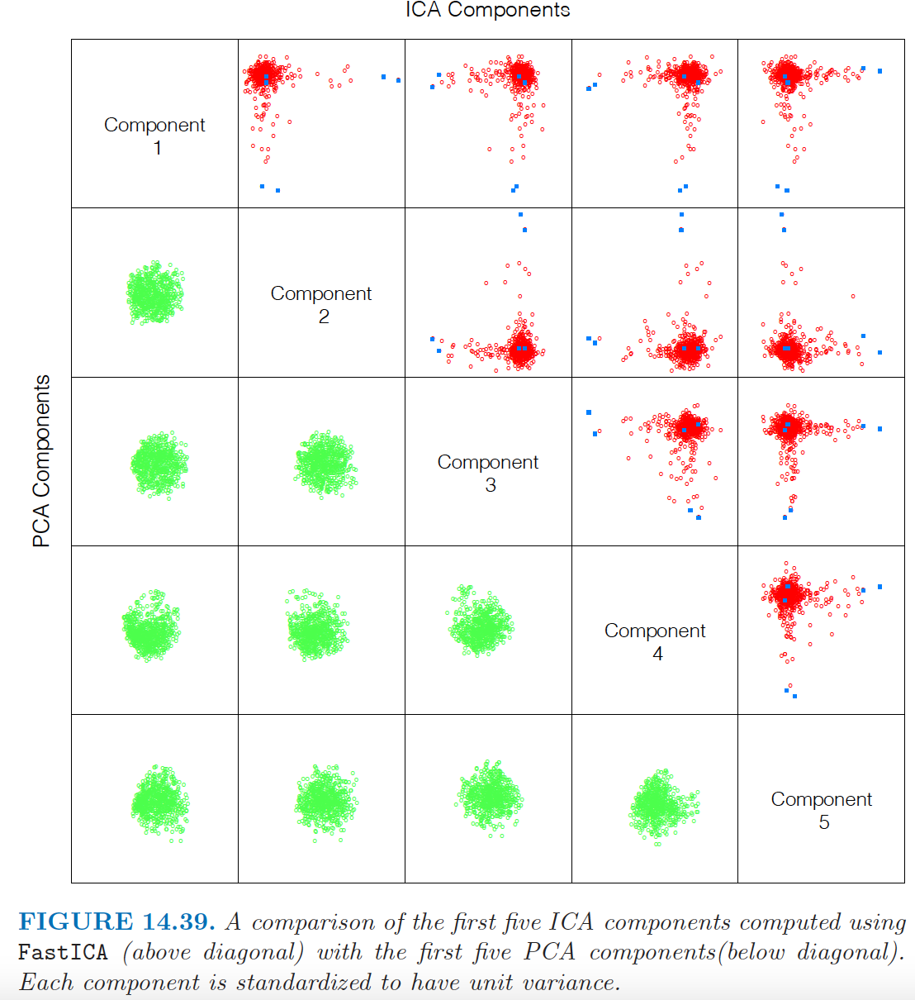

ICA is a good choice for a complex system with relatively independent components. For example a galaxy is roughly a linear combination of cool stars and hot stars, and a quasar is just a galaxy with others component from an accretion disk and emission line regions. **Ideally we want "eigenvectors" that are aligned with those physical traits/regions as opposed to abstract mathematical constructs.**

The basic call to the [FastICA algoirthm](http://scikit-learn.org/stable/modules/generated/sklearn.decomposition.FastICA.html) in Scikit-Learn looks like:

In [16]:
# Execute this cell
from sklearn.decomposition import FastICA

X = np.random.normal(size=(100,2)) # 100 objects in 2D
R = np.random.random((2,5)) # mixing matrix
X = np.dot(X,R) # Simulation of a 5D data space

ica = FastICA(n_components=2) # Now reproject to 2-D
ica.fit(X)

proj = ica.transform(X) # 100x2 projection of the data
comp = ica.components_ # 2x5 matrix of independent components
## sources = ica.sources_ # 100x2 matrix of sources

Execute the next 2 cells to produce a plot showing the ICA components of the SDSS spectra.

In [17]:
from astroML.datasets import sdss_corrected_spectra
from astroML.decorators import pickle_results

#------------------------------------------------------------
# Download data
data = sdss_corrected_spectra.fetch_sdss_corrected_spectra()
spectra = sdss_corrected_spectra.reconstruct_spectra(data)
wavelengths = sdss_corrected_spectra.compute_wavelengths(data)

#----------------------------------------------------------------------
# Compute ICA
np.random.seed(500)
nrows = 500
n_components = 5
ind = np.random.randint(spectra.shape[0], size=nrows)

spec_mean = spectra[ind].mean(0)

ica = FastICA(n_components - 1)
ica.fit(spectra[ind])
ica_comp = np.vstack([spec_mean,ica.components_]) # Add the mean to the components

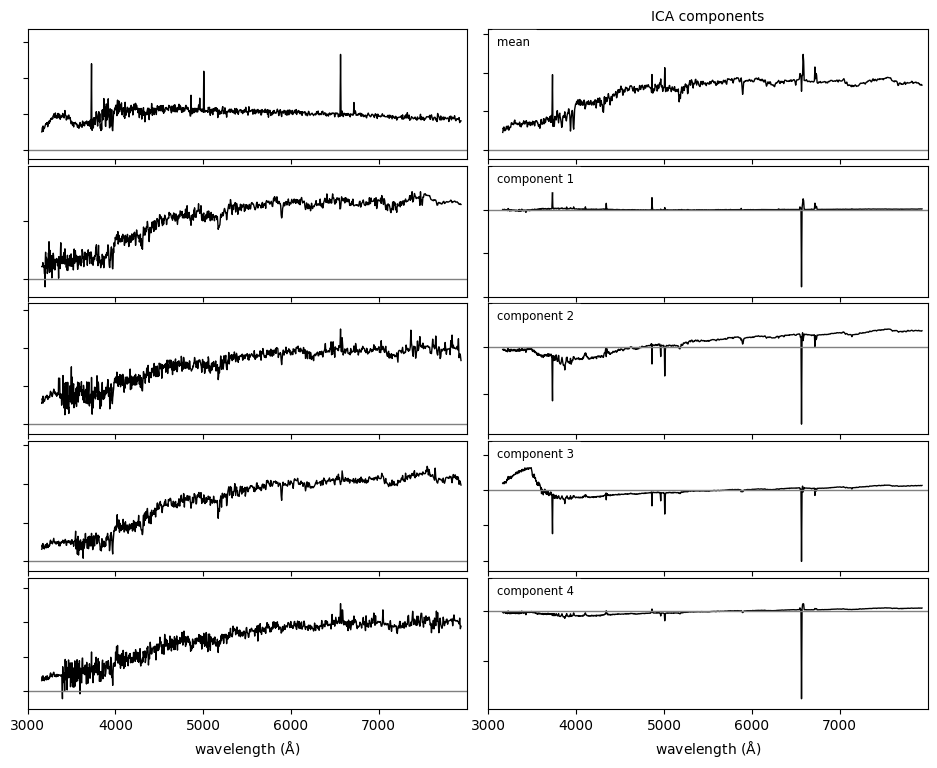

In [18]:
# Make plots
fig = plt.figure(figsize=(10, 8))
fig.subplots_adjust(left=0.05, right=0.95, wspace=0.05,
                    bottom=0.1, top=0.95, hspace=0.05)

titles = 'ICA components'

for j in range(n_components):
    
    # plot the components
    ax = fig.add_subplot(n_components, 2, 2*j+2)
    ax.yaxis.set_major_formatter(plt.NullFormatter())
    ax.xaxis.set_major_locator(plt.MultipleLocator(1000))
    if j < n_components - 1:
        ax.xaxis.set_major_formatter(plt.NullFormatter())
    else:
        ax.set_xlabel(r'wavelength ${\rm (\AA)}$')
    ax.plot(wavelengths, ica_comp[j], '-k', lw=1)

    # plot zero line
    xlim = [3000, 7999]
    ax.plot(xlim, [0, 0], '-', c='gray', lw=1)
    ax.set_xlim(xlim)

    # adjust y limits
    ylim = plt.ylim()
    dy = 0.05 * (ylim[1] - ylim[0])    
    ax.set_ylim(ylim[0] - dy, ylim[1] + 4 * dy)

    # plot the first j spectra
    ax2 = fig.add_subplot(n_components, 2, 2*j+1)
    ax2.yaxis.set_major_formatter(plt.NullFormatter())
    ax2.xaxis.set_major_locator(plt.MultipleLocator(1000))
    if j < n_components - 1:
        ax2.xaxis.set_major_formatter(plt.NullFormatter())
    else:
        ax2.set_xlabel(r'wavelength ${\rm (\AA)}$')
    ax2.plot(wavelengths, spectra[j], '-k', lw=1)
    
    # plot zero line
    ax2.plot(xlim, [0, 0], '-', c='gray', lw=1)
    ax2.set_xlim(xlim)

    if j == 0:
        ax.set_title(titles, fontsize='medium')

    if j == 0:
        label = 'mean'
    else:
        label = 'component %i' % j

    # adjust y limits
    ylim = plt.ylim()
    dy = 0.05 * (ylim[1] - ylim[0])    
    ax2.set_ylim(ylim[0] - dy, ylim[1] + 4 * dy)


    ax.text(0.02, 0.95, label, transform=ax.transAxes,
            ha='left', va='top', bbox=dict(ec='w', fc='w'),
            fontsize='small')

plt.show()

ICA actually looks like it is picking up distinct line regions as the components.

As with PCA and NMF, we can similarly do a reconstruction:

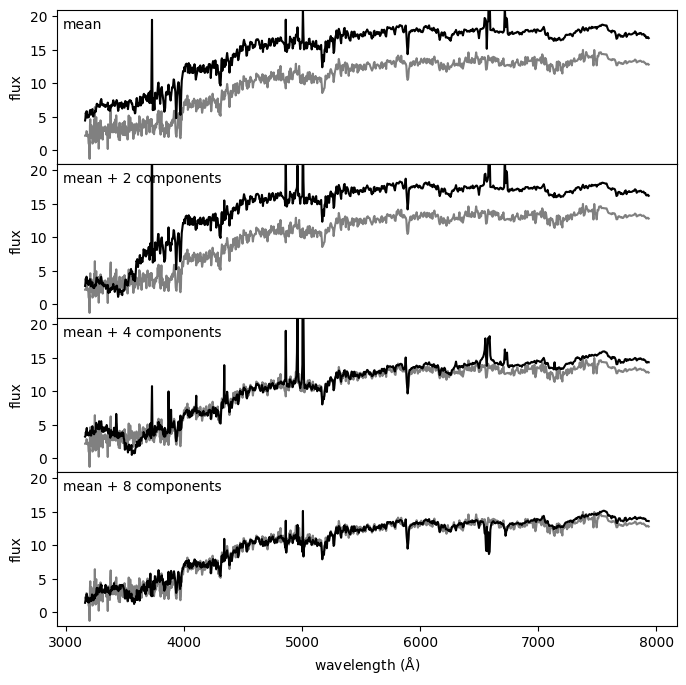

In [19]:
# Execute this cell
#------------------------------------------------------------
# Find the coefficients of a particular spectrum
spec = spectra[1]
evecs = data['evecs']
coeff = np.dot(evecs, spec - spec_mean)

#------------------------------------------------------------
# Plot the sequence of reconstructions
fig = plt.figure(figsize=(8, 8))
fig.subplots_adjust(hspace=0)

for i, n in enumerate([0, 2, 4, 8]):
    ax = fig.add_subplot(411 + i)
    ax.plot(wavelengths, spec, '-', c='gray')
    ax.plot(wavelengths, spec_mean + np.dot(coeff[:n], evecs[:n]), '-k')

    if i < 3:
        ax.xaxis.set_major_formatter(plt.NullFormatter())

    ax.set_ylim(-2, 21)
    ax.set_ylabel('flux')

    if n == 0:
        text = "mean"
    elif n == 1:
        text = "mean + 1 component\n"
        #text += r"$(\sigma^2_{tot} = %.2f)$" % evals_cs[n - 1]
    else:
        text = "mean + %i components\n" % n
        #text += r"$(\sigma^2_{tot} = %.2f)$" % evals_cs[n - 1]
        
    ax.text(0.01, 0.95, text, ha='left', va='top', transform=ax.transAxes)

fig.axes[-1].set_xlabel(r'${\rm wavelength\ (\AA)}$')
plt.show()

Ivezic, Figure 7.7 compares the components found by the PCA, ICA, and NMF algorithms.  Their differences and similarities are quite interesting.

![Ivezic, Figure 7.4](http://www.astroml.org/_images/fig_spec_decompositions_1.png)

In [1]:
# Execute this cell
import numpy as np
from scipy import stats
from matplotlib import pyplot as plt
%matplotlib inline
%config InlineBackend.figure_format='retina'

### Back to the handwritten digits...

Let's revisit the digits sample and see what PCA, NMF, and ICA do for it.

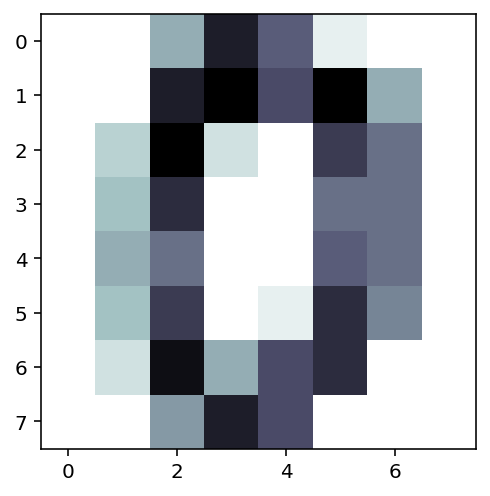

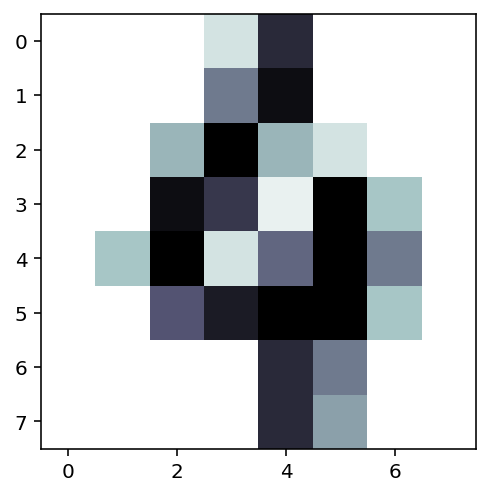

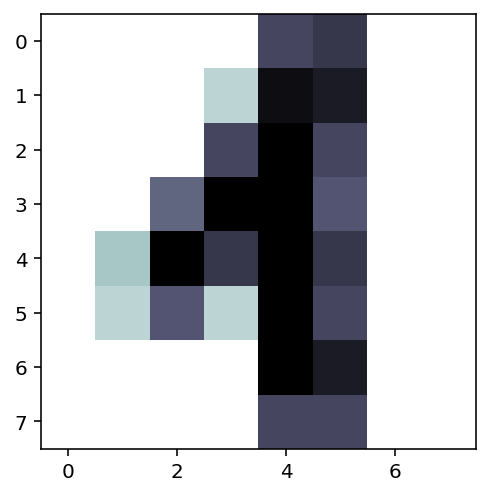

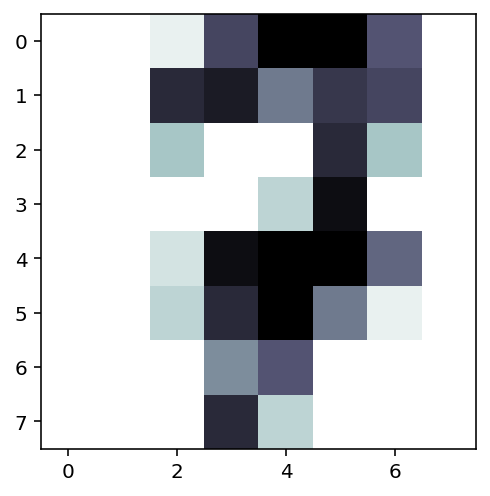

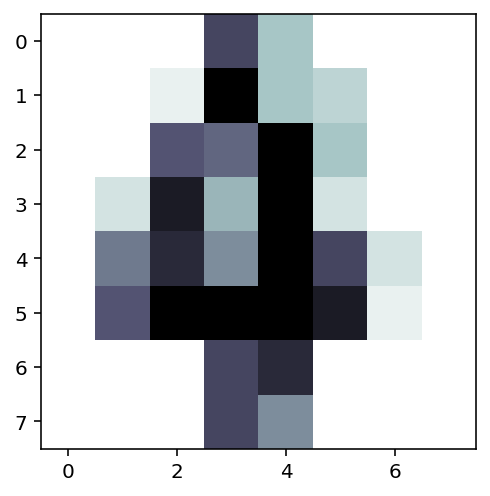

...

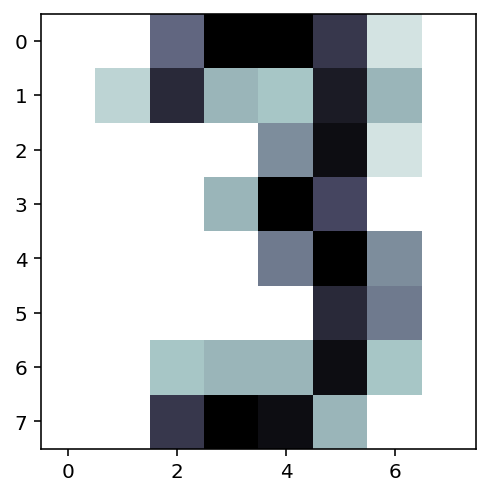

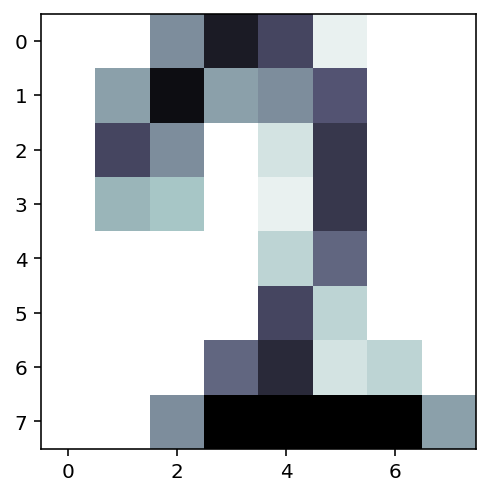

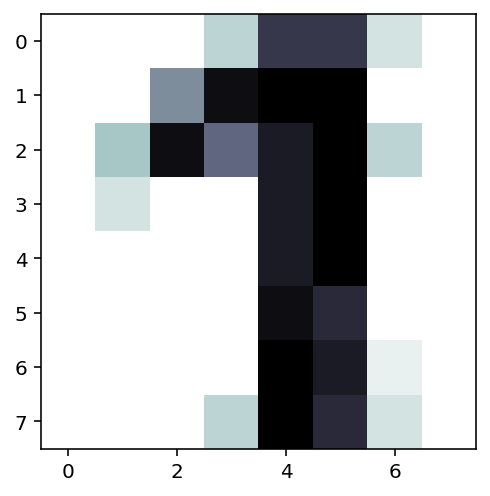

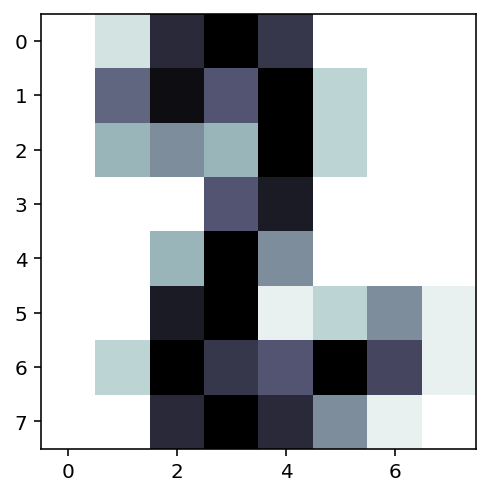

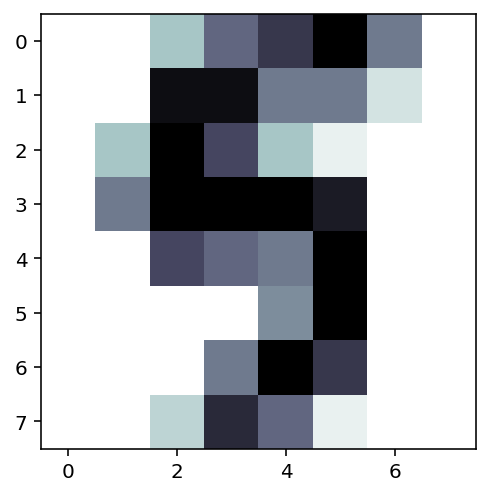

In [2]:
##Load the digits sample
from sklearn.datasets import load_digits

digits = load_digits()
for d in digits.data[::100]:
    grid_data = np.reshape(d, (8,8)) #reshape to 8x8
    plt.imshow(grid_data, interpolation = "nearest", cmap = "bone_r")
    plt.show()
X = digits.data
y = digits.target

Do the PCA transform, projecting to 2 dimensions and plot the results.

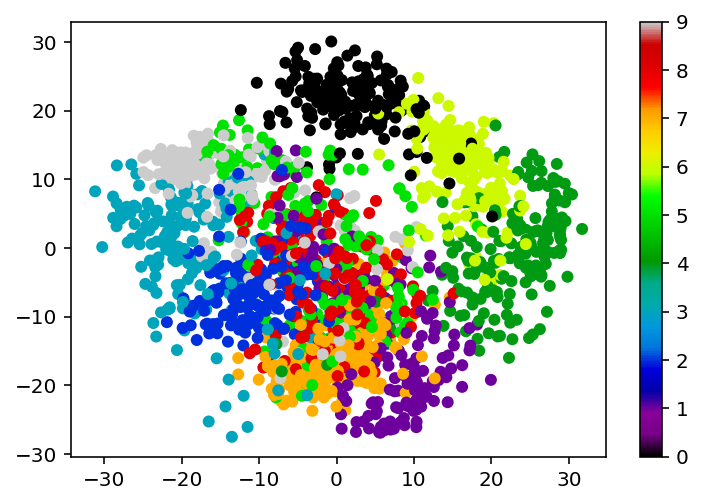

In [3]:
# PCA
from sklearn.decomposition import PCA
pca = PCA(n_components = 2)
X_reduced = pca.fit_transform(X)
plt.scatter(X_reduced[:,0], X_reduced[:,1], 
            c=y, cmap="nipy_spectral", edgecolor="None")
plt.colorbar()

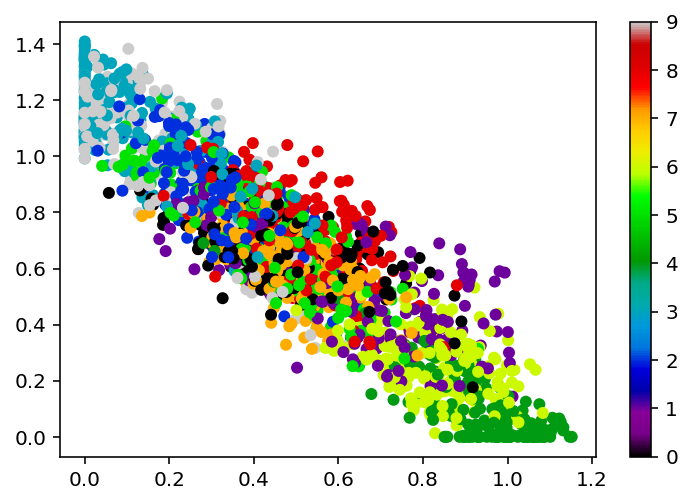

In [4]:
# NMF
from sklearn.decomposition import NMF
pca = NMF(n_components = 2)
X_reduced = pca.fit_transform(X)
plt.scatter(X_reduced[:,0], X_reduced[:,1], 
            c=y, cmap="nipy_spectral", edgecolor="None")
plt.colorbar()

/Users/dgerosa/box/lib/python3.8/site-packages/sklearn/decomposition/_fastica.py:494: FutureWarning: Starting in v1.3, whiten='unit-variance' will be used by default.
  warnings.warn(


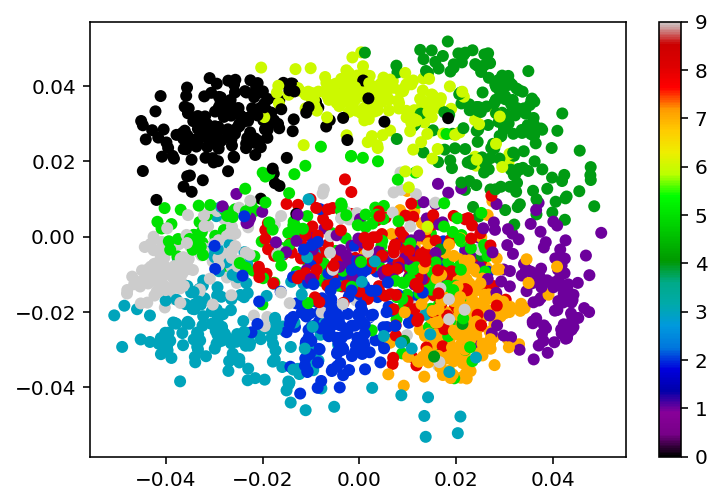

In [5]:
# ICA
from sklearn.decomposition import FastICA
pca = FastICA(n_components = 2)
X_reduced = pca.fit_transform(X)
plt.scatter(X_reduced[:,0], X_reduced[:,1], 
            c=y, cmap="nipy_spectral", edgecolor="None")
plt.colorbar()

We could think about doing dimensional reduction of the digits data set in another way.  There are 64 pixels in each of our images. Presumably all of them aren't equally useful. Let's figure out exactly which pixels are the most relevant to determining the written number. We'll use Scikit-Learn's [`RandomForestRegressor`](http://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomForestRegressor.html).  We won't get to regression until next week, for now just look at the inputs and outputs. Which pixels are the most important?

[52 36 20 28 21 29 27 62 35 12 42 26 18 34 33 51 43 60 63 30 13 61 19 53
 10 38 46 54 37 58  5  2 45 44 22 59 50 11  4  3 25  6 14 41 17  9 49  1
 57  7 55 24 15  8 47 23 31 16 32 39 40 48 56  0]


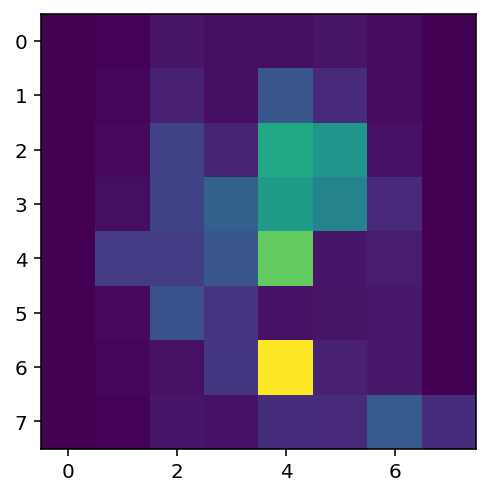

In [6]:
from sklearn.ensemble import RandomForestRegressor

RFreg = RandomForestRegressor() # Complete or leave blank as you see fit
RFreg.fit(X,y) # Do Fitting
importances = RFreg.feature_importances_# Determine pixel "importances"
pixelorder = np.argsort(importances)[::-1] # Rank importances (highest to lowest)
print(pixelorder) 

plt.figure()
plt.imshow(np.reshape(importances,(8,8)),
           interpolation="nearest")
plt.show()

Note that I'm using the target here! This is a supervised approach!



## Non-linear Dimensional Reduction <a class="anchor" id="one"></a>

PCA was nice, but linear. Often we don't have this luxury and the hidden relatioship between variables is intrisically non linear.


The concepts we need are: 
* manifold learning
* nonlinear dimensionality reduction

Specifically using the following algorithms
* locally linear embedding (LLE)
* isometric mapping (IsoMap)
* t-distributed Stochastic Neighbor Embedding (t-SNE)

A note of caution about the techniques you saw in the last lecture: PCA, NMF, and ICA are all linear methods. 

Astronomers will often try to derive physical insight from PCA eigenspectra or eigentimeseries, but there is no physical reason for the data to be linearly and orthogonally separable. Moreover, physical components are (generally) positive definite. So, PCA is great for dimensional reduction, but for doing physics there are generally better choices.

While NMF "solves" the issue of negative components, it is still a linear process. For data with non-linear correlations, an entire field, known as [Manifold Learning](http://scikit-learn.org/stable/modules/manifold.html) and [nonlinear dimensionality reduction]( https://en.wikipedia.org/wiki/Nonlinear_dimensionality_reduction), has been developed, with several algorithms available via the [`sklearn.manifold`](http://scikit-learn.org/stable/modules/classes.html#module-sklearn.manifold) module. 

For example, let's imagine your data set looks like this:

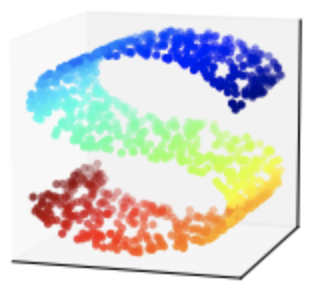

This is data drawn from an *S-shaped two-dimensional manifold embedded within three-dimensional space*. Seems easy to see. PCA is not going to know what to do with this because of the intrinsic non-linear structure. But let's give it a whirl; we get this:

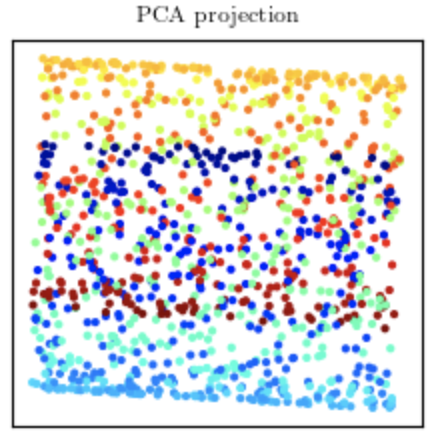

Clearly this is not helpful at all. There is no linear projection in which distant parts of the non-linear manifold do not overlap, resulting in the PCA projection mixing the colors.

***Manifold learning techniques*** on the other hand, do allow for this S-surface to be unwrapped so that its underlying structure is revealed. We'll look at some of these techniques today. Two techniques, **Locally linear embedding (LLE)** and **Isometric mapping (IsoMap)** show the power of these approaches:

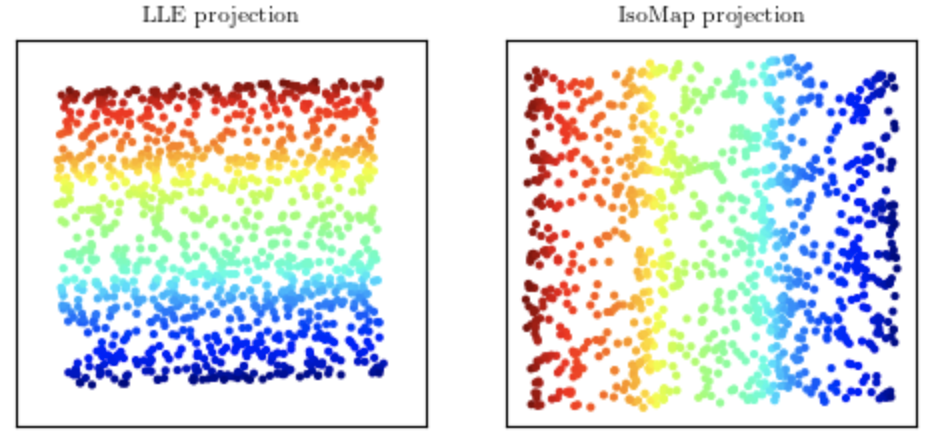

This is more like it! Here is how you would call these algorithms in sklearn:

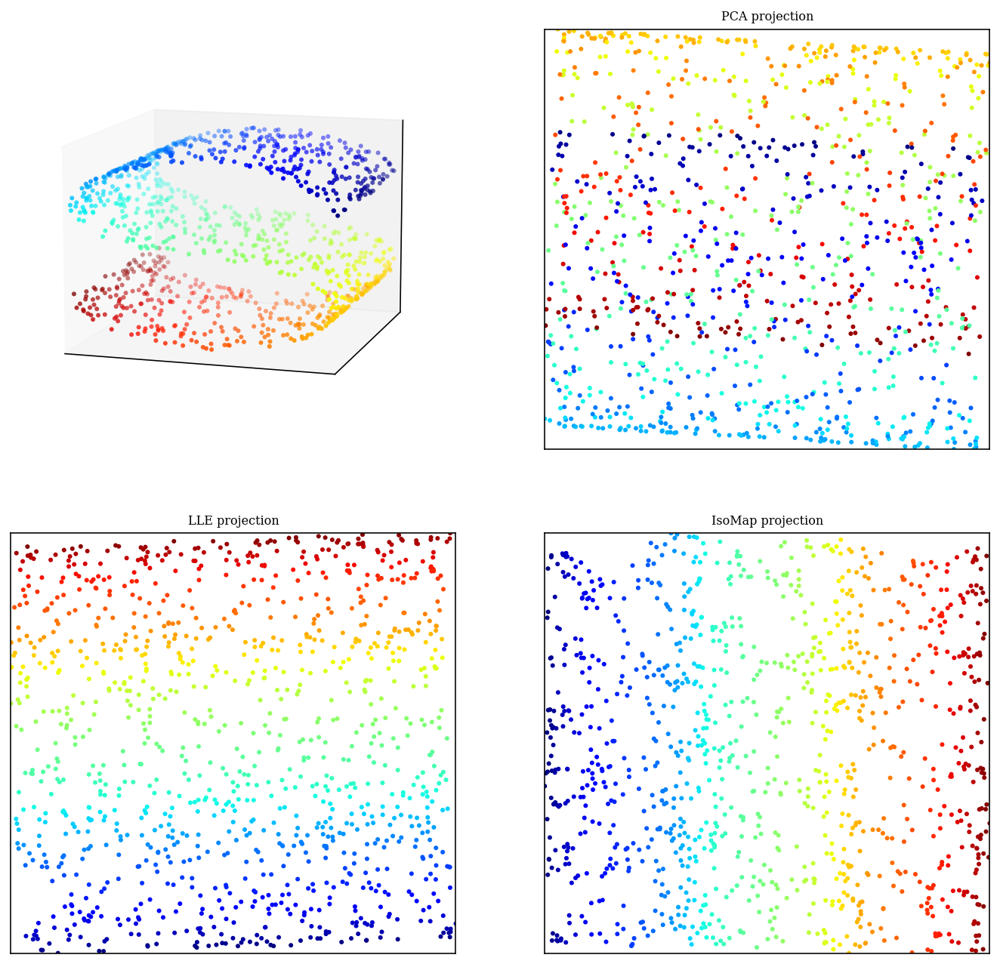

In [7]:
# Author: Jake VanderPlas
# Modified by SRT (2021)
# License: BSD
#   The figure produced by this code is published in the textbook
#   "Statistics, Data Mining, and Machine Learning in Astronomy" (2013)
#   For more information, see http://astroML.github.com
#   To report a bug or issue, use the following forum:
#    https://groups.google.com/forum/#!forum/astroml-general
from matplotlib import ticker
from sklearn import manifold, datasets, decomposition

#----------------------------------------------------------------------
# This function adjusts matplotlib settings for a uniform feel in the textbook.
# Note that with usetex=True, fonts are rendered with LaTeX.  This may
# result in an error if LaTeX is not installed on your system.  In that case,
# you can set usetex to False.
if "setup_text_plots" not in globals():
    from astroML.plotting import setup_text_plots
setup_text_plots(fontsize=8, usetex=False)

#------------------------------------------------------------
# generate the S-curve dataset
np.random.seed(0)

n_points = 1100
n_neighbors = 10
out_dim = 2

X, color = datasets.make_s_curve(n_points)

# change the proportions to emphasize the weakness of PCA
X[:, 1] -= 1
X[:, 1] *= 1.5
X[:, 2] *= 0.5

#------------------------------------------------------------
# Compute the projections
pca = decomposition.PCA(out_dim)
Y_pca = pca.fit_transform(X)

lle = manifold.LocallyLinearEmbedding(n_neighbors=n_neighbors, 
                                      n_components=out_dim, 
                                      method='modified', random_state=0, 
                                      eigen_solver='dense')
Y_lle = lle.fit_transform(X)

iso = manifold.Isomap(n_neighbors=n_neighbors, 
                      n_components=out_dim)
Y_iso = iso.fit_transform(X)

#------------------------------------------------------------
# plot the 3D dataset
fig = plt.figure(figsize=(10, 10))
fig.subplots_adjust(left=0.05, right=0.95,
                    bottom=0.05, top=0.9)
try:
    # matplotlib 1.0+ has a toolkit for generating 3D plots
    from mpl_toolkits.mplot3d import Axes3D
    ax1 = fig.add_subplot(221, projection='3d',
                          xticks=[], yticks=[], zticks=[])
    ax1.scatter(X[:, 0], X[:, 1], X[:, 2], c=color,
                cmap=plt.cm.jet, s=9, lw=0)
    ax1.view_init(11, -73)

except:
    # In older versions, we'll have to wing it with a 2D plot
    ax1 = fig.add_subplot(221)

    # Create a projection to mimic 3D scatter-plot
    X_proj = X / (X.max(0) - X.min(0))
    X_proj -= X_proj.mean(0)
    R = np.array([[0.5, 0.0],
                  [0.1, 0.1],
                  [0.0, 0.5]])
    R /= np.sqrt(np.sum(R ** 2, 0))
    X_proj = np.dot(X_proj, R)

    # change line width with depth
    lw = X[:, 1].copy()
    lw -= lw.min()
    lw /= lw.max()
    lw = 1 - lw

    ax1.scatter(X_proj[:, 0], X_proj[:, 1], c=color,
                cmap=plt.cm.jet, s=9, lw=lw, zorder=10)

    # draw the shaded axes
    ax1.fill([-0.7, -0.3, -0.3, -0.7, -0.7],
             [-0.7, -0.3, 0.7, 0.3, -0.7], ec='k', fc='#DDDDDD', zorder=0)
    ax1.fill([-0.3, 0.7, 0.7, -0.3, -0.3],
             [-0.3, -0.3, 0.7, 0.7, -0.3], ec='k', fc='#DDDDDD', zorder=0)
    ax1.fill([-0.7, 0.3, 0.7, -0.3, -0.7],
             [-0.7, -0.7, -0.3, -0.3, -0.7], ec='k', fc='#DDDDDD', zorder=0)

    ax1.xaxis.set_major_locator(ticker.NullLocator())
    ax1.yaxis.set_major_locator(ticker.NullLocator())

#------------------------------------------------------------
# Plot the projections
subplots = [222, 223, 224]
titles = ['PCA projection', 'LLE projection', 'IsoMap projection']
Yvals = [Y_pca, Y_lle, Y_iso]

for (Y, title, subplot) in zip(Yvals, titles, subplots):
    ax = fig.add_subplot(subplot)
    ax.scatter(Y[:, 0], Y[:, 1], c=color, cmap=plt.cm.jet, s=9, lw=0)
    ax.set_title(title)
    ax.set_xticks([])
    ax.set_yticks([])

plt.show()

For a nice examples in astronomy see
[Vanderplas & Connolly 2009](http://iopscience.iop.org/article/10.1088/0004-6256/138/5/1365/meta;jsessionid=48A569862A424ECCAEECE2A900D9837B.c3.iopscience.cld.iop.org), where they classify SDSS spectra using LLE:

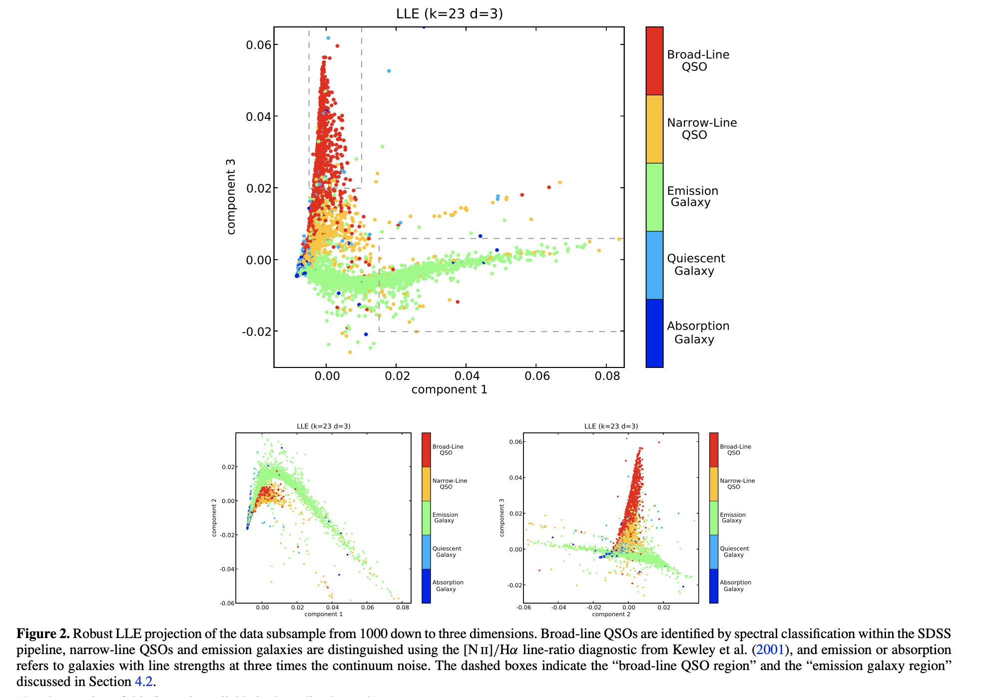


## Locally Linear Embedding (LLE) <a class="anchor" id="two"></a>

[Local Linear Embedding](http://scikit-learn.org/stable/modules/generated/sklearn.manifold.LocallyLinearEmbedding.html#sklearn.manifold.LocallyLinearEmbedding) attempts to embed high-$D$ data in a lower-$D$ space.  Crucially it also seeks to preserve the geometry of the local "neighborhoods" around each point.  In the case of the "S" curve, it seeks to unroll the data.  The steps are

**STEP 1:** *define the local geometry*
- local neighborhoods are determined from each point's $k$ nearest neighbors.
- for each point calculate the weights that reconstruct a point from its $k$ nearest neighbors via
$$ \mathcal{E}_1(W) = \left|X - WX\right|^2,$$
where $X$ is an $N\times K$ matrix and $W$ is an $N\times N$ matrix that minimizes the reconstruction error.

Essentially this is **finding the hyperplane that describes the local surface at each point** within the data set. So, imagine that you have a bunch of square tiles and you are trying to tile the surface with them. 

One trivial solution of the above equation is $W=I$ where $I$ is an identity matrix-- however this can be avoided by constraining $W_{ii}=0$ for all points, $i$. The resulting constrained solution to $W$ is far more interesting, encoding the global geometry of the manifold through each point's relation to all others. 

- take the constrained solution a step further by setting all $W_{ij}=0$ except when point $j$ is one of the $k$ nearest neighbors of point $i$. 

Each row of $W$ encodes the local geometry of each point, and the matrix as a whole encodes the global geometry of the manifold.

**STEP 2:** *embed within a lower dimensional space* 
- $W$ becomes very sparse for $k \ll N$ (only $Nk$ entries in $W$ are non-zero). 
- minimize
$$ \mathcal{E}_2(Y) = \left|Y - W Y\right|^2,$$
with $W$ fixed to find an $N$ by $d$ matrix ($d$ is the new dimensionality).

This final step corresponds to finding a lower dimensional embedding of the data, $Y$, that reflects the geometry of the local neighborhoods in the original data matrix, $X$.

***Step 1 requires a nearest-neighbor search. Step 2 requires an eigenvalue decomposition of the matrix $C_W \equiv (I-W)^T(I-W)$.*** 

LLE has been applied to data as diverse as galaxy spectra, stellar spectra, and photometric light curves. It was introduced by [Roweis & Saul (2000)](https://www.ncbi.nlm.nih.gov/pubmed/11125150). Roweis has some fun examples on his website, including an LLE of a twin peaked surface, reduced down to a lower dimension:

![](https://cs.nyu.edu/~roweis/lle/images/twinPeaks.gif)

An even more interesting example is an LLE analysis of face images. By unwrapping many images into vectors of pixels and stacking to form a data matrix, LLE can be used to discriminate facial expressions:

![](https://cs.nyu.edu/~roweis/lle/images/faceex1.gif)

Scikit-learn's call to LLE is as follows, with a more detailed example already being given above.

In [8]:
from sklearn.manifold import LocallyLinearEmbedding

X = np.random.normal(size=(1000,2)) # 1000 points in 2D
R = np.random.random((2,10)) # projection matrix
X = np.dot(X,R) # now a 2D linear manifold in 10D space

k = 5 # Number of neighbors to use in fit
n = 2 # Number of dimensions to fit

lle = LocallyLinearEmbedding(n_neighbors=k, 
                             n_components=n)
lle.fit(X)
proj = lle.transform(X) # 100x2 projection of the data

Let's see what LLE does for the digits data, using the 7 nearest neighbors and 2 components.

In [9]:
# Execute this cell to load the digits sample
from sklearn.datasets import load_digits

digits = load_digits()
grid_data = np.reshape(digits.data[0], (8,8)) #reshape to 8x8
#plt.imshow(grid_data, interpolation = "nearest", cmap = "bone_r")
#print(grid_data)
X = digits.data
y = digits.target

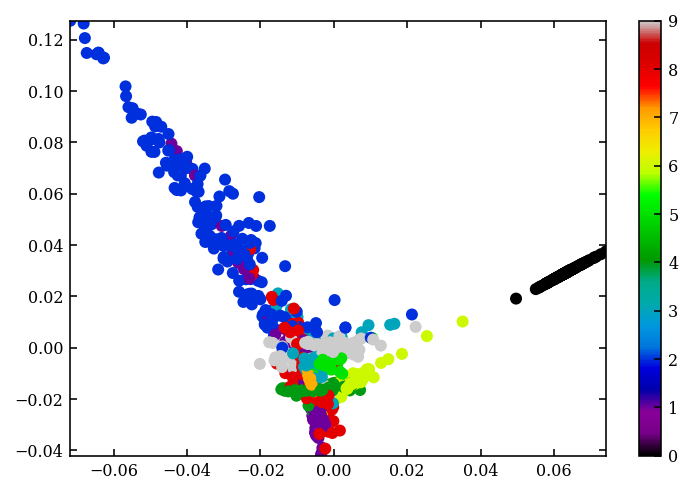

In [10]:
# LLE
from sklearn.manifold import LocallyLinearEmbedding
k = 17 # Number of neighbors to use in fit
n = 2 # Number of dimensions to fit
lle = LocallyLinearEmbedding(n_neighbors=k,
                             n_components=n)
lle.fit(X)
X_reduced = lle.transform(X)

plt.scatter(X_reduced[:,0], X_reduced[:,1], 
            c=y, cmap="nipy_spectral", edgecolor="None")
plt.colorbar()

## Isometric Mapping (IsoMap) <a class="anchor" id="three"></a>

**IsoMap** is based on the multi-dimensional scaling (MDS) framework. Classical MDS recovers a data set from the matrix of pairwise distances between points. 

IsoMap was coincidentally introduced in the same volume of *Science* as the LLE article above. See [Tenenbaum, de Silva, & Langford (2000)](https://www.ncbi.nlm.nih.gov/pubmed/?term=A+Global+Geometric+Framework+for+Nonlinear+Dimensionality+Reduction).

***IsoMap seeks to find a lower dimensional embedding of the data marix that maintains the geodesic distances between all points.*** Rather than using Euclidean distances between points, IsoMap actually approximates geodesic curves that lie in the embedded manifold, then **computes the distances between each point in the data set along these geodesics**. This can be seen in the image below from Tenenbaum et al.-- the dataset is a ["Swiss Roll"](https://www.wikiwand.com/en/Swiss_roll). 

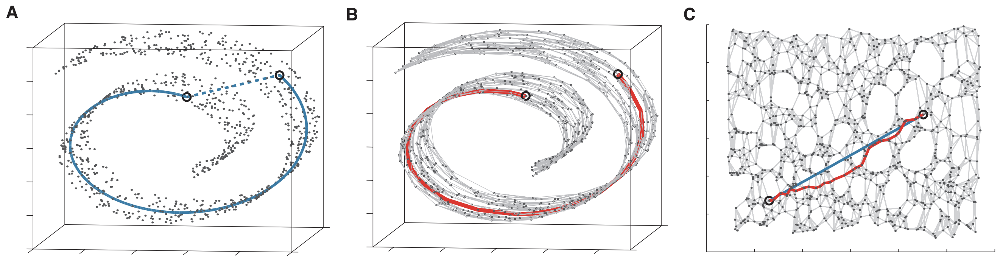


- In the **left panel**, one can see that the Euclidean distance between two points (dashed line) is not a true reflection of how far apart they are on the embedded manifold (solid line). 
- In the **middle panel**, a [neighboorhood graph](https://www.wikiwand.com/en/Neighbourhood_(graph_theory)) is constructed that connects each point to its neighboors, allowing the geodesic distance between points to be computed by finding the shortest path through the graph.
- In the **right panel**, a lower dimensional embedding of the manifold is recovered by IsoMap that preserves the relative geodesic distances between points.

For the final step of finding the optimal low-dimensional embedding, MDS algorithm technqiues are used to minimize the reconstruction error:

$$ \mathcal{E}_{XY} = |\tau(D_X) - \tau(D_Y)|^2 $$

between the original data set $X$ and the low-dimensional embedding $Y$, where $\tau$ is some operator on the distance matrices.

In Scikit-Learn [IsoMap](http://scikit-learn.org/stable/modules/generated/sklearn.manifold.Isomap.html) is implemented as follows:

In [11]:
# Execute this cell
from sklearn.manifold import Isomap

XX = np.random.normal(size=(1000,2)) # 1000 points in 2D
R = np.random.random((2,10)) # projection matrix
XX = np.dot(XX,R) # X is a 2D manifold in 10D space

k = 5 # number of neighbors
n = 2 # number of dimensions

iso = Isomap(n_neighbors=k, n_components=n)
iso.fit(XX)
proj = iso.transform(XX) # 1000x2 projection of the data

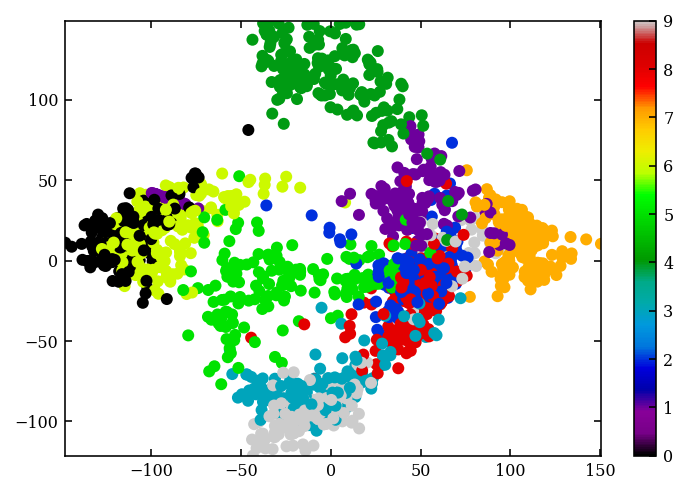

In [12]:
# IsoMap
k = 7 # Number of neighbors to use in fit
n = 2 # Number of dimensions to fit

iso = Isomap(n_neighbors=k,
             n_components=n)
iso.fit(X)

X_reduced = iso.transform(X)

plt.scatter(X_reduced[:,0], X_reduced[:,1], 
            c=y, cmap="nipy_spectral", edgecolor="None")
plt.colorbar()

## t-distributed Stochastic Neighbor Embedding (t-SNE) <a class="anchor" id="four"></a>

**[t-SNE](https://en.wikipedia.org/wiki/T-distributed_stochastic_neighbor_embedding)** is not discussed in the book, but Scikit-Learn does have a [t-SNE implementation](http://scikit-learn.org/stable/modules/generated/sklearn.manifold.TSNE.html), and it is well worth mentioning this powerful manifold learning algorithm too. 

SNE itself was developed by [Hinton & Roweis](http://www.cs.toronto.edu/~fritz/absps/sne.pdf) with the "$t$" part being added by [van der Maaten & Hinton](http://jmlr.org/papers/volume9/vandermaaten08a/vandermaaten08a.pdf). It works like the other manifold learning algorithms. To give you an idea of how cutting edge this is compared to other techniques we've seen, t-SNE was only published in $2008$. PCA dates from $1933$; alot has changed in computational physics since then.

> [t-SNE differs from PCA by preserving only small pairwise distances or local similarities whereas PCA is concerned with preserving large pairwise distances to maximize variance.](https://medium.com/@violante.andre/an-introduction-to-t-sne-with-python-example-47e6ae7dc58f)


For an astronomy example on stellar chemical abundances [Anders et al 2019](https://arxiv.org/abs/1803.09341). 

A high-level description of the steps in t-SNE are as follows:

**STEP 1**: *measure the similarity between points in the original high-dimensional space*
- this is done by centering a multivariate Gaussian on each point and measuring the pdf value of all neighboors.
- the bandwidth of the Gaussian can be chosen to tweak something called the *perplexity*, which essentially relates to the number of nearest neighboors being considered.
- the result is a matrix of probabilities of each point under a Gaussian centered under every other point, $p_{ij}$.
- this "similarity matrix" is a measure of local structure.

**STEP 2**: *find a lower-dimensional mapping that preserves the similarities, $p_{ij}$*
- a heavy-tailed Student's $t$-distribution with $1$-degree of freedom (i.e. a Cauchy distribution) is used to model the probabilities between pairs of points in the low-dimensional embedding, $q_{ij}$.
- this allows dissimilar objects to be modeled as being far apart on the map. 
- A quantity known as the [Kullback-Leibler divergence](https://www.wikiwand.com/en/Kullback%E2%80%93Leibler_divergence) is used to minimize differences between $p_{ij}$ and $q_{ij}$. 

Try it on the digits data. You'll need to import `TSNE` from `sklearn.manifold`, instantiate it with 2 components, then do a `fit_transform` on the original data.

/Users/dgerosa/box/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(


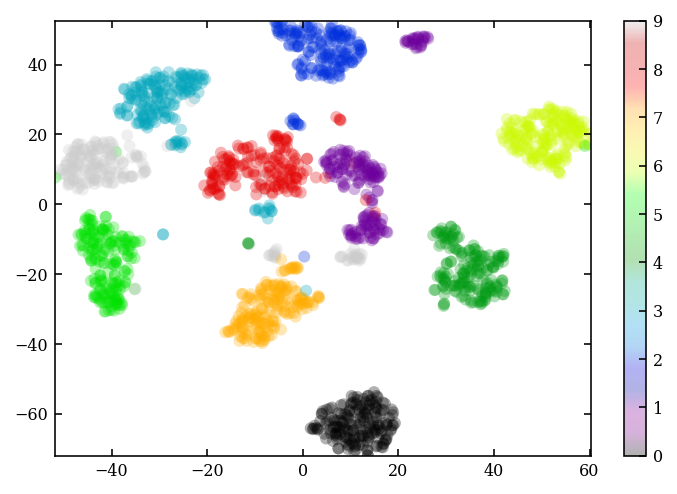

In [13]:
# t-SNE
from sklearn.manifold import TSNE
tsne = TSNE(n_components=2,learning_rate=200)
X_reduced = tsne.fit_transform(X)

plt.scatter(X_reduced[:,0],X_reduced[:,1], 
            c=y, cmap="nipy_spectral", alpha=0.3, 
            edgecolor="None")
plt.colorbar()

I mean... Wow! Imagine now running a clustering there (**homework, try!**). It's going to find every single blob very easily.

What's even more illuminating is to make the plot using the actual digits to plot the points.  Then you can see why certain digits are alike or split into multiple regions.  Can you explain the patterns you see here?

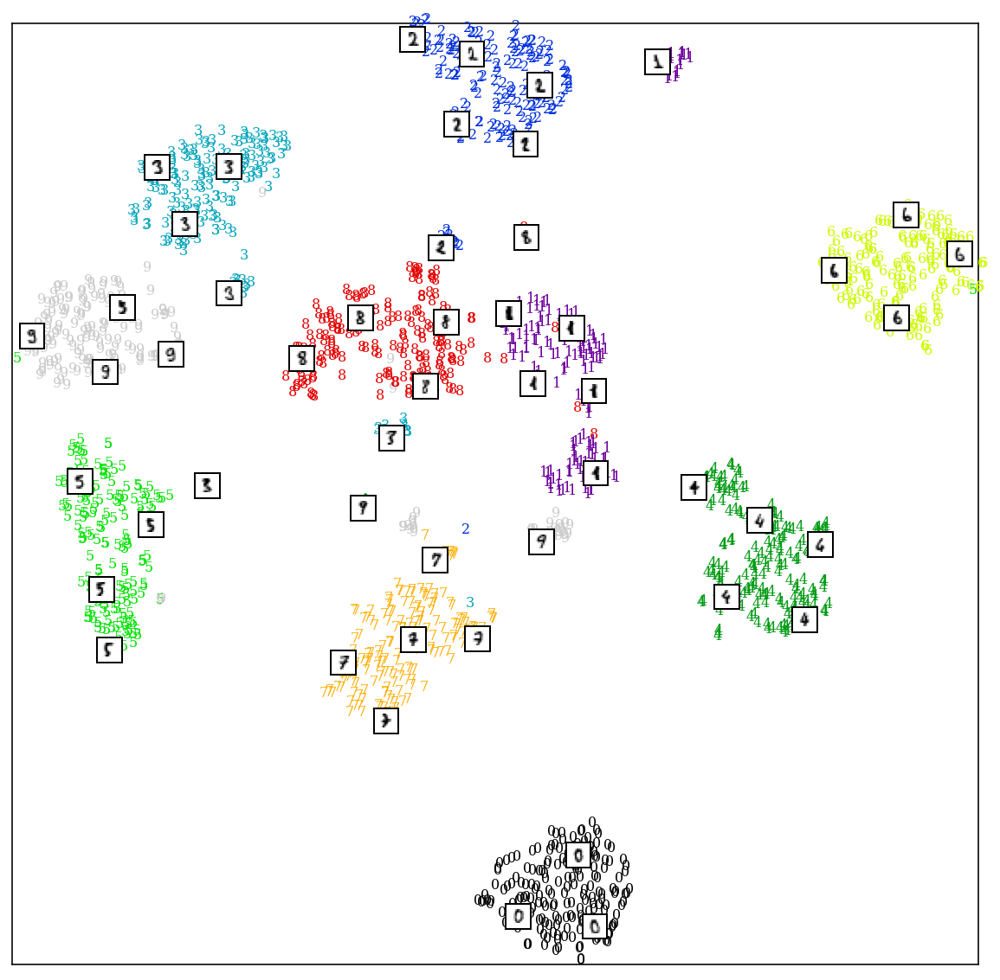

In [14]:
# Execute this cell
from matplotlib import offsetbox

#----------------------------------------------------------------------
# Scale and visualize the embedding vectors
def plot_embedding(X):
    x_min, x_max = np.min(X, 0), np.max(X, 0)
    X = (X - x_min) / (x_max - x_min)

    plt.figure(figsize=(10, 10))
    ax = plt.subplot(111)
    for i in range(X.shape[0]):
        plt.text(X[i, 0], X[i, 1], str(digits.target[i]), 
                 color=plt.cm.nipy_spectral(y[i]/9.))

    shown_images = np.array([[1., 1.]])  # just something big
    for i in range(digits.data.shape[0]):
        dist = np.sum((X[i] - shown_images) ** 2, 1)
        if np.min(dist) < 4e-3:
            # don't show points that are too close
            continue
        shown_images = np.r_[shown_images, [X[i]]]
        imagebox = offsetbox.AnnotationBbox(
            offsetbox.OffsetImage(digits.images[i],
                                  cmap=plt.cm.gray_r), 
            X[i])
        ax.add_artist(imagebox)
    plt.xticks([]), plt.yticks([])
    
plot_embedding(X_reduced)
plt.show()

Is this cool or what?!

One other reason why t-SNE is so powerful is that while Isomap, LLE and variants are best suited to unfold a single continuous low-dimensional manifold, t-SNE groups samples based on the local structure. So it can be used to unwrap and disentangle a dataset that comprises several manifolds at once (as is the case in the digits dataset). See [here](https://scikit-learn.org/stable/modules/manifold.html#t-distributed-stochastic-neighbor-embedding-t-sne) for more details.

Here is another fun example of **t-SNE used to visualize one realization of the Netflix catalog** (from https://lvdmaaten.github.io/tsne/). So if you have trouble finding something to watch, look here for something you already enjoy then check out its neighboors.

![](https://lvdmaaten.github.io/tsne/examples/netflix_tsne.jpg)

### Drawbacks of non-linear embeddings tecniques

- **Noisy and gappy data**. For our S problem, imagine a point at x=0,y=0 but unconstrained in z. The algorithm cannot possibly know where to put it on the S. Manifold learning tecniques are intrisically bad for missing data. 
- **Tuning parameters**. Sophisticated things needs to be tuned (I didn't even mention the learning rate parmeter in t-SNE!)
- **Dimensionality**. In PCA, the eigenvalue give you a sense of the intrinsic dimensionality, i.e. how many dimensions you should keep. This is not the case with non-linear approaches.
- **Outliers** can be a big problem for these tools. There's a nice example on this in Fig 7.9 in the textbook. If you look at the code, the first have to filter out outliers with a different algorithm before applying LLE successfully.
- **Reconstruction**. Non-linear mapping does not provide a set of basis function like PCA, making data reconstruction  less clean (need to use e.g. nearest neighbors).

## Better Dataviz

We often use dimensionality reduction to help with data visualization, so it seems appropriate to briefly talk about some different ways to improve our data visualization using plotting tools. 

This is an illustration of the power of [Bokeh](https://bokeh.org/), a language to create interacte browser-based dashboards for data visualization. The following cell will create and launch a new browser tab (chrome for me) that shows a set of interactive scatter plots for the penguin data set. This uses the data-visualization principles of [**brushing & linking**](https://www.wikiwand.com/en/Brushing_and_linking).

- ***Linking*** refers to having a connected series of data representations (e.g. histograms or scatter plots), where a change in one parameter or a subset of parameters in one representation is then reflected in the others.
- ***Brushing*** refers to highlighting subsets of data within one representation such that this subset is also highlighted in its other representations through the linked view.

In [15]:
import seaborn as sns
penguins = sns.load_dataset("penguins")
from bokeh.plotting import *
from bokeh.models import ColumnDataSource

# prepare some data
N = 300
x0 = penguins['bill_depth_mm']
x1 = penguins['flipper_length_mm']
y = penguins['body_mass_g']
species = penguins['species']

# output to static HTML file
output_file("linked_brushing.html")

# NEW: create a column data source for the plots to share
source = ColumnDataSource(data=dict(x0=x0, x1=x1, 
                                    y=y, species=species))

TOOLS = "pan,wheel_zoom,box_zoom,reset,save,box_select,lasso_select"

TOOLTIPS = [
    ("index", "$index"),
    ("(x,y)", "($x, $y)"),
    ("species", "@species"),
]

# create a new plot and add a renderer
left = figure(tools=TOOLS, tooltips=TOOLTIPS, 
              width=350, height=350, title=None,
              x_axis_label ="bill_depth_mm",
              y_axis_label ="body_mass_g")
left.circle('x0', 'y', source=source)

# create another new plot and add a renderer
right = figure(tools=TOOLS, tooltips=TOOLTIPS, 
               width=350, height=350, title=None,
              x_axis_label ="flipper_length_mm",
               y_axis_label ="body_mass_g")
right.circle('x1', 'y', source=source)

# put the subplots in a gridplot
p = gridplot([[left, right]])

# show the results
show(p,browser="chrome")

### Excercise for home
Implement a bokeh visualization in our of the excercises we've done so far (for instance the GRB one, or the digits above) and see if you find something new

If you're interested in data visualization and in general scientific reporting, have a look into the work of [Edward Tufte](https://en.wikipedia.org/wiki/Edward_Tufte) and his most famous book called "[Beautiful Evidence](https://yuriweb.com/tufte/)" 

![](https://i.gr-assets.com/images/S/compressed.photo.goodreads.com/books/1392420570l/17743.jpg)


# Ok. Where do we stand? Recap

![](https://scikit-learn.org/stable/_static/ml_map.png)

We've covered both unsupervised processes so far: **clustering** and **dimensionality** reduction.

**Density estimation** is also part of unsupervised learning. We've seen all these things already, but I will recap them all here, so you have everything in the same place when studying.

## Density Estimation <a class="anchor" id="one"></a>

Inferring the pdf of a sample of data is known as ***density estimation***. Essentially we are smoothing the data to correct for the finiteness of our sample and to better recover the underlying distribution.

We have seen some hints in a previous lectures where we discussed histogram bins and KDEs. Let's recap and expand here.


Density estimation is useful because:
- identifying low probability regions can help uncover rare sources. 
- if the data can be divided into sub-samples, one can estimate the pdf for each subsample and, in turn determine classifications for new objects.

### Non-parametric Density Estimation <a class="anchor" id="onea"></a>

*Nonparametric* density estimation is useful when we know nothing about the underlying distribution of the data, since we don't have to specify a functional form. This flexibility allows us to capture the shape of the distribution well, at the expense of more difficulty interpreting the results.

#### Kernel Density Estimation (KDE)

[*Kernel Density Estimation (KDE)*](https://en.wikipedia.org/wiki/Kernel_density_estimation) is the standard approach for non-parametric density estimation.

Let's start by recalling some problems with making simple histograms.

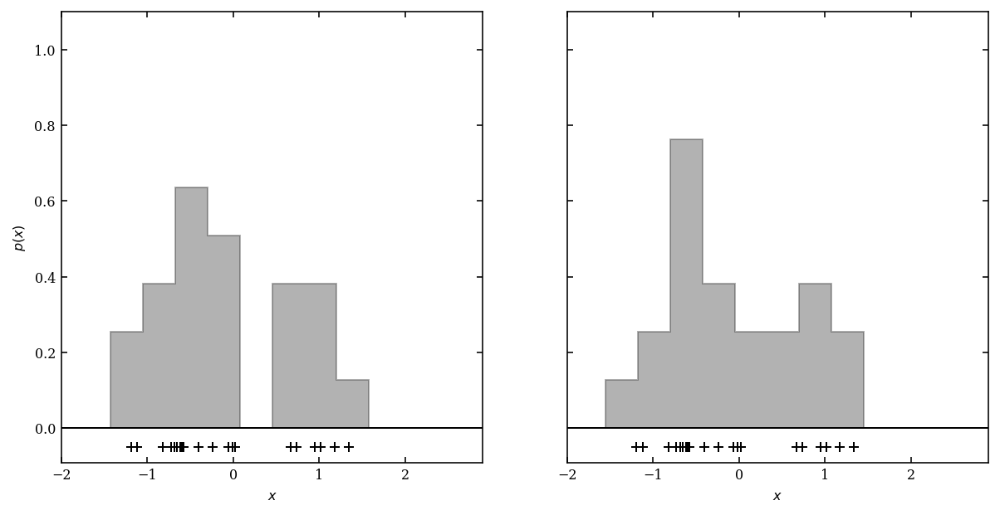

In [16]:
# Execute this cell
import numpy as np
from scipy import stats
from matplotlib import pyplot as plt
%matplotlib inline
%config InlineBackend.figure_format='retina'

#------------------------------------------------------------
# Draw some random data
np.random.seed(1)
x = np.concatenate([np.random.normal(-0.5, 0.3, size=14), 
                    np.random.normal(1, 0.3, size=7)])


# Modified from Ivezic, Figure 6.1, modified by GTR
# Author: Jake VanderPlas
# License: BSD
#   The figure produced by this code is published in the textbook
#   "Statistics, Data Mining, and Machine Learning in Astronomy" (2013)
#   For more information, see http://astroML.github.com
#   To report a bug or issue, use the following forum:
#    https://groups.google.com/forum/#!forum/astroml-general
#------------------------------------------------------------

# First figure: silly histogram binning
fig1 = plt.figure(figsize=(10, 5))
#fig1.subplots_adjust(left=0.12, right=0.95, wspace=0.05, 
#                    bottom=0.15, top=0.9, hspace=0.05)

FC = '#6666FF'
XLIM = (-2, 2.9)
YLIM = (-0.09, 1.1)

ax = fig1.add_subplot(121)
bins = np.linspace(-1.8, 2.7, 13)
ax.hist(x, bins=bins, density=True, 
        histtype='stepfilled', fc='k', alpha=0.3)
ax.plot(XLIM, [0, 0], '-k', lw=1)
ax.plot(x, 0 * x - 0.05, '+k')
ax.set_xlim(XLIM)
ax.set_ylim(YLIM)
ax.set_xlabel('$x$')
ax.set_ylabel('$p(x)$')

#Shift bin centers by 0.25
ax = fig1.add_subplot(122)
ax.yaxis.set_major_formatter(plt.NullFormatter())
ax.hist(x, bins=bins + 0.25, density=True, 
        histtype='stepfilled', fc='k', alpha=0.3)
ax.plot(XLIM, [0, 0], '-k', lw=1)
ax.plot(x, 0 * x - 0.05, '+k')
ax.set_xlim(XLIM)
ax.set_ylim(YLIM)
ax.set_xlabel('$x$')

plt.show()

The data points that make up the histogram are the same in both panels.  All we have done is shifted the locations of the bins by 0.25. ***The choice of number of bins and the location of bin centers can really change the histogram that we make.***

The next panels are what happens if we center the bins on each point. This is an example of **kernel density estimation** using a "***top-hat***" kernel. It is a good description of the data, but pretty ugly.

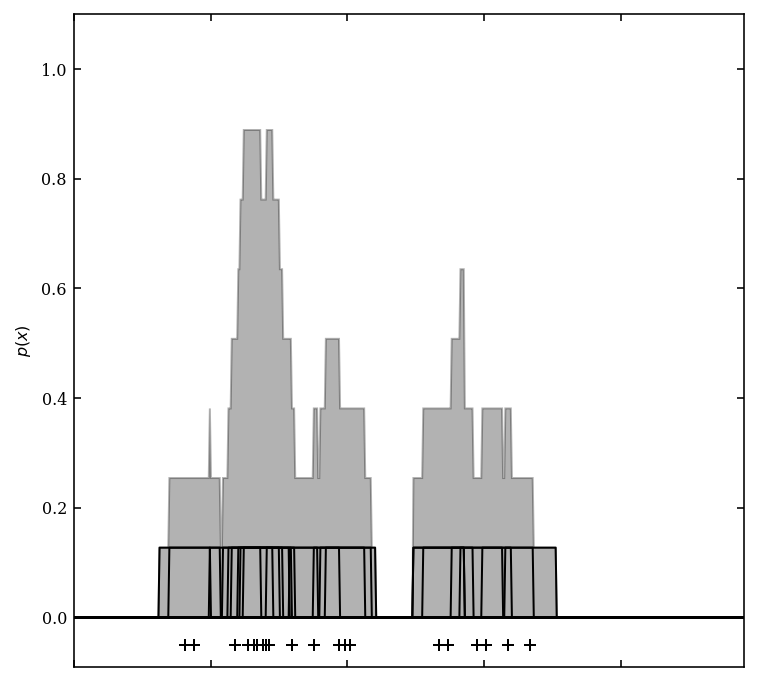

In [17]:
fig1b = plt.figure(figsize=(6, 6))
#fig1b.subplots_adjust(left=0.12, right=0.95, wspace=0.05, 
#                     bottom=0.1, top=0.95, hspace=0.05)

ax = fig1b.add_subplot(111)
ax.xaxis.set_major_formatter(plt.NullFormatter())
binwidth = bins[1] - bins[0]
x_plot = np.linspace(-4, 4, 1000)
y_plot = (abs(x_plot - x[:, None]) <= 0.5 * binwidth).astype(float)
y_plot /= (binwidth * len(x))
ax.fill(x_plot, y_plot.sum(0), ec='k', lw=1, fc='k', alpha=0.3)
ax.plot(x_plot, y_plot.T, '-k', lw=1)
ax.plot(x, 0 * x - 0.05, '+k')
ax.set_xlim(XLIM)
ax.set_ylim(YLIM)
ax.set_ylabel('$p(x)$')

plt.show()

We can make it look nicer by choosing a different kernel, i.e. a different bin shape. The next plot shows a **KDE using a Gaussian kernel**.



Text(0, 0.5, '$p(x)$')

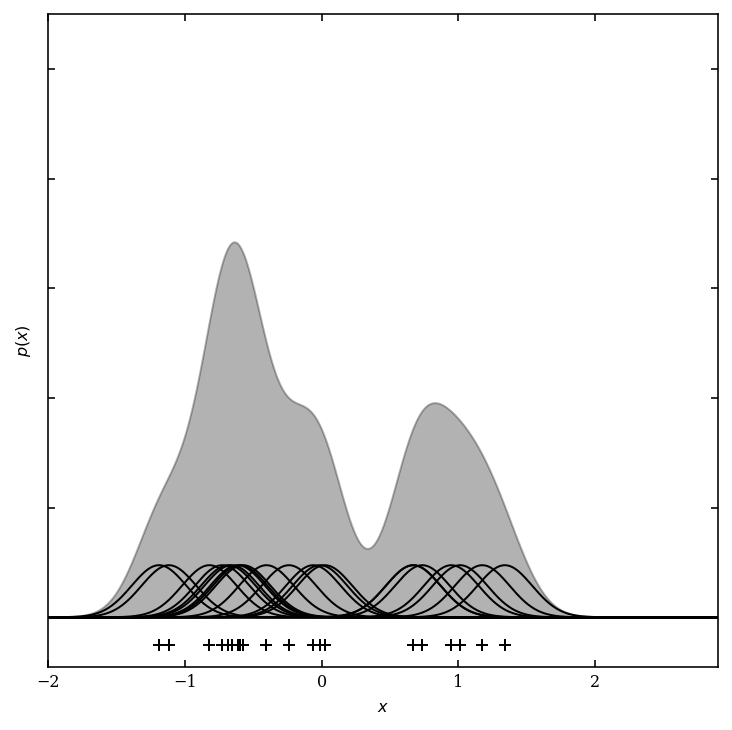

In [18]:
#------------------------------------------------------------
# First figure: transition to KDE
fig2 = plt.figure(figsize=(6, 6))
#fig2.subplots_adjust(left=0.12, right=0.95, wspace=0.05, 
#                     bottom=0.0, top=1.0, hspace=0.05)

## Just right
ax = fig2.add_subplot(111)
ax.yaxis.set_major_formatter(plt.NullFormatter())
binwidth = bins[1] - bins[0]
x_plot = np.linspace(-4, 4, 1000)
y_plot = binwidth * stats.norm.pdf(x_plot, x[:, None], 0.2)
y_plot /= (binwidth * len(x))
ax.fill(x_plot, y_plot.sum(0), ec='k', lw=1, fc='k', alpha=0.3)
ax.plot(x_plot, y_plot.T, '-k', lw=1)
ax.plot(x, 0 * x - 0.05, '+k')
ax.set_xlim(XLIM)
ax.set_ylim(YLIM)
ax.set_xlabel('$x$')
ax.set_ylabel('$p(x)$')

We can think of KDE as replacing the points with "clouds". Each cloud is described by the kernel $K(u)$, where $K(u)$ can be any function that is:
- smooth,
- postive definite,
- normalizes to unity, 
- has zero mean,
- has positive variance. 

A common kernel is the **Gaussian kernel** that we just used above:

$$ K(u) = \frac{1}{(2\pi)^{D/2}}\exp{(-u^2/2)}$$

where $D$ denotes the dimensionality of the data. Once a kernel is chosen the KDE at a point, $x$, is given by 

$$ \hat{f}(x) = \frac{1}{Nh^D}\sum_{i=1}^N K\left(\frac{d(x,x_i)}{h}\right),$$

where $\hat{f}$ is an ***estimator*** of our distribution.

The argument of $K$ is just some measure of the distance between $x$ and each $x_i$. Normally $d(x,x_i) = (x-x_i)$. For the gaussian kernel that makes $h=\sigma$. So, $h$ represents the "width" or what is usually called the **"bandwidth"** in this context.

**The Epanechnikov kernel is "optimal" because it minimizes the variance of the kernel density estimate**: 

$$K(x) = \frac{3}{4}(1-x^2),$$

for $|x|\le 1$ and 0 otherwise. Below is the code that produces the plot above.  


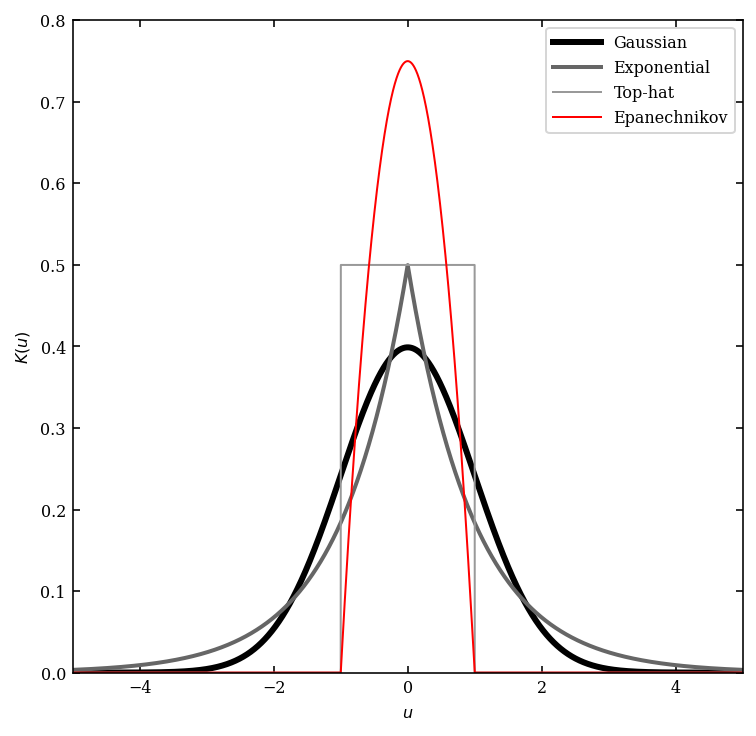

In [19]:
#------------------------------------------------------------
# Compute Kernels.
xgrid = np.linspace(-5, 5, 10000)
dx = xgrid[1] - xgrid[0]

# Gaussian kernel
gauss = (1. / np.sqrt(2 * np.pi)) * np.exp(-0.5 * xgrid ** 2)

# Exponential kernel
exp = 0.5 * np.exp(-abs(xgrid))

# Top-hat kernel
tophat = 0.5 * np.ones_like(xgrid)
tophat[abs(xgrid) > 1] = 0 # Range of the tophat kernel

# Epanechnikov kernel 
ep = 3/4 * (1-xgrid**2)  # Add the Epanechnikov kernel function
ep[np.abs(xgrid)>1] = 0 # Set the range of the kernel

#------------------------------------------------------------
# Plot the kernels
fig = plt.figure(figsize=(6, 6))
ax = fig.add_subplot(111)

ax.plot(xgrid, gauss, '-', c='black', 
        lw=3, label='Gaussian')
ax.plot(xgrid, exp, '-', c='#666666', 
        lw=2, label='Exponential')
ax.plot(xgrid, tophat, '-', c='#999999', 
        lw=1, label='Top-hat')
# Add the Epanechnikov kernel to the plot
ax.plot(xgrid, ep, '-', c='red', 
        lw=1, label='Epanechnikov')  

ax.legend(loc=1)

ax.set_xlabel('$u$')
ax.set_ylabel('$K(u)$')

ax.set_xlim(-5, 5)
ax.set_ylim(0, 0.8001)
plt.show()

#### How do we determine the optimal kernel bandwidth?

You know the answer to this one already: cross validation. Go back to lecture 14.



[0.01       0.04413793 0.07827586 0.11241379 0.14655172 0.18068966
 0.21482759 0.24896552 0.28310345 0.31724138 0.35137931 0.38551724
 0.41965517 0.4537931  0.48793103 0.52206897 0.5562069  0.59034483
 0.62448276 0.65862069 0.69275862 0.72689655 0.76103448 0.79517241
 0.82931034 0.86344828 0.89758621 0.93172414 0.96586207 1.        ]
0.14655172413793105


(-0.09, 1.1)

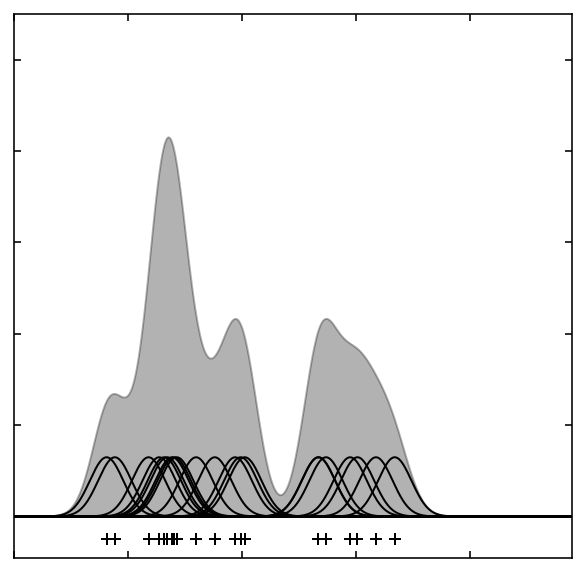

In [20]:
# Complete and Execute this cell to determine the bandwidth
from sklearn.neighbors import KernelDensity
from sklearn.model_selection import GridSearchCV

bwrange = np.linspace(0.01,1.0, 30) # Test 30 bandwidths from 0.1 to 1.0
print(bwrange)
K = 10 # Do 5-fold cross validation
grid = GridSearchCV(KernelDensity(), {'bandwidth': bwrange}, cv= K) # Try each bandwidth with K-folds
grid.fit(x[:, None]) #Fit the data that we started the lecture with.
h_opt = grid.best_params_['bandwidth']
print(h_opt)

# Execute this cell to see the new "histogram"
fig2 = plt.figure(figsize=(5, 5))
ax = fig2.add_subplot(111)
ax.xaxis.set_major_formatter(plt.NullFormatter())
ax.yaxis.set_major_formatter(plt.NullFormatter())

binwidth = bins[1] - bins[0]
x_grid = np.linspace(-4, 4, 1000)
y_plot = binwidth * stats.norm.pdf(x_grid, x[:, None], h_opt)
y_plot /= (binwidth * len(x))

ax.fill(x_grid, y_plot.sum(0), ec='k', lw=1, fc='k', alpha=0.3)
ax.plot(x_grid, y_plot.T, '-k', lw=1)
ax.plot(x, 0 * x - 0.05, '+k')

ax.set_xlim(XLIM)
ax.set_ylim(YLIM)

#### 2-D distributions

Here is some sample code using [`sklearn.neighbors.KernelDensity`](http://scikit-learn.org/stable/modules/generated/sklearn.neighbors.KernelDensity.html). Play around with this and see how it works.  Make different variations of the plot.  (For example, try `bandwidth=0.01` and `bandwidth=1.0`.)  What we are doing here is using KDE to set the plot color to indicate the relative density of the points.  This is essentially a 2-D histogram.

/var/folders/zv/8t9z941x3q1gmp080mdw8k_h0000gn/T/ipykernel_77364/1345506922.py:11: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  Xgrid = np.vstack(map(np.ravel, np.meshgrid(u, v))).T


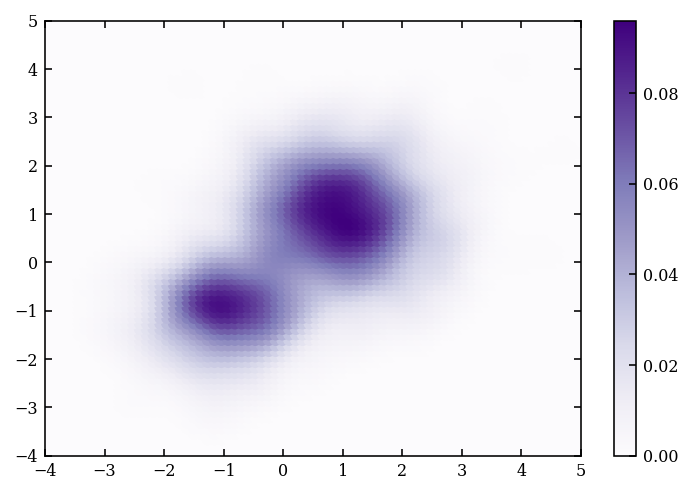

In [21]:
from sklearn.neighbors import KernelDensity

# Two 2-D normal distributions with offset centroids
# See what happens when you make changes to the next 2 lines.
X = np.concatenate([np.random.normal([-1,-1],[0.75,0.75], size=(500,2)), 
                    np.random.normal([1,1],[1,1], size=(1000,2))]) 
kde = KernelDensity(kernel='gaussian', bandwidth=0.3)
kde.fit(X) #fit the model to the data

u = v = np.linspace(-4,5,80)
Xgrid = np.vstack(map(np.ravel, np.meshgrid(u, v))).T
dens = np.exp(kde.score_samples(Xgrid)) #evaluate the model on the grid

plt.scatter(Xgrid[:,0], Xgrid[:,1], c=dens, 
            cmap="Purples", edgecolor="None")
plt.colorbar()

We now want do a data-driven selection of the bandwidth. That's a cross validation on a 2d KDE, which sounds sounds complicated. Actually, look at how easy this is! Just copy the example from above to a new cell and splice in the cross validation code to produce a new plot with the "optimal" bandwidth. Basically, splice in the lines of code for `GridSearchCV` between the lines setting `X` and instantiating `kde`.  Then replace the hardcoded bandwidth with the optimal value you computed.

That's it really, and it just works. This is a good example on how modern python libraries can really make you data-science life so much easier!

[0.01       0.04413793 0.07827586 0.11241379 0.14655172 0.18068966
 0.21482759 0.24896552 0.28310345 0.31724138 0.35137931 0.38551724
 0.41965517 0.4537931  0.48793103 0.52206897 0.5562069  0.59034483
 0.62448276 0.65862069 0.69275862 0.72689655 0.76103448 0.79517241
 0.82931034 0.86344828 0.89758621 0.93172414 0.96586207 1.        ]
0.14655172413793105


/var/folders/zv/8t9z941x3q1gmp080mdw8k_h0000gn/T/ipykernel_77364/1527284737.py:20: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  Xgrid = np.vstack(map(np.ravel, np.meshgrid(u, v))).T


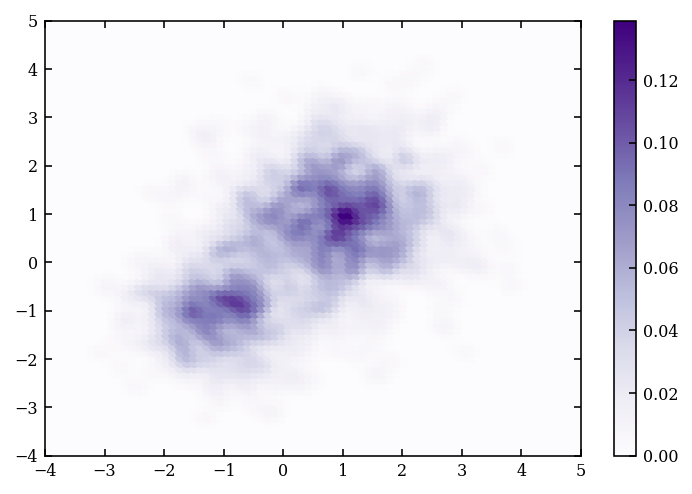

In [22]:
X = np.concatenate([np.random.normal([-1,-1],[0.75,0.75], size=(500,2)), 
                    np.random.normal([1,1],[1,1], size=(1000,2))]) 


#### I pasted from here...
bwrange = np.linspace(0.01,1.0, 30)
print(bwrange)
K = 10 
grid = GridSearchCV(KernelDensity(), {'bandwidth': bwrange}, cv= K)
grid.fit(x[:, None])
h_opt = grid.best_params_['bandwidth']
print(h_opt)
### ... to here


kde = KernelDensity(kernel='gaussian', bandwidth=h_opt) # Changed here.
kde.fit(X) 

u = v = np.linspace(-4,5,80)
Xgrid = np.vstack(map(np.ravel, np.meshgrid(u, v))).T
dens = np.exp(kde.score_samples(Xgrid))

plt.scatter(Xgrid[:,0], Xgrid[:,1], c=dens, 
            cmap="Purples", edgecolor="None")
plt.colorbar()



---

#### Nearest-Neighbor Density Estimation

Another very simple way to estimate the density of an $N$-dimensional distribution is to look to the nearest object (or the $K$ nearest objects) and compute their distances, $d_K$.  This is the [$K$-Nearest Neighbor](https://en.wikipedia.org/wiki/K-nearest_neighbors_algorithm) algorithm. The density at a given point, $x$ is estimated as

$$\hat{f}_K(x) = \frac{K}{V_D(d_K)},$$

where $V_D(d)$ is given generically by $\frac{2d^D\pi^{D/2}}{D\Gamma(D/2)}$ where $\Gamma$ is the complete gamma function, and this formula reduces to the usual equations for area and volume in 2 and 3 dimensions, respectively.

We can simplify this to 

$$\hat{f}_K(x) = \frac{C}{d_K^D}$$

since the constant, $C$ can be evaluated at the end.

This estimator has some intrinsic bias, which can be reduced by considering *all* $K$ nearest neighbors:
$$\hat{f}_K(x) = \frac{C}{\sum_{i=1}^K d_i^D}$$

See the [Scikit-Learn `neighbors` documentation](http://scikit-learn.org/stable/modules/neighbors.html) for more information.

Ivezic, Figure 6.5 compares a Nearest Neighbor ($k=10$) with a KDE algorithm. Let's what happens as you increase the number of neighbors used.

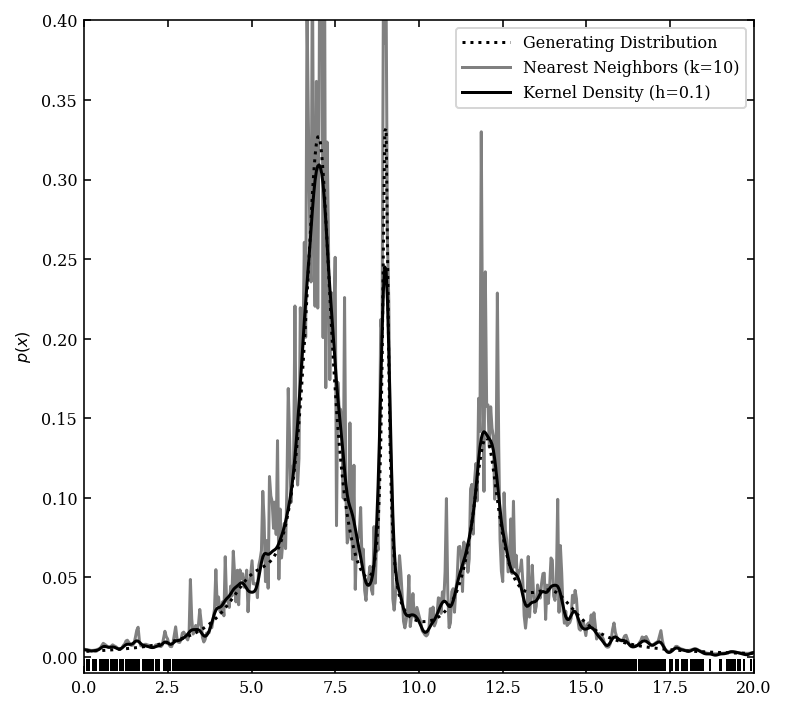

In [23]:
# Based on Ivezic, Figure 6.5
# Modified by GTR
# Author: Jake VanderPlas
# License: BSD
#   The figure produced by this code is published in the textbook
#   "Statistics, Data Mining, and Machine Learning in Astronomy" (2013)
#   For more information, see http://astroML.github.com
#   To report a bug or issue, use the following forum:
#    https://groups.google.com/forum/#!forum/astroml-general

from astroML.density_estimation import KNeighborsDensity
from astropy.visualization import hist
from sklearn.neighbors import KernelDensity

#------------------------------------------------------------
# Generate our data: a mix of several Cauchy distributions
#  this is the same data used in the Bayesian Blocks figure
np.random.seed(0)
N = 10000
mu_gamma_f = [(5, 1.0, 0.1),
              (7, 0.5, 0.5),
              (9, 0.1, 0.1),
              (12, 0.5, 0.2),
              (14, 1.0, 0.1)]
true_pdf = lambda x: sum([f * stats.cauchy(mu, gamma).pdf(x) 
                          for (mu, gamma, f) in mu_gamma_f])
x = np.concatenate([stats.cauchy(mu, gamma).rvs(int(f * N)) 
                    for (mu, gamma, f) in mu_gamma_f])
np.random.shuffle(x)
x = x[x > -10]
x = x[x < 30]

#------------------------------------------------------------
# plot the results
fig = plt.figure(figsize=(6, 6))
N = 5000
k = 10 #Number of neighbors

xN = x[:N]
t = np.linspace(-10, 30, 1000)

# Compute density with KDE
kde = KernelDensity(bandwidth=0.1, kernel='gaussian')
kde.fit(xN[:, None])
dens_kde = np.exp(kde.score_samples(t[:, None]))

# Compute density with Bayesian nearest neighbors
nbrs = KNeighborsDensity('bayesian', n_neighbors=k)
nbrs.fit(xN[:, None])
dens_nbrs = nbrs.eval(t[:, None]) / N

# plot the results
plt.plot(t, true_pdf(t), ':', color='black', 
         zorder=3, label="Generating Distribution")
plt.plot(xN, -0.005 * np.ones(len(xN)), '|k')
plt.plot(t, dens_nbrs, '-', lw=1.5, color='gray', 
         zorder=2, label="Nearest Neighbors (k=%i)" % k)
plt.plot(t, dens_kde, '-', color='black', 
         zorder=3, label="Kernel Density (h=0.1)")

# label the plot
plt.ylabel('$p(x)$')
plt.legend(loc='upper right')
plt.xlim(0, 20)
plt.ylim(-0.01, 0.4001)

plt.show()

### Parametric Density Estimation <a class="anchor" id="oneb"></a>

#### Gaussian Mixture Models (GMM)

We've done an excercise on this already, so let me recap this quickly for completeness. KDE centers each bin (or rather, kernel) at each point.  In a [**mixture model**](https://en.wikipedia.org/wiki/Mixture_model) we don't use a kernel for each data point, but rather we fit for the ***locations of the kernels*** in addition to the width. So a mixture model is sort of a hybrid between a traditional (fixed bin location/size) histogram and KDE. 

- Using lots of kernels (maybe even more than the AIC or BIC score suggests) may make sense if you just want to provide an accurate description of the data (as in density estimation).  
- Using fewer kernels makes mixture models more like clustering (see earlier lecture), where the suggestion is still to use many kernels in order to divide the sample into real clusters and "background".

Gaussians are the most commonly used components for mixture models.  So, the pdf is modeled by a sum of Gaussians:

$$p(x) = \sum_{k=1}^N \alpha_k \mathscr{N}(x|\mu_k,\Sigma_k),$$

where $\alpha_k$ are the "mixing coefficients" with $0\le \alpha_k \le 1$ and $\sum_{k=1}^N \alpha_k = 1$.

We can solve for the parameters using maximum likelihood analyis as we have discussed previously.
However, this can be complicated in multiple dimensions, requiring the use of [**Expectation Maximization (EM)**](https://en.wikipedia.org/wiki/Expectation%E2%80%93maximization_algorithm) methods (see textbook for details).

Ivezic Figure 4.2 (next cell) provides an example in 1-D.

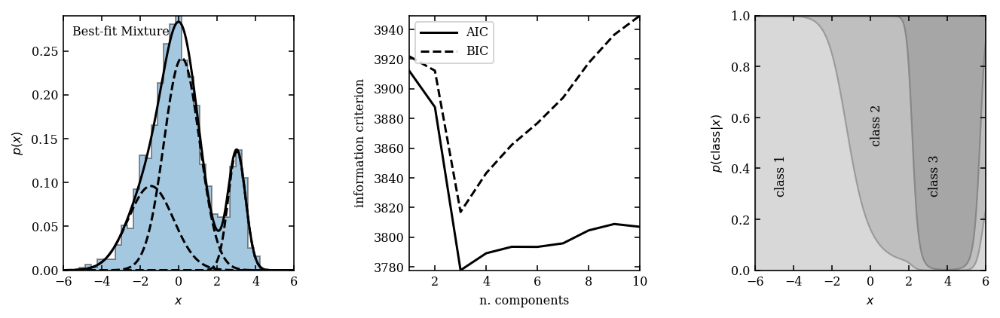

In [24]:
# Ivezic v2, Figure 4.2
# License: BSD
#   The figure produced by this code is published in the textbook
#   "Statistics, Data Mining, and Machine Learning in Astronomy" (2013)
#   For more information, see http://astroML.github.com
#   To report a bug or issue, use the following forum:
#    https://groups.google.com/forum/#!forum/astroml-general
from matplotlib import pyplot as plt
import numpy as np
from sklearn.mixture import GaussianMixture

#----------------------------------------------------------------------
# This function adjusts matplotlib settings for a uniform feel in the textbook.
# Note that with usetex=True, fonts are rendered with LaTeX.  This may
# result in an error if LaTeX is not installed on your system.  In that case,
# you can set usetex to False.
if "setup_text_plots" not in globals():
    from astroML.plotting import setup_text_plots
setup_text_plots(fontsize=8, usetex=False)

#------------------------------------------------------------
# Set up the dataset.
#  We'll create our dataset by drawing samples from Gaussians.

random_state = np.random.RandomState(seed=1)

X = np.concatenate([random_state.normal(-1, 1.5, 350),
                    random_state.normal(0, 1, 500),
                    random_state.normal(3, 0.5, 150)]).reshape(-1, 1)

#------------------------------------------------------------
# Learn the best-fit GaussianMixture models
#  Here we'll use scikit-learn's GaussianMixture model. The fit() method
#  uses an Expectation-Maximization approach to find the best
#  mixture of Gaussians for the data

# fit models with 1-10 components
N = np.arange(1, 11)
models = [None for i in range(len(N))]

for i in range(len(N)):
    models[i] = GaussianMixture(N[i]).fit(X)

# compute the AIC and the BIC
AIC = [m.aic(X) for m in models]
BIC = [m.bic(X) for m in models]

#------------------------------------------------------------
# Plot the results
#  We'll use three panels:
#   1) data + best-fit mixture
#   2) AIC and BIC vs number of components
#   3) probability that a point came from each component

fig = plt.figure(figsize=(10, 3.4))
fig.subplots_adjust(left=0.12, right=0.97,
                    bottom=0.21, top=0.9, wspace=0.5)


# plot 1: data + best-fit mixture
ax = fig.add_subplot(131)
M_best = models[np.argmin(AIC)]

x = np.linspace(-6, 6, 1000)
logprob = M_best.score_samples(x.reshape(-1, 1))
responsibilities = M_best.predict_proba(x.reshape(-1, 1))
pdf = np.exp(logprob)
pdf_individual = responsibilities * pdf[:, np.newaxis]

ax.hist(X, 30, density=True, histtype='stepfilled', alpha=0.4)
ax.plot(x, pdf, '-k')
ax.plot(x, pdf_individual, '--k')
ax.text(0.04, 0.96, "Best-fit Mixture",
        ha='left', va='top', transform=ax.transAxes)
ax.set_xlabel('$x$')
ax.set_ylabel('$p(x)$')


# plot 2: AIC and BIC
ax = fig.add_subplot(132)
ax.plot(N, AIC, '-k', label='AIC')
ax.plot(N, BIC, '--k', label='BIC')
ax.set_xlabel('n. components')
ax.set_ylabel('information criterion')
ax.legend(loc=2)


# plot 3: posterior probabilities for each component
ax = fig.add_subplot(133)

p = responsibilities
p = p[:, (1, 0, 2)]  # rearrange order so the plot looks better
p = p.cumsum(1).T

ax.fill_between(x, 0, p[0], color='gray', alpha=0.3)
ax.fill_between(x, p[0], p[1], color='gray', alpha=0.5)
ax.fill_between(x, p[1], 1, color='gray', alpha=0.7)
ax.set_xlim(-6, 6)
ax.set_ylim(0, 1)
ax.set_xlabel('$x$')
ax.set_ylabel(r'$p({\rm class}|x)$')

ax.text(-5, 0.3, 'class 1', rotation='vertical')
ax.text(0, 0.5, 'class 2', rotation='vertical')
ax.text(3, 0.3, 'class 3', rotation='vertical')

plt.show()

### Datasets you can play with

If irises, penguins, or hand-written digits aren't your thing, then have a look through some of these public data repositories. Explore!

- [https://github.com/caesar0301/awesome-public-datasets?utm_content=buffer4245d&utm_medium=social&utm_source=twitter.com&utm_campaign=buffer](https://github.com/caesar0301/awesome-public-datasets?utm_content=buffer4245d&utm_medium=social&utm_source=twitter.com&utm_campaign=buffer)
- [http://www.datasciencecentral.com/m/blogpost?id=6448529%3ABlogPost%3A318739](http://www.datasciencecentral.com/m/blogpost?id=6448529%3ABlogPost%3A318739)
- [http://www.kdnuggets.com/2015/04/awesome-public-datasets-github.html](http://www.kdnuggets.com/2015/04/awesome-public-datasets-github.html)

# And now... Pills of modern research with two professional astrostatisticians!

For today I've invited two of my scientific collaborators to give you some examples on how current astrophysical problems are tackled not just using, but also *developing* new statistical tools:  

- Viola De Renzis [Slides](https://github.com/dgerosa/astrostatistics_bicocca_2024/blob/main/lectures/T01_DeRenzis.pdf)
- Costantino Pacilio [Slides](https://github.com/dgerosa/astrostatistics_bicocca_2024/blob/main/lectures/T02_Pacilio.pdf)
 



If you want more, last year's "pill of modern research" were given by

- Matthew Mould. [Slides](https://github.com/dgerosa/astrostatistics_bicocca_2024/blob/main/lectures/T01_Mould.pdf)
- Riccardo Buscicchio. [Slides](https://github.com/dgerosa/astrostatistics_bicocca_2024/blob/main/lectures/T02_Buscicchio.pdf)

# Regression: I

## What is regression? <a class="anchor" id="one"></a>

[**Regression**](https://en.wikipedia.org/wiki/Regression_analysis) is about determining the relationship between an independent variable, $x$, and the variable that depends on it, $y$, where the expectation value of $y$ is $E[y|x]$. Crudely speaking, it is the set of techniques associated with curve fitting. In contrast to density estimation, clustering, and dimensional reduction (which was largely *unsupervised*) **regression is a *supervised* process**.

- Generally, we'd like to infer the true generating pdf of observations from a multi-dimensional sample of data that is drawn from that pdf, using parametric or non-parametric models to do so.  
- This is hard, so ***regression seeks to determine the expectation value of $y$ (given $x$, i.e. the conditional expectation value) rather than the full pdf.***  
- That is, for a given value of $x$ you'd like to predict the pdf of $y$, but you are going to settle for a **point estimate** (single value).

When I say "regression", you probably think about linear least-squares fitting (fitting a line) or maximum likelihood analysis. However, adopting a Bayesian perspective enables a more physical intuition that includes how we can do regression in the case of both errors and limits on the data. 

Let's start by looking at the classic example of fitting a straight line to some data points in 2-D as illustrated by Ivezic, Figure 8.1:

![Ivezic, Figure 8.1a](http://www.astroml.org/_images/fig_linreg_inline_1.png)

- Here we have 4 data points $\{x_1,x_2,x_3,x_4\}$ drawn from $y=\theta_1 x + \theta_0$, where $\theta_1 = 1$ and $\theta_0 = 0$.  
- Each data point provides a joint constraint on $(\theta_0,\theta_1)$.  
- If there were no uncertainties in the measurement of each $y$, then each new point would yield a straight line constraint in $(\theta_0,\theta_1)$ of 
$\theta_0 = y_i - \theta_1 x_i$.  
- Think about the constraints from the first point. You could fit an infinite number of different lines through it, all of which would completely cover the $(x,y)$ plane. ***However the parameters of those infinite lines are constrained by $x_1$ to lie along a unique line in the $(\theta_0,\theta_1)$ plane.*** See the first panel in the plot from the next cell.

In [2]:
# Execute this cell
import numpy as np
import pylab as plt
from matplotlib import pyplot as plt
%matplotlib inline
%config InlineBackend.figure_format='retina'

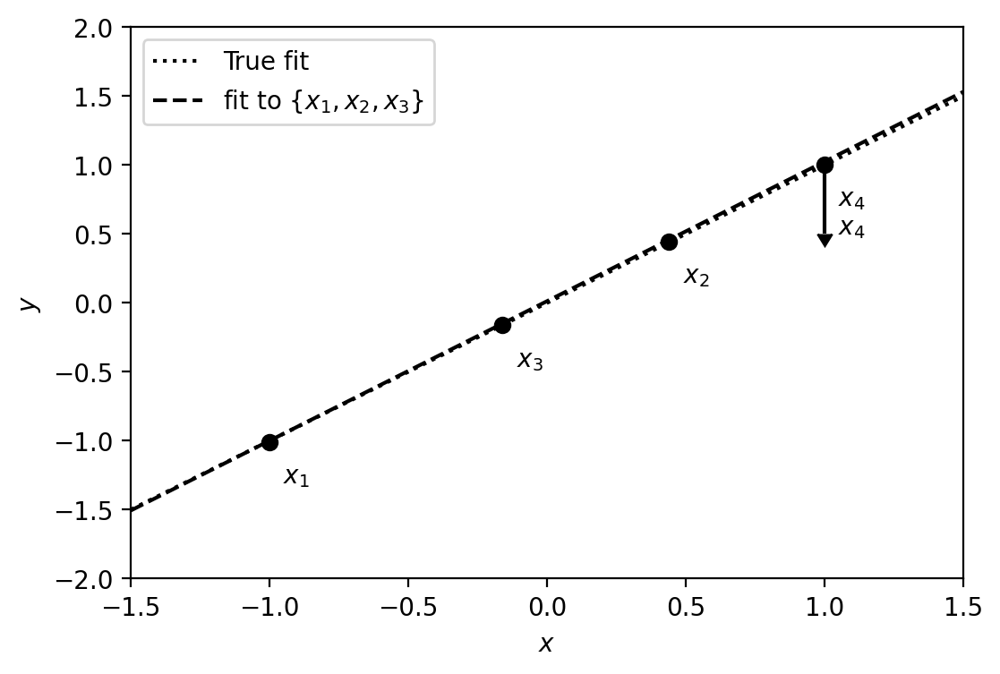

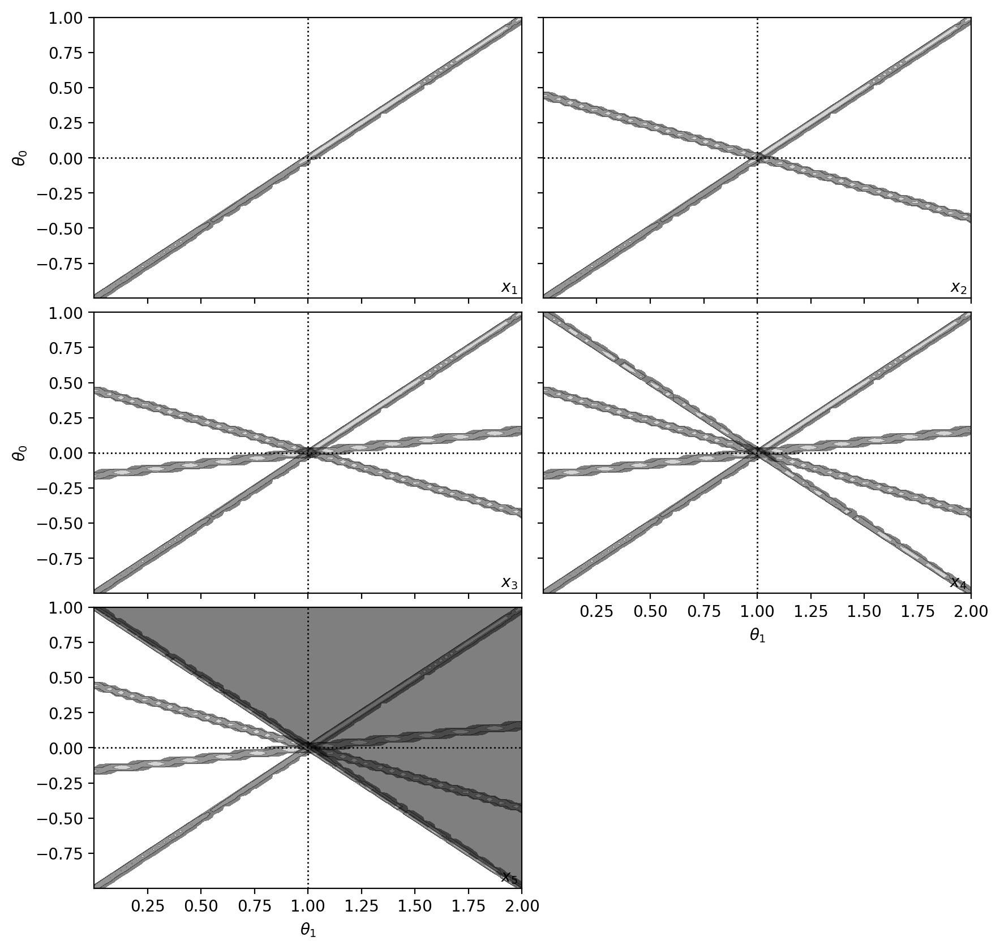

In [3]:
from astroML.plotting.mcmc import convert_to_stdev

#------------------------------------------------------------
# Set up the data and errors
np.random.seed(13)
a = 1
b = 0

x = np.array([-1, 0.44, -0.16, 1.0])
y = a * x + b
dy = np.array([0.01, 0.01, 0.01, 0.01])

y = np.random.normal(y, dy)

# add a fourth point which is a lower bound
x5 = 1.0
y5 = a * x5 + b + 0.0 

#------------------------------------------------------------
# Compute the likelihoods for each point
a_range = np.linspace(0, 2, 80)
b_range = np.linspace(-1, 1, 80)
logL = -((a_range[:, None, None] * x + 
          b_range[None, :, None] - y) / dy) ** 2
sigma = [convert_to_stdev(logL[:, :, i]) for i in range(4)]

# compute best-fit from first three points
logL_together = logL.sum(-1)
i, j = np.where(logL_together == np.max(logL_together))

amax = a_range[i[0]]
bmax = b_range[j[0]]

#------------------------------------------------------------
# Plot the first figure: the points and errorbars
fig1 = plt.figure(figsize=(6, 4))
ax1 = fig1.add_subplot(111)

# Draw the true and best-fit lines
xfit = np.array([-1.5, 1.5])
ax1.plot(xfit, a * xfit + b, ':k', label='True fit')
ax1.plot(xfit, amax * xfit + bmax, '--k', 
         label='fit to $\{x_1, x_2, x_3\}$')

ax1.legend(loc=2)

ax1.errorbar(x, y, dy, fmt='ok')
ax1.errorbar([x5], [y5], [[0.5], [0]], 
             fmt='_k', uplims=True)

for i in range(4):
    ax1.text(x[i] + 0.05, y[i] - 0.3, 
             "$x_{%i}$" % (i + 1))
ax1.text(x5 + 0.05, y5 - 0.5, "$x_4$")

ax1.set_xlabel('$x$')
ax1.set_ylabel('$y$')

ax1.set_xlim(-1.5, 1.5)
ax1.set_ylim(-2, 2)

#------------------------------------------------------------
# Plot the second figure: likelihoods for each point
fig2 = plt.figure(figsize=(10, 10))
fig2.subplots_adjust(hspace=0.05, wspace=0.05)

# plot likelihood contours
for i in range(5):
    ax = fig2.add_subplot(321 + i)
    for j in range(min(i + 1, 4)):
        ax.contourf(a_range, b_range, sigma[j].T,
                    levels=(0, 0.683, 0.955, 0.997),
                    cmap=plt.cm.binary, alpha=0.5)

# plot the excluded area from the fourth point
axpb = a_range[:, None] * x5 + b_range[None, :]
mask = y5 < axpb
fig2.axes[4].fill_between(a_range, y5 - x5 * a_range, 
                          2, color='k', alpha=0.5)

# Label and adjust axes
for i in range(5):
    ax = fig2.axes[i]

    ax.text(1.98, -0.98, "$x_{%i}$" % (i + 1), 
            ha='right', va='bottom')

    ax.plot([0, 2], [0, 0], ':k', lw=1)
    ax.plot([1, 1], [-1, 1], ':k', lw=1)

    ax.set_xlim(0.001, 2)
    ax.set_ylim(-0.999, 1)

    if i in (1, 3):
        ax.yaxis.set_major_formatter(plt.NullFormatter())
    if i in (0, 1, 2):
        ax.xaxis.set_major_formatter(plt.NullFormatter())
    if i in (0, 2):
        ax.set_ylabel(r'$\theta_0$')
    if i in (3, 4):
        ax.set_xlabel(r'$\theta_1$')

plt.show()

- Now look at the top right panel. The addition of another data point is sufficient to fully constrain the properties of a linear relationship, shown by the intersection of the $(\theta_0,\theta_1)$ lines from each point.
- More data points yield more constraints, and the best fit solution is the intersection of all lines in model parameter space (as shown in the next 3 panels).

**NOTE:** The errors are really small so that the constraints are just lines in parameter space. The 4th $x$ value is shown as a point estimate and a limit, so that you can see that the excluded region from the limit just follows the line that would result had it been a detection.

If the measurements have uncertainties then the lines are linear-shaped distributions as illustrated in the actual Figure 8.1 from Ivezic as shown below.

![Ivezic, Figure 8.1b](http://www.astroml.org/_images/fig_linreg_inline_2.png)

### Bayesian perspective on regression

If we take a Bayesian approach to regression, then we can easily write the posterior pdf for the model parameters as

$$p(\theta|\{x_i, y_i\},I) \propto p(\{x_i,y_i\} | \theta, I) \, p(\theta, I),$$

where the data likelihood is the product over the individual event likelihoods, which can be written as

$$p(y_i|x_i,{\theta}, I) = e(y_i|y)$$

with $e(y_i|y)$ being the probability of getting $y_i$ given the adopted model of $y=f(x|\theta)$ (i.e. the error distribution). If the error distribution is Gaussian then,

$$p(y_i|x_i,{\theta}, I) = {1 \over \sigma_i \sqrt{2\pi}} \, \exp{\left({-[y_i-f(x_i|{\theta})]^2 \over 2 \sigma_i^2}\right)}.$$

## 2-D Linear Regression <a class="anchor" id="two"></a>

Let's start with the simplest case: a linear model with independent variable, $x$, and dependent variable, $y$:

$$y_i = \theta_0 + \theta_1 x_i + \epsilon_i,$$

where $\theta_0$ and $\theta_1$ are the coefficients of the model that we are trying to estimate, and $\epsilon_i$ is an additive noise term with $\epsilon_i = \mathscr{N}(0,\sigma_i)$. 

As we've seen many times, the full data likelihood is the product of each individual event likelihood:

$$p(\{y_i\}|\{x_i\},{\theta}, I) \propto \prod_{i=1}^N \exp \left(\frac{-(y_i- (\theta_0 + \theta_1x_{i}))^2}{  2\sigma_i^2}\right).$$

Assuming a flat/uninformative prior, the log of the posterior probability is then

$$\ln(p({\theta}|\{x_i, y_i\},I)) \propto \ln \mathcal(L)  \propto \sum_{i=1}^N \left(\frac{-(y_i- (\theta_0 + \theta_1x_{i}))^2}{  2\sigma_i^2}\right).$$

***We want to find the values of $\theta$ that maximize this expression, which is the same as minimizing the least squares.*** 

### Homoscedastic uncertainty scenario

With uncertainties that are the same for all points, this minimization yields

$$\theta_1 = \frac{\sum_i^N x_i y_i - \bar{x}\bar{y}}{\sum_i^N(x_i-\overline{x})^2},$$

and

$$\theta_0 = \overline{y} - \theta_1\overline{x},$$

where $\overline{x}$ and $\overline{y}$ are the mean values.

The estimate of the variance and the standard errors of the estimated parameters are

$$\sigma^2 = \sum_{i=1}^N (y_i - \theta_0 + \theta_1 x_i)^2,$$

$$\sigma_{\theta_1}^2 = \sigma^2\frac{1}{\sum_i^N(x_i-\overline{x})^2},$$

$$\sigma_{\theta_0}^2 = \sigma^2\left(\frac{1}{N} + \frac{\overline{x}^2}{\sum_i^N(x_i-\overline{x})^2}\right).$$

### Heteroscedastic uncertainty scenario

If the errors are instead different for each point, it is better to think of the problem in matrix notation:

$$Y = M \theta$$

where $Y$ is an $N$-dimensional vector of values ${y_i}$,

$$Y = \left[
    \begin{array}{c}
    y_0\\
    \vdots\\
    y_{N-1}
    \end{array}
    \right].
$$

For the straight line model, $\theta$ is simply a two-dimensional vector of regression coefficients,

$$
\theta = \left[
            \begin{array}{c}
            \theta_0\\
            \theta_1
            \end{array}
          \right],
$$

and **$M$ is a called the design matrix**

$$
M = \left[
        \begin{array}{cc}
        1 & x_0\\
        \vdots & \vdots\\
        1 & x_{N-1}
        \end{array}
    \right],
$$

where the constant in the first column of $M$ captures the zeropoint (i.e. the constant $y$-intercept) in the regression.

The log-likelihood can then be written as

$$ \ln\mathcal(L) = -\frac{1}{2}(Y-M\theta)^T C^{-1} (Y-M\theta) - \frac{1}{2}\ln[\mathrm{det}(C)]$$

where we encapsulate uncertainties in the ($N\times N$) covariance matrix

$$C=\left[
        \begin{array}{cccc}
        \sigma_{0}^2 & 0 & \cdots & 0 \\
        \vdots & \vdots & \cdots & \vdots \\
        0 & 0 & \cdots & \sigma_{N-1}^2 \\
        \end{array}
    \right].
$$

and the maximum likelihood solution for the regression can be analytically solved and expressed as

$$\theta = (M^T C^{-1} M)^{-1} (M^T C^{-1} Y),$$

which minimizes the sum of squares, and gives uncertainties on $\theta$ of 

$$\Sigma_\theta = \left[
                    \begin{array}{cc}
                    \sigma_{\theta_0}^2 & \sigma_{\theta_0\theta_1} \\
                    \sigma_{\theta_0\theta_1} & \sigma_{\theta_1}^2
                    \end{array}
                  \right]
                    = [M^T C^{-1} M]^{-1}.
$$

With `numpy` it is straightforward to write the matrices as multi-dimensional arrays, and do the linear algebra (provided the matrices are invertible), then calculate the regression coefficients.

Let's start with some noisy data and the known solution.

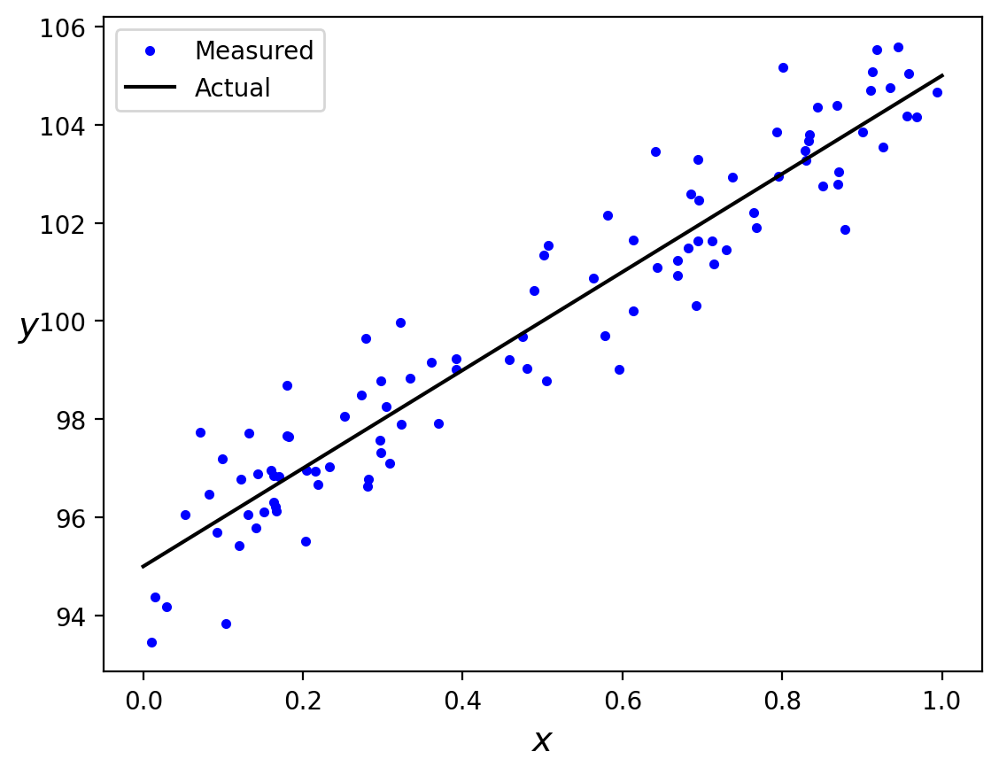

In [4]:
theta0 = 95 # Known value of b (theta0)
theta1 = 10 # Known value of m (theta1)
noise_std = 1.0 
noise = np.random.randn(100, 1) * noise_std
dy = noise

X = np.random.rand(100, 1)
y = theta0 + theta1 * X + dy

#print(X.shape)
#print(y.shape)

X_grid = np.linspace(0,1,11)
y_true = theta0 + theta1*X_grid

plt.plot(X, y, "b.", label='Measured')
plt.plot(X_grid, y_true, "k-", label='Actual')
plt.xlabel("$x$", fontsize=14)
plt.ylabel("$y$", rotation=0, fontsize=14)
plt.legend()
plt.show()

Now solve for the $\theta$ values. First using matrix math as shown below.

In [6]:
# diagonal noise matrix
C = np.identity(len(X[:,0])) * noise_std**2

# design matrix
M = np.column_stack((np.ones(len(X[:,0])), X[:,0]))

# Sigma^-1 = M^T * C^-1 * M
A = np.dot(np.dot(M.T, np.linalg.pinv(C)), M)

# M^T * C^-1 * y
B = np.dot(np.dot(M.T, np.linalg.pinv(C)), y)

# theta = Sigma * M^T * C^-1 * y
theta = np.dot(np.linalg.pinv(A),B)
print(theta)

[[94.98203304]
 [10.08898825]]


Use the results to make predictions and compare to the known answer.

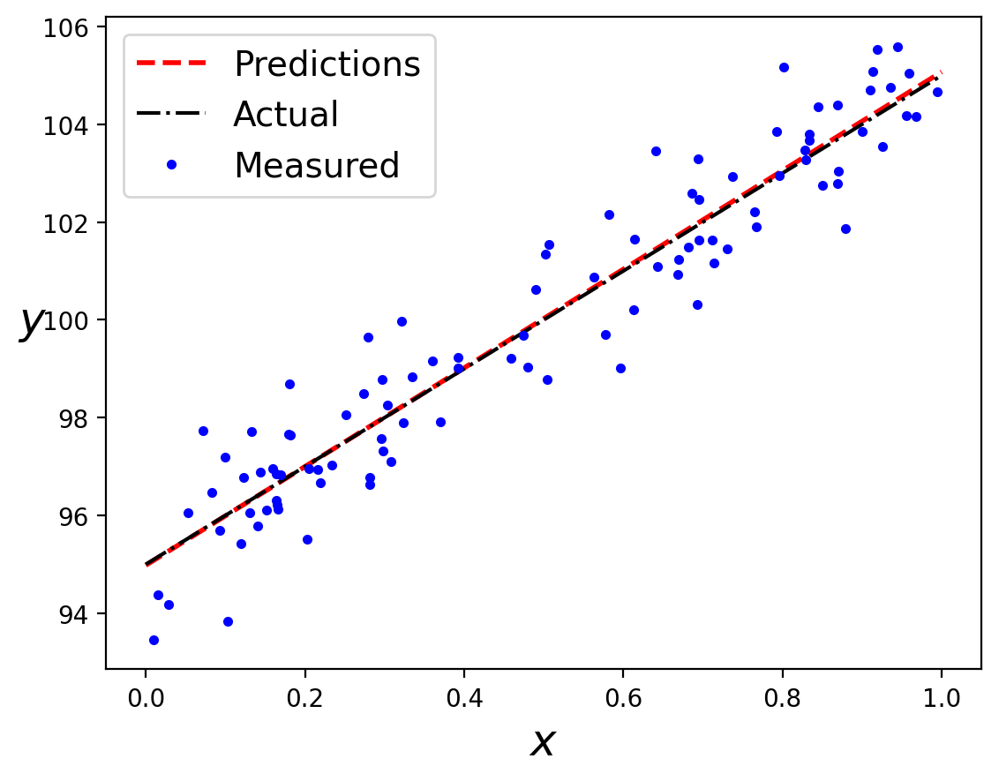

In [8]:
X_new = np.array([[0], [1]]) #like X_grid, but just with the endpoints
y_pred = theta[0] + theta[1]*X_new  # Complete 

plt.plot(X_new, y_pred, "r--", linewidth=2, label="Predictions")
plt.plot(X_grid, y_true, "k-.", label="Actual") # Comment this out to see that it agrees with the above
plt.plot(X, y, "b.", label='Measured')
plt.xlabel("$x$", fontsize=18)
plt.ylabel("$y$", rotation=0, fontsize=18)
plt.legend(loc="upper left", fontsize=14)
plt.show()

#N.B. you could also do this as 
#y_pred = np.dot(MM,theta)
#if MM were defined appropriately
#MM = np.column_stack((np.ones(len(X_grid)),X_grid))
#y_pred = np.dot(MM,theta)
#plt.plot(MM[:,1], y_pred, "r--", linewidth=2, label="Predictions")

Much easier with [LinearRegression](https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.LinearRegression.html) from `Scikit-Learn`.

In [9]:
from sklearn.linear_model import LinearRegression

lin_reg = LinearRegression()
lin_reg.fit(X, y, sample_weight=1.0)

theta0 = lin_reg.intercept_
theta1 = lin_reg.coef_

print(theta0, theta1)
y_pred2 = lin_reg.predict(X_new)

[94.98203304] [[10.08898825]]


Let's have a look at $C$, $M$, $A$, $B$, and $\theta$

In [10]:
print(C)

[[1. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 1.]]


In [11]:
print(M)

[[1.         0.69425006]
 [1.         0.0528662 ]
 [1.         0.5814383 ]
 [1.         0.17972813]
 [1.         0.50669135]
 [1.         0.28151884]
 [1.         0.37007688]
 [1.         0.50452891]
 [1.         0.12233121]
 [1.         0.1306642 ]
 [1.         0.84441426]
 [1.         0.39219855]
 [1.         0.16956248]
 [1.         0.80117907]
 [1.         0.91012863]
 [1.         0.82957748]
 [1.         0.71405093]
 [1.         0.09936765]
 [1.         0.91330124]
 [1.         0.57797935]
 [1.         0.90027545]
 [1.         0.56357017]
 [1.         0.00984544]
 [1.         0.99423936]
 [1.         0.13239784]
 [1.         0.69263626]
 [1.         0.33428825]
 [1.         0.18020376]
 [1.         0.14059767]
 [1.         0.66924741]
 [1.         0.30385427]
 [1.         0.61365453]
 [1.         0.93559939]
 [1.         0.20290489]
 [1.         0.11961015]
 [1.         0.39219066]
 [1.         0.69453923]
 [1.         0.94496703]
 [1.         0.16338249]
 [1.         0.45871331]


In [12]:
print(A)

[[100.          48.84181777]
 [ 48.84181777  32.84659301]]


In [13]:
print(B)

[[9990.96782953]
 [4970.48403987]]


In [14]:
print(theta)

[[94.98203304]
 [10.08898825]]


Now compare `y_pred` to `y_pred2`.

In [15]:
print(y_pred)
print(y_pred2)

[[ 94.98203304]
 [105.07102129]]
[[ 94.98203304]
 [105.07102129]]


So, what we did was to replace
```
C = np.identity(len(X))*(dy*dy)
M = np.column_stack((np.ones(len(X)),X))
A = np.dot(np.dot(M.transpose(),np.linalg.pinv(C)),M)
B = np.dot(np.dot(M.transpose(),np.linalg.pinv(C)),y)
theta = np.dot(np.linalg.pinv(A),B)

y_pred = np.dot(M_new,theta) # using design matrix at new x locations
```

with
```
LRmodel = LinearRegression()
LRmodel.fit(X, y, sample_weight=noise_std)
y_pred = LRmodel.predict(X_new)
```

A reminder on nomenclature for `Scikit-Learn`: 
- $X$ is the multidimensional matrix of $N$ "objects", each with $K$ attributes.  
- $y$ is the dependent variable that represents the measured value for each of those $N$ objects.  
- What is new here is that are adding $dy$, which is the uncertainty on $y$. 

The fitting algorithms are going to be of the form:

```model.fit(X,y,dy)```.

### A Word of Caution

[Anscombe's Quartet](https://en.wikipedia.org/wiki/Anscombe%27s_quartet) is a demonstration of why you should always visualize your data and not just blindly use the parameters of some black-box fitting algorithm.

![Anscombe's Quartet](https://upload.wikimedia.org/wikipedia/commons/thumb/e/ec/Anscombe%27s_quartet_3.svg/1000px-Anscombe%27s_quartet_3.svg.png)

Each of these data sets has $11$ points and basic statistical properties that are identical. For example, they all have the same best fit when assuming a linear model.

## Multivariate linear regression <a class="anchor" id="three"></a>

In the above cases, we were doing 2-D linear regression with a univariate $X$.  If $X$ is instead multivariate, then we fit a hyperplane rather than a straight line

$$y_i =\theta_0 + \theta_1x_{i1} + \theta_2x_{i2} + \cdots +\theta_kx_{ik} + \epsilon_i.$$
 
The design matrix, $M$, is now 

$$M = \left(
        \begin{array}{ccccccc}
        1 & x_{01} & x_{02} & . & x_{0k}\\
        1 & x_{11} & x_{12} & . & x_{1k}\\
        . & . & . & .  & . \\
        1 & x_{N1} & x_{N2} & . & x_{Nk}\\
        \end{array}
      \right)
$$

but the whole formalism is exactly the same as before.



In [16]:
from astroML.linear_model import LinearRegression

Xtest = np.random.random((100,2)) # 100 points in 2D
dytest = np.random.random(100) # heteroscedastic errors
ytest = np.random.normal(Xtest[:,0] + Xtest[:,1], dytest) # y = 0 + 1*x1 + 1*x2

model = LinearRegression()
model.fit(Xtest, ytest, dytest)

print(model.coef_)
#y_pred = model.predict(X)

[-0.00416967  1.00035586  1.00842178]


Note that Scikit-Learn's [`LinearRegression`](http://scikit-learn.org/stable/modules/generated/sklearn.linear_model.LinearRegression.html) routine does not explicitly account for heteroscedastic error. This is unfortunate, but this generalization is implemented in [astroML.linear_model.LinearRegression](https://www.astroml.org/modules/generated/astroML.linear_model.LinearRegression.html).

## Polynomial Regression <a class="anchor" id="four"></a>

We introduced regression with examples of straight-line fitting, but we can think of it more generically in terms of **[polynomical regression](https://en.wikipedia.org/wiki/Polynomial_regression)** with $y=f(x|\theta)$ and

$$y_i =\theta_0 + \theta_1 x_{i} + \theta_2 x_{i}^2 + \theta_3 x_{i}^3 + \cdots.$$   

For example, maybe $y$ depends on the area or volume of an object, but you have mesured the length. More generally, this is like fitting a model that is a Taylor expansion of the exact $f(x)$ to determine amplitudes of the different polynomial terms.

For polynomical regression, the design matrix $M$ is now
 
$$
M = \left(
        \begin{array}{cccccc}
        1 & x_{0} & x_{0}^2 & x_{0}^3\\
        1 & x_{1} & x_{1}^2 & x_{1}^3\\
        . & . & . & . \\
        1 & x_{N} & x_{N}^2 & x_{N}^3\\
        \end{array}
    \right).
$$

**NOTE:** Be careful with terminology!! ***This is still Linear Regression since the model only depends linearly on the parameters.*** The "linear" in linear regression corresponds to these parameters, not the independent variable $x$.

As with linear regression, we'll use `PolynomialRegression` from `AstroML`.

In [17]:
# Typical call
from astroML.linear_model import PolynomialRegression

Xtest = np.random.random((100,1))
ytest = 2.5*Xtest[:,0]**2 + 5.0*Xtest[:,0]**3

degree = 3
model = PolynomialRegression(degree) # fit 3rd degree polynomial
model.fit(Xtest, ytest)

y_pred = model.predict(Xtest)
n_constraints = degree + 1

print(model.coef_)

[ 1.42108547e-15 -3.55271368e-15  2.50000000e+00  5.00000000e+00]


## Basis function regression <a class="anchor" id="five"></a>

If we consider a function in terms of a sum over bases (this can be polynomials, Gaussians, sines) then we can solve for the linear amplitude coefficients using regression. ***So regression with arbitrary basis terms that may be non-linear in $x$ is still linear regression, since the model is linear in the regression parameters.*** 

Above we have used polynomials, but we could substitute $x_{0}^2$ etc for Gaussians (where we fix $\sigma$ and $\mu$ and fit for the amplitude) as long as the attribute we are fitting for is linear. So if straight-line regression is just a special case of polynomial regression, then polynomial regression is just a special case of basis function regression. All of these are linear regression techniques.

In [18]:
#Basis function regression looks like this
from astroML.linear_model import BasisFunctionRegression

# data
Xtest = np.random.random((100,1))

ytest = np.random.normal(Xtest[:,0], dytest)

# mean positions of the 10 Gaussians in the model
X_gridtest = np.linspace(0,1,10)[:, None]
# widths of these Gaussians
sigma_test = 0.1

model = BasisFunctionRegression('gaussian', mu=X_gridtest, sigma=sigma_test)
model.fit(Xtest, ytest, dytest)

y_pred = model.predict(Xtest)
print(model.coef_)

[-2.22858199  0.32814614  0.27991267  0.17260046  0.37760029  0.22468128
  0.38122294  0.2290141   0.5042547   0.03533774  0.75574282]


## Kernel Regression <a class="anchor" id="six"></a>

In the case of Gaussian Basis Regression, if you think about it, we were back to the old problem of making a histogram.  Specifically, our Gaussians were evenly spaced over the range of interest. If we instead placed Gaussians at the location of every data point, we get Gaussian Kernel Regression instead. Or just **[Kernel Regression](https://en.wikipedia.org/wiki/Kernel_regression)** more generally since we don't *have* to have a Gaussian kernel function. It is also called **Nadaraya-Watson regression**.

Given a kernel $K(x_i,x)$ (e.g., a Gaussian or top-hat) at each point we estimate the function value by

$$f(x|K) = \frac{\sum_{i=1}^N K\left( \frac{||x_i-x||}{h} \right) y_i}
{\sum_{i=1}^N K\left( \frac{||x_i-x||}{h} \right)},$$

which is a weighted sum of $y$ (weighted by distance) with

$$w_i(x) = \frac{ K\left( \frac{||x_i-x||}{h} \right)}
{\sum_{i=1}^N K\left( \frac{||x_i-x||}{h} \right)}.$$

This **locally weighted regression** technique drives the regressed value to the nearest neighbor (when we have few points) which helps with extrapolation issues. As we saw with KDE, defining the correct bandwidth of the kernel is more important than the shape of the kernel itself and is done through **cross-validation**.

Nadaraya-Watson is implemented in `AstroML` as follows (note that the y errors are irrelevant, at least in this implementation)

In [44]:
from astroML.linear_model import NadarayaWatson

Xtest = np.random.random((100,2))
ytest = Xtest[:,0] + Xtest[:,1]

model = NadarayaWatson(kernel='gaussian', h=0.05)
model.fit(Xtest,ytest)

y_pred = model.predict(Xtest)

## Over/Under-fitting <a class="anchor" id="seven"></a>

We already talked a little bit about overfitting, but let's dive down deeper now that we are trying to fit complicated models. We'll use a 1-D model with homoscedastic errors for the sake of illustration, but this discussion applies to more complicated data as well.

To be clear, our data consists of $X_{\rm train}$, $y_{\rm train}$, and $X_{\rm test}$ and we are trying to predict $y_{\rm test}$.  

Let's take an example where

$$0\le x_i \le 3$$

and

$$y_i = x_i \sin(x_i) + \epsilon_i,$$

where the noise, $\epsilon_i$ is given by $\mathscr{N}(0,0.1)$.

In the example below, we draw 20 evenly spaced points from this distribution and fit them with a straight line.

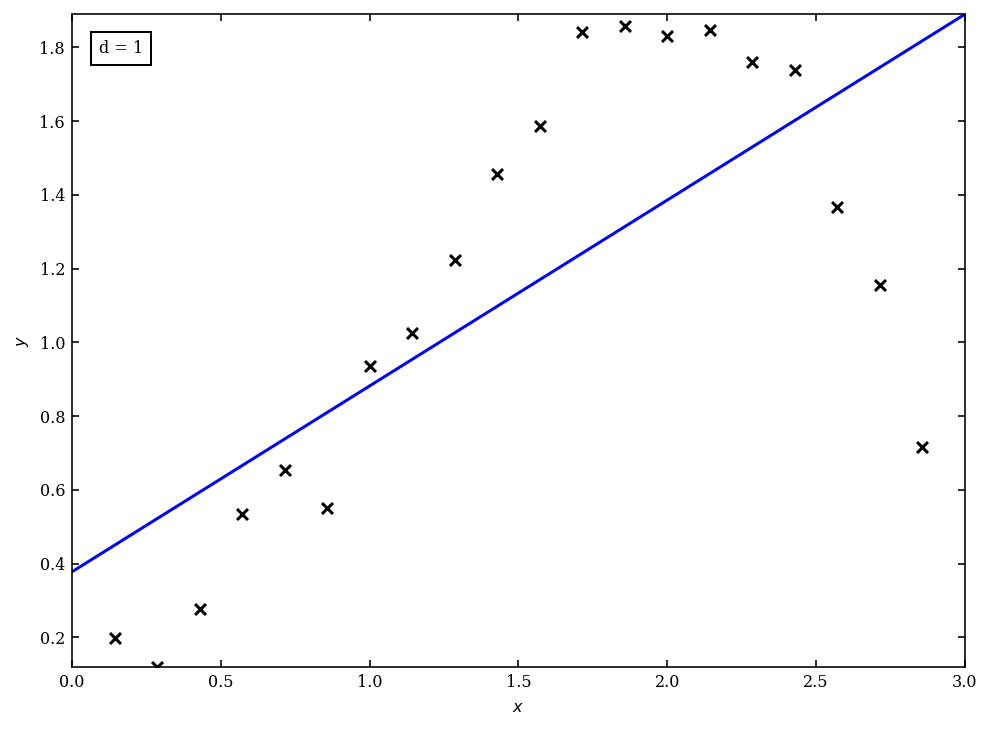

In [45]:
from matplotlib import ticker
from matplotlib.patches import FancyArrow

#------------------------------------------------------------
# Define our functional form
def func(x, dy=0.1):
    return np.random.normal(np.sin(x) * x, dy)

#------------------------------------------------------------
# select the (noisy) data
np.random.seed(0)
x = np.linspace(0, 3, 22)[1:-1]
dy = 0.1
y = func(x, dy)

#------------------------------------------------------------
# Select the cross-validation points
np.random.seed(1)
x_cv = 3 * np.random.random(20)
y_cv = func(x_cv)

x_fit = np.linspace(0, 3, 1000)

#------------------------------------------------------------
# First figure: plot points with a linear fit
fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111)

ax.scatter(x, y, marker='x', c='k', s=30)

p = np.polyfit(x, y, 1)
y_fit = np.polyval(p, x_fit)

ax.text(0.03, 0.96, "d = 1", transform=plt.gca().transAxes,
        ha='left', va='top',
        bbox=dict(ec='k', fc='w'))

ax.plot(x_fit, y_fit, '-b')
ax.set_xlabel('$x$')
ax.set_ylabel('$y$')

plt.show()

- This model **underfits** the data and is said to be "biased" (in the sense that the estimated model parameters deviate significantly from the true model parameters).  
- A straight line is a polynomial of order 1, so let's try polynomials of higher order.

/Users/dgerosa/box/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3398: RankWarning: Polyfit may be poorly conditioned
  exec(code_obj, self.user_global_ns, self.user_ns)


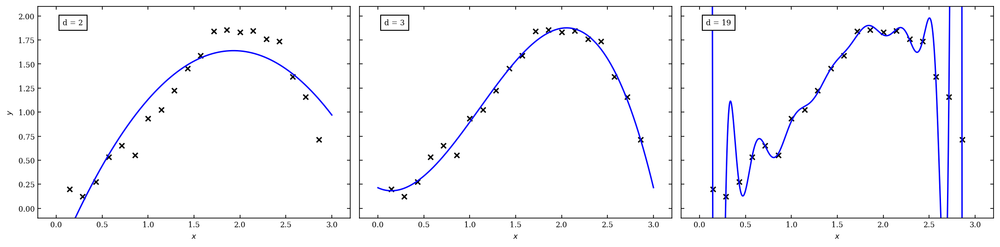

In [46]:
# Ivezic v2, Figure 8.13, panels made bigger by GTR and sizing altered by SRT
# Author: Jake VanderPlas
# License: BSD
#   The figure produced by this code is published in the textbook
#   "Statistics, Data Mining, and Machine Learning in Astronomy" (2013)
#   For more information, see http://astroML.github.com
#   To report a bug or issue, use the following forum:
#    https://groups.google.com/forum/#!forum/astroml-general
from matplotlib import ticker
from matplotlib.patches import FancyArrow

#----------------------------------------------------------------------
# This function adjusts matplotlib settings for a uniform feel in the textbook.
# Note that with usetex=True, fonts are rendered with LaTeX.  This may
# result in an error if LaTeX is not installed on your system.  In that case,
# you can set usetex to False.
if "setup_text_plots" not in globals():
    from astroML.plotting import setup_text_plots
setup_text_plots(fontsize=8, usetex=False)

#------------------------------------------------------------
# Define our functional form
def func(x, dy=0.1):
    return np.random.normal(np.sin(x) * x, dy)

#------------------------------------------------------------
# select the (noisy) data
np.random.seed(0)
x = np.linspace(0, 3, 22)[1:-1]
dy = 0.1
y = func(x, dy)

#------------------------------------------------------------
# Select the cross-validation points
np.random.seed(1)
x_cv = 3 * np.random.random(20)
y_cv = func(x_cv)

x_fit = np.linspace(0, 3, 1000)

#------------------------------------------------------------
# Second figure: plot fit for several orders of polynomial
fig = plt.figure(figsize=(16, 4))
fig.subplots_adjust(wspace=0.03, bottom=0.15,
                    top=0.95, left=0.07, right=0.97)

for i, d in enumerate([2, 3, 19]):  #Try 2nd, 3rd and 19th order
    ax = fig.add_subplot(131 + i)
    ax.scatter(x, y, marker='x', c='k', s=30)

    p = np.polyfit(x, y, d)
    y_fit = np.polyval(p, x_fit)

    ax.plot(x_fit, y_fit, '-b')
    ax.set_ylim(-0.1, 2.1)
    ax.set_xlim(-0.2, 3.2)
    if i in (1, 2):
        ax.yaxis.set_major_formatter(plt.NullFormatter())
    else:
        ax.set_ylabel('$y$')
    ax.set_xlabel('$x$')
    ax.text(0.08, 0.94, "d = %i" % d, transform=ax.transAxes,
            ha='left', va='top',
            bbox=dict(ec='k', fc='w'))

plt.show()

Specifically, $2$, $3$, and all the way up to $19$. We see that $3$ is pretty good in that it seems to be relatively unbiased and also lacks the high variance of the `degree=19` fit (which is also unbiased, but overfit). ***So, how do we choose the "right" answer?***

## Cross-validation <a class="anchor" id="eight"></a>

Recap. In case you're still not sure about $k$-fold CV, the procedure is the followig:

- Split the data into $k+1$ subsets; the test set and $k$ CV sets. How you do this is up to you, but typically through random shufflings with equal numbers of points.
- $k$ models are trained, each time leaving out one of the CV sets in order to measure the CV error.
- The final training and CV error can be computed using the mean or median of the set of results. The median can be more reliable.

See the following GIF of $3$-fold CV from the [Wikipedia article](https://www.wikiwand.com/en/Cross-validation_(statistics)).


![](https://upload.wikimedia.org/wikipedia/commons/thumb/4/4b/KfoldCV.gif/1920px-KfoldCV.gif?1616979144969)

More regression coefficients improve the ability of the model to fit all the points (reduced **bias**), but at the expense of model complexity and **variance**. *Of course* we can fit a Nth-degree polynomial to N data points, but that would be foolish. We'll determine the best trade-off between bias and variance through [cross-validation](https://en.wikipedia.org/wiki/Cross-validation).

When we increase the complexity of a model, the data points fit the model more and more closely. However, this process does not necessarily result in a better fit to the data. Rather, if the degree is too high, then we are ***overfitting*** the data. The model has high variance, meaning that a small change in a training point can change the model dramatically.  

We can evaluate this using a **training set** ($50-70\%$ of sample), a **cross-validation set** ($15-25\%$) and a **test set** ($15-25\%$).

The training set is used the determine the model paramters, $\theta_j$.  The training data and cross-validation data then are both used to evaluate the training and cross-validation rms errors ($\epsilon_{\rm tr}$ and $\epsilon_{\rm CV}$; evaluated here for polynomial regression):

$$\epsilon_{\rm cv/tr} = \sqrt{\frac{1}{n}\sum_{i=1}^{N_{\rm cv/tr}}
  \left[y_i - \sum_{m=0}^d \theta_0^{(n)}x_i^m\right]^2}$$

> *Why do we need both a training set and a cross-validation set?* 
> - The **model parameters, $\theta_j$, are learned from the training set**,
> - But the **"hyperparameters" (in this case the model degree) are learned from the cross-validation set**. 

> *The test set then provides the best estimate of the error expected for a new set of unlabeled data.*

We show this graphically in the next figure (Ivezic, 8.14), where the **training and cross-validation rms errors are computed as a function of polynomial degree**, and also compared with the **model BIC**. 

**The Three Sets**
1. Training Set

    Used to fit the model parameters (e.g., regression weights θ₀, θ₁, ..., θ_d).

    The model learns from this.

    But performance on training data is not a good measure of generalization.

    Example: For a polynomial regression, we fit the coefficients using just the training data.

2. Cross-Validation (CV) Set

    Used to tune hyperparameters (like the polynomial degree, number of features, or regularization strength).

    The model does not see this data during training.

    Helps to estimate how well the model generalizes during development.

    Often used in grid search or model selection.

    For example, you try degrees 1 through 15 and pick the one that gives the lowest CV error.

3. Test Set

    Used only once, after the model is finalized (trained + tuned).

    Gives an unbiased estimate of the model’s performance on totally new data.

    Never used during training or model selection — otherwise you risk overfitting to the test set!

/Users/dgerosa/box/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3398: RankWarning: Polyfit may be poorly conditioned
  exec(code_obj, self.user_global_ns, self.user_ns)
/Users/dgerosa/box/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3398: RankWarning: Polyfit may be poorly conditioned
  exec(code_obj, self.user_global_ns, self.user_ns)
/Users/dgerosa/box/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3398: RankWarning: Polyfit may be poorly conditioned
  exec(code_obj, self.user_global_ns, self.user_ns)


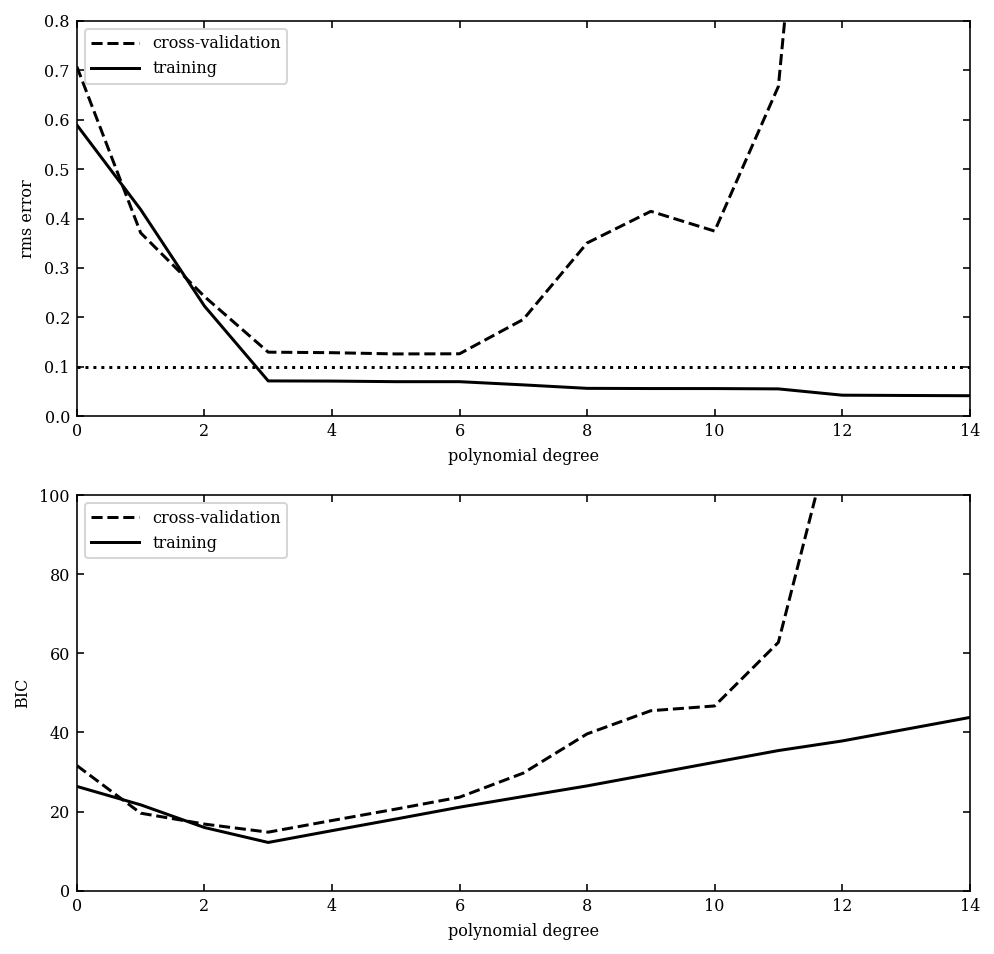

In [47]:
#------------------------------------------------------------
# Define our functional form
def func(x, dy=0.1):
    return np.random.normal(np.sin(x) * x, dy)

#------------------------------------------------------------
# select the (noisy) data
np.random.seed(0)
x = np.linspace(0, 3, 22)[1:-1]
dy = 0.1
y = func(x, dy)

#------------------------------------------------------------
# Select the cross-validation points
np.random.seed(1)
x_cv = 3 * np.random.random(20)
y_cv = func(x_cv)

x_fit = np.linspace(0, 3, 1000)

#------------------------------------------------------------
# Third figure: plot errors as a function of polynomial degree d
d = np.arange(0, 21)
training_err = np.zeros(d.shape)
crossval_err = np.zeros(d.shape)

fig = plt.figure(figsize=(8, 8))
for i in range(len(d)):
    p = np.polyfit(x, y, d[i])
    training_err[i] = np.sqrt(np.sum((np.polyval(p, x) - y) ** 2)
                              / len(y))
    crossval_err[i] = np.sqrt(np.sum((np.polyval(p, x_cv) - y_cv) ** 2)
                              / len(y_cv))

BIC_train = np.sqrt(len(y)) * training_err / dy + d * np.log(len(y))
BIC_crossval = np.sqrt(len(y)) * crossval_err / dy + d * np.log(len(y))

ax = fig.add_subplot(211)
ax.plot(d, crossval_err, '--k', label='cross-validation')
ax.plot(d, training_err, '-k', label='training')
ax.plot(d, 0.1 * np.ones(d.shape), ':k')

ax.set_xlim(0, 14)
ax.set_ylim(0, 0.8)

ax.set_xlabel('polynomial degree')
ax.set_ylabel('rms error')
ax.legend(loc=2)

ax = fig.add_subplot(212)
ax.plot(d, BIC_crossval, '--k', label='cross-validation')
ax.plot(d, BIC_train, '-k', label='training')

ax.set_xlim(0, 14)
ax.set_ylim(0, 100)

ax.legend(loc=2)
ax.set_xlabel('polynomial degree')
ax.set_ylabel('BIC')

plt.show()

- For low order, both the training and CV error are high. This is sign of a **high-bias model that is underfitting** the data.  
- For high order, the training error becomes small (by definition), but the CV error is large. This is the sign of a **high-variance model that is overfitting** the data. It is matching the subtle fluctuations in the training data that aren't really real, and this shows up in the CV analysis.
- The BICs give similar results.

Hopefully that helps you understand how to use cross validation to help you both **fit your model and decide on the optimal level of model complexity**, but maybe it doesn't help you apply it to your own data.  

We've already seen how to do this with **[GridSearchCV](https://scikit-learn.org/0.17/modules/generated/sklearn.grid_search.GridSearchCV.html#sklearn.grid_search.GridSearchCV)**, where for this case, we'd just be varying one parameter (even though `GridSearchCV` can vary many). That is, if the algorithm you're using support's the scikit-learn GridSearchCV infrastructure...

## Do we need more data? Learning Curves

Of course more data means a better fit... but a some point data are all the same!

We can use a tool called a **[learning curve](https://en.wikipedia.org/wiki/Learning_curve)** to determine if (for a given model) having more training data would help improve the model fitting. This is a different question than above-- rather than try to get a better model of the data, we're trying to improve the quality of our data set. 

The training and CV error are computed as a function of the number of training points. In general:
- ***The training error increases with $N_\mathrm{train}$.*** For a given model, it's easier to fit fewer data points.
- ***The CV error decreases wtih $N_\mathrm{train}$.*** For a given model, a greater number of training points reduces the chances of over-fitting, resulting in better performance of the model in the cross-validation stage.

Let's look at this for the same data and model as above.

/Users/dgerosa/box/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3398: RankWarning: Polyfit may be poorly conditioned
  exec(code_obj, self.user_global_ns, self.user_ns)
/Users/dgerosa/box/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3398: RankWarning: Polyfit may be poorly conditioned
  exec(code_obj, self.user_global_ns, self.user_ns)


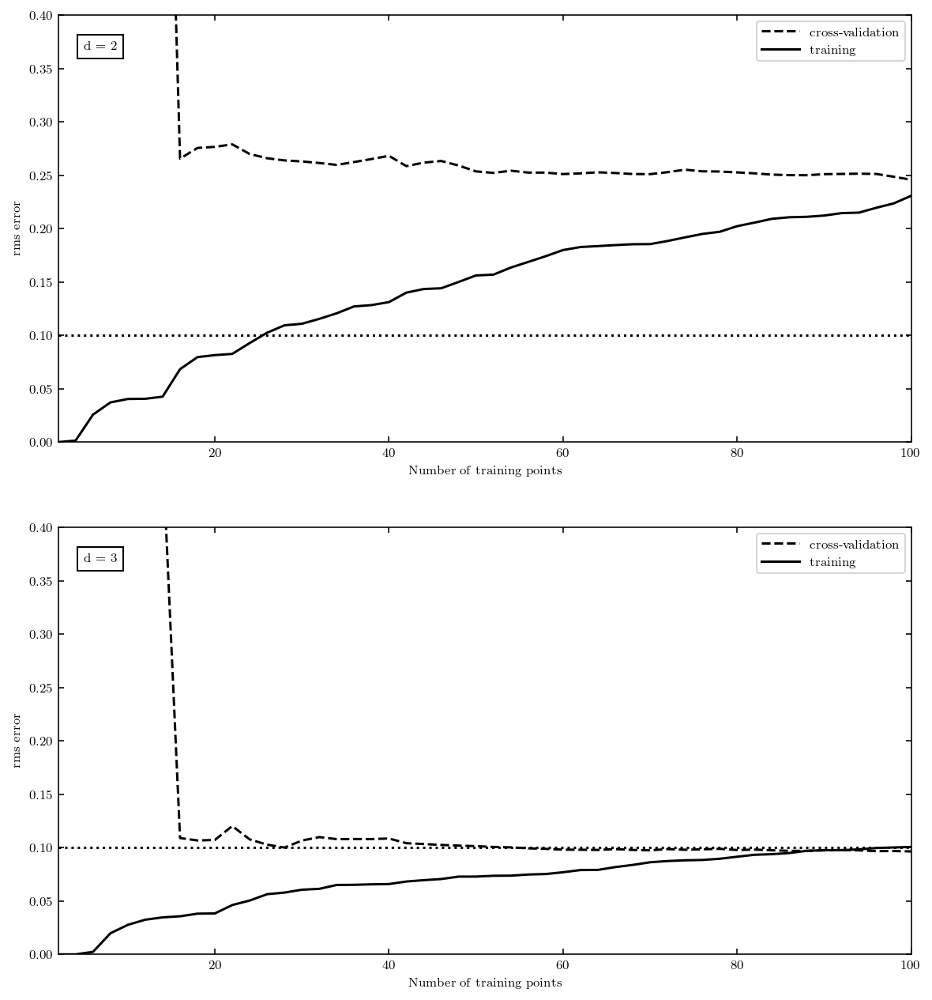

In [48]:
# Ivezic v2, Figure 8.15, panels made bigger by GTR and starting at 2 points.
# Author: Jake VanderPlas
# License: BSD
#   The figure produced by this code is published in the textbook
#   "Statistics, Data Mining, and Machine Learning in Astronomy" (2013)
#   For more information, see http://astroML.github.com
#   To report a bug or issue, use the following forum:
#    https://groups.google.com/forum/#!forum/astroml-general
#----------------------------------------------------------------------
# This function adjusts matplotlib settings for a uniform feel in the textbook.
# Note that with usetex=True, fonts are rendered with LaTeX.  This may
# result in an error if LaTeX is not installed on your system.  In that case,
# you can set usetex to False.
if "setup_text_plots" not in globals():
    from astroML.plotting import setup_text_plots
setup_text_plots(fontsize=8, usetex=True)

#------------------------------------------------------------
# Define our functional form
def func(x, dy=0.1):
    return np.random.normal(np.sin(x) * x, dy)

#------------------------------------------------------------
# select the (noisy) data
np.random.seed(0)
x = np.linspace(0, 3, 22)[1:-1]
dy = 0.1
y = func(x, dy)

#------------------------------------------------------------
# Select the cross-validation points
np.random.seed(1)
x_cv = 3 * np.random.random(20)
y_cv = func(x_cv)

x_fit = np.linspace(0, 3, 1000)

#------------------------------------------------------------
# Fourth figure: plot errors as a function of training set size
np.random.seed(0)
x = 3 * np.random.random(100)
y = func(x)

np.random.seed(1)
x_cv = 3 * np.random.random(100)
y_cv = func(x_cv)

Nrange = np.arange(2, 101, 2)

fig = plt.figure(figsize=(10, 10))
fig.subplots_adjust(left=0.15, top=0.95)

for subplot, d in zip([211, 212], [2, 3]):
    ax = fig.add_subplot(subplot)
    training_err = np.zeros(Nrange.shape)
    crossval_err = np.zeros(Nrange.shape)

    for j, N in enumerate(Nrange):
        p = np.polyfit(x[:N], y[:N], d)
        training_err[j] = np.sqrt(np.sum((np.polyval(p, x[:N])
                                          - y[:N]) ** 2) / len(y))
        crossval_err[j] = np.sqrt(np.sum((np.polyval(p, x_cv)
                                          - y_cv) ** 2) / len(y_cv))

    ax.plot(Nrange, crossval_err, '--k', label='cross-validation')
    ax.plot(Nrange, training_err, '-k', label='training')
    ax.plot(Nrange, 0.1 * np.ones(Nrange.shape), ':k')
    ax.legend(loc=1)
    ax.text(0.03, 0.94, "d = %i" % d, transform=ax.transAxes,
            ha='left', va='top', bbox=dict(ec='k', fc='w'))

    ax.set_ylim(0, 0.4)

    ax.set_xlabel('Number of training points')
    ax.set_ylabel('rms error')

plt.show()

We can see two regimes:

1. ***The training and CV errors have converged.*** This indicates that the model is dominated by bias. Increasing the number of training points is futile. If the error is too high, you instead need a more complex model, not more training data.
2. ***The training error is smaller than the CV error.*** This indicates that the model is dominated by variance.  Increasing the number of training points may help to improve the model.

In both cases, for small numbers of training points, the difference between the training and CV errors indicates that more data well help.  

For the top plot, the convergence of the training and CV errors indicates that adding further data will not reduce the error as it is dominated by ***bias***. A more sophisticated model is needed. The training error starts at zero because we are predicting the training data perfectly, but the CV error is high, indicating that the training data aren't sufficiently representative.

Again, hopefully that helps you understand what learning curves tell you, but maybe it doesn't help you apply it to your own data.  So, let's see how sklearn does it using [sklearn.model_selection.learning_curve](https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.learning_curve.html#sklearn.model_selection.learning_curve).  

Below we apply this to the [Boston Housing data](http://scikit-learn.org/stable/datasets/index.html#boston-house-prices-dataset). This data set contains 12 attributes that can be used to predict the price of houses in Boston. 

In [50]:
#Execute this cell to read in the data
#Also identify the index of the "Number of Rooms" attribute
from sklearn.datasets import load_boston
boston = load_boston()
print(boston.feature_names)

['CRIM' 'ZN' 'INDUS' 'CHAS' 'NOX' 'RM' 'AGE' 'DIS' 'RAD' 'TAX' 'PTRATIO'
 'B' 'LSTAT']


(0.0, 200.0)

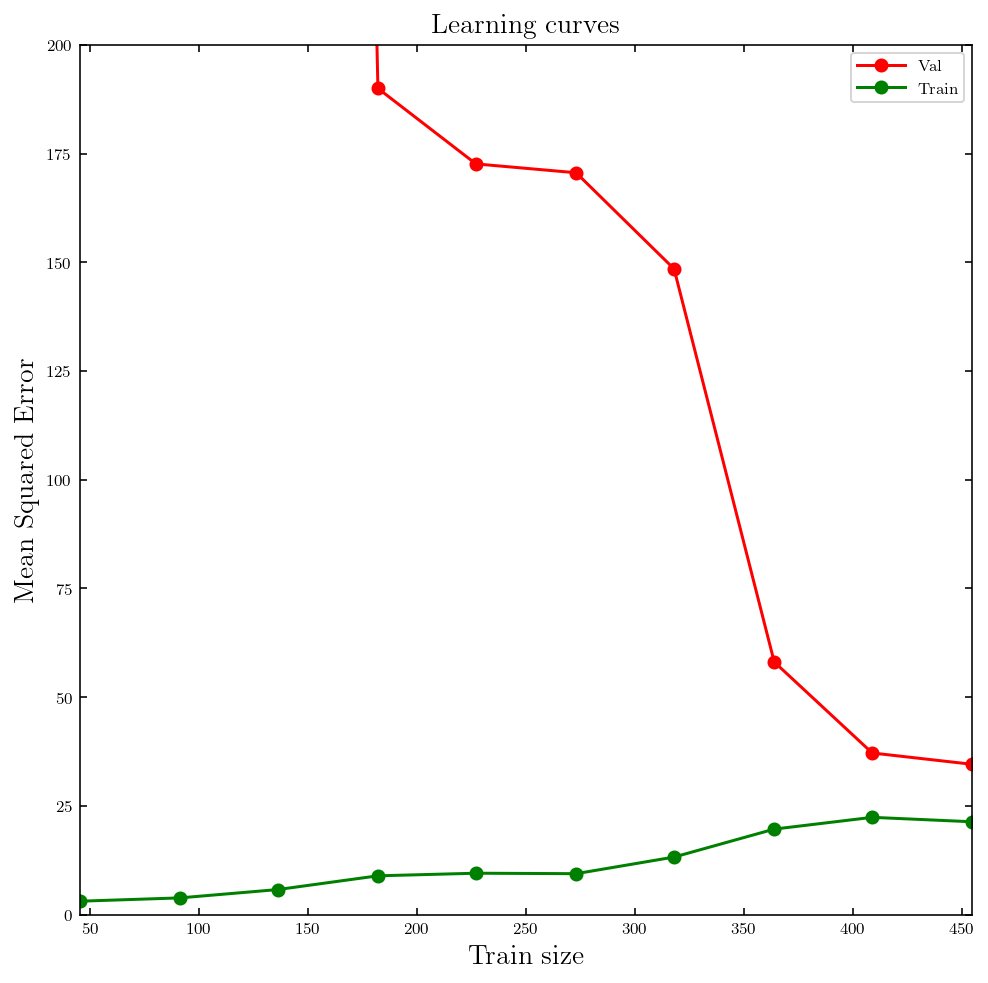

In [51]:
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import learning_curve

boston = load_boston()
X = boston.data
y = boston.target

scaler = StandardScaler()
Xscaled = scaler.fit_transform(X)

lin_reg = LinearRegression()
# Ten training sample sizes from 10% to 100%
train_sizes, train_scores_linreg, test_scores_linreg = \
    learning_curve(lin_reg, Xscaled, y, train_sizes=np.linspace(0.1, 1, 10), \
    scoring="neg_mean_squared_error", cv=10)

fig = plt.figure(figsize=(8, 8))

plt.plot(train_sizes, -test_scores_linreg.mean(1), 'o-', color="r", label="Val")
plt.plot(train_sizes, -train_scores_linreg.mean(1), 'o-', color="g", label="Train")
                   
plt.xlabel("Train size",fontsize=14)
plt.ylabel("Mean Squared Error",fontsize=14)
plt.title('Learning curves',fontsize=14)
plt.legend(loc="best")
plt.ylim(0,200)

#plt.show()

So, we barely have enough data.  This is important to know when we are deciding on the number of cross validations.  

Once you are happy with the size of your training set and your choice of model, and now just want to get the best model parameters using *all* of the data (not just whatever fraction is in your training set), then we can use **[cross_val_predict](https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.cross_val_predict.html)**.

"Each sample belongs to exactly one test set, and its prediction is computed with an estimator fitted on the corresponding training set."

Let's use this to predict the price of houses in Boston where each house gets to be part of one of the test sets by doing a $10$-fold cross validation. We will then plot the *prediction* versus the *actual* value of $y$, which should lie along the line $y=y_\mathrm{pred}$.

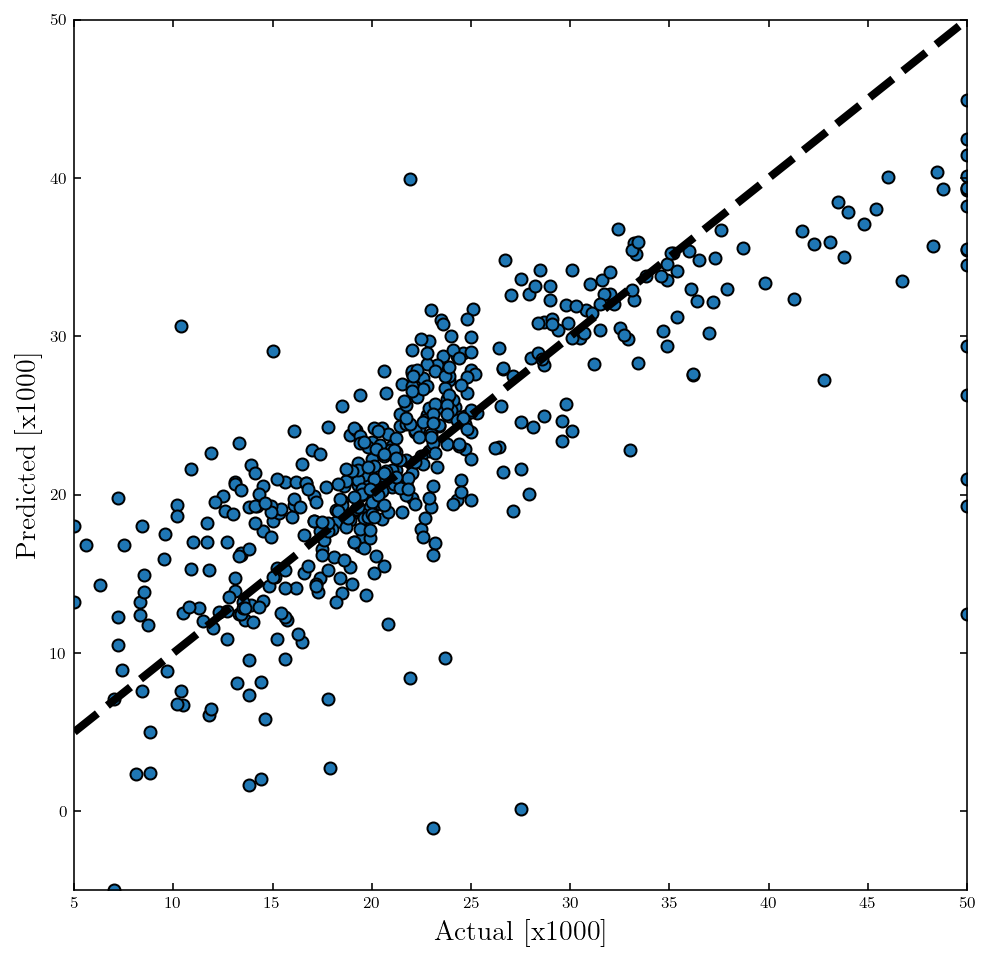

In [28]:
from sklearn.model_selection import cross_val_predict

scaler = StandardScaler()
Xscaled = scaler.fit_transform(X)
linreg = LinearRegression()
linreg.fit(Xscaled, y)

# Do a 10-fold cross validation
# Then try a 3-fold cross validation
# Can you understand the difference?
ypred = cross_val_predict(linreg, Xscaled, y, cv=10)

fig, ax = plt.subplots(figsize=(8,8))
ax.scatter(y, ypred, edgecolors=(0, 0, 0))
ax.plot([y.min(), y.max()], [y.min(), y.max()], 'k--', lw=4)
ax.set_xlabel('Actual [x1000]',fontsize=14)
ax.set_ylabel('Predicted [x1000]',fontsize=14)
plt.show()

## Regularization <a class="anchor" id="one"></a>

We have to be careful when performing regression because if we progressively increase the complexity of the model, then we reach a regime where we are overfitting the data (i.e. there are too many degrees of freedom in the model). This causes high variance in the model, resulting in poor performance in cross-validation and testing datasets.

Let's look at an example using `Polynomial Regression`. We'll fit some data with successively higher-degree polynomials.

In [1]:
# Execute this cell
import numpy as np
from matplotlib import pyplot as plt
%matplotlib inline
%config InlineBackend.figure_format='retina'

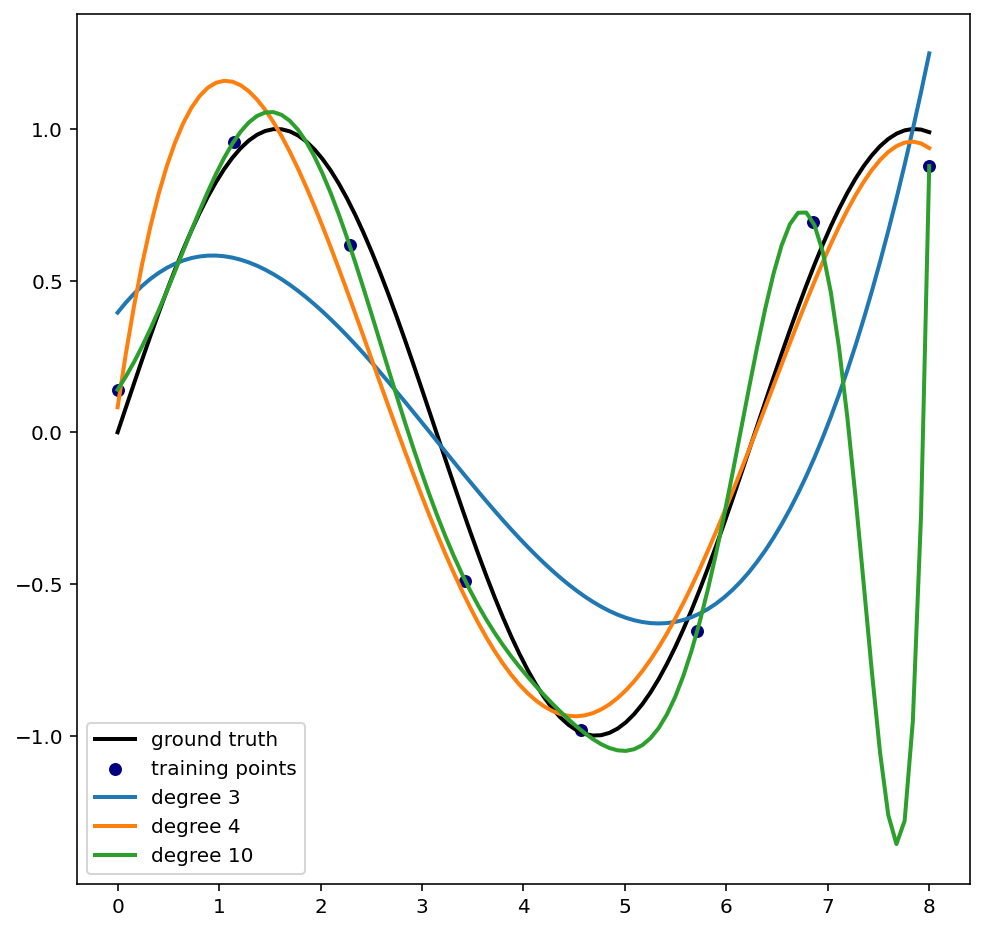

In [2]:
from astroML.linear_model import PolynomialRegression

degrees = [3,4,10]

def f(x):
    """ function to approximate by polynomial interpolation """
    return np.sin(x)

# generate points used to plot
x_plot = np.linspace(0, 8, 100)

# generate points and keep a subset of them
x = np.linspace(0, 8, 8)
y = f(x) + 0.5 * (np.random.random(len(x)) - 0.5)

# create matrix versions of these arrays
X = x[:, None]
X_plot = x_plot[:, None]

colors = ['C0', 'C1', 'C2']
lw = 2
plt.figure(figsize=(8,8))
plt.plot(x_plot, f(x_plot), 
         color='black', 
         linewidth=lw, label="ground truth")
plt.scatter(x, y, color='navy', s=30, 
            marker='o', label="training points")

for count, degree in enumerate(degrees):
    poly = PolynomialRegression(degree)
    poly.fit(X,y)
    y_plot = poly.predict(X_plot)

    plt.plot(x_plot, y_plot, color=colors[count], 
             linewidth=lw, label="degree %d" % degree)

plt.legend(loc='lower left')

plt.show()

What happens if you make the degree is equal to $\sim N_{\rm points}$ and higher?

In that case we are clearly overfitting the data. For me it was visible in the space between the penultimate and final data point, where the model had huge variance and would have performed terribly in cross-validation.

For cases where we are concerned with overfitting, instead of making our log-likelihood be related to just the sum of the squares: 

$$(Y - M\theta)^T C^{-1} (Y - M\theta),$$

we can apply additional constraints (usually of **smoothness**, **number of coefficients**, **size of coefficients**):

$$(Y - M \theta)^T C^{-1} (Y- M \theta) + \lambda\, \theta^T\theta,$$

with **$\lambda$ as the "regularization parameter"**. **NOTE--** *This corrects and clarifies some of the math notation in Ivezic 8.3.*

Upon maximizing the modified log-likelihood (or minimizing the modified relationship in the previous equation), this leads to a solution for the parameters of the model

$$\hat\theta = (M^T C^{-1} M + \lambda I)^{-1} (M^T C^{-1} Y)$$

with $I$ the identity matrix.

From the **Bayesian perspective** this is trivial. We have just applied a prior constraint on the parameters of our model that help control the posterior distribution of parameters. In this scenario, our prior is

$$p(\theta | I ) \propto \exp{\left(\frac{-\lambda\, \theta^T\theta}{2}\right)}$$

which, when multiplied by the data likelihood for regression, gives the same answer for the maximum of the posterior probability as described above.

***Reguarlization tries to get us into the Goldilocks regime where we have a [balanced solution](https://towardsdatascience.com/ridge-regression-for-better-usage-2f19b3a202db) to the regression between underfitting and overfitting***.
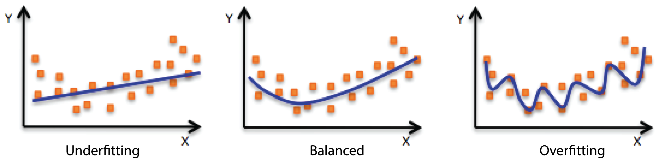

### Ridge regression 

Such a Gaussian prior on regression coefficients corresponds to **[Ridge Regression](https://en.wikipedia.org/wiki/Tikhonov_regularization)** (or ***Tikhonov Regularization***), which penalizes the regression coefficients according to

$$ \theta^T \theta \equiv \sum_i \theta_i^2 < s.$$

That is **the sum of the squares of the regression coefficients are restricted to be less than some tolerance value**, $s$. We'll come back to exactly what $s$ is in a minute. Doing this supresses large regression coefficients and limits the variance of the model---at the cost of increased bias (i.e. the solution may not pass as closely through all data points).

`Scikit-Learn`'s [`Ridge`](http://scikit-learn.org/stable/modules/generated/sklearn.linear_model.Ridge.html) is their implementation of ridge regression, while `AstroML` implements Ridge Regression as follows:

In [3]:
from sklearn.linear_model import Ridge

X = np.random.random((100,10))
y = np.dot(X, np.random.random(10))
model = Ridge(alpha=0.05) # alpha here is lambda in the book
model.fit(X,y)
y_pred = model.predict(X)

Let's use the supernova data from last time.

The following example compares *Gaussian Basis Regression* with and without the constraints from *Ridge Regression*. It uses **$100$ evenly spaced Gauassians, which we can see strongly overfits the problem and has very large coefficient values, until a constraint is imposed**.

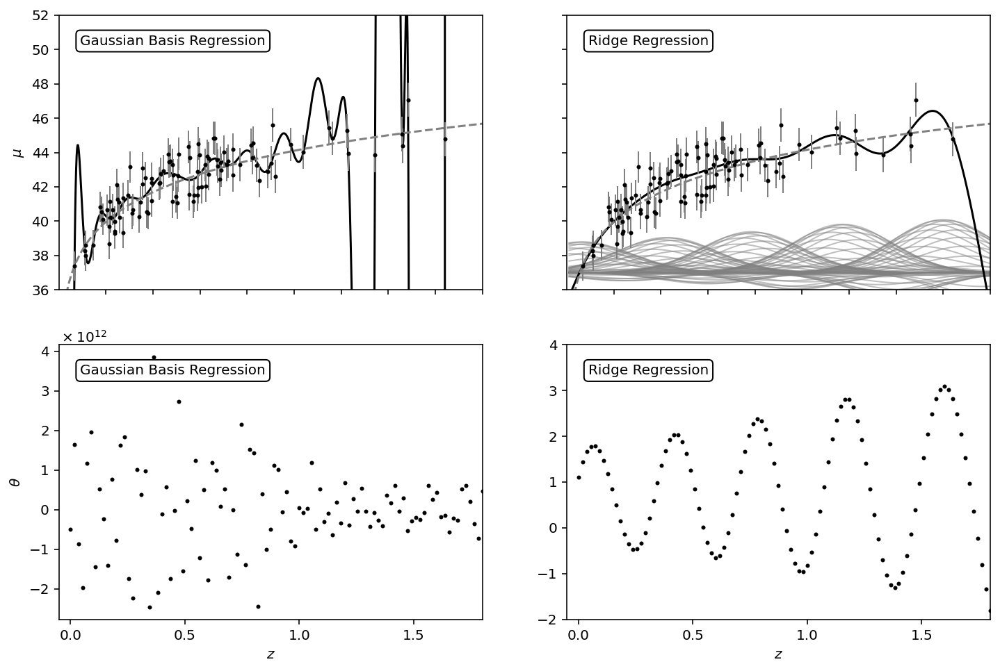

In [4]:
from scipy.stats import lognorm
from sklearn.linear_model import LinearRegression, Ridge
from astroML.datasets import generate_mu_z

#----------------------------------------------------------------------
# generate data
np.random.seed(0)
z_sample, mu_sample, dmu = generate_mu_z(100, random_state=0)

from astropy.cosmology import LambdaCDM
cosmo = LambdaCDM(H0=70, Om0=0.30, Ode0=0.70, Tcmb0=0)
z = np.linspace(0.01, 2, 1000)
mu = cosmo.distmod(z)

#------------------------------------------------------------
# Manually convert data to a gaussian basis
#  note that we're ignoring errors here, for the sake of example.
def gaussian_basis(x, mu, sigma):
    return np.exp(-0.5 * ((x - mu) / sigma) ** 2)

centers = np.linspace(0, 1.8, 100)
widths = 0.2
X = gaussian_basis(z_sample[:, None], 
                   centers, widths)

#------------------------------------------------------------
# Set up the figure to plot the results
fig = plt.figure(figsize=(12, 8))

classifier = [LinearRegression, Ridge]
kwargs = [dict(), dict(alpha=0.005)]
labels = ['Gaussian Basis Regression', 'Ridge Regression']

for i in range(2):
    clf = classifier[i](fit_intercept=True, **kwargs[i])
    clf.fit(X, mu_sample)
    w = clf.coef_
    fit = clf.predict(gaussian_basis(z[:, None], 
                                     centers, widths))

    # plot fit
    ax = fig.add_subplot(221 + i)
    ax.xaxis.set_major_formatter(plt.NullFormatter())

    # plot curves for regularized fits
    if i == 0:
        ax.set_ylabel('$\mu$')
    else:
        ax.yaxis.set_major_formatter(plt.NullFormatter())
        curves = 37 + w * gaussian_basis(z[:, np.newaxis], 
                                         centers, widths)
        curves = curves[:, abs(w) > 0.01]
        ax.plot(z, curves,
                c='gray', lw=1, alpha=0.5)

    ax.plot(z, fit, '-k')
    ax.plot(z, mu, '--', c='gray')
    ax.errorbar(z_sample, mu_sample, dmu, 
                fmt='.k', ecolor='gray', lw=1, ms=4)
    ax.set_xlim(0.001, 1.8)
    ax.set_ylim(36, 52)
    ax.text(0.05, 0.93, labels[i],
            ha='left', va='top',
            bbox=dict(boxstyle='round', 
                      ec='k', fc='w'),
            transform=ax.transAxes)

    # plot weights
    ax = plt.subplot(223 + i)
    ax.xaxis.set_major_locator(plt.MultipleLocator(0.5))
    ax.set_xlabel('$z$')
    if i == 0:
        ax.set_ylabel(r'$\theta$')
        w *= 1E-12
        ax.text(0, 1.01, r'$\rm \times 10^{12}$',
                transform=ax.transAxes)
    ax.scatter(centers, w, s=9, lw=0, c='k')

    ax.set_xlim(-0.05, 1.8)

    if i == 1:
        ax.set_ylim(-2, 4)
    elif i == 2:
        ax.set_ylim(-0.5, 2)

    ax.text(0.05, 0.93, labels[i],
            ha='left', va='top',
            bbox=dict(boxstyle='round', 
                      ec='k', fc='w'),
            transform=ax.transAxes)

plt.show()

### Least Absolute Shrinkage and Selection (LASSO) regularization

An alternative to Ridge Regression is **LASSO**, which implies the following contraint:

$$(Y - M \theta)^T(Y- M \theta) + \lambda \sum_i|\theta_i|.$$

This is equivalent to least-squares minimization with the restriction that

$$ \sum_i|\theta_i| < s,$$

that is, the **penalty is now on the sum of the absolute values of the regression coefficients**, which is also illustrated in Ivezic, Figure 8.3 as shown in the right panel above.

It not only weights the regression coefficients, it also **imposes sparsity on the regression
model** (i.e. the penalty preferentially selects regions of likelihood space that coincide with one of the vertices within the region defined by the regularization).

***This has the effect of setting one (or more) of the model attributes to zero.***  

`Scikit-Learn`'s **[`LASSO`](http://scikit-learn.org/stable/modules/generated/sklearn.linear_model.Lasso.html#sklearn.linear_model.Lasso)** is implemented as follows:

In [5]:
from sklearn.linear_model import Lasso

XX = np.random.random((100,10))
yy = np.dot(XX, np.random.random(10))
model = Lasso(alpha = 0.05)
model.fit(XX,yy)
y_pred = model.predict(XX)

Below I have copied the Ridge regression cell from above.

**N.B.  $\lambda$ in the book is related to $\alpha$ in these examples.**

/var/folders/zv/8t9z941x3q1gmp080mdw8k_h0000gn/T/ipykernel_17686/3072698926.py:44: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  clf.fit(X, mu_sample)
/Users/dgerosa/box/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/Users/dgerosa/box/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.598e+01, tolerance: 3.196e-02 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordin

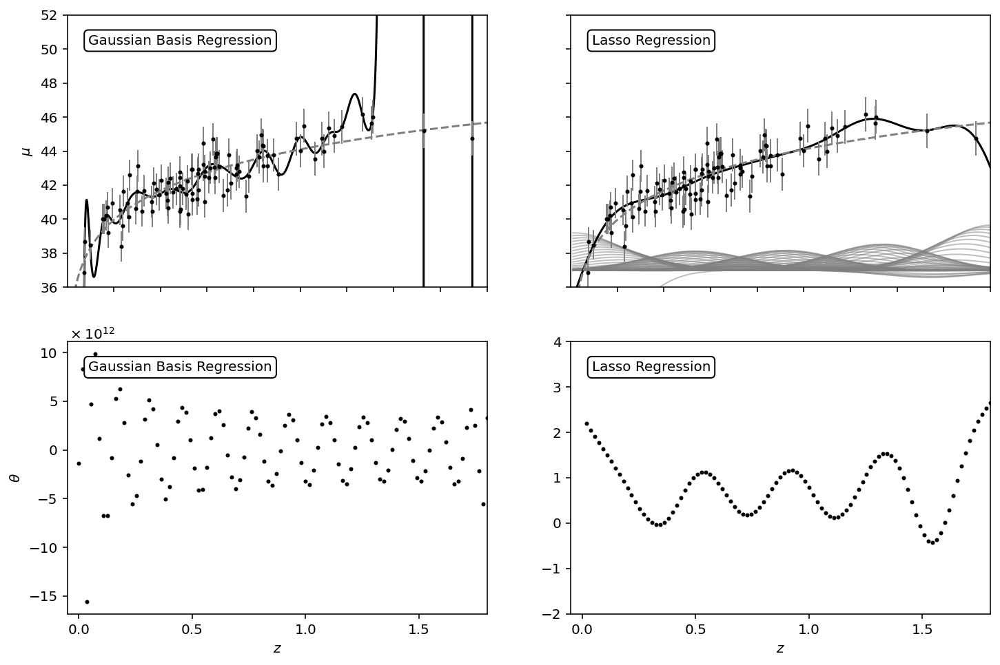

In [6]:
from scipy.stats import lognorm
from sklearn.linear_model import LinearRegression, Lasso #!!!!

#from astroML.cosmology import Cosmology
from astroML.datasets import generate_mu_z

#----------------------------------------------------------------------
# generate data
np.random.seed(0)
z_sample, mu_sample, dmu = generate_mu_z(100, random_state=1234)

from astropy.cosmology import LambdaCDM
cosmo = LambdaCDM(H0=70, Om0=0.30, Ode0=0.70, Tcmb0=0)
z = np.linspace(0.01, 2, 1000)
mu = cosmo.distmod(z)

#------------------------------------------------------------
# Manually convert data to a gaussian basis
#  note that we're ignoring errors here, for the sake of example.
def gaussian_basis(x, mu, sigma):
    return np.exp(-0.5 * ((x - mu) / sigma) ** 2)

centers = np.linspace(0, 1.8, 100)
widths = 0.2
X = gaussian_basis(z_sample[:, None], centers, widths)

#------------------------------------------------------------
# Set up the figure to plot the results
fig = plt.figure(figsize=(12, 8))

classifier = [LinearRegression, Lasso] #!!!!
kwargs = [dict(), dict(alpha=int(0))]
labels = ['Gaussian Basis Regression', 'Lasso Regression'] #!!!!

for i in range(2):
    clf = classifier[i](fit_intercept=True, **kwargs[i])
    clf.fit(X, mu_sample)
    w = clf.coef_
    fit = clf.predict(gaussian_basis(z[:, None], centers, widths))

    # plot fit
    ax = fig.add_subplot(221 + i)
    ax.xaxis.set_major_formatter(plt.NullFormatter())

    # plot curves for regularized fits
    if i == 0:
        ax.set_ylabel('$\mu$')
    else:
        ax.yaxis.set_major_formatter(plt.NullFormatter())
        curves = 37 + w * gaussian_basis(z[:, np.newaxis], centers, widths)
        curves = curves[:, abs(w) > 0.01]
        ax.plot(z, curves,
                c='gray', lw=1, alpha=0.5)

    ax.plot(z, fit, '-k')
    ax.plot(z, mu, '--', c='gray')
    ax.errorbar(z_sample, mu_sample, dmu, fmt='.k', ecolor='gray', lw=1, ms=4)
    ax.set_xlim(0.001, 1.8)
    ax.set_ylim(36, 52)
    ax.text(0.05, 0.93, labels[i],
            ha='left', va='top',
            bbox=dict(boxstyle='round', ec='k', fc='w'),
            transform=ax.transAxes)

    # plot weights
    ax = plt.subplot(223 + i)
    ax.xaxis.set_major_locator(plt.MultipleLocator(0.5))
    ax.set_xlabel('$z$')
    if i == 0:
        ax.set_ylabel(r'$\theta$')
        w *= 1E-12
        ax.text(0, 1.01, r'$\rm \times 10^{12}$',
                transform=ax.transAxes)
    ax.scatter(centers, w, s=9, lw=0, c='k')

    ax.set_xlim(-0.05, 1.8)

    if i == 1:
        ax.set_ylim(-2, 4)
    elif i == 2:
        ax.set_ylim(-0.5, 2)

    ax.text(0.05, 0.93, labels[i],
            ha='left', va='top',
            bbox=dict(boxstyle='round', ec='k', fc='w'),
            transform=ax.transAxes)

plt.show()

Among the many Gaussians we put in, the algorithm is selecting only a few. The cause of overfitting was precisely that we initialized too many Gaussians. The nice thing about regularization is that we don't have to manually decide which features are more or less important, this choice is made in a data-driven way.


It is much simpler than it seems. [Hastie et al.](http://statweb.stanford.edu/~tibs/ElemStatLearn/index.html) is helpful in clarifying all this. 

They write the constraint term as 

$$\lambda \sum_{i=1} |\theta_i|^q,$$

which allows us to see that **Ridge regression corresponds to $q=2$**, while **LASSO regression corresponds to $q=1$**.  So, they are really the same thing: Bayesian estimates with different priors. The wildly different names are just a nuisance. Hastie et al. shows what contours of the constant constraint term look like for different $q$.

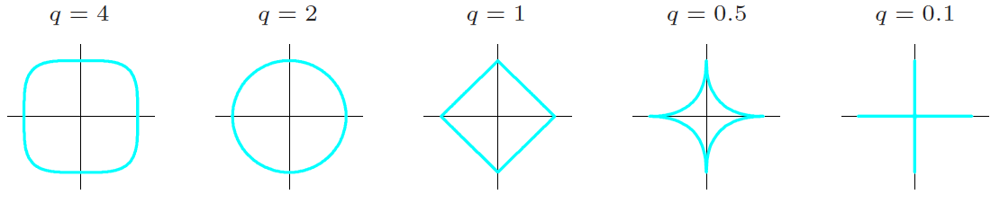

With that in mind, now let's see if we can understand what is going on in Ivezic, Figure 8.3.  We now have

$$ \lambda \sum_{i=1} |\theta_i|^q < s.$$

Think of $s$ as a normalized distance where $s=1$ corresponds to there being no constraint on $\theta_i$. Requiring $s<1$ limits the magnitude of $\theta_i$. So, in this figure
![Ivezic, Figure 8.3](http://www.astroml.org/_images/fig_lasso_ridge_1.png)
$s=1$ would make the circle/diamond big enough to include what they call $\theta_{\rm normal}$.   

Shrinking $s$ has the effect of adding a prior that moves the best-fit parameters to the intersection of the two sets of contours. **The difference between Ridge and LASSO is just the shape of the constraint region.** For LASSO, the shape is such that some of the parameters may end up being 0, which is super beneficial.

One drawback of LASSO is that it does not have a closed-form analytic regression like Ridge does-- the problem must be solved numerically.

#### Note (this once drove me crazy for a whole day!)

Setting $\lambda=0$ is mathemathicall identical to no regularizaion. But that's not necessarily true in the scikit-learn implementation: i.e. `Ridge` and `Lasso` with `alpha=0` might not give the same result of `LinearRegression`. The regularization algorithms have additional sophistications to improve convergence. I was not able to fully understand this (let me know if you do!) even after many hours of googling.

### Loss functions recap

The code below doesn't explicitly define a loss function — but it does use one implicitly, inside the regression models from scikit-learn (when we call .fit())

For LinearRegression it minimizes the ***ordinary least squares (OLS)*** loss:

$$
    \mathcal{L}=\sum_{i=1}^N (y_i-\hat{y}_i)^2
$$

This is equivalent to maximum likelihood under a Gaussian error model, but the likelihood is never explicitly stated — scikit-learn just solves it numerically.

It is assumed that:
- All data points have equal and independent variance (i.e., the errors are homoscedastic), and therefore the error is irrelevant in minimization (just a multiplicative factor)
- There is no measurement uncertainty in the input features X.

When errors are known and different for each data they are called heterpscedastic and we must use ***weighted least squares (WLS)*** or ***Gaussian likelihood***
$$
    \mathcal{L}=\sum_{i=1}^N \left(\frac{y_i-\hat{y}_i}{\sigma_i}\right)^2
$$

For Ridge it is minimized the ***regularized least squares (Rigde loss)***:
$$
    \mathcal{L}=\sum_{i=1}^N (y_i-\hat{y}_i)^2 + \alpha\sum_j\theta_j^2
$$
$\alpha$ controls the L2 regularization which penalizes large coefficients.

For ***Lasso (least absolute shrinkage and selection operator)*** or L1 regularization it is minimized the quantity:
$$
    \mathcal{L}=\sum_{i=1}^N (y_i-\hat{y}_i)^2 + \alpha\sum_j|\theta_j|
$$


### Elastic Net and deep learning

Regularization is **vital** in deep learning. Deep learning models have $10^{\rm many}$ parameters and can very easily lead to overfitting.

One of the latest developing in deep learning is the so-called Elastic Net strategy which, simply put, combines Ridge and Lasso regularization. Elastic Net was first proposed in by [Zou and Hastie (2005)](https://rss.onlinelibrary.wiley.com/doi/10.1111/j.1467-9868.2005.00503.x). For a recent application to LSST forecasted data see [Weaverdyck and Huterer (2020)](https://arxiv.org/abs/2007.14499).





### How do we choose $\lambda$?

We use cross-validation, just as we discussed last time. In fact...`Scikit-Learn` has versions of Ridge and LASSO regression that do this automatically for you-- see [`RidgeCV`](https://scikit-learn.org/stable/modules/linear_model.html#setting-the-regularization-parameter-leave-one-out-cross-validation) and [`LassoCV`](https://scikit-learn.org/stable/modules/linear_model.html#using-cross-validation).

---

Let's practice all this using the [Boston Housing data](https://scikit-learn.org/stable/datasets/toy_dataset.html#boston-dataset).  

As a reminder, this data set contains 12 attributes that can be used to predict the price of houses in Boston.  Because the attributes (columns of $X$) are inhomogenous, some may be more relevant than others. So LASSO might be a good thing to try in such situations.


In [5]:
#Execute this cell to read in the data
#Also identify the index of the "Number of Rooms" attribute
import numpy as np
from sklearn.datasets import fetch_california_housing
housing = fetch_california_housing()
housing.feature_names

['MedInc',
 'HouseAge',
 'AveRooms',
 'AveBedrms',
 'Population',
 'AveOccup',
 'Latitude',
 'Longitude']

Start by looking at just how the number of rooms predicts the price.
The target is the median value of the houses in the area, in units of hundreds of thousands of dollars ($100,000)

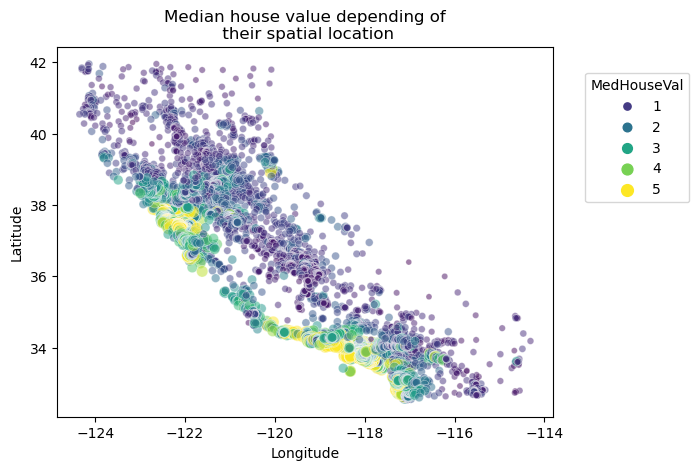

In [7]:
import matplotlib.pyplot as plt
import seaborn as sns

california_housing = fetch_california_housing(as_frame=True)
sns.scatterplot(
    data=california_housing.frame,
    x="Longitude",
    y="Latitude",
    size="MedHouseVal",
    hue="MedHouseVal",
    palette="viridis",
    alpha=0.5,
)
plt.legend(title="MedHouseVal", bbox_to_anchor=(1.05, 0.95), loc="upper left")
_ = plt.title("Median house value depending of\n their spatial location")



(which if you're a tiny bint familiar with California makes perfect sense. The two yellow region are the Bay Area in the north and Los Angeles in the South. I suspect the yellow dot is Lake Tahoe.)

Start by looking at just how the local median income predicts the value of a house.


In [8]:
RMindex = np.squeeze(np.argwhere(np.array(housing.feature_names)=="MedInc"))
print(RMindex)

X_RM = housing.data[:,RMindex][:,None]
y = housing.target

from sklearn.linear_model import LinearRegression
reg = LinearRegression().fit(X_RM, y)
print(reg.coef_, reg.intercept_)



0
[0.41793849] 0.45085576703267916


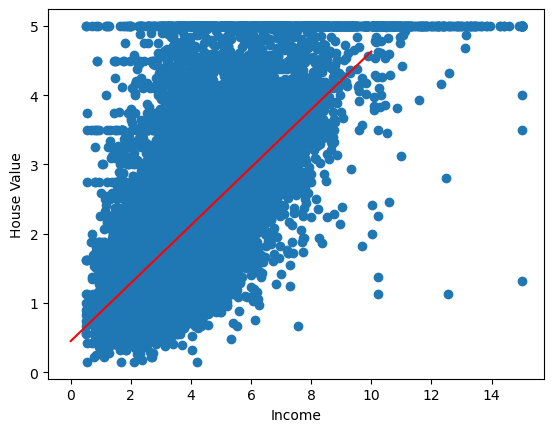

In [9]:
import matplotlib.pyplot as plt
plt.scatter(X_RM,y)
plt.xlabel("Income")
plt.ylabel("House Value")

Xgrid = np.linspace(0,10,9)
ypred = reg.intercept_ + Xgrid*reg.coef_[0]
plt.plot(Xgrid,ypred, c='r')
#plt.xlim(3.5,9)
#plt.ylim(0,5)
plt.show()



- Now use all attributes, first with LinearRegression.
- Then with LinearRegression again, but with the data scaled using StandardScaler from sklearn.preprocessing (since the features are very heterogeneous, i.e. they vary over different ranges and scales).
- Then fit the scaled data agin with LASSO to see which features aren't that important. Experiment with the
value.
- We'll plot the coefficients of each.

In [10]:
from sklearn.linear_model import Lasso
from sklearn.preprocessing import StandardScaler

X = housing.data
y = housing.target

scaler = StandardScaler()
Xscaled = scaler.fit_transform(X)

linreg = LinearRegression().fit(X,y)
linreg_scaled = LinearRegression().fit(Xscaled,y)
lasso_scaled = Lasso(alpha=0.1).fit(Xscaled,y)

print("Just linear regression\n", linreg.coef_, linreg.intercept_)
print("\nScaled\n", linreg_scaled.coef_, linreg_scaled.intercept_)
print("\nRegularized\n", lasso_scaled.coef_, lasso_scaled.intercept_)

Just linear regression
 [ 4.36693293e-01  9.43577803e-03 -1.07322041e-01  6.45065694e-01
 -3.97638942e-06 -3.78654265e-03 -4.21314378e-01 -4.34513755e-01] -36.94192020718437

Scaled
 [ 0.8296193   0.11875165 -0.26552688  0.30569623 -0.004503   -0.03932627
 -0.89988565 -0.870541  ] 2.0685581690891386

Regularized
 [ 0.70571337  0.10601099 -0.         -0.         -0.         -0.
 -0.01121267 -0.        ] 2.068558169089147


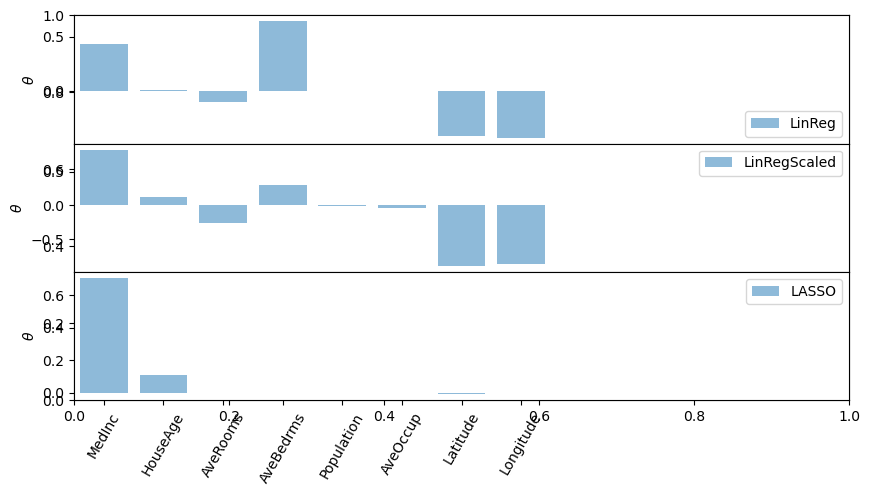

In [13]:
fig, ax = plt.subplots(figsize=(10, 5)) 
plt.subplots_adjust(hspace=0.001)

x_pos = np.arange(len(housing.feature_names))

for i in range(3):
    # plot theta
    ax = plt.subplot(311 + i)
    ax.set_ylabel(r'$\theta$')

    ax.set_xticks(x_pos)
    if i == 2:
        ax.set_xticklabels(housing.feature_names, 
                           rotation=60)     
    else: 
        ax.set_xticklabels([])
    
    ax.set_xlim(-0.5, 12.5)
 
    if i == 0:
        ax.bar(x_pos, linreg.coef_, 
               alpha=0.5, label="LinReg")
        plt.legend(loc=4)
        
    elif i == 1:
        ax.bar(x_pos, linreg_scaled.coef_, 
               alpha=0.5, label="LinRegScaled")
        plt.legend(loc=1)
        
    elif i == 2:
        ax.bar(x_pos, lasso_scaled.coef_, 
               alpha=0.5, label="LASSO")
        plt.legend();



Note that AveBedrms had a large coefficient but isn't particularly relevant. So, should probably scale the data first.

Which attribute coefficients are driven toward zero the most, and thus which attributes don't matter in determining the housing prices?

Let's try LassoCV below:


In [12]:


from sklearn.linear_model import LassoCV

lasso_scaled_cv = LassoCV(cv=5).fit(Xscaled,y)

print(lasso_scaled_cv.coef_, lasso_scaled_cv.intercept_)
print(lasso_scaled_cv.alpha_)



[ 0.81616436  0.1211406  -0.23007984  0.27029251 -0.0009902  -0.0369377
 -0.8718173  -0.84084069] 2.068558169089139
0.0025999572889688007


For a quick summary of regularization tecniques, [this blog post](https://towardsdatascience.com/what-is-regularization-and-how-do-i-use-it-f7008b5a68c6) is great.

---

Up to now we have been fitting using ***linear models***, i.e. where the model depends linearly on the regression coefficients. Before moving on to ***non-linear models***, we'll look at **local linear fitting**. Kernel Regression (or Nadaraya-Watson) was one such method.  

### Locally Linear Regression (LOWESS or LOESS)

In **[Local Linear Regression](https://en.wikipedia.org/wiki/Local_regression)** we assume that the regression function at any point can be approximated by a [Taylor series expansion](https://www.mathsisfun.com/algebra/taylor-series.html). If we truncated at the first term (i.e., a locally constant solution) we recover Kernel Regression.

LLR is similar to Kernel regression, except that we fit the local regression to the weighted points by finding a weighting function $w(x)$ that minimizes

$$\sum_{i=1}^N  K\left(\frac{||x-x_i||}{h}\right) \left( y_i - w(x) \, x_i \right)^2.$$

One version of this called **LOWESS (locally weighted scatter plot smoothing)** uses the "tricubic" Kernel:

$$K(x_i,x) = \left ( 1 - \left ( \frac{|x - x_i |}h{}\right )^3 \right )^3.$$

However, the book doesn't delve into this (or LOESS, which might stand for LOcal regrESSion) and it doesn't appear that this is implemented in either `AstroML` or `Scikit-Learn`. However, after scouting around, it does appear to be implemented in an unofficial Scikit-Learn extension called [`Scikit-Lego`](https://scikit-lego.readthedocs.io/en/latest/index.html)-- see https://scikit-lego.readthedocs.io/en/latest/linear-models.html#LOWESS. But we're not going to explore this here; we'll be moving on--just realize that there algorithms that are intermediate between linear and nonlinear.

## Non-linear Regression <a class="anchor" id="two"></a>

Often we can make our non-linear data linear (e.g., if your $y$ values increase exponentially with $x$, by taking the log), but that has its own set of complications (e.g., asymmetric error bars). So we should also consider **non-linear regression, i.e., where the model depends non-linearly on the regression parameters.** 

If we know the theoretical form of the model, then one option is to use MCMC techniques to sample the parameter space and find the optimal model parameters. We've seen that technique in detail, and you know most of the tricks to do this well.

An alternate approach is to use the **Levenberg-Marquardt (LM) algorithm** to optimize the maximum likelihood estimation. **[Numerical Recipes](http://numerical.recipes/)** is an excellent resource for more information about LM. I can't really emphasize enough how ubiquitous LM is, so you really should have a look at how it works.

For now let's leave it as these few words of explanation (with links for further study).
> *LM searches through a combination of [gradient descent](https://en.wikipedia.org/wiki/Gradient_descent) and [Gauss-Newton](https://en.wikipedia.org/wiki/Gauss%E2%80%93Newton_algorithm) optimization.* 

If we can **express our regression function as a Taylor series expansion** then, to first order, we can write

$$f(x_i|\theta) = f(x_i|\theta_0) + J d\theta.$$

Here $\theta_0$ is an initial guess for the regression parameters, $J$ is the Jacobian about this point ( $J=\partial f(x_i|\theta)/ \partial\theta$ ), and $d\theta$ is a perturbation in the regression parameters. 

LM minimizes the sum-of-square errors,

$$\sum_i [y_i- f(x_i|\theta_0) - J_i d\theta]^2,$$

for a perturbation $d\theta$. This minimization results in an iterative update relation for
$d\theta$ given by

$$(J^TC^{-1}J + \lambda\ {\rm diag}(J^TC^{-1}J) )\,d\theta = J^TC^{-1}(Y-f(X|\theta)),$$

where **$\lambda$ term acts as a damping parameter**. 
- If $\lambda$ is small, then the relation approximates a Gauss-Newton method (i.e., it minimizes the parameters assuming the function is quadratic). 
- If $\lambda$ is large the perturbation $d\theta$ follows the direction of steepest descent. 
- The diag$(J^TC^{-1}J)$ term is what makes it different from Ridge Regression and it ensures that the update of $d\theta$ is largest along directions where the gradient is smallest (which improves convergence).

This is an iterative process which ceases when the change in likelihood values reaches a predetermined limit. Don't worry if "gradient descent" doesn't ring any bells. We are going to talk about it again when we get to artificial neural networks.

In SciPy, both **[`scipy.optimize.leastsq`](https://docs.scipy.org/doc/scipy/reference/generated/scipy.optimize.leastsq.html)**  and **[`scipy.optimize_curve_fit`](https://docs.scipy.org/doc/scipy/reference/generated/scipy.optimize.curve_fit.html)** implement the LM algorithm. You've probably used LM a lot already without noticing it!


Here is an example call to estimate the first 6 terms of the Taylor series for $y=\sin x$.

In [13]:
from scipy import optimize

x = np.linspace(-3,3,100) # 100 values between -3 and 3

def taylor_err(a, x, f):
    p = np.arange(len(a))[:, None]
    return f(x) - np.dot(a, x**p)

a_start = np.zeros(6) # starting guess
a_best, flat = optimize.leastsq(taylor_err, a_start, 
                                args=(x, np.sin))

In [14]:
print(a_best) #Print coefficients of the Taylor series exapansion.  Do they make sense?

[-3.38596922e-17  9.90094836e-01  1.78283650e-16 -1.56677082e-01
 -3.46846563e-17  5.80542809e-03]


## Gaussian Process Regression (GPR) <a class="anchor" id="three"></a>

A powerful class of regression algorithms is **Gaussian Process Regression**; despite its name, GPR is widely applicable to data that are not generated by a Gaussian process, and can give very general and flexible models that are more data-driven than other techniques. It's become quite a hot topic in astrostatistics, and I use GPR a ton. Not only is it **an excellent data-driven interpolation technique, but it also gives you a measure of the interpolation uncertainty.** 



### Example from my own research in gravitational-waves.
We have applied GPR very succesfully to interpolate banks of stellar-physics simulations, which are then used as priors in a Bayesian data analysis. See [Taylor and Gerosa (2018)](https://ui.adsabs.harvard.edu/abs/2018PhRvD..98h3017T/abstract), [Wong and Gerosa (2019)](https://ui.adsabs.harvard.edu/abs/2019PhRvD.100h3015W/abstract).

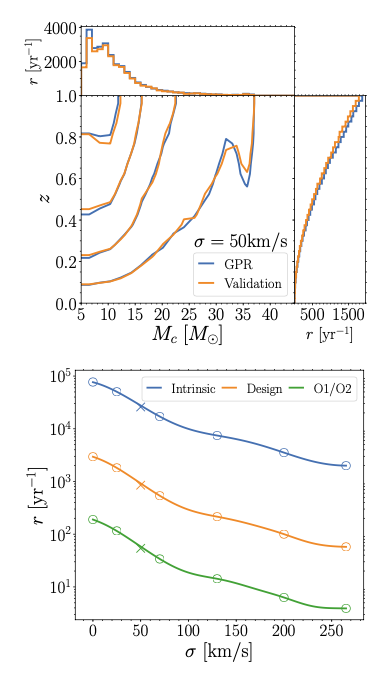

Here we fit the distributon of chirp mass $M_c$, redshift $z$ and detection rate $r$ of the black holes resulting from binary stellar evolution as a function of the linear momentum emitted during the supernova explosion $\sigma$. 


The big text for GPR is **[Rasmussen and Williams "Gaussian Processes for Machine Learning" (2005)](http://www.gaussianprocess.org/gpml/)**. 

What are Gaussian processes? 

> *A **[Gaussian Process](https://en.wikipedia.org/wiki/Gaussian_process) (GP)** is a collection of random variables in a parameter space for which any subset can be defined by a joint Gaussian distribution.*


Here is the code that produces Figure 8.10 in the Ivezic textbook. 

best-fit theta = 0.506933422889603


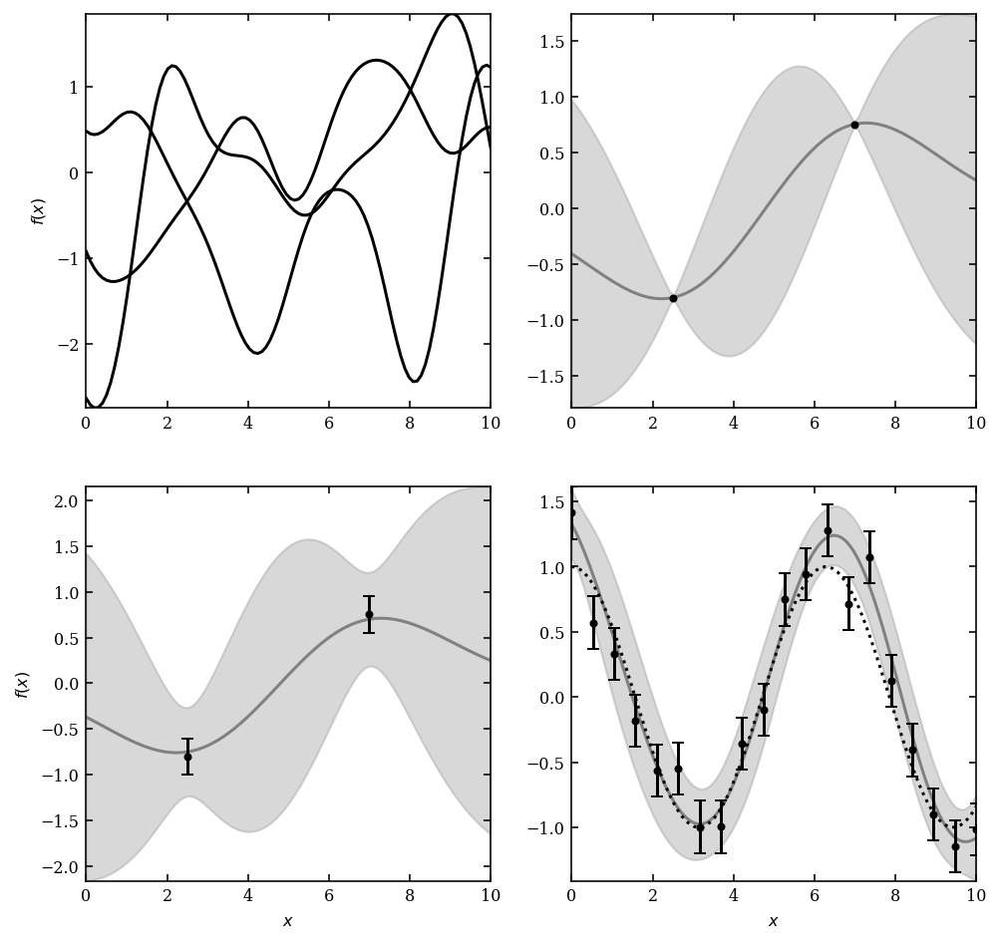

In [15]:
# Ivezic v2, Figure 8.10
# Author: Jake VanderPlas
# License: BSD
#   The figure produced by this code is published in the textbook
#   "Statistics, Data Mining, and Machine Learning in Astronomy" (2013)
#   For more information, see http://astroML.github.com
#   To report a bug or issue, use the following forum:
#    https://groups.google.com/forum/#!forum/astroml-general
from sklearn.gaussian_process import GaussianProcessRegressor, kernels
from scipy.optimize import fmin_cobyla

#----------------------------------------------------------------------
# This function adjusts matplotlib settings for a uniform feel in the textbook.
# Note that with usetex=True, fonts are rendered with LaTeX.  This may
# result in an error if LaTeX is not installed on your system.  In that case,
# you can set usetex to False.
if "setup_text_plots" not in globals():
    from astroML.plotting import setup_text_plots
setup_text_plots(fontsize=8, usetex=False)


#------------------------------------------------------------
# define a squared exponential covariance function
def squared_exponential(x1, x2, h):
    return np.exp(-0.5 * (x1 - x2) ** 2 / h ** 2)

#------------------------------------------------------------
# draw samples from the unconstrained covariance
np.random.seed(1)
x = np.linspace(0, 10, 100) #This sets the number of Gaussians
h = 1.0  #This is the Bandwidth

mu = np.zeros(len(x))
C = squared_exponential(x, x[:, None], h)
draws = np.random.multivariate_normal(mu, C, 3)

#------------------------------------------------------------
# Constrain the mean and covariance with two points
x1 = np.array([2.5, 7])
y1 = np.cos(x1)
kernel1 = kernels.RBF(1/0.5, (1/0.5, 1/0.5))
gp1 = GaussianProcessRegressor(kernel=kernel1, 
                               random_state=0, normalize_y=True,optimizer=None)
gp1.fit(x1[:, None], y1)
f1, f1_err = gp1.predict(x[:, None], 
                         return_std=True)

#------------------------------------------------------------
# Constrain the mean and covariance with two noisy points
#  scikit-learn gaussian process uses nomenclature from the geophysics
#  community, where a "nugget (alpha parameter)" can be specified.
#  The diagonal of the assumed covariance matrix is multiplied by the nugget.
#  This is how the error on inputs is incorporated into the calculation.
dy2 = 0.2
kernel2 = kernels.RBF(1/0.5, (1/0.5, 1/0.5))
gp2 = GaussianProcessRegressor(kernel=kernel2,
                               alpha=(dy2 / y1) ** 2, 
                               random_state=0,optimizer=None)
gp2.fit(x1[:, None], y1)
f2, f2_err = gp2.predict(x[:, None], 
                         return_std=True)


#------------------------------------------------------------
# Constrain the mean and covariance with many noisy points
x3 = np.linspace(0, 10, 20)
y3 = np.cos(x3)
dy3 = 0.2
y3 = np.random.normal(y3, dy3)

kernel3 = kernels.RBF(0.5, (0.01, 10.0))
gp3 = GaussianProcessRegressor(kernel=kernel3,
                               alpha=(dy3 / y3) ** 2, 
                               random_state=0)
gp3.fit(x3[:, None], y3)
f3, f3_err = gp3.predict(x[:, None], 
                         return_std=True)

# we have fit for the `h` parameter: print the result here:
print("best-fit theta =", gp3.kernel_.theta[0])


#------------------------------------------------------------
# Plot the diagrams
fig = plt.figure(figsize=(8, 8))


# first: plot a selection of unconstrained functions
ax = fig.add_subplot(221)
ax.plot(x, draws.T, '-k')
ax.set_ylabel('$f(x)$')

# second: plot a constrained function
ax = fig.add_subplot(222)
ax.plot(x, f1, '-', color='gray')
ax.fill_between(x, f1 - 2 * f1_err, f1 + 2 * f1_err, 
                color='gray', alpha=0.3)
ax.plot(x1, y1, '.k', ms=6)


# third: plot a constrained function with errors
ax = fig.add_subplot(223)
ax.plot(x, f2, '-', color='gray')
ax.fill_between(x, f2 - 2 * f2_err, f2 + 2 * f2_err, 
                color='gray', alpha=0.3)
ax.errorbar(x1, y1, dy2, fmt='.k', ms=6)

ax.set_xlabel('$x$')
ax.set_ylabel('$f(x)$')

# third: plot a more constrained function with errors
ax = fig.add_subplot(224)
ax.plot(x, f3, '-', color='gray')
ax.fill_between(x, f3 - 2 * f3_err, f3 + 2 * f3_err, 
                color='gray', alpha=0.3)
ax.errorbar(x3, y3, dy3, fmt='.k', ms=6)

ax.plot(x, np.cos(x), ':k')

ax.set_xlabel('$x$')

for ax in fig.axes:
    ax.set_xlim(0, 10)

plt.show()

In the **top-left panel**, we have drawn some random distributions from a Gaussian Basis. Specifically, we set a covariance given by 

$${\rm Cov}(x_1, x_2; h) = \exp\left(\frac{-(x_1 - x_2)^2}{2 h^2}\right).$$

(where $h$) is a bandwidth and draw three of the infinitely many resulting functions.

For a given bandwidth we can obviously define an infinite set of such functions. ***NOTE: This is only one of many different types of covariance function we could assume to interpolate the data.*** A variety of others are shown [here](https://www.cs.toronto.edu/~duvenaud/cookbook/). 



See what happens if you make the number of Gaussians much smaller or much bigger, or if you change the bandwidth.

Then in the **top-right panel**, we constrain these functions by selecting those that pass though a given set of points using the posterior:

$$p(f_j | \{x_i, y_i, \sigma_i\}, x_j^\ast).$$

The **bottom panels** show the result for the same points with error bars (*bottom left*) and 20 noisy points drawn from $y=\cos(x)$ (*bottom right*). You can perhaps see how this might be useful-- flexible, data-driven interpolation with a measure of interpolation uncertainty!

For GP regression we want to estimate the value and variance of a new set of points given an input data set. **This is equivalent to averaging over all functions that pass through our input data**.

We compute the covariance matrix of all observed data and the new set of points that we want to predict:

$$  K = \begin{pmatrix}
    K_{11} & K_{12} \\
    K_{12}^T & K_{22}
  \end{pmatrix},
$$

where 
- $K_{11}$ is the covariance between the input points $x_i$ with observational errors $\sigma_i^2$ added in quadrature to the diagonal, 
- $K_{12}$ is the cross-covariance between the input points $x_i$ and the unknown points $x^\ast_j$,
- $K_{22}$ is the covariance between the unknown points $x_j^\ast$.  

For observed vectors $\vec{x}$ and $\vec{y}$, and a vector of unknown points $\vec{x}^\ast$, it can be shown that the posterior is given by (see the Rasmussen & Williams text above)

$$  p(f_j | \{x_i, y_i, \sigma_i\}, x_j^\ast) = \mathcal{N}(\vec{\mu}, \Sigma) $$

where

$$
\begin{eqnarray}
  \vec{\mu} &=& K_{12} K_{11}^{-1} \vec{y}, \\
  \Sigma &=& K_{22} - K_{12}^TK_{11}^{-1}K_{12}
\end{eqnarray}
$$

$\mu_j$ gives the expected value $\bar{f}^\ast_j$ of the predicted result, and $\Sigma_{jk}$ gives the error covariance between any two unknown points (which measures the prediction uncertainty).

**This is key: it gives the mean AND uncertainty of a predicted point.**

Note that the physics of the underlying process enters through the assumed form of the covariance function, which has a variety of choices-- again see the [Kernel Cookbook](https://www.cs.toronto.edu/~duvenaud/cookbook/). 

The Scikit-Learn [`GaussianProcess`](https://scikit-learn.org/stable/modules/generated/sklearn.gaussian_process.GaussianProcessRegressor.html#sklearn.gaussian_process.GaussianProcessRegressor) implementation looks like:

In [42]:
from sklearn.gaussian_process import GaussianProcessRegressor

X = np.random.random((100,2))
y = np.sin(10*X[:,0] + X[:,1])
gp = GaussianProcessRegressor()
gp.fit(X,y)
y_pred, dy_pred = gp.predict(X, return_std=True)
#print(y_pred, dy_pred)

Below we'll see what GPR does for the supernova example that we used last time. What is great is that not only do you get a fit, you get errors and can tell where the fit is good and where it is poor. Clearly, as expected, the prediction gets successively poor as we move beyond the range of the training data.

## Uncertainties All Round <a class="anchor" id="four"></a>

What about real-world applications, where the **independent variable, $x$, (usually) is not free from any uncertainty**? Imagine the "true" relation,

$$ y^*_i=\theta_0 + \theta_1x^*_{i}. $$

Now we make measurements in $x$, and $y$ which are noisy (Gaussian noise)

$$
x_i = x^*_i + \delta_i,\\
y_i = y^* + \epsilon_i,
$$

Solving for $y$ we get
$$
      \hat{y}_i=  \theta_0 + \theta_1 (x_i - \delta_i) +\epsilon_i.
$$

Thus $\hat{y}$ depends on the noise in $x$, such that the uncertainty in $x$ is now part of the regression equation and scales with the regression coefficients. 

This problem is known as **Total Least Squares (TLS)**. In TLS, we build a likelihood that measures the **perpendicular distance of points from a modeled line**, rather than what we have done thus far in ordinary least squares (OLS) which measures only the **vertical distance of $y$ data values from the modeled curve**. Image credit: [here](https://towardsdatascience.com/total-least-squares-in-comparison-with-ols-and-odr-f050ffc1a86a).

![](https://miro.medium.com/max/854/1*illoIj5LRD3NrQ69iV30kw.png)

How can we account for the measurement uncertainties in both the independent and dependent variables? Assuming they are Gaussian, the total data covariance matrix is

$$ \Sigma_i = \left[
\begin{array}{cc}
\sigma_{x_i}^2 & \sigma_{xy_i} \\
\sigma_{xy_i} & \sigma_{y_i}^2
\end{array}
\right].
$$

We'll consider straight-line regression. **It will help us to think of our line geometrically, where we define it in terms of its normal vector**:

$$ {\bf n} = \left [
\begin{array}{c}
-\sin \alpha\\
\cos \alpha\\
\end{array}
\right ] 
$$

with $\theta_1 = \arctan(\alpha)$ and $\alpha$ is the angle between the line and the $x$-axis. 

The covariance matrix projects onto this space as

$$ S_i^2 = {\bf n}^T \Sigma_i {\bf n} $$

and the  distance between a point and the line is

$$\Delta_i = {\bf n}^T z_i - \theta_0\ \cos \alpha, $$
  
where $z_i$ represents the data point $(x_i,y_i)$. You may need to think and sketch out the latter equation. The first part makes sense since it is just projecting the coordinate vector onto the line's normal vector. The second part subtracts off the excess of this projection in case the line is vertically offset from zero-intercept. 

The log-likelihood is then

$$ \ln\mathcal{L} \propto - \sum_i \frac{\Delta_i^2}{2 S_i^2}$$

and we can maximize the likelihood as a brute-force search or through MCMC. 

In the following code cell, data has uncertainties in $x$ and $y$, and a straight line is numerically fit through **Total Least Squares**. The resulting measured parameter uncertainty regions for the intercept and slope are shown in the right panel.

Optimization terminated successfully.
         Current function value: 55.711167
         Iterations: 88
         Function evaluations: 164


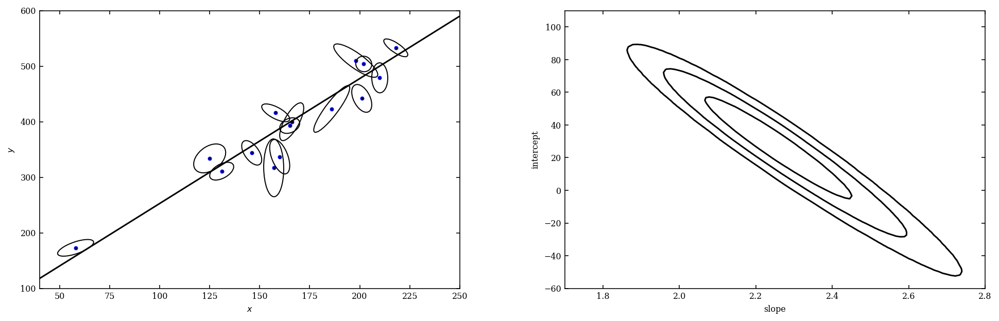

In [16]:
# Author: Jake VanderPlas
# License: BSD
#   The figure produced by this code is published in the textbook
#   "Statistics, Data Mining, and Machine Learning in Astronomy" (2013)
#   For more information, see http://astroML.github.com
#   To report a bug or issue, use the following forum:
#    https://groups.google.com/forum/#!forum/astroml-general
from scipy import optimize
from matplotlib.patches import Ellipse

from astroML.linear_model import TLS_logL
from astroML.plotting.mcmc import convert_to_stdev
from astroML.datasets import fetch_hogg2010test

#----------------------------------------------------------------------
# This function adjusts matplotlib settings for a uniform feel in the textbook.
# Note that with usetex=True, fonts are rendered with LaTeX.  This may
# result in an error if LaTeX is not installed on your system.  In that case,
# you can set usetex to False.
if "setup_text_plots" not in globals():
    from astroML.plotting import setup_text_plots
setup_text_plots(fontsize=8, usetex=False)


#------------------------------------------------------------
# Define some convenience functions

# translate between typical slope-intercept representation,
# and the normal vector representation
def get_m_b(beta):
    b = np.dot(beta, beta) / beta[1]
    m = -beta[0] / beta[1]
    return m, b


def get_beta(m, b):
    denom = (1 + m * m)
    return np.array([-b * m / denom, b / denom])


# compute the ellipse pricipal axes and rotation from covariance
def get_principal(sigma_x, sigma_y, rho_xy):
    sigma_xy2 = rho_xy * sigma_x * sigma_y

    alpha = 0.5 * np.arctan2(2 * sigma_xy2,
                             (sigma_x ** 2 - sigma_y ** 2))
    tmp1 = 0.5 * (sigma_x ** 2 + sigma_y ** 2)
    tmp2 = np.sqrt(0.25 * (sigma_x ** 2 - sigma_y ** 2) ** 2 + sigma_xy2 ** 2)

    return np.sqrt(tmp1 + tmp2), np.sqrt(tmp1 - tmp2), alpha


# plot ellipses
def plot_ellipses(x, y, sigma_x, sigma_y, 
                  rho_xy, factor=2, ax=None):
    if ax is None:
        ax = plt.gca()

    sigma1, sigma2, alpha = get_principal(sigma_x, 
                                          sigma_y, 
                                          rho_xy)

    for i in range(len(x)):
        ax.add_patch(Ellipse((x[i], y[i]),
                             factor * sigma1[i], factor * sigma2[i],
                             alpha[i] * 180. / np.pi,
                             fc='none', ec='k'))

#------------------------------------------------------------
# We'll use the data from table 1 of Hogg et al. 2010
data = fetch_hogg2010test()
data = data[5:]  # no outliers
x = data['x']
y = data['y']
sigma_x = data['sigma_x']
sigma_y = data['sigma_y']
rho_xy = data['rho_xy']

#------------------------------------------------------------
# Find best-fit parameters
X = np.vstack((x, y)).T
dX = np.zeros((len(x), 2, 2))
dX[:, 0, 0] = sigma_x ** 2
dX[:, 1, 1] = sigma_y ** 2
dX[:, 0, 1] = dX[:, 1, 0] = rho_xy * sigma_x * sigma_y

min_func = lambda beta: -TLS_logL(beta, X, dX)
beta_fit = optimize.fmin(min_func,
                         x0=[-1, 1])

#------------------------------------------------------------
# Plot the data and fits
fig = plt.figure(figsize=(15, 5))
fig.subplots_adjust(left=0.1, right=0.95, wspace=0.25,
                    bottom=0.15, top=0.9)

#------------------------------------------------------------
# first let's visualize the data
ax = fig.add_subplot(121)
ax.scatter(x, y, c='k', s=9)
plot_ellipses(x, y, sigma_x, sigma_y, rho_xy, ax=ax)

#------------------------------------------------------------
# plot the best-fit line
m_fit, b_fit = get_m_b(beta_fit)
x_fit = np.linspace(0, 300, 10)
ax.plot(x_fit, m_fit * x_fit + b_fit, '-k')

ax.set_xlim(40, 250)
ax.set_ylim(100, 600)
ax.set_xlabel('$x$')
ax.set_ylabel('$y$')

#------------------------------------------------------------
# plot the likelihood contour in m, b
ax = fig.add_subplot(122)
m = np.linspace(1.7, 2.8, 100)
b = np.linspace(-60, 110, 100)
logL = np.zeros((len(m), len(b)))

for i in range(len(m)):
    for j in range(len(b)):
        logL[i, j] = TLS_logL(get_beta(m[i], b[j]), X, dX)

ax.contour(m, b, convert_to_stdev(logL.T),
           levels=(0.683, 0.955, 0.997),
           colors='k')
ax.set_xlabel('slope')
ax.set_ylabel('intercept')
ax.set_xlim(1.7, 2.8)
ax.set_ylim(-60, 110)

plt.show()

### Time to get your hands dirty! Supernova distances and redshifts (part 2)

(35.0, 50.0)

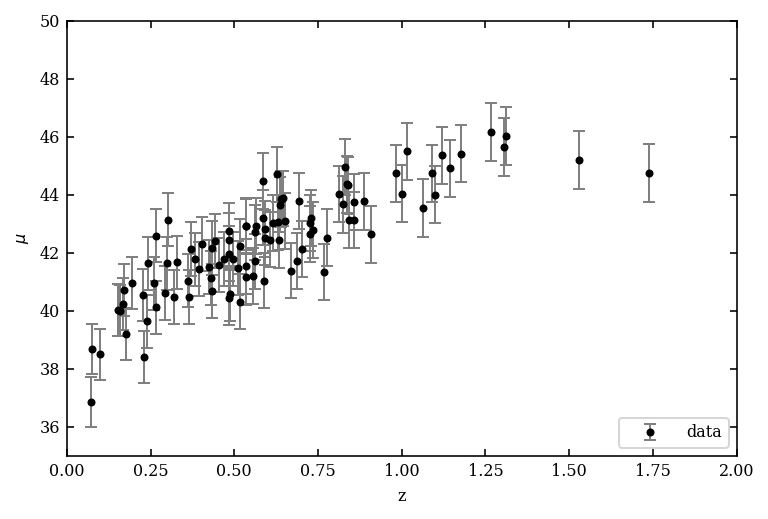

In [44]:
from astroML.datasets import generate_mu_z
z_sample, mu_sample, dmu = generate_mu_z(100, random_state=1234)

plt.errorbar(z_sample, mu_sample, dmu, fmt='.k', ecolor='gray', lw=1,label='data')
plt.xlabel("z")
plt.ylabel("$\mu$")
plt.legend(loc='lower right')
plt.xlim(0,2)
plt.ylim(35,50)

First let's fit our supernova synthetic data from last time using GPR.

- The key ingrediente in getting a good GPR fit is the choice of the kernel and its parameters.
- Check out what's available in the `kernels` submodule of [sklearn.gaussian_process](https://scikit-learn.org/stable/modules/classes.html#module-sklearn.gaussian_process)
- *Hint*. Radial-basis function kernel (aka squared-exponential kernel) is a standard choice in the GPR world.
- Plot the expectation value of the fit as well as the resulting 1-$\sigma$ and 2-$\sigma$ contours.
- Interpret the results.

*Note*. We have time constraints, so feel free to tweak the hyperparameters manually while in class. But, of course, a publication-quality result will require a cross-validation analysis. (Do this at home before the exam?)

We now have a suite of *data-drive predictive models* for our supernova dataset. That is: we can faithfully predict how a future redshift/distance measurement will look like given the current sample.

This is already great and these kind of tools are immensely useful in a variety of contexts (also involving a lot of money: suppose you want to predict how much a give financial asset will perform on tomorrow's stock market... You  might not really care about expressing the underlying financial model in simple terms, as long as your investments are profitable).

For the case of supernovae, however, we have do have physical theory which is $\Lambda$CDM.

- First, refresh your cosmology and write down the predicted relationship between the distance module $\mu$ and the redshift $\sigma$. *Hint* I always forget these things, my to-go reference is [Hogg (2010)](https://arxiv.org/abs/astro-ph/9905116). I got:

$$\mu = 5 \log \left( \frac{c/H_0} {10 {\rm pc}}(1+z)\int_0^z \frac{dz'}{\sqrt{\Omega_m (1+z^3)+\Omega_\Lambda}} \right) $$


- Assuming a flat Universe,  we have a parametric non-linear model for $\mu(z)$ that depends on two parameters, the Hubble constant $H_0$ and the matter content of the Universe $\Omega_m$
- It's a very non-linear model. Fit it to the data (however you want to do it).
- What are the measured value of $H_0$ and $\Omega_m$. Are they correlated?
- How would a model without dark energy (i.e. $\Omega_m=1$) perform? Do these data contain evidence of dark energy? (Hint: this is a model selection problem!)

The European Space Agency is considering new cosmology-related space mission. They ask you to figure out what science you can do with 10 times more measurement compared to what you have right now. That is: you want to clone your data. We've seen this earlier in the class, but now we can do much better.
- Assume a uniform distribution in redshifts between 0 and z.
- Using both the GPR fit and your latest $\Lambda$CDM fit, generate a set of $\mu$ measurements that respects the statistical properties of the data you were given. 



[My exploration](https://github.com/dgerosa/astrostatistics_bicocca_2024/blob/main/solutions/S15_supernovae1.ipynb)

# Classification: I


A few weeks ago we looked at density estimation and clustering, which are **unsupervised** forms of classification. Let's now look at **supervised** classification. This is where we actually know the "truth" for some of our objects and can use that information to help guide the classification of unknown objects.


## Generative vs. Discriminative Classification <a class="anchor" id="one"></a>

We will talk about two different types of classification where each has a slightly different approach.  As an example, if you are trying to determine whether your neighbor is speaking Spanish or Portuguese, you could 1) learn both Spanish and Portuguese so that you'd know exactly what they are saying or 2) learn the keys rules about the differences between the languages.

- If we find ourselves asking which category is most likely to generate the observed result, then we are using using **density estimation** for classification and this is referred to as **generative classification**. Here we have a full model of the density for each class or we have a model which describes how data could be generated from each class. 


- But if we don't care about the full distribution, then we are doing something more like clustering, where we don't need to map the distribution, we just need to define *boundaries*.  Classification that finds the **decision boundary** that separates classes is called **discriminative classification**.  For high-dimensional data, this may be a better choice.

For example, in the figure below, to classify a new object with $x=1$, it would suffice to know that either 
1. model 1 is a better fit than model 2 (***generative classification***), or 
2. that the decision boundary is at $x=1.4$ (***discriminative classification***).

![Ivezic, Figure 9.1](http://www.astroml.org/_images/fig_bayes_DB_1.png)


### Assessing Your Results

Before even introducing different schemes, let's talk about how we define the success of our classification. We'll bring back some concepts from the start of the course. 

Let's first consider **binary classification** where each observation is assigned to either **class=+1** or **class=-1** (or 0 depending on your preference). Let's ignore for now the fact that each observation can be assigned a probability of belonging to class 1 or -1 and we'll only allow those two possibilities (e.g., in the figure above $x=2$ is class +1 and $x=-0.5$ is class -1). 

In that case, there are 2 types of errors (where our goal is to identify class +1 objects):
* a **[False Positive](https://en.wikipedia.org/wiki/False_positives_and_false_negatives#False_positive_error)**, where we have assigned a *true* class label when it is really false. ---> ***Type-1 error***.
* a **[False Negative](https://en.wikipedia.org/wiki/False_positives_and_false_negatives#False_positive_error)**, where we have assigned a *false* class label when it is really true. ---> ***Type-2 error***.

All 4 [possibilities](https://en.wikipedia.org/wiki/Sensitivity_and_specificity) are (if you want apples, but not oranges):
- **True Positive** = ***correctly identified***  (apple identified as apple)
- **True Negative** = ***correctly rejected***  (orange rejected as orange)
- **False Positive** = ***incorrectly identified***  (orange identified as apple)
- **False Negative** = ***incorrectly rejected***  (apple rejected as orange)

Based on these, we usually define either of the following pairs of terms.  Which is used is largely a matter of preference in different fields, but we'll see that there are some key differences.

$$ 
{\rm completeness} = \frac{\rm true\ positives}{\rm true\ positives + false\ negatives} = {\rm true\ positive\ rate\ /\ sensitivity\ /\ recall}
$$

$$  
{\rm contamination} = \frac{\rm false\ positives}{\rm true\ positives + false\ positives} = {\rm false\ discovery\ rate}
$$

or

$$ 
{\rm true\ positive\ rate} = \frac{\rm true\ positives} {\rm true\ positives + false\ negatives}
$$

$$  
{\rm false\ positive\ rate} = \frac{\rm false\ positives} {\rm true\ negatives + false\ positives} = {\rm Type1\ error}
$$

Similarly 
 
$$
{\rm efficiency} = 1 - {\rm contamination} = {\rm precision}. 
$$

Depending on your goals, you may want to maximize the completeness or the efficiency, or a combination of both.

To better understand the differences between these measures, let's take the needle in a haystack problem.  You have 100,000 stars and 1000 quasars.  If you correctly identify 900 quasars as such and mistake 1000 stars for quasars, then we have:
- TP = 900
- FN  = 100
- TN = 99,000
- FP = 1000

Which gives

$$
{\rm true\ positive\ rate} = \frac{900}{900 + 100} = 0.9 = {\rm completeness}
$$

$$
{\rm false\ positive\ rate} = \frac{1000}{99000 + 1000} = 0.01
$$

Not bad right?  Well, sort of.  The FPR isn't bad, but there are *lots* of stars, so the contamination rate isn't so great.

$$
{\rm contamination} = \frac{1000}{900 + 1000} = 0.53
$$

## Comparing the performance of classifiers <a class="anchor" id="two"></a>

"Best" performance is subjective; we trade contamination versus completeness depending on the science. Before we even talk about different classification schemes, let's first talk about how we can quantify which of the methods is "best".  (N.B.  We have skipped ahead to Ivezic $\S$ 9.9).  

We do this with a [**Receiver Operating Characteristic (ROC)**](https://en.wikipedia.org/wiki/Receiver_operating_characteristic) curve. **A ROC curve simply plots the true-positive vs. the false-positive rate.** 

One concern about ROC curves is that they are sensitive to the relative sample sizes. As we already demonstrated above, **if there are many more background events than source events, small false positive results can dominate a signal.** For these cases ***we can plot completeness versus efficiency (1 - contamination).***

Here is a comparison of the two types of plots:

![Ivezic, Figure 9.17](http://www.astroml.org/_images/fig_ROC_curve_1.png)

Here we see that to get higher completeness, you could actually suffer significantly in terms of efficiency, but your FPR might not go up that much if there are lots of true negatives.

Note that you ***choose*** the completeness and efficiency that you want by choosing a **threshold (decision boundary)**. The curves show you what your possible choices are (depending on where you set the threshold). Generally, you want to chose a decision boundary that maximizes the area under the ROC curve.

Below is the code that makes these plots.  We'll talk about the data that goes into it in a bit.  For now, we'll concentrate on how to generate the ROC and completeness-contamination plots. We'll be comparing 7 different classifiers (with a generic `clf` object), making training and test sets with `split_samples`, then using these tools to generate our plots:

- [sklearn.metrics.roc_curve(y_test, y_prob)](http://scikit-learn.org/stable/modules/generated/sklearn.metrics.roc_curve.html)
- [sklearn.metrics.precision_recall_curve(y_test, y_prob)](http://scikit-learn.org/stable/modules/generated/sklearn.metrics.precision_recall_curve.html)
- astroML.utils.completeness_contamination(y_pred, y_test)

Note that the [`sklearn.metrics` algorithms](http://scikit-learn.org/stable/modules/classes.html#module-sklearn.metrics) take `y_test`, which are classes, and `y_prob`, which are not class predictions, but rather probabilities, whereas the AstroML algorithm wants `y_pred` (which we get by converting `y_prob` into discrete predictions as a function of the probability).

**NOTE!!** `sklearn-0.23.2` works with the following code. Newer versions may break. If so, revert to 0.23.2.

In [1]:
from matplotlib import pyplot as plt
%matplotlib inline
%config InlineBackend.figure_format='retina'

GaussianNB
LinearDiscriminantAnalysis
QuadraticDiscriminantAnalysis
LogisticRegression
KNeighborsClassifier
DecisionTreeClassifier
GMMBayes


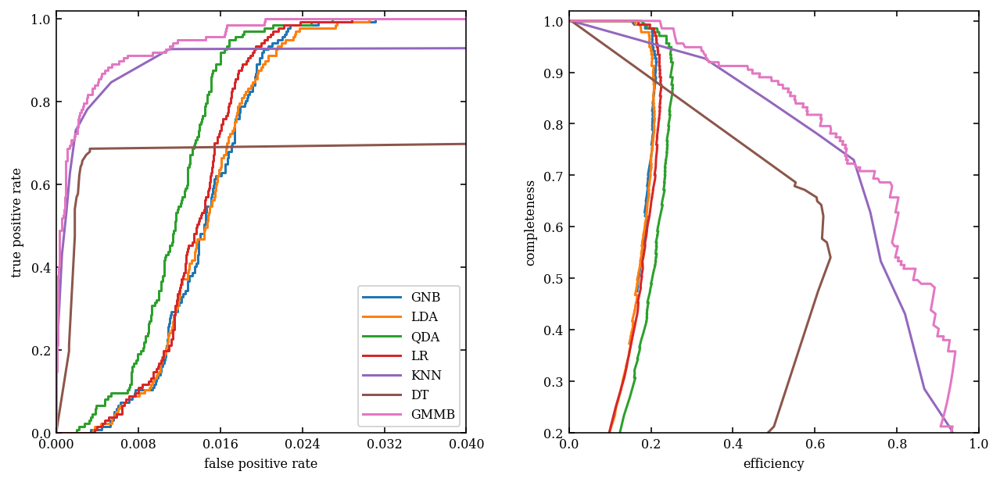

In [2]:
from __future__ import print_function

import numpy as np

from sklearn.naive_bayes import GaussianNB
from sklearn.discriminant_analysis import (LinearDiscriminantAnalysis,
                                           QuadraticDiscriminantAnalysis)
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from astroML.classification import GMMBayes

from sklearn.metrics import roc_curve
from sklearn.metrics import precision_recall_curve

from astroML.utils import split_samples, completeness_contamination
from astroML.datasets import fetch_rrlyrae_combined


# get data and split into training & testing sets
X, y = fetch_rrlyrae_combined()
y = y.astype(int)
(X_train, X_test), (y_train, y_test) = split_samples(X, y, [0.75, 0.25],
                                                     random_state=0)


#------------------------------------------------------------
# Fit all the models to the training data
def compute_models(*args):
    names = []
    probs = []
    for classifier, kwargs in args:
        print(classifier.__name__)
        clf = classifier(**kwargs)
        clf.fit(X_train, y_train)
        
        #Note that we are outputing the probabilities [of class 1], not the classes
        y_probs = clf.predict_proba(X_test)[:, 1]

        names.append(classifier.__name__)
        probs.append(y_probs)

    return names, probs


names, probs = compute_models((GaussianNB, {}),
                              (LinearDiscriminantAnalysis, {}),
                              (QuadraticDiscriminantAnalysis, {}),
                              (LogisticRegression,
                               dict(class_weight='balanced')),
                              (KNeighborsClassifier,
                               dict(n_neighbors=10)),
                              (DecisionTreeClassifier,
                               dict(random_state=0, max_depth=12,
                                    criterion='entropy')),
                              (GMMBayes, dict(n_components=3, tol=1E-5,
                                              covariance_type='full')))

#------------------------------------------------------------
# Plot ROC curves and completeness/efficiency
fig = plt.figure(figsize=(15, 5))
fig.subplots_adjust(left=0.1, right=0.95, bottom=0.15, top=0.9, wspace=0.25)

# ax1 will show roc curves
ax1 = plt.subplot(131)

# ax2 will show completeness/efficiency
ax2 = plt.subplot(132)

# ax3 will show precision/recall
# ax3 = plt.subplot(133)

labels = dict(GaussianNB='GNB',
              LinearDiscriminantAnalysis='LDA',
              QuadraticDiscriminantAnalysis='QDA',
              KNeighborsClassifier='KNN',
              DecisionTreeClassifier='DT',
              GMMBayes='GMMB',
              LogisticRegression='LR')

thresholds = np.linspace(0, 1, 1001)[:-1]

# iterate through and show results
for name, y_prob in zip(names, probs):
    fpr, tpr, thresh = roc_curve(y_test, y_prob)
    precision, recall, thresh2 = precision_recall_curve(y_test, y_prob)

    # add (0, 0) as first point
    fpr = np.concatenate([[0], fpr])
    tpr = np.concatenate([[0], tpr])
    # Here we add (1,0) 
    precision = np.concatenate([[0], precision])
    recall = np.concatenate([[1], recall])
    thresh2 = np.concatenate([[0], thresh2])

    ax1.plot(fpr, tpr, label=labels[name])

    #See note above about astroML vs. sklearn
    #Note that the range of threshhold values here is 0% to 100% (0.0 to 1.0)
    comp = np.zeros_like(thresholds)
    cont = np.zeros_like(thresholds)
    for i, t in enumerate(thresholds):
        y_pred = (y_prob >= t)
        comp[i], cont[i] = completeness_contamination(y_pred, y_test)
    ax2.plot(1 - cont, comp, label=labels[name])
    
    #ax3.plot(precision, recall, label=labels[name])

ax1.set_xlim(0, 0.04)
ax1.set_ylim(0, 1.02)
ax1.xaxis.set_major_locator(plt.MaxNLocator(5))
ax1.set_xlabel('false positive rate')
ax1.set_ylabel('true positive rate')
ax1.legend(loc=4)

ax2.set_xlabel('efficiency')
ax2.set_ylabel('completeness')
ax2.set_xlim(0, 1.0)
ax2.set_ylim(0.2, 1.02)

#ax3.set_xlabel('precision')
#ax3.set_ylabel('recall')
#ax3.set_xlim(0, 1.0)
#ax3.set_ylim(0.2, 1.02)

plt.show()

The plot blow shows completeness and efficiency a function of the threshold value, highlighting the value where precision is 90%.

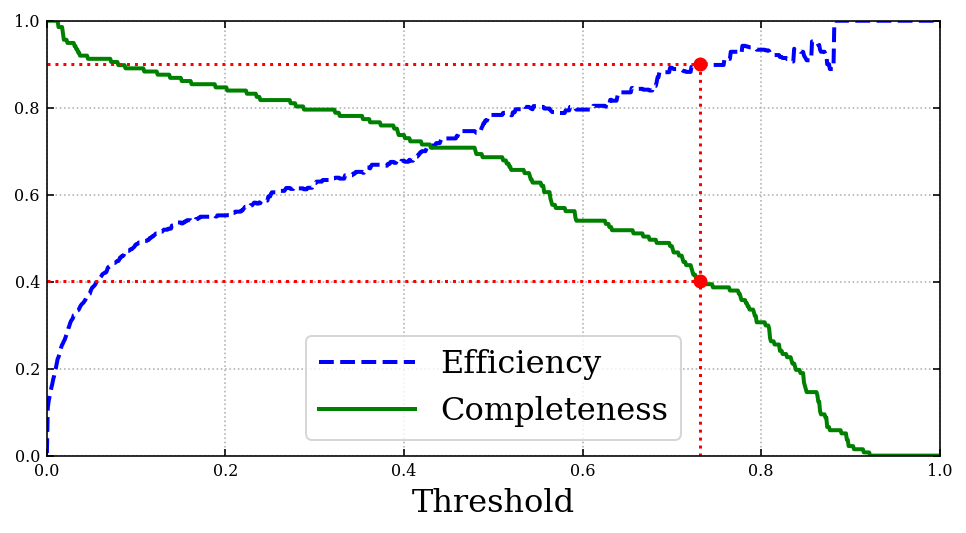

In [3]:
eff = 1-cont
def plot_comp_eff_vs_threshold(eff, comp, thresholds):
    plt.plot(thresholds, eff, "b--", label="Efficiency", linewidth=2)
    plt.plot(thresholds, comp, "g-", label="Completeness", linewidth=2)
    plt.legend(loc="best", fontsize=16)
    plt.xlabel("Threshold", fontsize=16)
    plt.grid(True)                
    plt.axis([0, 1, 0, 1])             

comp_90_eff = comp[np.argmax(eff >= 0.90)]
threshold_90_eff = thresholds[np.argmax(eff >= 0.90)]

plt.figure(figsize=(8, 4))                                                                  
plot_comp_eff_vs_threshold(eff, comp, thresholds)
plt.plot([threshold_90_eff, threshold_90_eff], [0., 0.9], "r:")                 
plt.plot([0, threshold_90_eff], [0.9, 0.9], "r:")                                
plt.plot([0, threshold_90_eff], [comp_90_eff, comp_90_eff], "r:")
plt.plot([threshold_90_eff], [0.9], "ro")                                             
plt.plot([threshold_90_eff], [comp_90_eff], "ro")                                                                          
plt.show()

Finally, here's how to visualize a constraint on efficiency in terms of what it means for completeness.

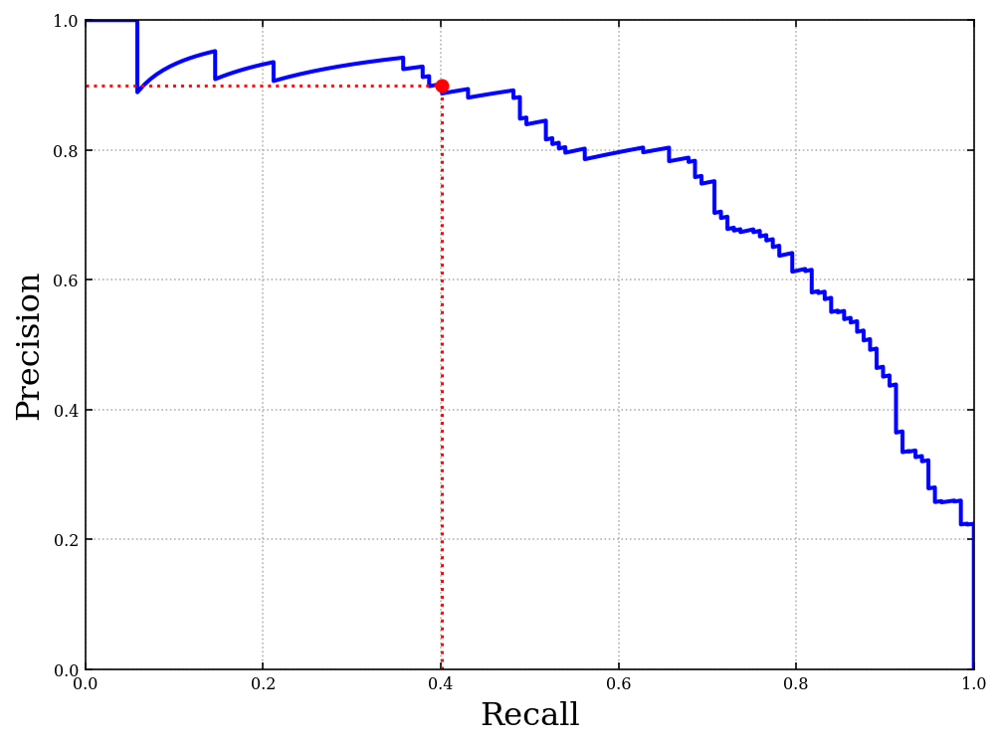

In [4]:
def plot_precision_vs_recall(precisions, recalls):
    plt.plot(recalls, precisions, "b-", linewidth=2)
    plt.xlabel("Recall", fontsize=16)
    plt.ylabel("Precision", fontsize=16)
    plt.axis([0, 1, 0, 1])
    plt.grid(True)

    
recall_90_precision = recall[np.argmax(precision >= 0.90)]
threshold_90_precision = thresh2[np.argmax(precision >= 0.90)]

plt.figure(figsize=(8, 6))
plot_precision_vs_recall(precision, recall)
#plt.plot([0.4368, 0.4368], [0., 0.9], "r:")
plt.plot([recall_90_precision,recall_90_precision], [0., 0.9], "r:")
plt.plot([0.0, recall_90_precision], [0.9, 0.9], "r:")
plt.plot(recall_90_precision, [0.9], "ro")
#save_fig("precision_vs_recall_plot")
plt.show()

So far we have only looked at binary classification.  However, you may instead want:

* [Multiclass](https://scikit-learn.org/stable/modules/multiclass.html): to distinguish between more than 2 classes (e.g., MNIST digits)

* [Multilabel](https://scikit-learn.org/stable/modules/multiclass.html): if you want to allow multiple class labels for each object

But those are beyond the scope of what we'll see today.

## Generative Classification <a class="anchor" id="three"></a>

With some assessment criteria defined, we can talk about classification itself.  **We can use Bayes' theorem to relate the labels to the features in an $N\times D$ data set $X$.**  The $j$th feature of the $i$th point is $x^j_i$ and there are $k$ classes giving discrete labels $y_k$.  We have

$$p(y_k|x_i) = \frac{p(x_i|y_k)p(y_k)}{\sum_i p(x_i|y_k)p(y_k)},$$

where $x_i$ is assumed to be a vector with $j$ components.

$p(y=y_k)$ is the probability of any point having class $k$ (equivalent to the prior probability of the class $k$). 

In generative classifiers we model class-conditional densities $p(x|y=y_k)$. 

Before we get into the generative classification algortithms, we'll first discuss 3 general concepts:
- (a) Discriminant Functions
- (b) Bayes Classifiers
- (c) Decision Boundaries

### (a) The Discriminant Function

**We can relate classification to density estimation and regression**. $\hat{y} = f(y|x)$ represents the best guess of $y$ given $x$. **So classification is just regression with discrete $y$ values, e.g., $y=\{0,1\}$.**

In classification we refer to $f(y|x)$ as the [**discriminant function**](https://en.wikipedia.org/wiki/Discriminant_function_analysis).

For a simple 2-class example, where $y=\{0,1\}$:

$$\begin{eqnarray}
g(x) = f(y|x) & = &  \int y \, p(y|x) \, dy \\
%    & = & \int y p(y|x) \, dy \\
       & = & 1 \cdot p(y=1 | x) + 0 \cdot p(y=0 | x) = p(y=1 | x).
%     & = & p(y=1 | x)
\end{eqnarray}
$$

and then using Bayes' rule:

$$g(x) = \frac{p(x|y=1) \, p(y=1)}{p(x|y=1) \, p(y=1)  + p(x|y=0) \, p(y=0)}$$

The first equation is just the expectation value of y.

### (b) Bayes Classifier

If the discriminant function gives a binary prediction, we call it a **Bayes classifier**, formulated as

$$\begin{eqnarray} \widehat{y} & = & \left\{ \begin{array}{cl}       	           1 & \mbox{if $g(x) > 1/2$}, \\       	           0 & \mbox{otherwise,}       	           \end{array}     	   \right. \\     & = & \left\{
\begin{array}{cl}               1 & \mbox{if $p(y=1|x) > p(y=0|x)$}, \\               0 & \mbox{otherwise.}               \end{array}       \right.\end{eqnarray}$$

Where this can be generalized to any number of classes, $k$, and not just two.

### (c) Decision Boundary

A **decision boundary** is just set of $x$ values at which each class is equally likely:

$$
p(x|y=1)p(y=1)  =  p(x|y=0)p(y=0);
$$

$$g_1(x) = g_2(x) \; {\rm or}\; g(x) = 1/2$$

Below is an example of a decision boundary in 1-D, where each class is equally likely so we can just look at $p(x)$.  In short, we assign classifications according to which pdf is higher at every given $x$.

![Ivezic, Figure 9.1](http://www.astroml.org/_images/fig_bayes_DB_1.png)


## Simplest Classifier: Naive Bayes <a class="anchor" id="four"></a>

In practice, classification is complicated as the data are generally multi-dimensional (that is we don't just have $x$, we have $x^{j=0},x^1,x^2,x^3...x^N$, so we want $p(x^0,x^1,x^2,x^3...x^N|y)$.

Naive Bayes classification comes to the rescue here: note that it's not very clearly in the textbook section that this is for discrete features $\{x\}$. If we **assume** that ***all attributes are conditionally independent*** (which is not always true, but is often close enough), then multi-dimensional pdfs simplify to

$$ p(x^i,x^j|y_k) = p(x^i|y_k)p(x^j|y_k)$$
  
which can be written as

$$ p({x^{j=0},x^1,x^2,\ldots,x^N}|y_k) = \prod_j p(x^j|y_k).$$

From Bayes' rule and conditional independence we get

$$
  p(y_k | {x^0,x^1,\ldots,x^N}) =
  \frac{\prod_j p(x^j|y_k) p(y_k)}
       {\sum_l \prod_j p(x^j|y_l) p(y_l)}.
$$

We calculate the most likely value of $y$ by maximizing this over choices of $y_k$:

$$
\hat{y} = \arg \max_{y_k} \frac{\prod_j p(x^j|y_k) p(y_k)}
        {\sum_l \prod_j p(x^j|y_l) p(y_l)},
$$


From there the process is just estimating densities: $p(x|y=y_k)$ and $p(y=y_k)$ are learned from a set of training data, where
- **$p(y=y_k)$ is just the frequency of the class $k$**
- **$p(x|y=y_k)$ is just the density (probability) of an object with class $k$ having the attributes $x$**

## Gaussian Naive Bayes <a class="anchor" id="five"></a>

One way to handle continuous values for $X$ is to model $p(x^j|y=y_k)$ as one-dimensional normal distributions, with means $\mu^j_k$ and widths $\sigma^j_k$. ($\mu^j_k$​ and $\sigma^j_k$ are the mean and std of feature $x^j$​ in class $k$).
The naive Bayes estimator is then

$$\hat{y} = \arg\max_{y_k}\left[\ln p(y=y_k) - \frac{1}{2}\sum_{j=1}^N\left(2\pi(\sigma^j_k)^2 + \frac{(x^j - \mu^j_k)^2}{(\sigma^j_k)^2} \right) \right]$$

In Scikit-Learn [`Gaussian Naive Bayes`](http://scikit-learn.org/stable/modules/generated/sklearn.naive_bayes.GaussianNB.html) classification is implemented as follows, with a simple example given in the next cell.

## How Gaussian Naive Bayes Works in Practice

Let’s walk through **how Gaussian Naive Bayes works in practice** — from training the model on your data to making predictions on new data.

---

### Training Phase

Given a labeled dataset with continuous features and classes:
$$
\{(X^{(1)}, C^{(1)}), (X^{(2)}, C^{(2)}), \ldots, (X^{(N)}, C^{(N)})\}
$$

where $X^{(j)} = (x^{(j)}_1, x^{(j)}_2, \ldots, x^{(j)}_n)$ is the feature vector and $C^{(j)}$ is the class label.

For each class $C_k$:
- **Estimate the prior probability**:
  $$
  P(C_k) = \frac{\text{Number of samples in } C_k}{\text{Total number of samples}}
  $$
- **Estimate the mean and variance of each feature**:
  $$
  \mu_{k,i} = \frac{1}{N_k} \sum_{j \in C_k} x^{(j)}_i
  $$
  $$
  \sigma^2_{k,i} = \frac{1}{N_k} \sum_{j \in C_k} \left(x^{(j)}_i - \mu_{k,i}\right)^2
  $$

where $N_k$ is the number of samples in class $C_k$.

---

### Prediction Phase

Given a new, unlabeled example $X = (x_1, x_2, \ldots, x_n)$:
- For each class $C_k$:
  - Calculate the **likelihood** of $X$ given $C_k$ using the Gaussian formula:
    $$
    P(X \mid C_k) = \prod_{i=1}^{n} \frac{1}{\sqrt{2\pi\sigma_{k,i}^2}} \exp \left( -\frac{(x_i - \mu_{k,i})^2}{2\sigma_{k,i}^2} \right)
    $$
  - Multiply by the **prior**:
    $$
    P(C_k) \cdot P(X \mid C_k)
    $$

- Select the class with the highest posterior probability:
  $$
  \hat{C} = \arg\max_{C_k} \left[ P(C_k) \cdot P(X \mid C_k) \right]
  $$

### Advantages
- Simple and fast.
- Works well even with small datasets.
- Surprisingly effective even when the conditional independence assumption is not strictly true.

### Limitations
- Assumes features are normally distributed — may not perform well if features are highly skewed or multimodal.
- Assumes feature independence within each class — which is often violated in real-world data.

In [4]:
import numpy as np
from sklearn.naive_bayes import GaussianNB

X = np.random.random((100,2))
y = (X[:,0] + X[:,1] > 1).astype(int) #Class 1 if sum of both features is >1

gnb = GaussianNB()
gnb.fit(X,y)

y_pred = gnb.predict(X)

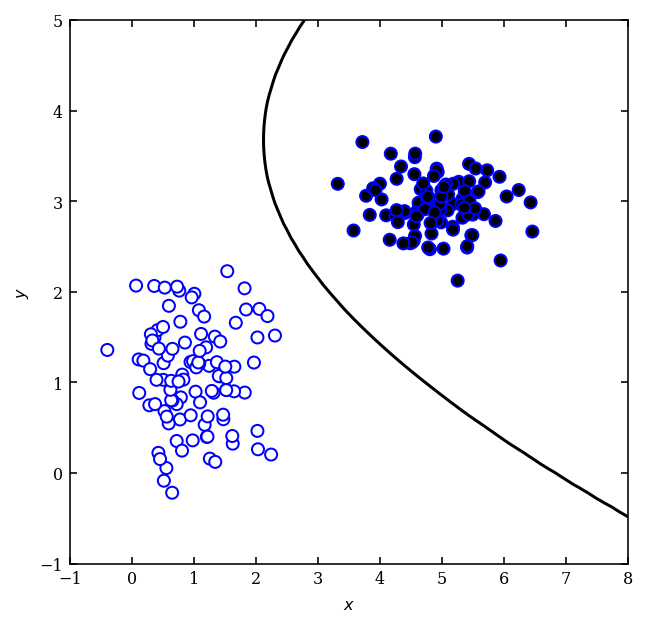

In [5]:
from matplotlib import colors

from sklearn.naive_bayes import GaussianNB


# Simulate some data
np.random.seed(0)
mu1 = [1, 1]
cov1 = 0.3 * np.eye(2)

mu2 = [5, 3]
cov2 = np.eye(2) * np.array([0.4, 0.1])

X = np.concatenate([np.random.multivariate_normal(mu1, cov1, 100),
                    np.random.multivariate_normal(mu2, cov2, 100)])
y = np.zeros(200)
y[100:] = 1

#------------------------------------------------------------
# Fit the Naive Bayes classifier
clf = GaussianNB()
clf.fit(X, y)

# predict the classification probabilities on a grid
xlim = (-1, 8)
ylim = (-1, 5)
xx, yy = np.meshgrid(np.linspace(xlim[0], xlim[1], 71),
                     np.linspace(ylim[0], ylim[1], 81))
Z = clf.predict_proba(np.c_[xx.ravel(), yy.ravel()])
# Gives probability for both class 1 and class 2 for each grid point
# As these are degenerate, take just one and then
# re-shape it to the grid pattern needed for contour plotting
Z = Z[:, 1].reshape(xx.shape)

#------------------------------------------------------------
# Plot the results
fig = plt.figure(figsize=(5, 5))
ax = fig.add_subplot(111)
ax.scatter(X[:, 0], X[:, 1], c=y, cmap=plt.cm.binary, zorder=2)


# Add the decision boundary, which is just the contour where
# the probability exceeds some threshold, here 0.5.
ax.contour(xx, yy, Z, [0.5], colors='k')

ax.set_xlim(xlim)
ax.set_ylim(ylim)

ax.set_xlabel('$x$')
ax.set_ylabel('$y$')

plt.show()

### Separate RR Lyrae stars from non-variable main squence stars

**And now an example using real data-- this uses Gaussian Naive Bayes classification to separate RR Lyrae stars from non-variable main squence stars.** Here we have a 4-D $X$ and we are going to take them 1-D at a time to see how much improvement comes from adding each new dimension of $X$.


RR Lyrae variables are periodic variable stars, commonly found in globular clusters. They are used as standard candles to measure (extra)galactic distances, assisting with the cosmic distance ladder. This class is named after the prototype and brightest example, RR Lyrae. They are pulsating horizontal branch stars of spectral class A or F, with a mass of around half the Sun's. They are thought to have shed mass during the red-giant branch phase, and were once stars of similar or slightly less mass than the Sun, around 0.8 solar masses. In contemporary astronomy, a period-luminosity relation makes them good standard candles for relatively nearby targets, especially within the Milky Way and Local Group. ([text credits](https://en.wikipedia.org/wiki/RR_Lyrae_variable))


![](http://hyperphysics.phy-astr.gsu.edu/hbase/Starlog/imgsta/rrloc.png)

([Figure](http://hyperphysics.phy-astr.gsu.edu/hbase/Starlog/rrlyrae.html) credits)

Most importantly for our application, RR Lyrae are rare stars. These are labeled data from SDSS Stripe 82, selected for their variability based on other data (see Ivezic Sec 9.1 for details)




completeness [0.48684211 0.68421053 0.80263158 0.88157895]
contamination [0.86346863 0.80917431 0.81791045 0.80466472]


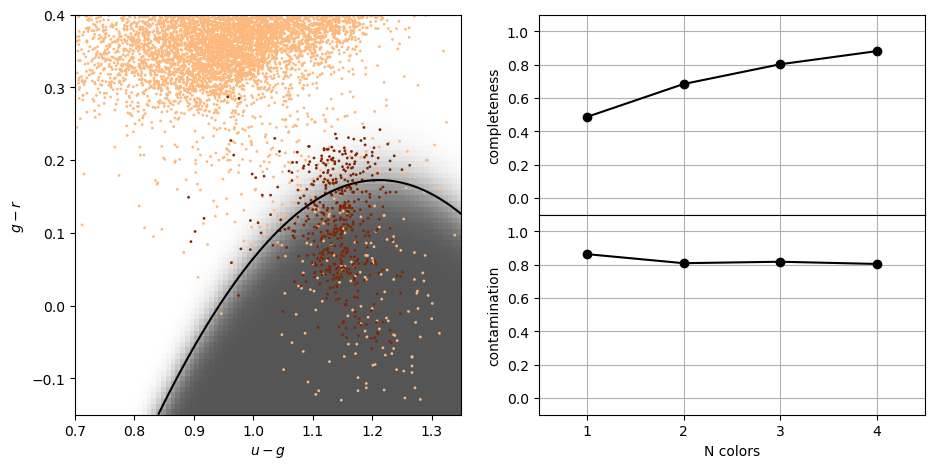

In [23]:
from sklearn.naive_bayes import GaussianNB
from astroML.datasets import fetch_rrlyrae_combined
from astroML.utils import split_samples
from astroML.utils import completeness_contamination
# Added by GTR
from sklearn.metrics import precision_recall_curve, roc_curve

# get data and split into training & testing sets
X, y = fetch_rrlyrae_combined() # X is a 4-D color-color-color-color space
X = X[:, [1, 0, 2, 3]]  # rearrange columns for better 1-color results
(X_train, X_test), (y_train, y_test) = split_samples(X, y, [0.7, 0.3],
                                                     random_state=0)

N_tot = len(y)
N_st = np.sum(y == 0)
N_rr = N_tot - N_st
N_train = len(y_train)
N_test = len(y_test)
N_plot = 5000 + N_rr

#----------------------------------------------------------------------
# perform Naive Bayes
classifiers = []
predictions = []
Ncolors = np.arange(1, X.shape[1] + 1)

order = np.array([1, 0, 2, 3])

y_prob = np.array([])

for nc in Ncolors:
    clf = GaussianNB()
    clf.fit(X_train[:, :nc], y_train)
    y_pred = clf.predict(X_test[:, :nc])
    
    # Added by GTR to be able to compute precision, recall, fpr, and tpr
    # Gives the probability for both classes, take just one
    y_prob = np.append(y_prob,clf.predict_proba(X_test[:, :nc])[:,1])

    classifiers.append(clf)
    predictions.append(y_pred)

completeness, contamination = completeness_contamination(predictions, y_test)

print("completeness", completeness)
print("contamination", contamination)

#------------------------------------------------------------
# Compute the decision boundary
clf = classifiers[1]
xlim = (0.7, 1.35)
ylim = (-0.15, 0.4)

xx, yy = np.meshgrid(np.linspace(xlim[0], xlim[1], 81),
                     np.linspace(ylim[0], ylim[1], 71))

Z = clf.predict_proba(np.c_[yy.ravel(), xx.ravel()])
Z = Z[:, 1].reshape(xx.shape)

#----------------------------------------------------------------------
# plot the results
fig = plt.figure(figsize=(10, 5))
fig.subplots_adjust(bottom=0.15, top=0.95, hspace=0.0,
                    left=0.1, right=0.95, wspace=0.2)

# left plot: data and decision boundary
ax = fig.add_subplot(121)
im = ax.scatter(X[-N_plot:, 1], X[-N_plot:, 0], c=y[-N_plot:],
                s=4, lw=0, cmap=plt.cm.Oranges, zorder=2)
im.set_clim(-0.5, 1)

im = ax.imshow(Z, origin='lower', aspect='auto',
               cmap=plt.cm.binary, zorder=1,
               extent=xlim + ylim)
im.set_clim(0, 1.5)
ax.contour(xx, yy, Z, [0.5], colors='k')

ax.set_xlim(xlim)
ax.set_ylim(ylim)

ax.set_xlabel('$u-g$')
ax.set_ylabel('$g-r$')

# Plot completeness vs Ncolors
ax = plt.subplot(222)
ax.plot(Ncolors, completeness, 'o-k', ms=6)

ax.xaxis.set_major_locator(plt.MultipleLocator(1))
ax.yaxis.set_major_locator(plt.MultipleLocator(0.2))
ax.xaxis.set_major_formatter(plt.NullFormatter())

ax.set_ylabel('completeness')
ax.set_xlim(0.5, 4.5)
ax.set_ylim(-0.1, 1.1)
ax.grid(True)

# Plot contamination vs Ncolors
ax = plt.subplot(224)
ax.plot(Ncolors, contamination, 'o-k', ms=6)

ax.xaxis.set_major_locator(plt.MultipleLocator(1))
ax.yaxis.set_major_locator(plt.MultipleLocator(0.2))
ax.xaxis.set_major_formatter(plt.FormatStrFormatter('%i'))

ax.set_xlabel('N colors')
ax.set_ylabel('contamination')
ax.set_xlim(0.5, 4.5)
ax.set_ylim(-0.1, 1.1)
ax.grid(True)

plt.show()

- In the **left panel**, light points represent non-variable sources, while dark points are variable sources. The decision boundary is a curved black line, with the classification probability shown as a shaded background.
- In the **right panel**, more and more stellar color features are used to train the classification scheme. 

**Question for you to think about:**  If you shifted the decision boundary "up" by hand, what would happen to the completeness, contamination, and false positive rate? 

**Try this at home:** What happens if you change the fraction of objects in the training set?

The "*naive*" in Naive Bayes refers to the fact that we are assuming that all of the variables are conditionally independent. If we relax that assumption and allow for covariances, then we have a **Gaussian Bayes classifier**.  But note that this comes with a large jump in computational cost! Recall the form of a multivariate Gaussian distribution, where $\vec{x}$ and $\vec{\mu}_k$ are $D$-dimensional vectors over data features, and $\Sigma_k$ is a $D\times D$ symmetric covariance matrix:

$$ p_k(\vec{x}) = \frac{1}{\sqrt{\mathrm{det}(2\pi\Sigma_k)}}\exp\left[ -\frac{1}{2}(\vec{x}-\vec{\mu}_k)^T \Sigma_k^{-1}(\vec{x}-\vec{\mu}_k) \right].$$

**The Gaussian Bayes classifier version of $\hat{y}$ is then**

$$\hat{y} = \arg\max_{y_k}\left[\ln p(y=y_k) - \frac{1}{2}\ln\mathrm{det}(\Sigma_k) - \frac{1}{2}(\vec{x}-\vec{\mu}_k)^T \Sigma_k^{-1}(\vec{x}-\vec{\mu}_k)\right]$$

## Linear & Quadratic Discriminant Analysis <a class="anchor" id="six"></a>

In **[Linear Discriminant Analysis (LDA)](https://en.wikipedia.org/wiki/Linear_discriminant_analysis)** we simplify the Gaussian Bayes classifier by assuming that the class distributions have ***identical***
covariances for all $k$ classes (all classes are a set of shifted Gaussians). 

**If we ignore terms involving only the data, $X$, and the class-dependent covariances, then this cancels out terms that have quadratic dependence on $X$.** The log of the class posteriors

$$ g_k(\vec{x}) = \vec{x}^T \Sigma^{-1} \vec{\mu_k} - \frac{1}{2}\vec{\mu_k}^T \Sigma^{-1} \vec{\mu_k} + \ln p(y=y_k),$$

with $\vec{\mu}_k$ the mean of class $k$ and $\Sigma$ the covariance of the Gaussians.

<!--- ** note different from book --->

***The Bayes classifier is, therefore, linear with respect to $X$***, and  discriminant boundary between classes is the line that minimizes the overlap between Gaussians.

<!--- > $  g_k(\vec{x}) - g_\ell(\vec{x}) = \vec{x}^T \Sigma^{-1} (\mu_k-\mu_\ell)  - \frac{1}{2}(\mu_k - \mu_\ell)^T \Sigma^{-1}(\mu_k -\mu_\ell)  + \log (\frac{\pi_k}{\pi_\ell}) = 0. $ --->

**Relaxing the requirement that the covariances of the Gaussians are equal, the discriminant function becomes quadratic in $X$.**

$$ g(\vec{x}) = -\frac{1}{2} \ln\mathrm{det}(\Sigma_k) - \frac{1}{2}(\vec{x}-\mu_k)^T \Sigma_k^{-1}(\vec{x}-\mu_k) + \ln p(y=y_k). $$

This is sometimes known as **[Quadratic Discriminant Analysis (QDA)](https://en.wikipedia.org/wiki/Quadratic_classifier#Quadratic_discriminant_analysis)**.

[`LDA`](http://scikit-learn.org/0.16/modules/generated/sklearn.lda.LDA.html) and [`QDA`](http://scikit-learn.org/0.16/modules/generated/sklearn.qda.QDA.html#sklearn.qda.QDA) are implemented in `Scikit-Learn` as follows and an example using the same data as above is given below.

## Linear & Quadratic Discriminant Analysis <a class="anchor" id="six"></a>

In **[Linear Discriminant Analysis (LDA)](https://en.wikipedia.org/wiki/Linear_discriminant_analysis)** we simplify the Gaussian Bayes classifier by assuming that the class distributions have ***identical***
covariances for all $k$ classes (all classes are a set of shifted Gaussians). 

**If we ignore terms involving only the data, $X$, and the class-dependent covariances, then this cancels out terms that have quadratic dependence on $X$.** The log of the class posteriors

$$ g_k(\vec{x}) = \vec{x}^T \Sigma^{-1} \vec{\mu_k} - \frac{1}{2}\vec{\mu_k}^T \Sigma^{-1} \vec{\mu_k} + \ln p(y=y_k),$$

with $\vec{\mu}_k$ the mean of class $k$ and $\Sigma$ the covariance of the Gaussians.

<!--- ** note different from book --->

***The Bayes classifier is, therefore, linear with respect to $X$***, and  discriminant boundary between classes is the line that minimizes the overlap between Gaussians.

<!--- > $  g_k(\vec{x}) - g_\ell(\vec{x}) = \vec{x}^T \Sigma^{-1} (\mu_k-\mu_\ell)  - \frac{1}{2}(\mu_k - \mu_\ell)^T \Sigma^{-1}(\mu_k -\mu_\ell)  + \log (\frac{\pi_k}{\pi_\ell}) = 0. $ --->

**Relaxing the requirement that the covariances of the Gaussians are equal, the discriminant function becomes quadratic in $X$.**

$$ g(\vec{x}) = -\frac{1}{2} \ln\mathrm{det}(\Sigma_k) - \frac{1}{2}(\vec{x}-\mu_k)^T \Sigma_k^{-1}(\vec{x}-\mu_k) + \ln p(y=y_k). $$

This is sometimes known as **[Quadratic Discriminant Analysis (QDA)](https://en.wikipedia.org/wiki/Quadratic_classifier#Quadratic_discriminant_analysis)**.

[`LDA`](http://scikit-learn.org/0.16/modules/generated/sklearn.lda.LDA.html) and [`QDA`](http://scikit-learn.org/0.16/modules/generated/sklearn.qda.QDA.html#sklearn.qda.QDA) are implemented in `Scikit-Learn` as follows and an example using the same data as above is given below.

## Differences between LDA and Gaussian Naive Bayes

| Feature | LDA | Gaussian Naive Bayes |
|---------|-----|-----------------------|
| **Assumptions about features** | Assumes features are normally distributed and have equal covariance matrices across classes; allows features to be correlated. | Assumes features are normally distributed and conditionally independent given the class. |
| **Decision boundary** | Linear (hyperplane). | Linear (hyperplane) — but can differ numerically from LDA due to the independence assumption. |
| **Parameter estimation** | Learns a shared covariance matrix from the data. | Learns individual variances per feature for each class. |
| **Correlation between features** | Accounts for correlations. | Ignores correlations (covariances are zero). |
| **Strengths** | Can handle correlated features better. | Often faster and simpler; works well even with small data. |

---

### Mathematical Differences

#### Linear Discriminant Analysis (LDA)

LDA models the class-conditional distribution as a multivariate Gaussian:

$$
p(\mathbf{x} \mid y=k) = \mathcal{N}(\mathbf{x}; \boldsymbol{\mu}_k, \Sigma)
$$

where $\Sigma$ is the shared covariance matrix across all classes.

The discriminant function is:

$$
\delta_k(\mathbf{x}) = \mathbf{x}^T \Sigma^{-1} \boldsymbol{\mu}_k - \frac{1}{2} \boldsymbol{\mu}_k^T \Sigma^{-1} \boldsymbol{\mu}_k + \log(\pi_k)
$$

where $\pi_k$ is the prior probability of class $k$.

---

#### Gaussian Naive Bayes (GNB)

GNB assumes conditional independence among features, so:

$$
p(\mathbf{x} \mid y=k) = \prod_j \mathcal{N}(x_j; \mu_{jk}, \sigma_{jk}^2)
$$

There is no covariance between features.

The discriminant function is:

$$
\sum_j \left( -\frac{(x_j - \mu_{jk})^2}{2\sigma_{jk}^2} - \frac{1}{2} \log(\sigma_{jk}^2) \right) + \log(\pi_k)
$$

---

## Intuition

- **LDA** uses all features jointly, capturing how they co-vary (the shape of the data cloud), and is sensitive to **correlated features**.
- **GNB** assumes features are conditionally independent given the class. This simplifies the math and often works surprisingly well — even when the independence assumption is violated.

---

## Summary

|  | LDA | GNB |
|---|---|---|
| Covariance | Shared covariance matrix across classes | Diagonal covariance matrix (features independent) |
| Feature correlation | Models feature correlation | Ignores feature correlation |
| Model shape | Multivariate Gaussian | Product of univariate Gaussians |
| Speed | Slightly slower (matrix inversion) | Faster (no matrix inversion) |
| When to use | When features are correlated | When features are roughly independent |

## The Two Perspectives of LDA

### Geometric (Fisher’s LDA)

- Focuses on finding a **linear combination of features** that maximizes the **between-class variance** and minimizes the **within-class variance**.
- **Key concept**: Find the projection vector $w$ that maximizes the ratio:
$$
J(w) = \frac{w^T S_B w}{w^T S_W w}
$$
where $S_B$ is the between-class scatter matrix and $S_W$ is the within-class scatter matrix.

This is great for **dimensionality reduction** (e.g., projecting to 1D for visualization) and **linear classification**.

---

### Probabilistic (Generative Classifier)

- Starts from **Bayes’ theorem** and **Gaussian generative models**.
- Assumes:
  - Each class $C_k$ has a **multivariate normal distribution** with mean $\mu_k$.
  - The covariance matrices are **equal across all classes**:
  $$
  \Sigma_1 = \Sigma_2 = \cdots = \Sigma_K = \Sigma
  $$
- The class-conditional likelihood is:
$$
P(X \mid C_k) = \frac{1}{(2\pi)^{n/2} |\Sigma|^{1/2}} \exp \left( -\frac{1}{2} (X - \mu_k)^T \Sigma^{-1} (X - \mu_k) \right)
$$

When computing the **log-posterior** (dropping terms constant with respect to $k$):
$$
\log P(C_k \mid X) \propto -\frac{1}{2} (X - \mu_k)^T \Sigma^{-1} (X - \mu_k) + \log P(C_k)
$$

Expanding the quadratic term:
$$
(X - \mu_k)^T \Sigma^{-1} (X - \mu_k) = X^T \Sigma^{-1} X - 2 \mu_k^T \Sigma^{-1} X + \mu_k^T \Sigma^{-1} \mu_k
$$

- The term $X^T \Sigma^{-1} X$ is **independent of class**, so it **cancels out** when comparing classes.
- The remaining terms are **linear in $X$** plus some class-dependent constants.

Hence, the **decision boundaries** are linear hyperplanes.

---

## Connecting Both Views

- Both perspectives ultimately yield **linear decision boundaries**.
- Fisher’s LDA provides a **geometric interpretation**: maximizing class separation in a projected space.
- Gaussian LDA (the generative perspective) provides a **probabilistic interpretation**: modeling data as Gaussians with equal covariance, leading naturally to linear discriminants.

---

## Conclusion

- Both explanations are valid.
- Fisher’s LDA is mathematically equivalent to the generative model of Gaussian LDA under equal covariance assumptions.
- They converge on the same result: **linear decision boundaries** between classes.

In [7]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis as QDA

X = np.random.random((100,2))
y = (X[:,0] + X[:,1] > 1).astype(int)

lda = LDA()
lda.fit(X,y)
y_pred = lda.predict(X)

qda = QDA()
qda.fit(X,y)
y_pred = qda.predict(X)

completeness 0.6715328467153284 0.6861313868613139
contamination 0.8059071729957806 0.7924944812362031


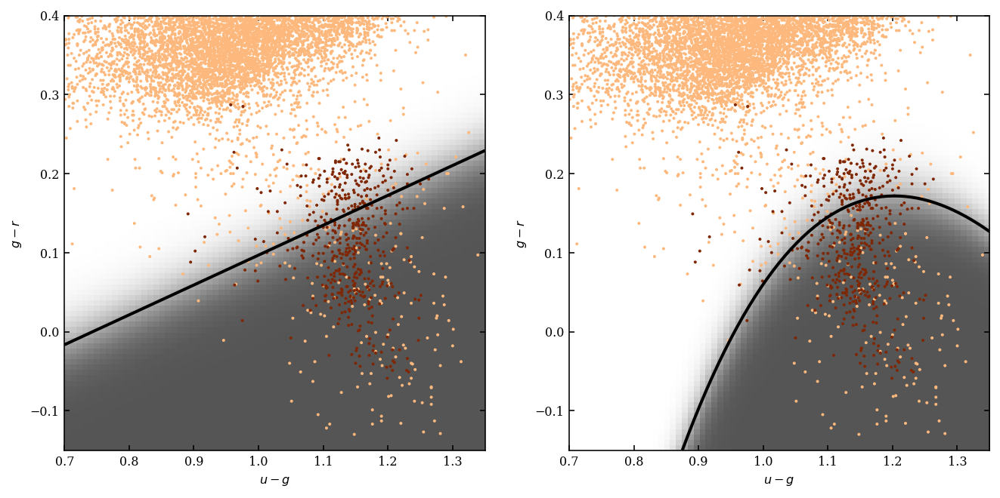

In [8]:
# Ivezic, Figures 9.4 and 9.5, spliced together by GTR

from astroML.datasets import fetch_rrlyrae_combined
from astroML.utils import split_samples
from astroML.utils import completeness_contamination

#----------------------------------------------------------------------
# get data and split into training & testing sets
X, y = fetch_rrlyrae_combined()
X = X[:, [1, 0, 2, 3]]  # rearrange columns for better 1-color results
(X_train, X_test), (y_train, y_test) = split_samples(X, y, [0.75, 0.25], 
                                                     random_state=0)

N_tot = len(y)
N_stars = np.sum(y == 0)
N_rrlyrae = N_tot - N_stars
N_train = len(y_train)
N_test = len(y_test)
N_plot = 5000 + N_rrlyrae

#----------------------------------------------------------------------
# perform LDA
lda = LDA()
lda.fit(X_train[:, :2], y_train)
y_predLDA = lda.predict(X_test[:, :2])

# perform QDA
qda = QDA()
qda.fit(X_train[:, :2], y_train)
y_predQDA = qda.predict(X_test[:, :2])
    
completenessLDA, contaminationLDA = completeness_contamination(y_predLDA, y_test)
completenessQDA, contaminationQDA = completeness_contamination(y_predQDA, y_test)

print("completeness", completenessLDA, completenessQDA)
print("contamination", contaminationLDA, contaminationQDA)

#------------------------------------------------------------
# Compute the decision boundary
xlim = (0.7, 1.35)
ylim = (-0.15, 0.4)

xx, yy = np.meshgrid(np.linspace(xlim[0], xlim[1], 71),
                     np.linspace(ylim[0], ylim[1], 81))

Z_LDA = lda.predict_proba(np.c_[yy.ravel(), xx.ravel()])
Z_LDA = Z_LDA[:, 1].reshape(xx.shape)
Z_QDA = qda.predict_proba(np.c_[yy.ravel(), xx.ravel()])
Z_QDA = Z_QDA[:, 1].reshape(xx.shape)

#----------------------------------------------------------------------
# plot the results
fig = plt.figure(figsize=(10, 5))
fig.subplots_adjust(bottom=0.15, top=0.95, hspace=0.0,
                    left=0.1, right=0.95, wspace=0.2)

# left plot: data and decision boundary
ax = fig.add_subplot(121)
im = ax.scatter(X[-N_plot:, 1], X[-N_plot:, 0], c=y[-N_plot:],
                s=4, lw=0, cmap=plt.cm.Oranges, zorder=2)
im.set_clim(-0.5, 1)

im = ax.imshow(Z_LDA, origin='lower', aspect='auto',
               cmap=plt.cm.binary, zorder=1,
               extent=xlim + ylim)
im.set_clim(0, 1.5)

ax.contour(xx, yy, Z_LDA, [0.5], linewidths=2., colors='k')

ax.set_xlim(xlim)
ax.set_ylim(ylim)

ax.set_xlabel('$u-g$')
ax.set_ylabel('$g-r$')

# right plot: qda
ax = fig.add_subplot(122)
im = ax.scatter(X[-N_plot:, 1], X[-N_plot:, 0], c=y[-N_plot:],
                s=4, lw=0, cmap=plt.cm.Oranges, zorder=2)
im.set_clim(-0.5, 1)

im = ax.imshow(Z_QDA, origin='lower', aspect='auto',
               cmap=plt.cm.binary, zorder=1,
               extent=xlim + ylim)
im.set_clim(0, 1.5)

ax.contour(xx, yy, Z_QDA, [0.5], linewidths=2., colors='k')

ax.set_xlim(xlim)
ax.set_ylim(ylim)

ax.set_xlabel('$u-g$')
ax.set_ylabel('$g-r$')

plt.show()

If it is obvious from looking at your data that a linear or quadratic boundary will work well, then great.  But what if that is not the case?

## GMM and Bayes Classification <a class="anchor" id="seven"></a>

Our classifications so far have made some restrictive assumptions. Either
- conditional independence, or 
- Gaussianity of the distributions.  

However, a more flexible model might improve the completeness and efficiency of the classification. For that we can look to the **density estimation techniques** from Chapter 6.

The natural extension of the Gaussian assumptions is to use GMM's (Gaussian Mixture Models) to determine the density distribution, i.e., a **GMM Bayes Classifier**. Note that the number of Gaussian components, $K$, must be chosen for each class, $k$, independently.

`astroML` implements GMM Bayes classification as:

In [9]:
from astroML.classification import GMMBayes
#from astroML.classification import GaussianMixture as GMMBayes

X = np.random.random((100,2))
y = (X[:,0] + X[:,1] > 1).astype(int)

gmmb = GMMBayes(3) # 3 clusters per class
gmmb.fit(X,y)

y_pred = gmmb.predict(X)

We now apply the GMM Bayes classifier to the real stellar data from above. ***With just one component, we get results that are similar to those from Naive Bayes. But with 5 components (and all 4 attributes), we do pretty well.***

@pickle_results: using precomputed results from 'GMMbayes_rrlyrae.pkl'
completeness [[0.48175182 0.68613139 0.73722628 0.78832117]
 [0.         0.         0.35036496 0.62043796]]
contamination [[0.85201794 0.79249448 0.77605322 0.75675676]
 [0.         0.         0.11111111 0.23423423]]


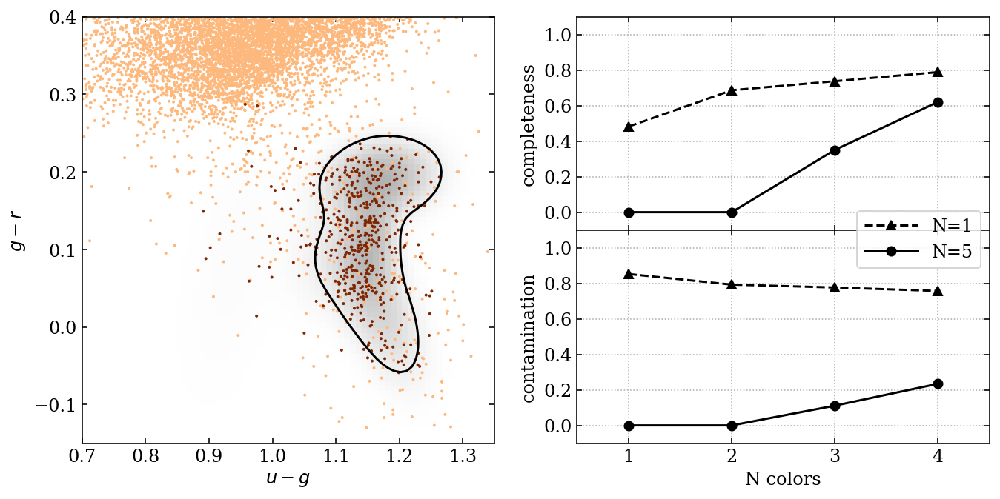

In [10]:
from astroML.classification import GMMBayes
from astroML.utils.decorators import pickle_results
from astroML.datasets import fetch_rrlyrae_combined
from astroML.utils import split_samples
from astroML.utils import completeness_contamination

# get data and split into training & testing sets
X, y = fetch_rrlyrae_combined()
X = X[:, [1, 0, 2, 3]]  # rearrange columns for better 1-color results

# GMM-bayes takes several minutes to run, and is order[N^2]
#  truncating the dataset can be useful for experimentation.
#X = X[::10]
#y = y[::10]

(X_train, X_test), (y_train, y_test) = split_samples(X, y, [0.75, 0.25],
                                                     random_state=0)
N_tot = len(y)
N_st = np.sum(y == 0)
N_rr = N_tot - N_st
N_train = len(y_train)
N_test = len(y_test)
N_plot = 5000 + N_rr

#----------------------------------------------------------------------
# perform GMM Bayes
Ncolors = np.arange(1, X.shape[1] + 1)
Ncomp = [1, 5]


@pickle_results('GMMbayes_rrlyrae.pkl')
def compute_GMMbayes(Ncolors, Ncomp):
    classifiers = []
    predictions = []

    for ncm in Ncomp:
        classifiers.append([])
        predictions.append([])
        for nc in Ncolors:
            clf = GMMBayes(ncm, tol=1E-5, covariance_type='full')
            clf.fit(X_train[:, :nc], y_train)
            y_pred = clf.predict(X_test[:, :nc])

            classifiers[-1].append(clf)
            predictions[-1].append(y_pred)

    return classifiers, predictions

classifiers, predictions = compute_GMMbayes(Ncolors, Ncomp)

completeness, contamination = completeness_contamination(predictions, y_test)

print("completeness", completeness)
print("contamination", contamination)

#------------------------------------------------------------
# Compute the decision boundary
clf = classifiers[1][1]
xlim = (0.7, 1.35)
ylim = (-0.15, 0.4)

xx, yy = np.meshgrid(np.linspace(xlim[0], xlim[1], 71),
                     np.linspace(ylim[0], ylim[1], 81))

Z = clf.predict_proba(np.c_[yy.ravel(), xx.ravel()])
Z = Z[:, 1].reshape(xx.shape)

#----------------------------------------------------------------------
# plot the results
fig = plt.figure(figsize=(10, 5))
fig.subplots_adjust(bottom=0.15, top=0.95, hspace=0.0,
                    left=0.1, right=0.95, wspace=0.2)

# left plot: data and decision boundary
ax = fig.add_subplot(121)
im = ax.scatter(X[-N_plot:, 1], X[-N_plot:, 0], c=y[-N_plot:],
                s=4, lw=0, cmap=plt.cm.Oranges, zorder=2)
im.set_clim(-0.5, 1)

im = ax.imshow(Z, origin='lower', aspect='auto',
               cmap=plt.cm.binary, zorder=1,
               extent=xlim + ylim)
im.set_clim(0, 1.5)

ax.contour(xx, yy, Z, [0.1], colors='k')

ax.set_xlim(xlim)
ax.set_ylim(ylim)

ax.set_xlabel('$u-g$')
ax.set_ylabel('$g-r$')

# plot completeness vs Ncolors
ax = fig.add_subplot(222)
ax.plot(Ncolors, completeness[0], '^--k', ms=6, label='N=%i' % Ncomp[0])
ax.plot(Ncolors, completeness[1], 'o-k', ms=6, label='N=%i' % Ncomp[1])

ax.xaxis.set_major_locator(plt.MultipleLocator(1))
ax.yaxis.set_major_locator(plt.MultipleLocator(0.2))
ax.xaxis.set_major_formatter(plt.NullFormatter())

ax.set_ylabel('completeness')
ax.set_xlim(0.5, 4.5)
ax.set_ylim(-0.1, 1.1)
ax.grid(True)

# plot contamination vs Ncolors
ax = fig.add_subplot(224)
ax.plot(Ncolors, contamination[0], '^--k', ms=6, label='N=%i' % Ncomp[0])
ax.plot(Ncolors, contamination[1], 'o-k', ms=6, label='N=%i' % Ncomp[1])
ax.legend(loc='lower right',
          bbox_to_anchor=(1.0, 0.78))

ax.xaxis.set_major_locator(plt.MultipleLocator(1))
ax.yaxis.set_major_locator(plt.MultipleLocator(0.2))
ax.xaxis.set_major_formatter(plt.FormatStrFormatter('%i'))

ax.set_xlabel('N colors')
ax.set_ylabel('contamination')
ax.set_xlim(0.5, 4.5)
ax.set_ylim(-0.1, 1.1)
ax.grid(True)

plt.show()

**NOTE:** We can take this to the extreme by having one mixture component at each training point. We also don't have to restrict ourselves to a Gaussian kernel, we can use any kernel that we like. The resulting ***non-parametric*** Bayes classifier is referred to as **Kernel Discriminant Analysis (KDA)**. 

It seems like this would be a *lot* more computationally intensive, but now we don't have to optimize the locations of the components...we just need to determine the bandwidth of the kernel. In the end, it can result in better classification.

One of the tricks to speed things up is that we don't need to know the actually class probability, we just need to know which is larger.  This is explained in more detail in [Riegel, Gray, & Richards 2008](http://epubs.siam.org/doi/abs/10.1137/1.9781611972788.19), and it is implemented in a series of papers starting with [Richards et al. 2004](http://adsabs.harvard.edu/abs/2004ApJS..155..257R).  

## K-Nearest Neighbor Classifier <a class="anchor" id="eight"></a>

If we did KDA with a variable bandwidth that depended only on the distance of the nearest neighbor, then we'd have what we call a **Nearest-Neighbor** classifier. Here if $x$ is close to $x'$, then $p(y|x) \approx p(y|x')$, i.e. **we use the class label of the nearest point**. Note that we have not assumed anything about the conditional density distribution, so it is completely non-parametric.

The number of neighbors, $K$, regulates the complexity of the classification, where a larger $K$ decreases the variance in the classification but leads to an increase in the bias. In the simplest form, a majority rule classification is adopted, where each of the $K$ neighbors votes on the classification (N.B., the 3rd different use of $K$ or $k$ in this notebook!)

The distance measure is usually N-dimensional Euclidean. However, if the attributes have very different properties, then normalization, weighting, etc. may be needed.


The KNN classifier is a **non-parametric**, instance-based learning algorithm. KNN actually doesn’t involve a traditional training phase. Instead, it simply stores the training data in memory. Given a new test point, the algorithm:

- Computes the distance between the test point and all the training points (most commonly using Euclidean distance, though others like Manhattan or Minkowski are also possible). For two feature vectors $x=(x_1,x_2,…,x_n)$ and $x'=(x_1',x_2',…,x_n')$:

$$d(x,x')=\sum_{i=1}^n (x_i−x_i')^2$$

Selects the K nearest neighbors (the K samples in the training data that have the smallest distance to the test point) and counts the votes from these K neighborsach neighbor votes for its class, and the majority vote (the most frequent class) is assigned to the test point.



- **K is a hyperparameter**: small K can lead to overfitting (sensitive to noise), while large K can lead to underfitting (too smooth, less sensitive).
- **No explicit training phase** (lazy learning)
- Scales poorly with large datasets (every prediction requires distance calculation to all training points).
- **Feature scaling is critical** (distances can be dominated by features with large scales).


Scikit-learn implements **[`K-Nearest Neighbors`](http://scikit-learn.org/stable/modules/generated/sklearn.neighbors.KNeighborsClassifier.html) classification** as

In [11]:
from sklearn.neighbors import KNeighborsClassifier

X = np.random.random((100,2))
y = (X[:,0] + X[:,1] > 1).astype(int)

knc = KNeighborsClassifier(5) # use 5 nearest neighbors
knc.fit(X,y)

y_pred = knc.predict(X)

Implementing it for the same example as above shows that it isn't all that great for this particular case.  See below.  We probably need more training data to reduce the variance for it to work better.

completeness [[0.1459854  0.3649635  0.46715328 0.54014599]
 [0.00729927 0.24087591 0.37956204 0.54744526]]
contamination [[0.82758621 0.52830189 0.44347826 0.41732283]
 [0.88888889 0.44067797 0.23529412 0.25      ]]


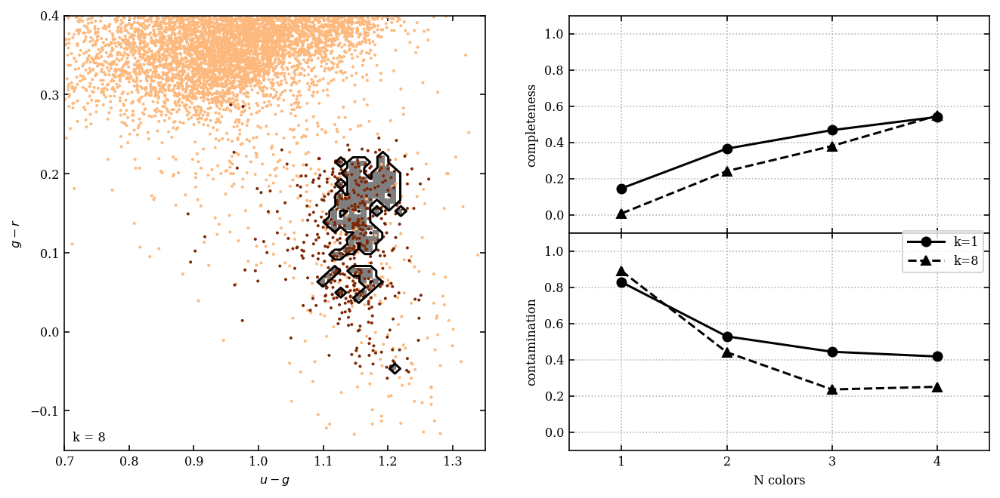

In [12]:
from sklearn.neighbors import KNeighborsClassifier
from astroML.datasets import fetch_rrlyrae_combined
from astroML.utils import split_samples
from astroML.utils import completeness_contamination

# get data and split into training & testing sets
X, y = fetch_rrlyrae_combined()
X = X[:, [1, 0, 2, 3]]  # rearrange columns for better 1-color results
(X_train, X_test), (y_train, y_test) = split_samples(X, y, [0.75, 0.25],
                                                     random_state=0)

N_tot = len(y)
N_st = np.sum(y == 0)
N_rr = N_tot - N_st
N_train = len(y_train)
N_test = len(y_test)
N_plot = 5000 + N_rr

#----------------------------------------------------------------------
# perform Classification

classifiers = []
predictions = []
Ncolors = np.arange(1, X.shape[1] + 1)
kvals = [1, 8]

for k in kvals:
    classifiers.append([])
    predictions.append([])
    for nc in Ncolors:
        clf = KNeighborsClassifier(n_neighbors=k)
        clf.fit(X_train[:, :nc], y_train)
        y_pred = clf.predict(X_test[:, :nc])

        classifiers[-1].append(clf)
        predictions[-1].append(y_pred)

completeness, contamination = completeness_contamination(predictions, y_test)

print("completeness", completeness)
print("contamination", contamination)

#------------------------------------------------------------
# Compute the decision boundary
clf = classifiers[1][1]
xlim = (0.7, 1.35)
ylim = (-0.15, 0.4)

xx, yy = np.meshgrid(np.linspace(xlim[0], xlim[1], 71),
                     np.linspace(ylim[0], ylim[1], 81))

Z = clf.predict(np.c_[yy.ravel(), xx.ravel()])
Z = Z.reshape(xx.shape)

#----------------------------------------------------------------------
# plot the results
fig = plt.figure(figsize=(10, 5))
fig.subplots_adjust(bottom=0.15, top=0.95, hspace=0.0,
                    left=0.1, right=0.95, wspace=0.2)

# left plot: data and decision boundary
ax = fig.add_subplot(121)
im = ax.scatter(X[-N_plot:, 1], X[-N_plot:, 0], c=y[-N_plot:],
                s=4, lw=0, cmap=plt.cm.Oranges, zorder=2)
im.set_clim(-0.5, 1)

im = ax.imshow(Z, origin='lower', aspect='auto',
               cmap=plt.cm.binary, zorder=1,
               extent=xlim + ylim)
im.set_clim(0, 2)

ax.contour(xx, yy, Z, [0.1], colors='k')

ax.set_xlim(xlim)
ax.set_ylim(ylim)

ax.set_xlabel('$u-g$')
ax.set_ylabel('$g-r$')

ax.text(0.02, 0.02, "k = %i" % kvals[1],
        transform=ax.transAxes)

# plot completeness vs Ncolors
ax = fig.add_subplot(222)

ax.plot(Ncolors, completeness[0], 'o-k', ms=6, label='k=%i' % kvals[0])
ax.plot(Ncolors, completeness[1], '^--k', ms=6, label='k=%i' % kvals[1])

ax.xaxis.set_major_locator(plt.MultipleLocator(1))
ax.yaxis.set_major_locator(plt.MultipleLocator(0.2))
ax.xaxis.set_major_formatter(plt.NullFormatter())

ax.set_ylabel('completeness')
ax.set_xlim(0.5, 4.5)
ax.set_ylim(-0.1, 1.1)
ax.grid(True)

# plot contamination vs Ncolors
ax = fig.add_subplot(224)
ax.plot(Ncolors, contamination[0], 'o-k', ms=6, label='k=%i' % kvals[0])
ax.plot(Ncolors, contamination[1], '^--k', ms=6, label='k=%i' % kvals[1])
ax.legend(loc='lower right',
          bbox_to_anchor=(1.0, 0.79))

ax.xaxis.set_major_locator(plt.MultipleLocator(1))
ax.yaxis.set_major_locator(plt.MultipleLocator(0.2))
ax.xaxis.set_major_formatter(plt.FormatStrFormatter('%i'))
ax.set_xlabel('N colors')
ax.set_ylabel('contamination')
ax.set_xlim(0.5, 4.5)
ax.set_ylim(-0.1, 1.1)
ax.grid(True)

plt.show()

$K=1$ is clearly terrible, but even $K=8$ is not that great. **Question**: how do we pick $K$?

Regardless of whether this is the best algorithm or not, we can choose $K$ to minimize the classification error rate by using cross-validation. See below for how this is computed (may take a few minutes to run).

In [13]:
from sklearn.neighbors import KNeighborsClassifier
from astroML.datasets import fetch_rrlyrae_combined
from astroML.utils import completeness_contamination

from sklearn.model_selection import cross_val_predict
from sklearn.metrics import accuracy_score

#----------------------------------------------------------------------
# get data and split into training & testing sets
X, y = fetch_rrlyrae_combined()
X = X[:, [1, 0, 2, 3]]  # rearrange columns for better 1-color results

#----------------------------------------------------------------------
# perform Classification
scores = []
kvals = np.arange(1,20)
for k in kvals:
    clf = KNeighborsClassifier(n_neighbors=k)
    CVpredk = cross_val_predict(clf, X, y)
    scores.append(accuracy_score(y, CVpredk)) 

max score is for k=8


Text(0, 0.5, 'Classification accuracy')

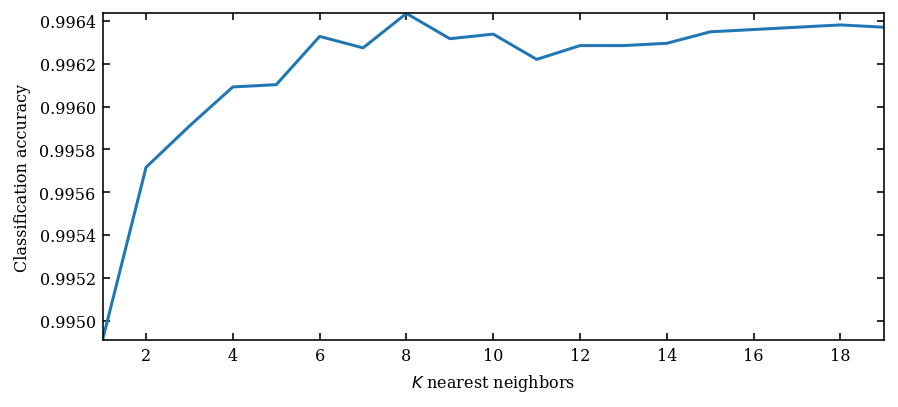

In [14]:
print("max score is for k={:d}".format(kvals[np.argmax(scores)]))

# Plot number of neighbors vs score
fig = plt.figure(figsize=(7, 3))
u = np.arange(len(scores))+1
plt.plot(u,scores)
plt.xlabel('$K$ nearest neighbors')
plt.ylabel('Classification accuracy')

Ah, that's where $K=8$ came from. 

We can also use the [`metrics` module](http://scikit-learn.org/stable/modules/classes.html#module-sklearn.metrics) in sklearn to compute some statistics for us. Remember the definitions of **precision** and **recall** from above.

In [15]:
from sklearn import metrics 

#print(k, nc)
print("accuracy:", metrics.accuracy_score(y_test, y_pred))
print("precision:", metrics.precision_score(y_test, y_pred))
print("recall:", metrics.recall_score(y_test, y_pred))

accuracy: 0.9962638495233187
precision: 0.75
recall: 0.5474452554744526


# Classification: II


### Before we start...

Please start downloading [this file](https://github.com/dgerosa/pdetclassifier/releases/download/v0.2/sample_2e7_design_precessing_higherordermodes_3detectors.h5). We need it for the coding assignment today and might take a while... 

## Discriminative Classification <a class="anchor" id="one"></a>

Last time we talked about how to perform classification by mapping the full pdf of the data's feature space, and probabilistically ranking the population that a new sample would belong to. This was **generative classification**, because we we estimating a generative model of the data. 

This time we will concentrate on methods that seek only to determine the **decision boundary** in feature space, so called [**discriminative classification**](https://en.wikipedia.org/wiki/Discriminative_model) methods.

As before, let's say that you have 2 blobs of data as shown below. In many cases, you might say "just draw a line between those two blobs that are well separated". So let's do exactly that in the example below. There are clearly lots of different lines that you could draw that would work.  So, how do you do this *optimally*?  And what if the blobs are not perfectly well separated?

<!-- ![Ivezic, Figure 9.9](figures/svm_lines.png) -->

In [16]:
from matplotlib import pyplot as plt
%matplotlib inline
%config InlineBackend.figure_format='retina'

import warnings
warnings.filterwarnings("ignore")

(-1.0, 3.5)

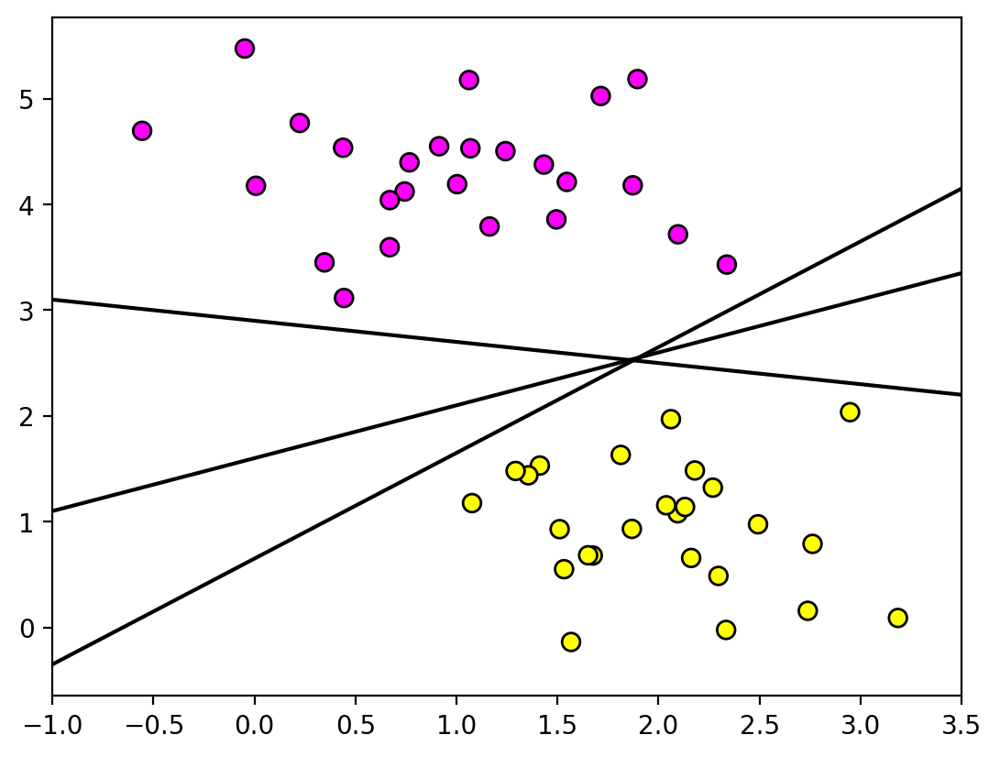

In [17]:
# Source: https://github.com/jakevdp/ESAC-stats-2014/blob/master/notebooks/04.1-Classification-SVMs.ipynb
import numpy as np
from scipy import stats
from sklearn.datasets import make_blobs

X, y = make_blobs(n_samples=50, centers=2,
                  random_state=0, cluster_std=0.60)
plt.scatter(X[:, 0], X[:, 1], c=y, s=50, cmap='spring' ,edgecolor='k');

Xgrid = np.linspace(-1, 3.5)
for m, b in [(1, 0.65), (0.5, 1.6), (-0.2, 2.9)]:
    plt.plot(Xgrid, m * Xgrid + b, '-k')
    
plt.xlim(-1, 3.5)

## Logistic Regression <a class="anchor" id="two"></a>

In [Logistic Regression](https://www.wikiwand.com/en/Logistic_regression) we use a model that is almost identical to how we did LDA. For two-class classification with $y=\{0,1\}$ we use the [logistic function](https://www.wikiwand.com/en/Logistic_function) to write

$$ p(y=1|x) = \frac{\exp\left[\sum_j\theta_jx^j \right]}{1 + \exp\left[\sum_j\theta_jx^j \right]}, $$

where the sum is over data features, and for the $i$-th sample we define

$$ \ln\left(\frac{p_i}{1-p_i} \right) = \sum_j\theta_jx^j_i. $$

- In **LDA** we modeled the pdfs of each class as having identical multivariate Gaussian covariance functions in feature-space. We used the model: 
$$ 
\begin{align}
        \ln\left( \frac{p(y=1|x)}{p(y=0|x)} \right) &= -\frac{1}{2}(\mu_0+\mu_1)^T\Sigma^{-1}(\mu_0-\mu_1) + \ln\frac{p(y=0)}{p(y=1)} + x^T\Sigma^{-1}(\mu_1-\mu_0) \\
        &= \alpha_0 + \alpha^T x,
\end{align}
$$
which is clearly linear in the data.


- In **Logistic Regression**, the model is by assumption

$$ \ln\left( \frac{p(y=1|x)}{p(y=0|x)} \right) = \beta_0 + \beta^T x $$


***The only difference between LDA and Logstic Regression is how the regression coefficients are estimated. In LDA they are chosen to minimize density estimation error, whereas in Logistic Regression they are chosen to minimize classifcation error.***

Let's see how Logistic Regression performs on our classification of non-variable stars versus RR Lyrae.

completeness [0.98540146 1.         1.         1.        ]
contamination [0.88588335 0.84180139 0.84088269 0.84014002]


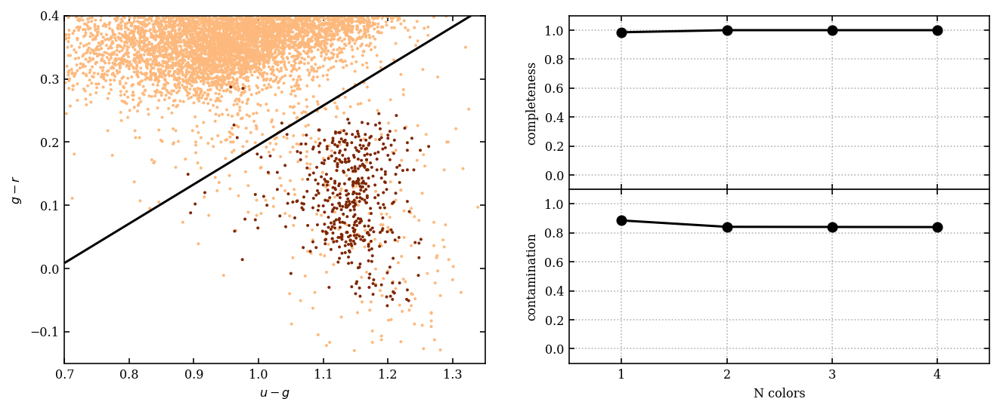

In [39]:
from matplotlib import colors

from sklearn.linear_model import LogisticRegression
from astroML.datasets import fetch_rrlyrae_combined
from astroML.utils import split_samples
from astroML.utils import completeness_contamination

# get data and split into training & testing sets
Xnew, ynew = fetch_rrlyrae_combined()
Xnew = Xnew[:, [1, 0, 2, 3]]  # rearrange columns for better 1-color results
(X_train, X_test), (y_train, y_test) = split_samples(Xnew, ynew, [0.75, 0.25],
                                                     random_state=0)

N_tot = len(ynew)
N_st = np.sum(ynew == 0)
N_rr = N_tot - N_st
N_train = len(y_train)
N_test = len(y_test)
N_plot = 5000 + N_rr

#----------------------------------------------------------------------
# perform Classification
classifiers = []
predictions = []
Ncolors = np.arange(1, Xnew.shape[1] + 1)

for nc in Ncolors:
    clf = LogisticRegression(class_weight='balanced')
    clf.fit(X_train[:, :nc], y_train)
    y_pred = clf.predict(X_test[:, :nc])

    classifiers.append(clf)
    predictions.append(y_pred)

completeness, contamination = completeness_contamination(predictions, y_test)

print("completeness", completeness)
print("contamination", contamination)

#------------------------------------------------------------
# Compute the decision boundary
clf = classifiers[1]
xlim = (0.7, 1.35)
ylim = (-0.15, 0.4)

xx, yy = np.meshgrid(np.linspace(xlim[0], xlim[1], 71),
                     np.linspace(ylim[0], ylim[1], 81))

Z = clf.predict_proba(np.c_[yy.ravel(), xx.ravel()])[:, 1]
Z = Z.reshape(xx.shape)

#----------------------------------------------------------------------
# plot the results
fig = plt.figure(figsize=(10, 4))
fig.subplots_adjust(bottom=0.15, top=0.95, hspace=0.0,
                    left=0.1, right=0.95, wspace=0.2)

# left plot: data and decision boundary
ax = fig.add_subplot(121)
im = ax.scatter(Xnew[-N_plot:, 1], Xnew[-N_plot:, 0], c=ynew[-N_plot:],
                s=4, lw=0, cmap=plt.cm.Oranges, zorder=2)
im.set_clim(-0.5, 1)

ax.contour(xx, yy, Z, [0.5], colors='k')

ax.set_xlim(xlim)
ax.set_ylim(ylim)

ax.set_xlabel('$u-g$')
ax.set_ylabel('$g-r$')

# plot completeness vs Ncolors
ax = fig.add_subplot(222)

ax.plot(Ncolors, completeness, 'o-k', ms=6)

ax.xaxis.set_major_locator(plt.MultipleLocator(1))
ax.yaxis.set_major_locator(plt.MultipleLocator(0.2))
ax.xaxis.set_major_formatter(plt.NullFormatter())

ax.set_ylabel('completeness')
ax.set_xlim(0.5, 4.5)
ax.set_ylim(-0.1, 1.1)
ax.grid(True)

# plot contamination vs Ncolors
ax = fig.add_subplot(224)
ax.plot(Ncolors, contamination, 'o-k', ms=6)

ax.xaxis.set_major_locator(plt.MultipleLocator(1))
ax.yaxis.set_major_locator(plt.MultipleLocator(0.2))
ax.xaxis.set_major_formatter(plt.FormatStrFormatter('%i'))
ax.set_xlabel('N colors')
ax.set_ylabel('contamination')
ax.set_xlim(0.5, 4.5)
ax.set_ylim(-0.1, 1.1)
ax.grid(True)

plt.show()

## Support Vector Machines <a class="anchor" id="three"></a>

**[Support Vector Machines (SVM)](https://en.wikipedia.org/wiki/Support_vector_machine)** define a hyperplane (a plane in $N-1$ dimensions) that maximizes the distance of the closest point from each class. This distance is the "margin". It is the width of the "cylinder" or "street" that you can put between the closest points that just barely touches the points in each class. The points that touch the margin (or that are on the wrong side) are called **support vectors**.  Obvious, right? And not as obscure as the name may imply. 

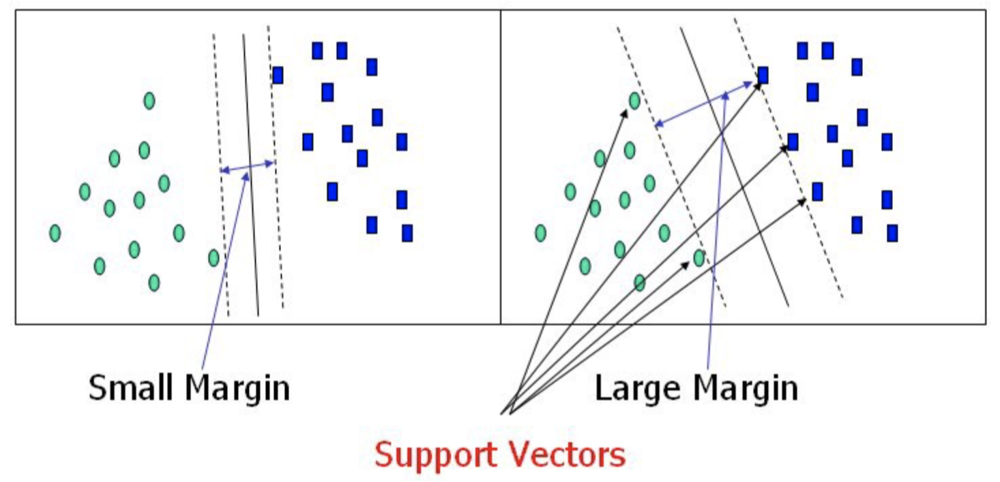

Image credit: [here](https://towardsdatascience.com/support-vector-machine-introduction-to-machine-learning-algorithms-934a444fca47)

There are lots of potential decision boundaries, but we want the one that maximize the distance of the support vectors from the decision hyperplane.

(-1.0, 3.5)

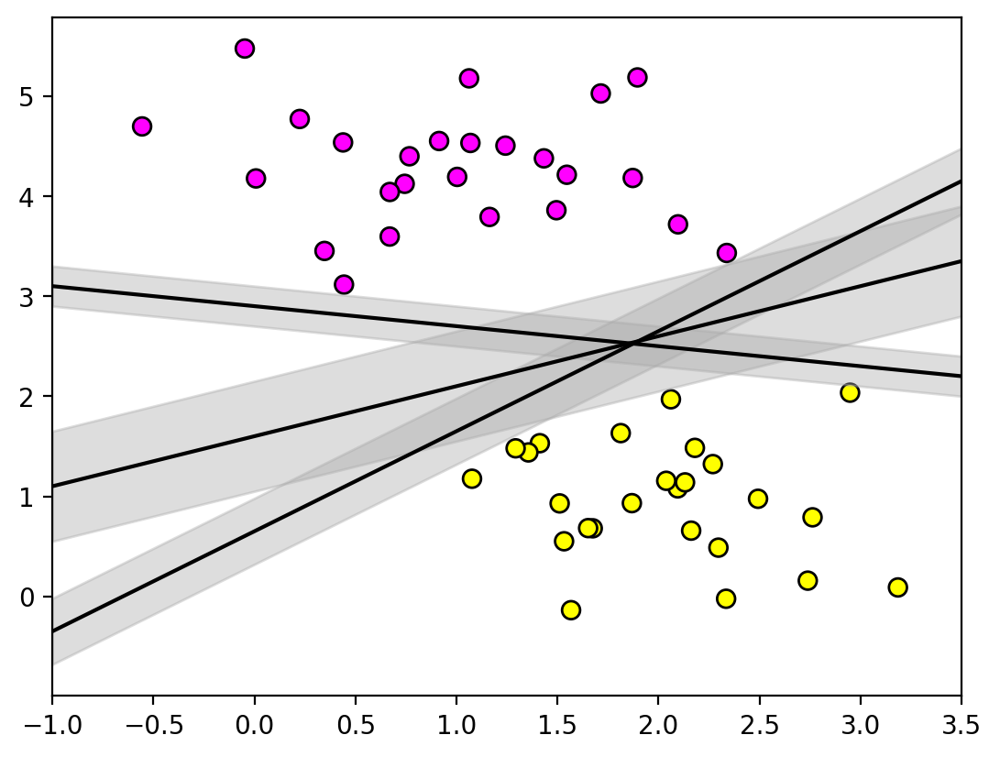

In [18]:
Xgrid = np.linspace(-1, 3.5)
plt.scatter(X[:, 0], X[:, 1], 
            c=y, s=50, cmap='spring', 
            edgecolor='k')

for m, b, d in [(1, 0.65, 0.33), (0.5, 1.6, 0.55), (-0.2, 2.9, 0.2)]:
    yfit = m * Xgrid+ b
    plt.plot(Xgrid, yfit, '-k')
    plt.fill_between(Xgrid, yfit - d, yfit + d, 
                     edgecolor='None', 
                     color='#AAAAAA', alpha=0.4)

plt.xlim(-1, 3.5)

Here's the math for determining the decision boundary. To make life easier, we'll assume that the classes are separable by a straight line and that the decision boundary is at 0, with the two edges at $-1$ and $1$, and define $y \in \{-1,1\}$.

**The hyperplane that maximizes the margin** is given by finding

$$ 
\begin{equation}
\max_{\beta_0,\beta}(m) \;\;\;
  \mbox{subject to} \;\;\; \frac{1}{||\beta||} y_i ( \beta_0 + \beta^T x_i )
  \geq m \,\,\, \forall \, i.
\end{equation}
$$

where $||\beta|| = \sqrt{\sum \beta^2}$. 

The constraints can be written as $y_i ( \beta_0 + \beta^T x_i ) \geq m ||\beta|| $. Thus the optimization problem is equivalent to minimizing

$$
\begin{equation}
\frac{1}{2} ||\beta|| \;\;\; \mbox{subject to} \;\;\; y_i
  ( \beta_0 + \beta^T x_i ) \geq 1 \,\,\, \forall \, i.
\end{equation}
$$

We'll skip over the mathematical details, but you can read about them in detail in Ivezic $\S$ 9.6 or in Karen Leighly's [classification lecture notes](http://seminar.ouml.org/lectures/classification/).

For realistic data sets where the decision boundary is not obvious, we relax the assumption that the classes are linearly separable. This changes the minimization condition and puts bounds on the number of misclassifications (which we would obviously like to minimize).

Using Scikit-Learn's agorithm, let's fit a Support Vector Machine Classifier to these points.

The Scikit-Learn implementation of SVM classification is [`SVC`](http://scikit-learn.org/stable/modules/generated/sklearn.svm.SVC.html#sklearn.svm.SVC) which looks like:

In [19]:
from sklearn.svm import SVC

svm = SVC(kernel='linear', C=1.0) # will explain 'C' below
svm.fit(X,y)

SVC(kernel='linear')

In order to better visualize what SVM is doing, let's create a convenience function that will plot the decision boundaries:

In [20]:
def plot_svc_decision_function(clf, ax=None):
    """Plot the decision function for a 2D SVC"""
    if ax is None:
        ax = plt.gca()
    u = np.linspace(plt.xlim()[0], plt.xlim()[1], 30)
    v = np.linspace(plt.ylim()[0], plt.ylim()[1], 30)
    yy, xx = np.meshgrid(v, u)

    P = np.zeros_like(xx)
    for i, ui in enumerate(u):
        for j, vj in enumerate(v):
            Xgrid = np.array([ui, vj])
            P[i, j] = clf.decision_function(Xgrid.reshape(1,-1))
    return ax.contour(xx, yy, P, colors='k',
                      levels=[-1, 0, 1], alpha=0.5,
                      linestyles=['--', '-', '--'])

Now let's plot the decision boundary and the support vectors, which are stored in the `support_vectors_` attribute of the classifier.

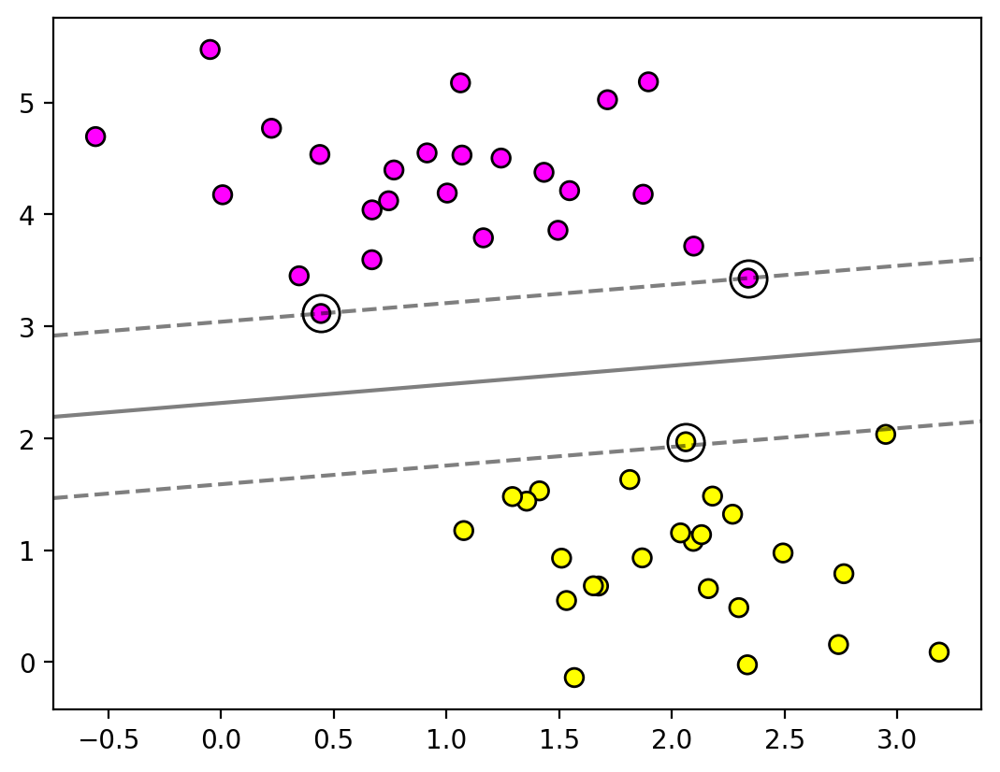

In [21]:
plt.scatter(svm.support_vectors_[:, 0], svm.support_vectors_[:, 1], 
            s=200, edgecolor='k', facecolor='w'); #Add support vectors
plt.scatter(X[:, 0], X[:, 1], c=y, s=50, 
            cmap='spring', edgecolor='k')
plot_svc_decision_function(svm)

plt.show()

Let's look at what happens for data that have some overlap between the classes. 

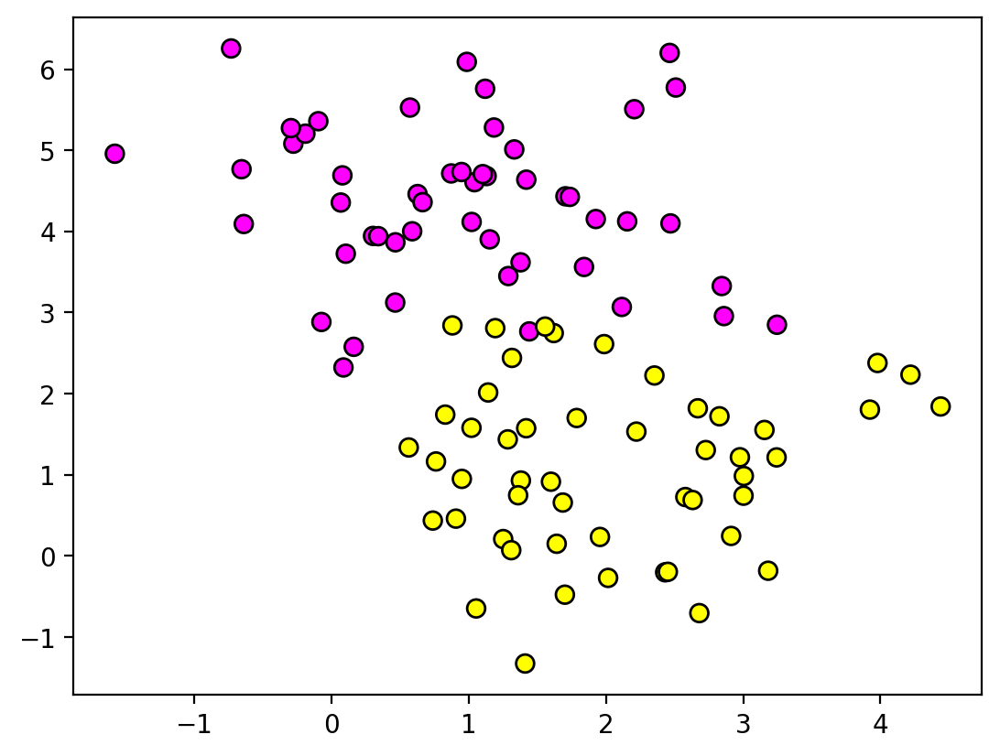

In [22]:
# Source: https://github.com/jakevdp/ESAC-stats-2014/blob/master/notebooks/04.1-Classification-SVMs.ipynb
X, y = make_blobs(n_samples=100, centers=2,
                  random_state=0, cluster_std=1.0)
plt.scatter(X[:, 0], X[:, 1], c=y, s=50, 
            cmap='spring' ,edgecolor='k');

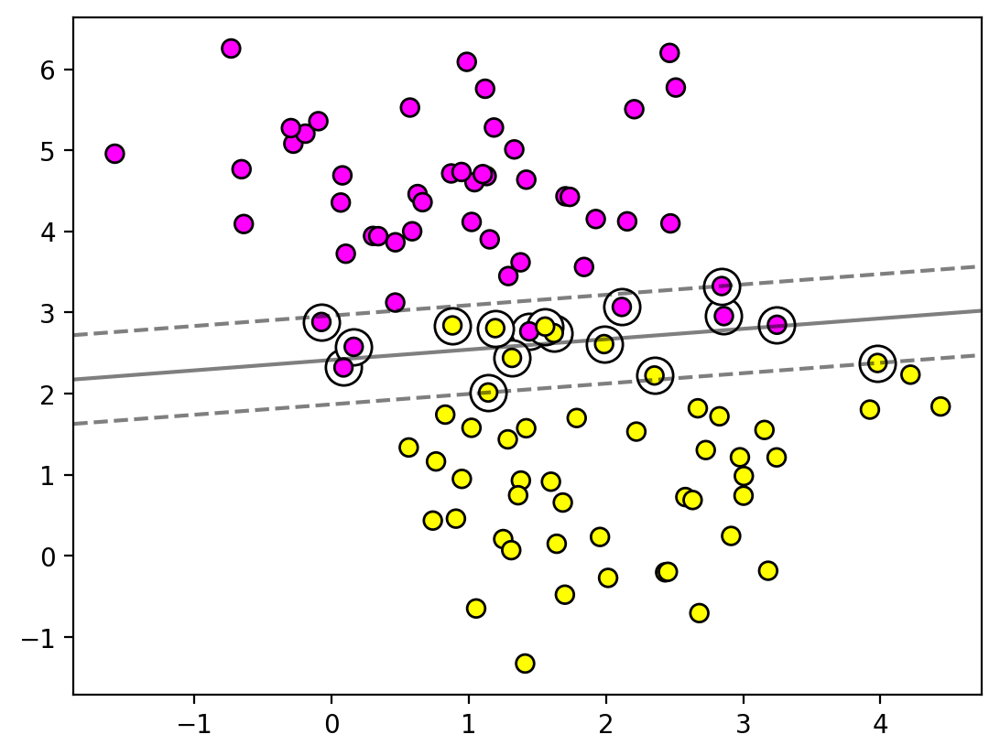

In [23]:
svm.fit(X,y)

plt.scatter(svm.support_vectors_[:, 0], svm.support_vectors_[:, 1], 
            s=200, edgecolor='k', facecolor='w'); #Add support vectors
plt.scatter(X[:, 0], X[:, 1], c=y, s=50, 
            cmap='spring', edgecolor='k')
plot_svc_decision_function(svm)

Our example above included a parameter, $C$, which I didn't explain. According to the [SVC documentation](https://scikit-learn.org/stable/modules/generated/sklearn.svm.SVC.html?highlight=svc#sklearn.svm.SVC), 

> $C$ is a "*regularization parameter. The strength of the regularization is inversely proportional to C. Must be strictly positive. The penalty is a squared L2 penalty.*"

Thus this is the **inverse** of the $\alpha$ regularization parameter we saw in our regression lectures. Let's see what happens when we change it.  Fit these data with `C=100` (less regularization) and `C=0.01` (more regularization).

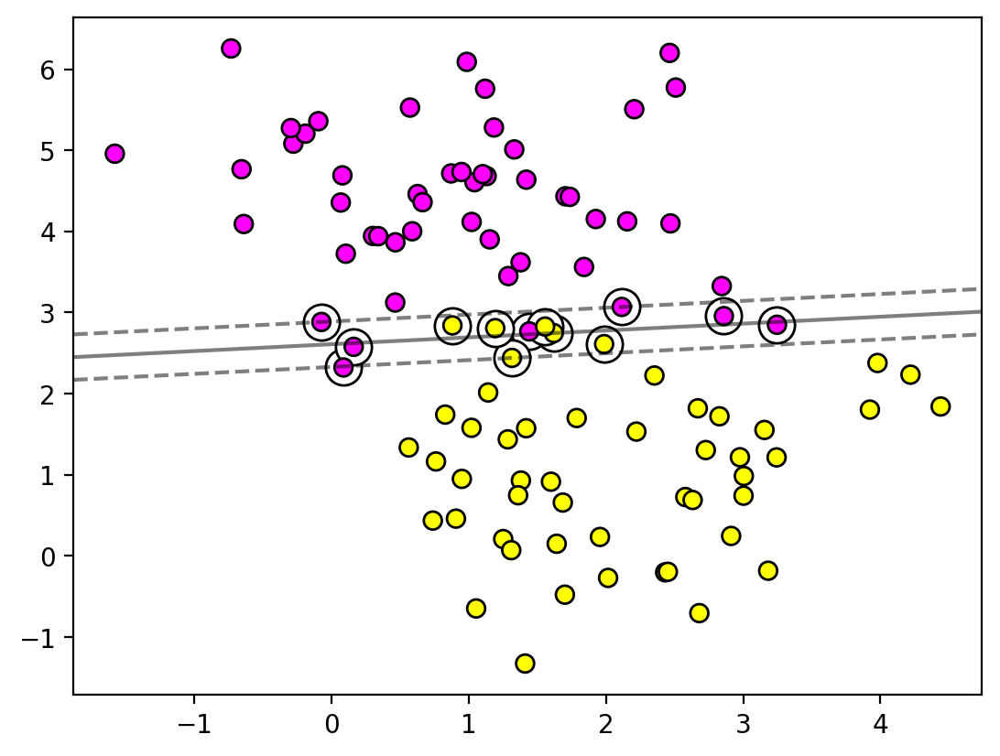

In [24]:
svm = SVC(kernel='linear', C=100)
svm.fit(X,y)

plt.scatter(svm.support_vectors_[:, 0], 
            svm.support_vectors_[:, 1], 
            s=200, edgecolor='k', facecolor='w');
plt.scatter(X[:, 0], X[:, 1], c=y, s=50, 
            cmap='spring', edgecolor='k')
plot_svc_decision_function(svm)

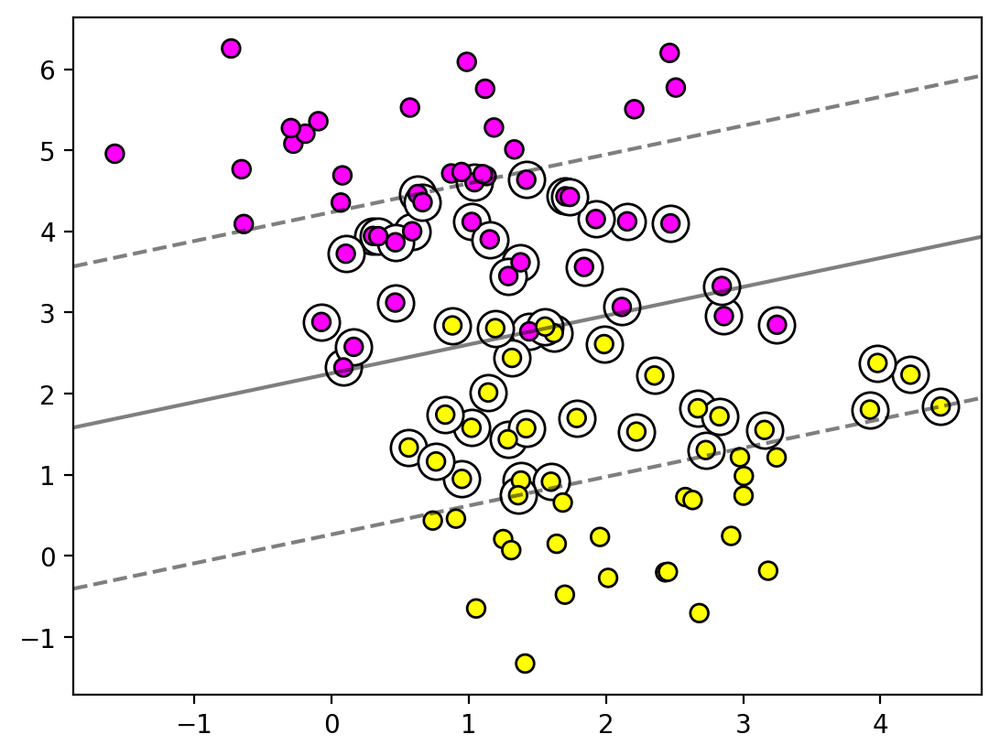

In [25]:
svm = SVC(kernel='linear', C=0.01)
svm.fit(X,y)

plt.scatter(svm.support_vectors_[:, 0], 
            svm.support_vectors_[:, 1], 
            s=200, edgecolor='k', facecolor='w');
plt.scatter(X[:, 0], X[:, 1], c=y, s=50, 
            cmap='spring', edgecolor='k')
plot_svc_decision_function(svm)

- We see that **$C$ controls the number of "margin violations"** that are allowed, and the width of the "street" that runs between the data (i.e., the number of support vectors).

- Note that **SVM *only* depends on the support vectors**. You can get rid of the rest of the data. Smaller $C$ causes there to be more support vectors, while larger $C$ gives fewer.

Try SVM classification on our star sample:

@pickle_results: computing results and saving to 'SVM_rrlyrae.pkl'
completeness [0.99270073 1.         1.         1.        ]
contamination [0.90014684 0.85347594 0.85347594 0.85471898]


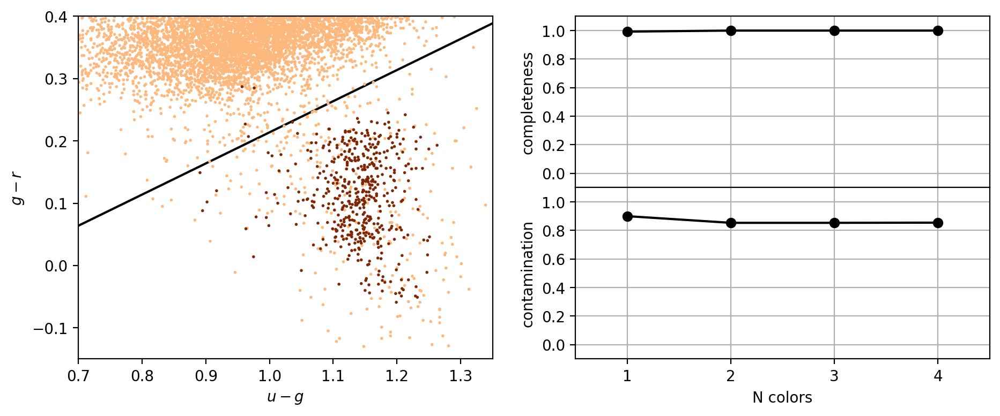

In [26]:
from sklearn.svm import SVC
from astroML.utils.decorators import pickle_results
from astroML.datasets import fetch_rrlyrae_combined
from astroML.utils import split_samples
from astroML.utils import completeness_contamination
from matplotlib import colors

# get data and split into training & testing sets
X, y = fetch_rrlyrae_combined()
X = X[:, [1, 0, 2, 3]]  # rearrange columns for better 1-color results

# SVM takes several minutes to run, and is order[N^2]
#  truncating the dataset can be useful for experimentation.
#X = X[::5]
#y = y[::5]

(X_train, X_test), (y_train, y_test) = split_samples(X, y, [0.75, 0.25],
                                                     random_state=0)

N_tot = len(y)
N_st = np.sum(y == 0)
N_rr = N_tot - N_st
N_train = len(y_train)
N_test = len(y_test)
N_plot = 5000 + N_rr

#----------------------------------------------------------------------
# Fit SVM
Ncolors = np.arange(1, X.shape[1] + 1)


@pickle_results('SVM_rrlyrae.pkl')
def compute_SVM(Ncolors):
    classifiers = []
    predictions = []

    for nc in Ncolors:
        # perform support vector classification
        clf = SVC(kernel='linear', class_weight='balanced')
        clf.fit(X_train[:, :nc], y_train)
        y_pred = clf.predict(X_test[:, :nc])

        classifiers.append(clf)
        predictions.append(y_pred)

    return classifiers, predictions

classifiers, predictions = compute_SVM(Ncolors)

completeness, contamination = completeness_contamination(predictions, y_test)

print("completeness", completeness)
print("contamination", contamination)

#------------------------------------------------------------
# compute the decision boundary
clf = classifiers[1]
w = clf.coef_[0]
a = -w[0] / w[1]
yy = np.linspace(-0.1, 0.4)
xx = a * yy - clf.intercept_[0] / w[1]

#----------------------------------------------------------------------
# plot the results
fig = plt.figure(figsize=(10, 4))
fig.subplots_adjust(bottom=0.15, top=0.95, hspace=0.0,
                    left=0.1, right=0.95, wspace=0.2)

# left plot: data and decision boundary
ax = fig.add_subplot(121)
ax.plot(xx, yy, '-k')
im = ax.scatter(X[-N_plot:, 1], X[-N_plot:, 0], c=y[-N_plot:],
                s=4, lw=0, cmap=plt.cm.Oranges, zorder=2)
im.set_clim(-0.5, 1)

ax.set_xlim(0.7, 1.35)
ax.set_ylim(-0.15, 0.4)

ax.set_xlabel('$u-g$')
ax.set_ylabel('$g-r$')

# plot completeness vs Ncolors
ax = fig.add_subplot(222)
ax.plot(Ncolors, completeness, 'o-k', ms=6)

ax.xaxis.set_major_locator(plt.MultipleLocator(1))
ax.yaxis.set_major_locator(plt.MultipleLocator(0.2))
ax.xaxis.set_major_formatter(plt.NullFormatter())

ax.set_ylabel('completeness')
ax.set_xlim(0.5, 4.5)
ax.set_ylim(-0.1, 1.1)
ax.grid(True)

# plot contamination vs Ncolors
ax = fig.add_subplot(224)
ax.plot(Ncolors, contamination, 'o-k', ms=6)

ax.xaxis.set_major_locator(plt.MultipleLocator(1))
ax.yaxis.set_major_locator(plt.MultipleLocator(0.2))
ax.xaxis.set_major_formatter(plt.FormatStrFormatter('%i'))

ax.set_xlabel('N colors')
ax.set_ylabel('contamination')
ax.set_xlim(0.5, 4.5)
ax.set_ylim(-0.1, 1.1)
ax.grid(True)

plt.show()

Some comments on these results:

- The median of a distribution is unaffected by large perturbations of outlying points, as long as those perturbations do not cross the boundary.
- In the same way, by maximizing the margin of support vectors rather than using all data points, SVM classification is similar to rank-based estimators. ***Once the support vectors are determined, changes to the positions or numbers of points beyond the margin will not change the decision boundary***. For this reason, SVM can be a very powerful tool for discriminative classification.


- This is why there is a high completeness compared to the other methods: it does not matter that the background sources outnumber the RR Lyrae stars by a factor of $\sim$200 to 1. It simply determines the best boundary between the small RR Lyrae clump and the large background clump.
- This completeness, however, comes at the cost of a relatively large contamination level.

But note:
- **SVM is not scale invariant** so it often worth rescaling the data to [0,1] or to whiten it to have a mean of 0 and variance 1 (remember to do this to the test data as well!).
- The **data don't need to be separable** (we can put a constraint in minimizing the number of "failures").

### Kernel Methods

If the contamination is driven by non-linear effects (which isn't the case here), it may be worth implementing a **non-linear decision boundary**. We can do this by ***kernelization***.  

Let's take a look at an example where the data are not linearly separable and where kernelization really makes a difference.

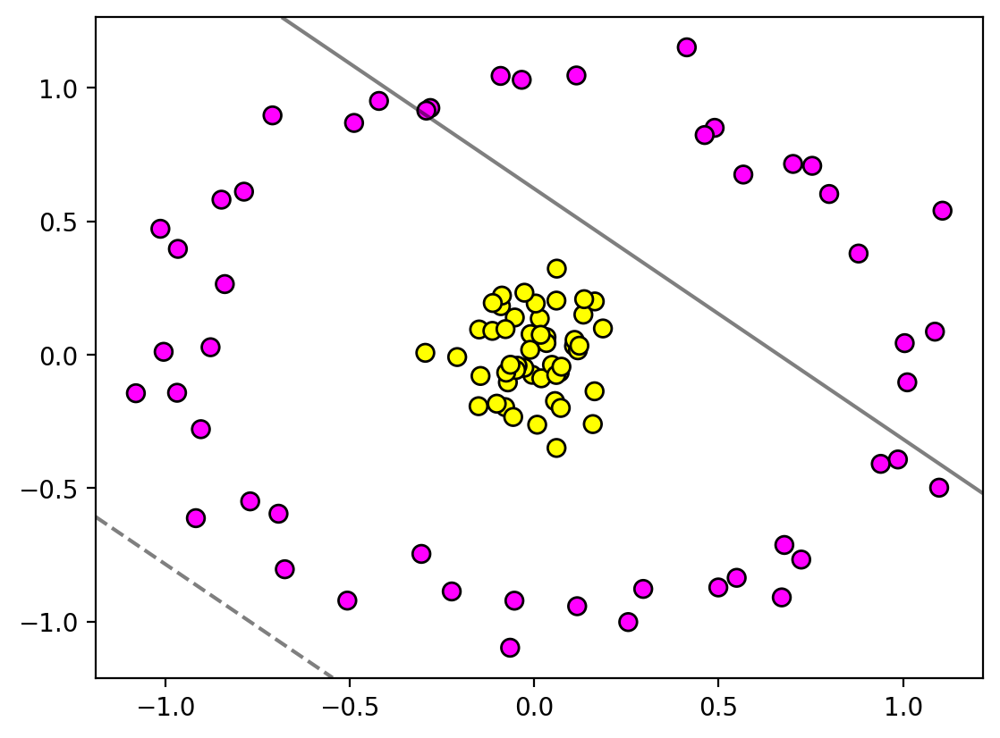

In [27]:
from sklearn.datasets import make_circles

X, y = make_circles(100, factor=.1, noise=.1)

clf = SVC(kernel='linear').fit(X, y)

plt.scatter(X[:, 0], X[:, 1], c=y, s=50, 
            cmap='spring', edgecolor='k')
plot_svc_decision_function(clf);

But we can make a transform of the data to *make* it linearly separable, for example with a simple **radial basis function** as shown below.

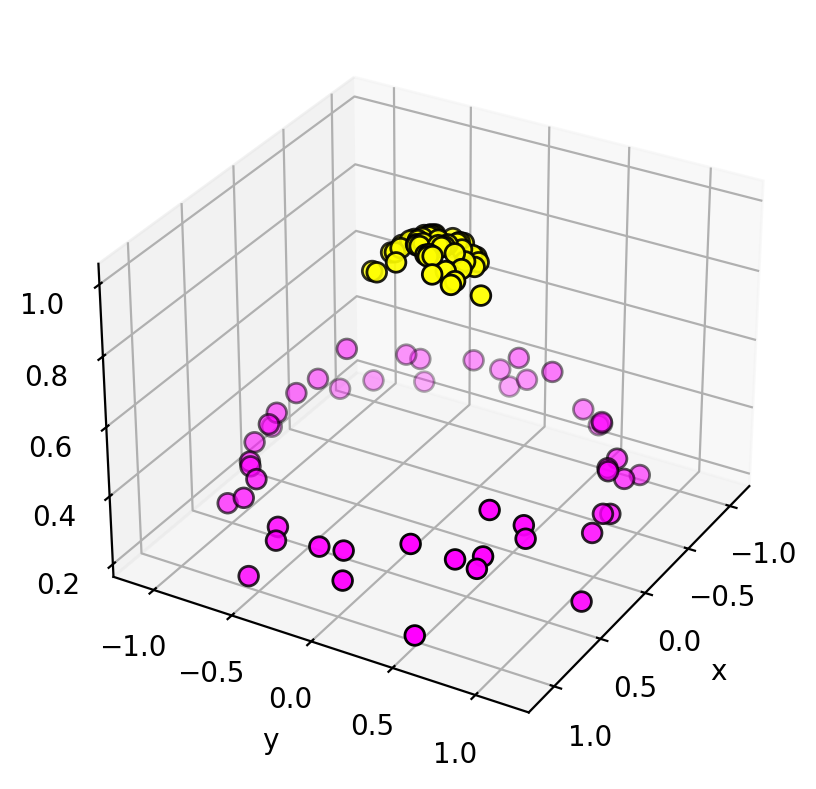

In [28]:
# Define a new feature that is related to the square of the input features.
# Points near and far from the origin will end up far away from each other.
z = np.exp(-(X[:, 0] ** 2 + X[:, 1] ** 2))

from ipywidgets import interact
#from mpl_toolkits import mplot3d

def plot_3D(elev=30, azim=30):
    ax = plt.subplot(projection='3d')
    ax.scatter3D(X[:, 0], X[:, 1], z, c=y, 
                 s=50, cmap='spring', edgecolor='k')
    ax.view_init(elev=elev, azim=azim)
    ax.set_xlabel('x')
    ax.set_ylabel('y')
    ax.set_zlabel('z')

plot_3D()

So an appropriate decision boundary would not be linear, but instead would be radial, emanating outward from the origin. Now we can trivially separate these populations!

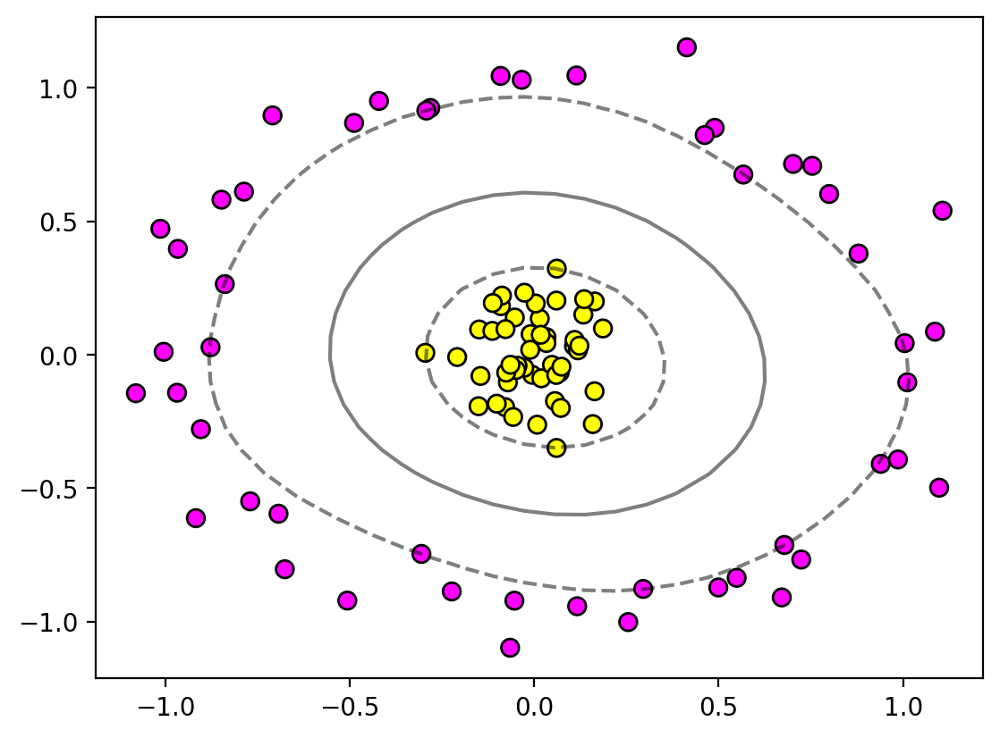

In [29]:
clf = SVC(kernel='rbf',C=10)
clf.fit(X, y)

plt.scatter(X[:, 0], X[:, 1], c=y, s=50, 
            cmap='spring', edgecolor='k')
plot_svc_decision_function(clf)
plt.scatter(clf.support_vectors_[:, 0], 
            clf.support_vectors_[:, 1],
            s=200, facecolors='none');

Let's look at another example of two populations generated from interleaving half-circles. This is very challenging for K-means clustering. In addition to the $C$ parameter, we'll adjust $\gamma$ which is a coefficient that scales the squared distances in the `rbf` kernel.

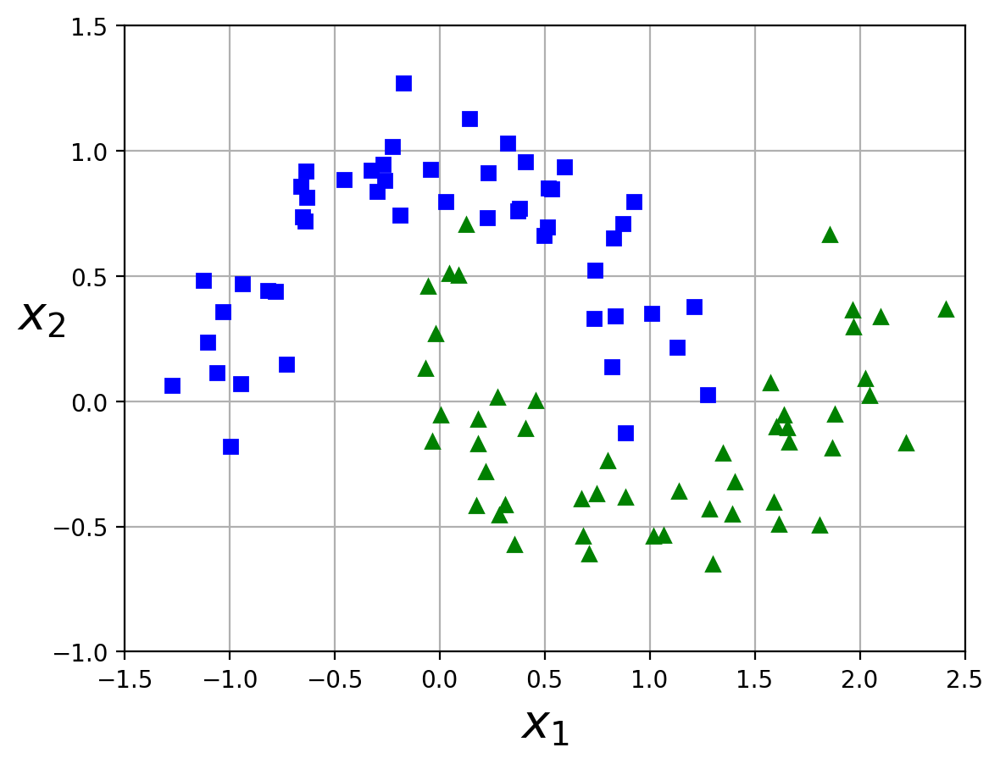

In [30]:
# Geron
from sklearn.datasets import make_moons

X, y = make_moons(n_samples=100, noise=0.15, random_state=42)

def plot_dataset(X, y, axes):
    plt.plot(X[:, 0][y==0], X[:, 1][y==0], "bs")
    plt.plot(X[:, 0][y==1], X[:, 1][y==1], "g^")
    plt.axis(axes)
    plt.grid(True, which='both')
    plt.xlabel(r"$x_1$", fontsize=20)
    plt.ylabel(r"$x_2$", fontsize=20, rotation=0)

plot_dataset(X, y, [-1.5, 2.5, -1, 1.5])
plt.show()

In [31]:
# For plotting the boundaries in the Moons example
# Geron
def plot_predictions(clf, axes):
    x0s = np.linspace(axes[0], axes[1], 100)
    x1s = np.linspace(axes[2], axes[3], 100)
    x0, x1 = np.meshgrid(x0s, x1s)
    X = np.c_[x0.ravel(), x1.ravel()]
    y_pred = clf.predict(X).reshape(x0.shape)
    y_decision = clf.decision_function(X).reshape(x0.shape)
    plt.contourf(x0, x1, y_pred, cmap=plt.cm.brg, alpha=0.2)
    plt.contourf(x0, x1, y_decision, cmap=plt.cm.brg, alpha=0.1)

Let's try two very different values for $\gamma$ and $C$. What is over/under fitting here?

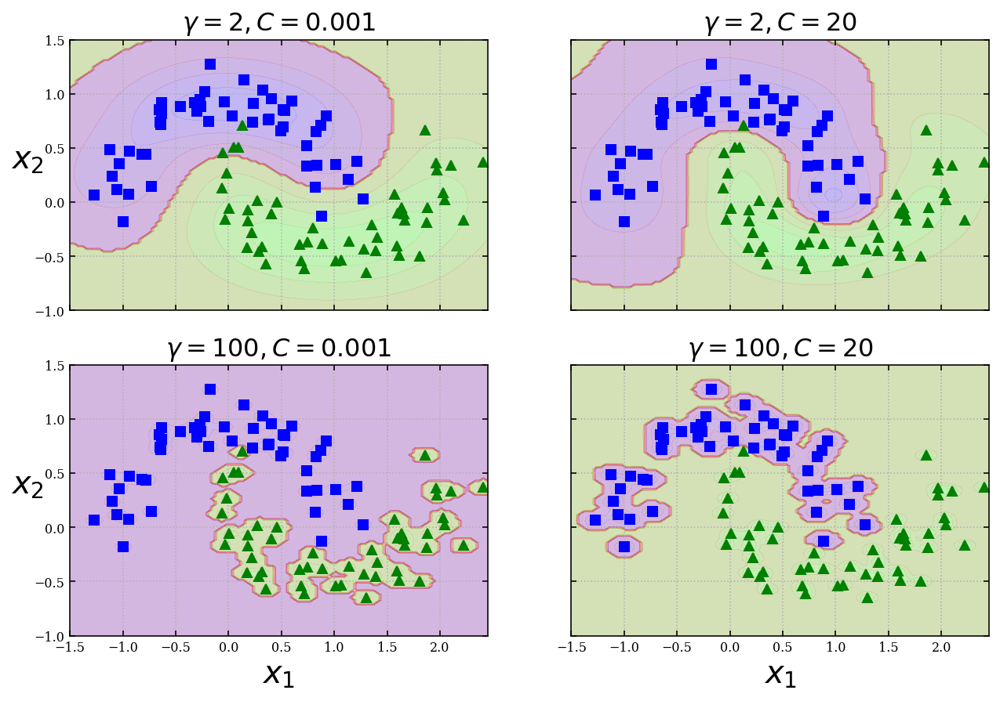

In [60]:
#Geron
from sklearn.svm import SVC
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler

gamma1, gamma2 = 2, 100
C1, C2 = 0.001, 20
hyperparams = (gamma1, C1), (gamma1, C2), (gamma2, C1), (gamma2, C2)

svm_clfs = []
for gamma, C in hyperparams:
    rbf_kernel_svm_clf = Pipeline([
            ("scaler", StandardScaler()),
            ("svm_clf", SVC(kernel="rbf", 
                            gamma=gamma, C=C))])
    rbf_kernel_svm_clf.fit(X, y)
    svm_clfs.append(rbf_kernel_svm_clf)

fig, axes = plt.subplots(nrows=2, ncols=2, 
                         figsize=(10.5, 7), 
                         sharex=True, sharey=True)

for i, svm_clf in enumerate(svm_clfs):
    plt.sca(axes[i // 2, i % 2])
    plot_predictions(svm_clf, [-1.5, 2.45, -1, 1.5])
    plot_dataset(X, y, [-1.5, 2.45, -1, 1.5])
    
    gamma, C = hyperparams[i]
    plt.title(r"$\gamma = {}, C = {}$".format(gamma, C), 
              fontsize=16)
    if i in (0, 1):
        plt.xlabel("")
    if i in (1, 3):
        plt.ylabel("")
plt.show()

Note also the `Pipeline` function used in that example. It can chain together lots of operations that one would do manually in sequence, but can be easily packaged together into a compact workflow. In this circumstance it scaled the data before performing SVM classification; as mentioned SVM often requires scaling the data beforehand since it is not scale-invariant.

## Decision Trees <a class="anchor" id="four"></a>

A [**decision tree**](https://en.wikipedia.org/wiki/Decision_tree) is similar to the process of classification that you might do by hand: 

- define some criteria to separate the sample into 2 groups (not necessarily equal),
- then take those sub-groups and do it again.  
- keep going until you reach a stopping point such as not having a minimum number of objects to split again.  

In short, we have done a hierarchical application of decision boundaries.

The tree structure is as follows:
- top node contains the entire data set
- at each branch the data are subdivided into two child nodes 
- split is based on a predefined decision boundary (usually axis aligned)
- splitting repeats, recursively, until we reach a predefined stopping criteria 

Below is a simple example of a decision tree.

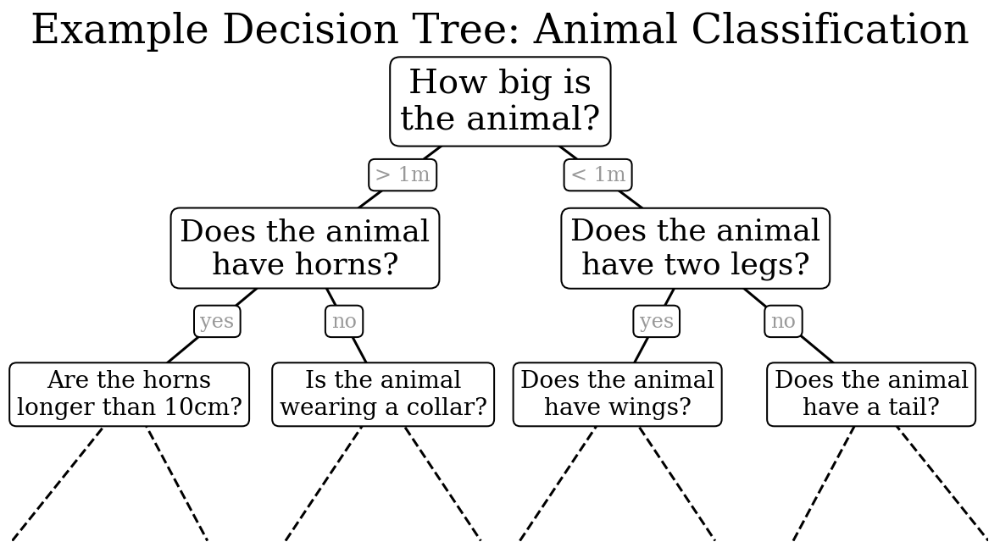

In [62]:
# Source: Jake VanderPlas, https://github.com/LocalGroupAstrostatistics2015/MachineLearning/blob/master/fig_code/figures.py
def plot_example_decision_tree():
    fig = plt.figure(figsize=(10, 4))
    ax = fig.add_axes([0, 0, 0.8, 1], frameon=False, xticks=[], yticks=[])
    ax.set_title('Example Decision Tree: Animal Classification', size=24)

    def text(ax, x, y, t, size=20, **kwargs):
        ax.text(x, y, t,
                ha='center', va='center', size=size,
                bbox=dict(boxstyle='round', ec='k', fc='w'), **kwargs)

    text(ax, 0.5, 0.9, "How big is\nthe animal?", 20)
    text(ax, 0.3, 0.6, "Does the animal\nhave horns?", 18)
    text(ax, 0.7, 0.6, "Does the animal\nhave two legs?", 18)
    text(ax, 0.12, 0.3, "Are the horns\nlonger than 10cm?", 14)
    text(ax, 0.38, 0.3, "Is the animal\nwearing a collar?", 14)
    text(ax, 0.62, 0.3, "Does the animal\nhave wings?", 14)
    text(ax, 0.88, 0.3, "Does the animal\nhave a tail?", 14)

    text(ax, 0.4, 0.75, "> 1m", 12, alpha=0.4)
    text(ax, 0.6, 0.75, "< 1m", 12, alpha=0.4)

    text(ax, 0.21, 0.45, "yes", 12, alpha=0.4)
    text(ax, 0.34, 0.45, "no", 12, alpha=0.4)

    text(ax, 0.66, 0.45, "yes", 12, alpha=0.4)
    text(ax, 0.79, 0.45, "no", 12, alpha=0.4)

    ax.plot([0.3, 0.5, 0.7], [0.6, 0.9, 0.6], '-k')
    ax.plot([0.12, 0.3, 0.38], [0.3, 0.6, 0.3], '-k')
    ax.plot([0.62, 0.7, 0.88], [0.3, 0.6, 0.3], '-k')
    ax.plot([0.0, 0.12, 0.20], [0.0, 0.3, 0.0], '--k')
    ax.plot([0.28, 0.38, 0.48], [0.0, 0.3, 0.0], '--k')
    ax.plot([0.52, 0.62, 0.72], [0.0, 0.3, 0.0], '--k')
    ax.plot([0.8, 0.88, 1.0], [0.0, 0.3, 0.0], '--k')
    ax.axis([0, 1, 0, 1])

plot_example_decision_tree()

<!-- For our RR Lyrae stars --> 
<!-- ![Ivezic, Figure 9.12](http://www.astroml.org/_images/fig_rrlyrae_treevis_1.png) -->

The **terminal nodes ("leaf nodes")** record the fraction of points that have one classification or the other in the training set.

Application of the tree to classification is simple-- just a series of binary decisions. The fraction of points from the training set classified as one belonging to one class or the other (in the leaf node) defines the class associated with that leaf node.

The binary splitting makes this extremely efficient. The trick is to ask the *right* questions. So, decision trees are simple to interpret (just a set of questions).

Scikit-learn implements the [`DecisionTreeClassifier`](http://scikit-learn.org/stable/modules/generated/sklearn.tree.DecisionTreeClassifier.html) as follows:

In [63]:
from sklearn.tree import DecisionTreeClassifier

X = np.random.random((100,2))
y = (X[:,0] + X[:,1] > 1).astype(int)

dtree = DecisionTreeClassifier(max_depth=6)
dtree.fit(X,y)

y_pred = dtree.predict(X)
print(dtree.get_depth())
print(dtree.get_n_leaves())

5
9


An example with our data set of RR Lyrae stars shows that it has moderately good completenees and contamination. But for this data set it is certainly not the optimal choice.

completeness [[0.00729927 0.3649635  0.29927007 0.62773723]
 [0.02189781 0.31386861 0.51824818 0.57664234]]
contamination [[0.66666667 0.375      0.31666667 0.31746032]
 [0.625      0.48809524 0.37719298 0.3875969 ]]


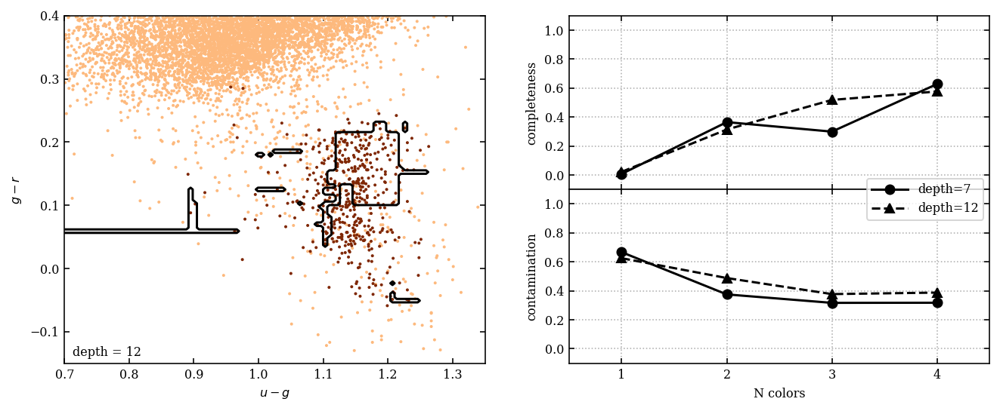

In [64]:
# Ivezic v2, Figure 9.13, edits by GTR and SRT
# Author: Jake VanderPlas
# License: BSD
#   The figure produced by this code is published in the textbook
#   "Statistics, Data Mining, and Machine Learning in Astronomy" (2013)
#   For more information, see http://astroML.github.com
#   To report a bug or issue, use the following forum:
#    https://groups.google.com/forum/#!forum/astroml-general
from sklearn.tree import DecisionTreeClassifier
from astroML.datasets import fetch_rrlyrae_combined
from astroML.utils import split_samples
from astroML.utils import completeness_contamination

#----------------------------------------------------------------------
# This function adjusts matplotlib settings for a uniform feel in the textbook.
# Note that with usetex=True, fonts are rendered with LaTeX.  This may
# result in an error if LaTeX is not installed on your system.  In that case,
# you can set usetex to False.
if "setup_text_plots" not in globals():
    from astroML.plotting import setup_text_plots
setup_text_plots(fontsize=8, usetex=False)

#----------------------------------------------------------------------
# get data and split into training & testing sets
X, y = fetch_rrlyrae_combined()
X = X[:, [1, 0, 2, 3]]  # rearrange columns for better 1-color results
(X_train, X_test), (y_train, y_test) = split_samples(X, y, [0.75, 0.25],
                                                     random_state=0)
N_tot = len(y)
N_st = np.sum(y == 0)
N_rr = N_tot - N_st
N_train = len(y_train)
N_test = len(y_test)
N_plot = 5000 + N_rr

#----------------------------------------------------------------------
# Fit Decision tree
Ncolors = np.arange(1, X.shape[1] + 1)

classifiers = []
predictions = []
Ncolors = np.arange(1, X.shape[1] + 1)
depths = [7, 12]

for depth in depths:
    classifiers.append([])
    predictions.append([])
    for nc in Ncolors:
        clf = DecisionTreeClassifier(random_state=0, max_depth=depth,
                                     criterion='entropy')
        clf.fit(X_train[:, :nc], y_train)
        y_pred = clf.predict(X_test[:, :nc])

        classifiers[-1].append(clf)
        predictions[-1].append(y_pred)

completeness, contamination = completeness_contamination(predictions, y_test)

print("completeness", completeness)
print("contamination", contamination)

#------------------------------------------------------------
# compute the decision boundary

clf = classifiers[1][1]
xlim = (0.7, 1.35)
ylim = (-0.15, 0.4)

xx, yy = np.meshgrid(np.linspace(xlim[0], xlim[1], 101),
                     np.linspace(ylim[0], ylim[1], 101))

Z = clf.predict(np.c_[yy.ravel(), xx.ravel()])
Z = Z.reshape(xx.shape)

#----------------------------------------------------------------------
# plot the results
fig = plt.figure(figsize=(10, 4))
fig.subplots_adjust(bottom=0.15, top=0.95, hspace=0.0,
                    left=0.1, right=0.95, wspace=0.2)

# left plot: data and decision boundary
ax = fig.add_subplot(121)
im = ax.scatter(X[-N_plot:, 1], X[-N_plot:, 0], c=y[-N_plot:],
                s=4, lw=0, cmap=plt.cm.Oranges, zorder=2)
im.set_clim(-0.5, 1)

ax.contour(xx, yy, Z, [0.5], colors='k')

ax.set_xlim(xlim)
ax.set_ylim(ylim)

ax.set_xlabel('$u-g$')
ax.set_ylabel('$g-r$')

ax.text(0.02, 0.02, "depth = %i" % depths[1],
        transform=ax.transAxes)

# plot completeness vs Ncolors
ax = fig.add_subplot(222)
ax.plot(Ncolors, completeness[0], 'o-k', ms=6, label="depth=%i" % depths[0])
ax.plot(Ncolors, completeness[1], '^--k', ms=6, label="depth=%i" % depths[1])

ax.xaxis.set_major_locator(plt.MultipleLocator(1))
ax.yaxis.set_major_locator(plt.MultipleLocator(0.2))
ax.xaxis.set_major_formatter(plt.NullFormatter())

ax.set_ylabel('completeness')
ax.set_xlim(0.5, 4.5)
ax.set_ylim(-0.1, 1.1)
ax.grid(True)

# plot contamination vs Ncolors
ax = fig.add_subplot(224)
ax.plot(Ncolors, contamination[0], 'o-k', ms=6, label="depth=%i" % depths[0])
ax.plot(Ncolors, contamination[1], '^--k', ms=6, label="depth=%i" % depths[1])
ax.legend(loc='lower right',
          bbox_to_anchor=(1.0, 0.79))

ax.xaxis.set_major_locator(plt.MultipleLocator(1))
ax.yaxis.set_major_locator(plt.MultipleLocator(0.2))
ax.xaxis.set_major_formatter(plt.FormatStrFormatter('%i'))

ax.set_xlabel('N colors')
ax.set_ylabel('contamination')
ax.set_xlim(0.5, 4.5)
ax.set_ylim(-0.1, 1.1)
ax.grid(True)

plt.show()

### Splitting Criteria

Now let's talk about the best ways to split the data. 

One way is to use the **information content (or "entropy")**, $E(x)$, of the data

$$ E(x) = -\sum_i p_i(x) \ln (p_i(x)),$$

where $i$ is the class and $p_i(x)$ is the probability of that class given the training data. We can define the **information gain** as the reduction in entropy due to the partitioning of the data (i.e. by partitioning the data you have reduced the disorder). For a binary split with $i=0$ representing those points below the split threshold and $i=1$ as those points above the split threshold, the information gain $IG(x)$ is

$$ IG(x|x_i) = E(x) - \sum_{i=0}^1 \frac{N_i}{N}E(x_i),$$

where $N_i$ is the number of points, $x_i$, in the $i$-th class, and $E(x_i)$ is the entropy of that class. Effectively we are assessing the information gain as the difference between the entropy of the parent node and the sum of the entropies of the child nodes. **The information gain is sometimes also referred to as the Kullback-Leibler (KL) Divergence.** 

*The typical process for finding the optimal decision boundary is to perform trial splits along each feature one at a time, within which the value of the feature to split at is also trialed. The feature that allows for the maximum information gain is the one that is split at this level.*

Another commonly used "loss function" (especially for categorical classification) is the **Gini coefficient**:

$$ G = \sum_i^k p_i(1-p_i).$$

It essentially estimates the probability of incorrect classification by choosing both a point and (separately) a class randomly from the data.

**At home**. Try changing the example above to use `criterion='gini'` and `min_samples_leaf=3`, see [here](https://scikit-learn.org/stable/modules/generated/sklearn.tree.DecisionTreeClassifier.html#sklearn.tree.DecisionTreeClassifier) for all of the parameters.

---
Obviously in constructing a decision treee, if your choice of stopping criteria is too loose, further splitting just ends up adding noise.  So here is an example using ***cross-validation in order to optimize the depth of the tree (and to avoid overfitting -- that is, we are doing regularization)***.  

Note that in this particular example we aren't classifying the objects into discrete categories. Rather we are classifying them into a continuous category. That is, we are performing regression (sorry for the confusion, but hope you see these are really the same thing dressed differently!). In this particular case, we are using the colors of galaxies in order to predict their redshifts (distances)-- this is known as *photometric redshift estimation*.

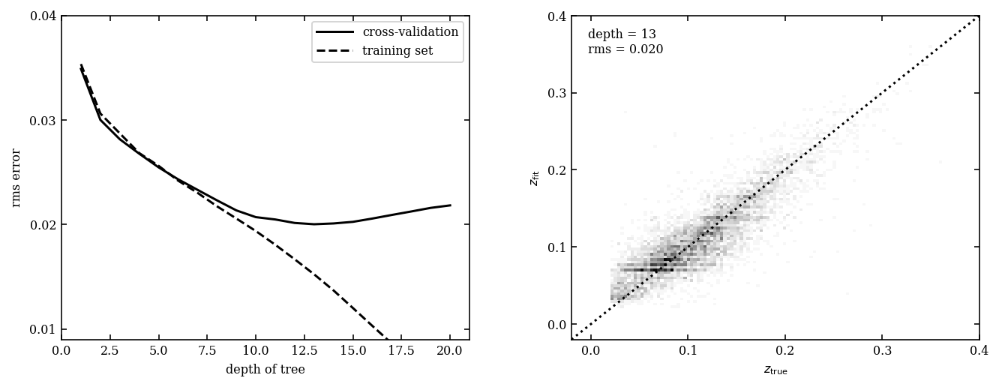

In [65]:
# Ivezic v2, Figure 9.14
# Author: Jake VanderPlas
# License: BSD
#   The figure produced by this code is published in the textbook
#   "Statistics, Data Mining, and Machine Learning in Astronomy" (2013)
#   For more information, see http://astroML.github.com
#   To report a bug or issue, use the following forum:
#    https://groups.google.com/forum/#!forum/astroml-general
from sklearn.tree import DecisionTreeRegressor
from astroML.datasets import fetch_sdss_specgals

#----------------------------------------------------------------------
# This function adjusts matplotlib settings for a uniform feel in the textbook.
# Note that with usetex=True, fonts are rendered with LaTeX.  This may
# result in an error if LaTeX is not installed on your system.  In that case,
# you can set usetex to False.
if "setup_text_plots" not in globals():
    from astroML.plotting import setup_text_plots
setup_text_plots(fontsize=8, usetex=False)

#------------------------------------------------------------
# Fetch data and prepare it for the computation
data = fetch_sdss_specgals()

# put magnitudes in a matrix
mag = np.vstack([data['modelMag_%s' % f] for f in 'ugriz']).T
z = data['z']

# train on ~60,000 points
mag_train = mag[::10]
z_train = z[::10]

# test on ~6,000 separate points
mag_test = mag[1::100]
z_test = z[1::100]

#------------------------------------------------------------
# Compute the cross-validation scores for several tree depths
depth = np.arange(1, 21)
rms_test = np.zeros(len(depth))
rms_train = np.zeros(len(depth))
i_best = 0
z_fit_best = None

for i, d in enumerate(depth):
    clf = DecisionTreeRegressor(max_depth=d, random_state=0)
    clf.fit(mag_train, z_train)

    z_fit_train = clf.predict(mag_train)
    z_fit = clf.predict(mag_test)
    rms_train[i] = np.mean(np.sqrt((z_fit_train - z_train) ** 2))
    rms_test[i] = np.mean(np.sqrt((z_fit - z_test) ** 2))

    if rms_test[i] <= rms_test[i_best]:
        i_best = i
        z_fit_best = z_fit

best_depth = depth[i_best]

#------------------------------------------------------------
# Plot the results
fig = plt.figure(figsize=(10, 4))
fig.subplots_adjust(wspace=0.25,
                    left=0.1, right=0.95,
                    bottom=0.15, top=0.9)

# first panel: cross-validation
ax = fig.add_subplot(121)
ax.plot(depth, rms_test, '-k', label='cross-validation')
ax.plot(depth, rms_train, '--k', label='training set')
ax.set_xlabel('depth of tree')
ax.set_ylabel('rms error')
ax.yaxis.set_major_locator(plt.MultipleLocator(0.01))
ax.set_xlim(0, 21)
ax.set_ylim(0.009,  0.04)
ax.legend(loc=1)

# second panel: best-fit results
ax = fig.add_subplot(122)
edges = np.linspace(z_test.min(), z_test.max(), 101)
H, zs_bins, zp_bins = np.histogram2d(z_test, z_fit_best, bins=edges)
ax.imshow(H.T, origin='lower', interpolation='nearest', aspect='auto', 
           extent=[zs_bins[0], zs_bins[-1], zs_bins[0], zs_bins[-1]],
           cmap=plt.cm.binary)
ax.plot([-0.1, 0.4], [-0.1, 0.4], ':k')
ax.text(0.04, 0.96, "depth = %i\nrms = %.3f" % (best_depth, rms_test[i_best]),
        ha='left', va='top', transform=ax.transAxes)
ax.set_xlabel(r'$z_{\rm true}$')
ax.set_ylabel(r'$z_{\rm fit}$')

ax.set_xlim(-0.02, 0.4001)
ax.set_ylim(-0.02, 0.4001)
ax.xaxis.set_major_locator(plt.MultipleLocator(0.1))
ax.yaxis.set_major_locator(plt.MultipleLocator(0.1))

plt.show()

But that's doing the ***Cross Validation*** by hand. Let's try it automatically using a "Moons" data set.

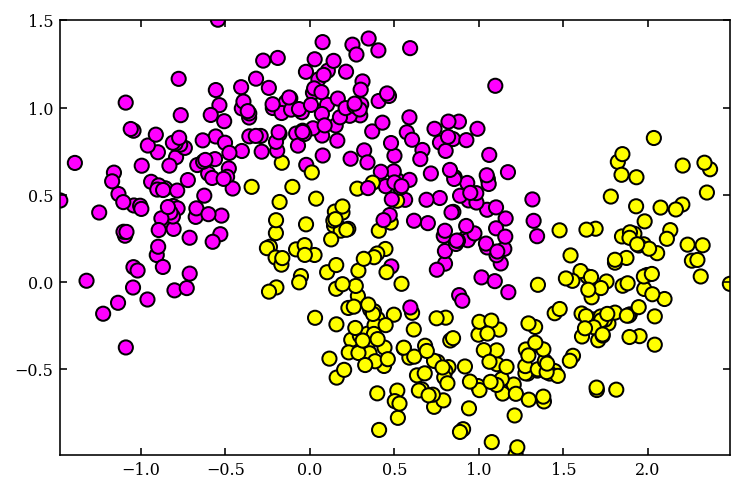

In [66]:
X, y = make_moons(n_samples=500, noise=0.20, random_state=42)
plt.scatter(X[:, 0], X[:, 1], c=y, s=50, cmap='spring',edgecolor='k')

In [67]:
#from sklearn.grid_search import GridSearchCV
from sklearn.model_selection import GridSearchCV

clf = DecisionTreeClassifier()
drange = np.arange(1,21)  #Complete

grid = GridSearchCV(clf, param_grid={'max_depth': drange}, cv=5) #Complete
grid.fit(X, y)

best = grid.best_params_['max_depth']
print("best parameter choice:", best)

best parameter choice: 5


Now plot the decision boundary

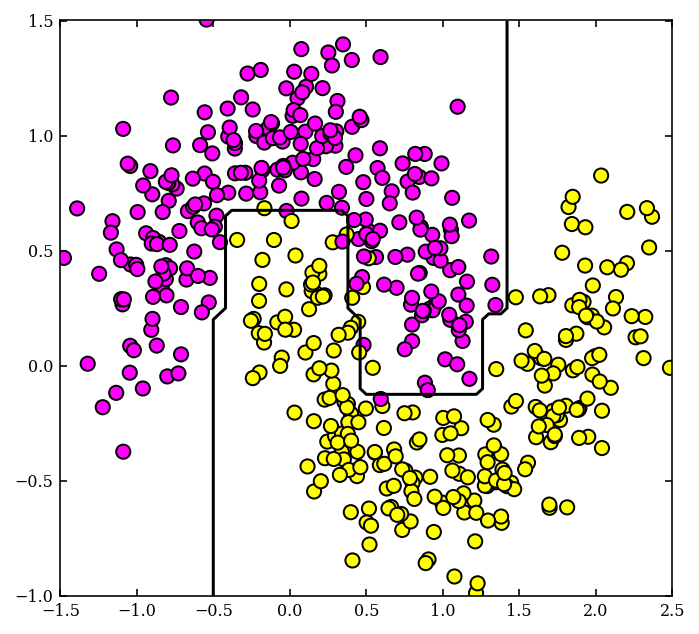

In [68]:
dt = DecisionTreeClassifier(random_state=0, max_depth=best, 
                            criterion='entropy')
dt.fit(X, y)
yprob = dt.predict_proba(X) # If we wanted probabilities rather than the discrete classes

xlim = (-1.5, 2.5)
ylim = (-1, 1.5)

xx, yy = np.meshgrid(np.linspace(xlim[0], xlim[1], 51),
                     np.linspace(ylim[0], ylim[1], 51))
xystack = np.vstack([xx.ravel(),yy.ravel()])
Xgrid = xystack.T

Z = dt.predict(Xgrid)
Z = Z.reshape(xx.shape)

#----------------------------------------------------------------------
# plot the results
fig = plt.figure(figsize=(5, 5))
fig.subplots_adjust(bottom=0.15, top=0.95, hspace=0.0,
                    left=0.1, right=0.95, wspace=0.2)

# left plot: data and decision boundary
ax = fig.add_subplot(111)
im = ax.scatter(X[:, 0], X[:, 1], c=y, s=50, 
                cmap=plt.cm.spring, zorder=2, edgecolor='k')

ax.contour(xx, yy, Z, [0.5], colors='k')

Note that Decision Trees are the basis for the rest of the material today.  So it is useful to consider some of the [advantages and disadvantages](https://scikit-learn.org/stable/modules/tree.html).

For example **Decision Trees are unstable to small changes in the data (unlike SVM)**. If we rotated our moons example, we'd get a different answer. We'll see how we can harness the power of Decision Trees to create even more robust classifiers.

## Ensemble Learning <a class="anchor" id="five"></a>

You may have noticed that each of the classification methods that we have described so far has its strengths and weaknesses. You might wonder if we could gain something by some sort of averaging of weighted "voting". Such a process is what we call ***ensemble learning***.  We'll discuss two such processes: 
- [**bagging**](https://en.wikipedia.org/wiki/Bootstrap_aggregating)
- [**random forests**](https://en.wikipedia.org/wiki/Random_forest)


### Bagging

**Bagging (short for *bootstrap aggregation***) can significantly improve the performance of decision trees. In short, bagging averages the predictive results of a series of ***bootstrap*** samples of the original data.

Remember that instead of splitting the sample into training and test sets that do not overlap, bootstrap says to draw from the observed data set with replacement. So we select indices from the range $\{1,\ldots,N\}$ and this is our new sample.  Some indices will be repeated, and we do this $B$ times.

For a sample of $N$ points in a training set, bagging generates $B$ equally sized bootstrap samples from which to estimate the function $f_i(x)$. The final estimator for $\hat{y}$, defined by bagging, is then

$$\hat{y} = f(x) = \frac{1}{B} \sum_i^B f_i(x).$$

Let's compare how well a regular decision tree performs as compared to bagging applied to an ensemble of decision trees. We'll use the same moons data from above, but a bit noisier to make it harder. We'll also split into training and test sets so that both methods can be compared using a test set that neither have seen.

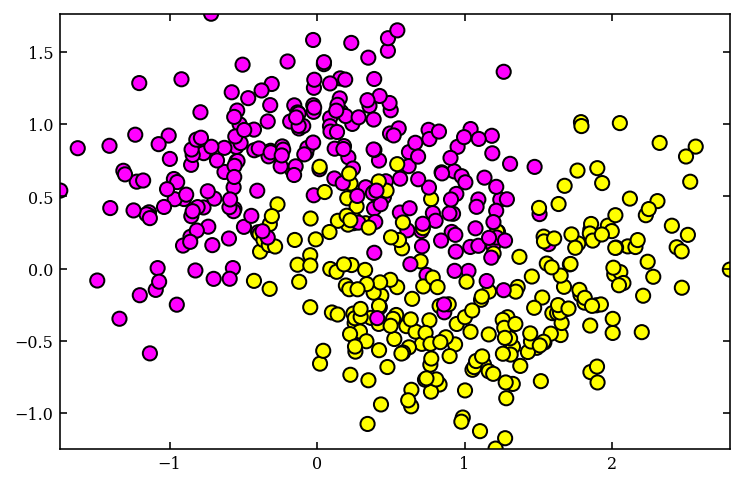

In [69]:
# Following example from Geron
X, y = make_moons(n_samples=500, noise=0.30, random_state=42)
plt.scatter(X[:, 0], X[:, 1], c=y, s=50, 
            cmap='spring',edgecolor='k')

from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=42)

In [70]:
# Regular Decision Tree
tree_clf = DecisionTreeClassifier(random_state=42)
tree_clf.fit(X_train, y_train)

y_pred_tree = tree_clf.predict(X_test)

In [71]:
# Bagged Decision Tree
from sklearn.ensemble import BaggingClassifier
from sklearn.tree import DecisionTreeClassifier

bag_clf = BaggingClassifier(
    DecisionTreeClassifier(random_state=42), 
    n_estimators=500, max_samples=100, 
    bootstrap=True, random_state=42, n_jobs=-1)

%timeit bag_clf.fit(X_train, y_train)

y_pred_bag = bag_clf.predict(X_test)

263 ms ± 19.2 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


Note the `n_jobs=-1` parameter.  That says to use all the cores of your machine to do the job.  That's one of the benefits of bagging.  It can be made parallel trivially -- one bagging process has nothing to the with the others.  You just average them all together when you are done.  

You can try changing `n_jobs` to 1 and compare how much time it takes.  If you have a Mac, go to /Applications/Utilities/Activity Monitor, open that up and watch it spawn 4-8 Python 3.8 processes at once when you tell it to use all of the cores.

OK, now let's compare the scores and we'll see that the bagging result beat the non-bagged result.  Then we'll make a plot and see why.

In [72]:
# Now compare the scores
from sklearn.metrics import accuracy_score

print(accuracy_score(y_test, y_pred_tree))
print(accuracy_score(y_test, y_pred_bag))

0.856
0.904


In [73]:
#From Geron for plotting the decision boundary
from matplotlib.colors import ListedColormap

def plot_decision_boundary(clf, X, y, axes=[-1.5, 2.45, 
                                            -1, 1.5], 
                           alpha=0.5, contour=True):
    x1s = np.linspace(axes[0], axes[1], 100)
    x2s = np.linspace(axes[2], axes[3], 100)
    x1, x2 = np.meshgrid(x1s, x2s)
    X_new = np.c_[x1.ravel(), x2.ravel()]
    
    y_pred = clf.predict(X_new).reshape(x1.shape)
    
    custom_cmap = ListedColormap(['#fafab0','#9898ff','#a0faa0'])
    plt.contourf(x1, x2, y_pred, alpha=0.3, cmap=custom_cmap)
    if contour:
        custom_cmap2 = ListedColormap(['#7d7d58','#4c4c7f','#507d50'])
        plt.contour(x1, x2, y_pred, cmap=custom_cmap2, alpha=0.8)
    plt.plot(X[:, 0][y==0], X[:, 1][y==0], 
             "yo", alpha=alpha)
    plt.plot(X[:, 0][y==1], X[:, 1][y==1], 
             "bs", alpha=alpha)
    plt.axis(axes)
    plt.xlabel(r"$x_1$", fontsize=18)
    plt.ylabel(r"$x_2$", fontsize=18, rotation=0)

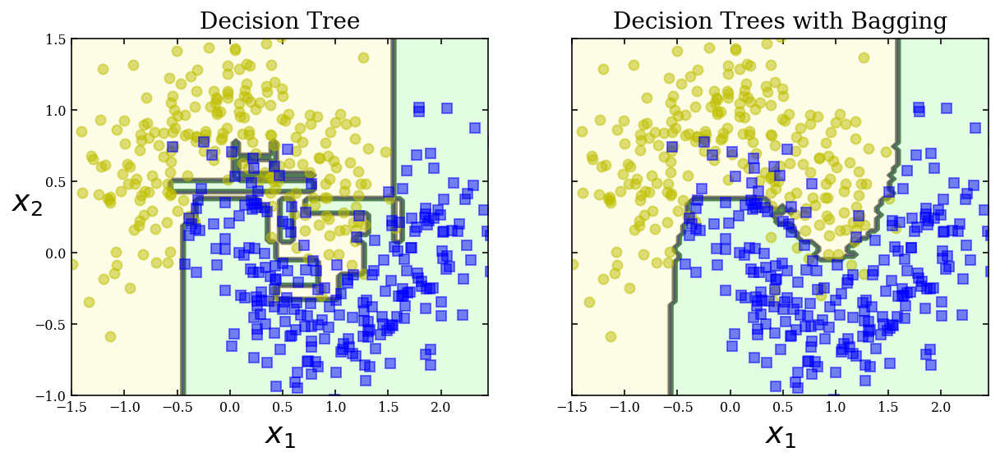

In [74]:
fix, axes = plt.subplots(ncols=2, figsize=(10,4), sharey=True)

plt.sca(axes[0])
plot_decision_boundary(tree_clf, X, y)
plt.title("Decision Tree", fontsize=14)

plt.sca(axes[1])
plot_decision_boundary(bag_clf, X, y)
plt.title("Decision Trees with Bagging", fontsize=14)

plt.ylabel("")
plt.show()

### Random Forests

**[Random forests](https://www.wikiwand.com/en/Random_forest)** extend bagging by generating decision trees from the bootstrap samples.  

- In Random Forests, the ***splitting features on which to generate the tree are selected at random*** from the full set of features in the data.
- The number of features selected per split level is typically the square root of the total number of features, $\sqrt{D}$. 
- The final classification from the random forest is based on the averaging of the classifications of each of the individual decision trees. So, you can literally give it the kitchen sink (including attributes that you might not otherwise think would be useful for classification).
- Random forests help to overcome some of the limitations of decision trees.

As before, **cross-validation can be used to determine the optimal depth**.  Generally the number of trees, $n$, that are chosen is the number at which the cross-validation error plateaus.

Below we give the same example as above for photometric estimation of galaxy redshifts, where Scikit-Learn's [`RandomForestClassifier`](http://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomForestClassifier.html) call looks as follows:

In [75]:
from sklearn.ensemble import RandomForestClassifier

X = np.random.random((100,2))
y = (X[:,0] + X[:,1] > 1).astype(int)

ranfor = RandomForestClassifier(10)
ranfor.fit(X,y)

y_pred = ranfor.predict(X)

@pickle_results: using precomputed results from 'photoz_forest.pkl'


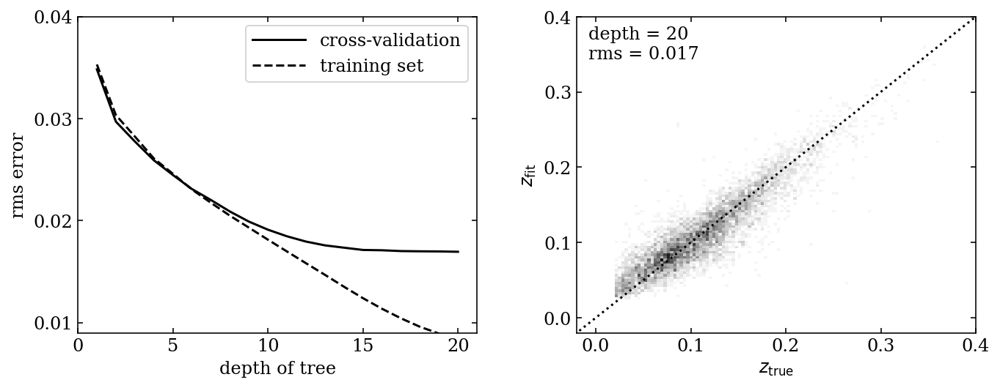

In [76]:
# Ivezic v2, Figure 9.15, edits by GTR and SRT
# License: BSD
#   The figure produced by this code is published in the textbook
#   "Statistics, Data Mining, and Machine Learning in Astronomy" (2013)
#   For more information, see http://astroML.github.com
#   To report a bug or issue, use the following forum:
#    https://groups.google.com/forum/#!forum/astroml-general
from sklearn.ensemble import RandomForestRegressor
from astroML.datasets import fetch_sdss_specgals
from astroML.utils.decorators import pickle_results

#----------------------------------------------------------------------
# This function adjusts matplotlib settings for a uniform feel in the textbook.
# Note that with usetex=True, fonts are rendered with LaTeX.  This may
# result in an error if LaTeX is not installed on your system.  In that case,
# you can set usetex to False.
if "setup_text_plots" not in globals():
    from astroML.plotting import setup_text_plots
setup_text_plots(fontsize=12, usetex=False)

#------------------------------------------------------------
# Fetch and prepare the data
data = fetch_sdss_specgals()

# put magnitudes in a matrix
mag = np.vstack([data['modelMag_%s' % f] for f in 'ugriz']).T
z = data['z']

# train on ~60,000 points
mag_train = mag[::10]
z_train = z[::10]

# test on ~6,000 distinct points
mag_test = mag[1::100]
z_test = z[1::100]


#------------------------------------------------------------
# Compute the results
#  This is a long computation, so we'll save the results to a pickle.
@pickle_results('photoz_forest.pkl')
def compute_photoz_forest(depth):
    rms_test = np.zeros(len(depth))
    rms_train = np.zeros(len(depth))
    i_best = 0
    z_fit_best = None

    for i, d in enumerate(depth):
        clf = RandomForestRegressor(n_estimators=10,
                                    max_depth=d, random_state=0)
        clf.fit(mag_train, z_train)

        z_fit_train = clf.predict(mag_train)
        z_fit = clf.predict(mag_test)
        rms_train[i] = np.mean(np.sqrt((z_fit_train - z_train) ** 2))
        rms_test[i] = np.mean(np.sqrt((z_fit - z_test) ** 2))

        if rms_test[i] <= rms_test[i_best]:
            i_best = i
            z_fit_best = z_fit

    return rms_test, rms_train, i_best, z_fit_best


depth = np.arange(1, 21)
rms_test, rms_train, i_best, z_fit_best = compute_photoz_forest(depth)
best_depth = depth[i_best]

#------------------------------------------------------------
# Plot the results
fig = plt.figure(figsize=(10, 4))
fig.subplots_adjust(wspace=0.25,
                    left=0.1, right=0.95,
                    bottom=0.15, top=0.9)

# left panel: plot cross-validation results
ax = fig.add_subplot(121)
ax.plot(depth, rms_test, '-k', label='cross-validation')
ax.plot(depth, rms_train, '--k', label='training set')
ax.legend(loc=1)

ax.set_xlabel('depth of tree')
ax.set_ylabel('rms error')

ax.set_xlim(0, 21)
ax.set_ylim(0.009,  0.04)
ax.yaxis.set_major_locator(plt.MultipleLocator(0.01))

# right panel: plot best fit
ax = fig.add_subplot(122)

edges = np.linspace(z_test.min(), z_test.max(), 101)
H, zs_bins, zp_bins = np.histogram2d(z_test, z_fit_best, bins=edges)
ax.imshow(H.T, origin='lower', interpolation='nearest', aspect='auto', 
           extent=[zs_bins[0], zs_bins[-1], zs_bins[0], zs_bins[-1]],
           cmap=plt.cm.binary)

ax.plot([-0.1, 0.4], [-0.1, 0.4], ':k')
ax.text(0.03, 0.97, "depth = %i\nrms = %.3f" % (best_depth, rms_test[i_best]),
        ha='left', va='top', transform=ax.transAxes)

ax.set_xlabel(r'$z_{\rm true}$')
ax.set_ylabel(r'$z_{\rm fit}$')

ax.set_xlim(-0.02, 0.4001)
ax.set_ylim(-0.02, 0.4001)
ax.xaxis.set_major_locator(plt.MultipleLocator(0.1))
ax.yaxis.set_major_locator(plt.MultipleLocator(0.1))

plt.show()

### Boosting

**[Boosting](https://www.wikiwand.com/en/Gradient_boosting)** is an ensemble approach where many weak classifiers are combined and improved upon to make classification better. ***Boosting creates models that attempt to correct the errors of the ensemble so far.*** 

At the heart of boosting is the idea that we reweight the data based on how incorrectly the data were classified in the previous iteration. This is a core concept in deep learning.

- We run the classification multiple times and each time reweight the data based on the previous performance of the classifier. 
- At the end of this procedure we allow the classifiers to vote on the final classification. 

The most popular form of boosting is that of ***adaptive boosting***. In this case we take a weak classifier, $h(x)$, and create a strong classifier, $f(x)$, as

$$ f(x) = \sum_m^B\theta_m h_m(x),$$

where $m$ is the number of iterations and $\theta_m$ is the weight of the classifier in each iteration.  

*If we chose $\theta_m=1/B$, then we'd essentially have bagging.* For boosting the idea is to increase the weight of the misclassified data in each step.

A fundamental limitation of the boosted decision tree is the computation time for large data sets (they rely on a chain of classifiers which are each dependent on the last), whereas random forests can be easily parallelized as we saw above.

The example given below is actually Scikit-Learn's [`GradientBoostingClassifier`](http://scikit-learn.org/stable/modules/generated/sklearn.ensemble.GradientBoostingClassifier.html) where we approximate the steepest descent criterion after each simple evaluation (more on that next time).

In [33]:
from sklearn.ensemble import GradientBoostingClassifier

X = np.random.random((100,2))
y = (X[:,0] + X[:,1] > 1).astype(int)

gradboost = GradientBoostingClassifier()
gradboost.fit(X,y)

y_pred = gradboost.predict(X)

And now try the photometric redshift estimation for galaxies again with a boosted decision tree.

@pickle_results: using precomputed results from 'photoz_boosting.pkl'


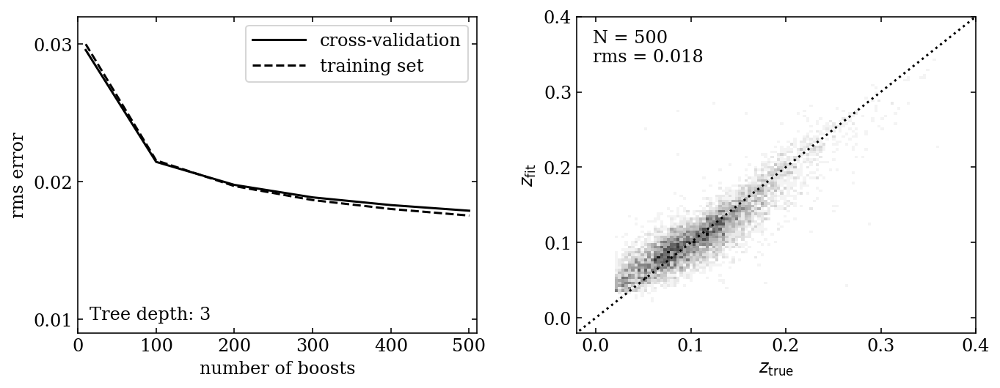

In [34]:
# Ivezic v2, Figure 9.16
# Author: Jake VanderPlas
# License: BSD
#   The figure produced by this code is published in the textbook
#   "Statistics, Data Mining, and Machine Learning in Astronomy" (2013)
#   For more information, see http://astroML.github.com
#   To report a bug or issue, use the following forum:
#    https://groups.google.com/forum/#!forum/astroml-general
from sklearn.ensemble import GradientBoostingRegressor
from astroML.datasets import fetch_sdss_specgals
from astroML.utils.decorators import pickle_results

#----------------------------------------------------------------------
# This function adjusts matplotlib settings for a uniform feel in the textbook.
# Note that with usetex=True, fonts are rendered with LaTeX.  This may
# result in an error if LaTeX is not installed on your system.  In that case,
# you can set usetex to False.
if "setup_text_plots" not in globals():
    from astroML.plotting import setup_text_plots
setup_text_plots(fontsize=12, usetex=False)

#------------------------------------------------------------
# Fetch and prepare the data
data = fetch_sdss_specgals()

# put magnitudes in a matrix
mag = np.vstack([data['modelMag_%s' % f] for f in 'ugriz']).T  # X
z = data['z'] # y

# train on ~60,000 points
mag_train = mag[::10] #X_train
z_train = z[::10] #y_train

# test on ~6,000 distinct points
mag_test = mag[1::100] #X_test
z_test = z[1::100] #y_test


#------------------------------------------------------------
# Compute the results
#  This is a long computation, so we'll save the results to a pickle.
@pickle_results('photoz_boosting.pkl')
def compute_photoz_forest(N_boosts):
    rms_test = np.zeros(len(N_boosts))
    rms_train = np.zeros(len(N_boosts))
    i_best = 0
    z_fit_best = None

    for i, Nb in enumerate(N_boosts):
        try:
            # older versions of scikit-learn
            clf = GradientBoostingRegressor(n_estimators=Nb, learn_rate=0.1,
                                            max_depth=3, random_state=0)
        except TypeError:
            clf = GradientBoostingRegressor(n_estimators=Nb, learning_rate=0.1,
                                            max_depth=3, random_state=0)
        clf.fit(mag_train, z_train)

        z_fit_train = clf.predict(mag_train)
        z_fit = clf.predict(mag_test)
        rms_train[i] = np.mean(np.sqrt((z_fit_train - z_train) ** 2))
        rms_test[i] = np.mean(np.sqrt((z_fit - z_test) ** 2))

        if rms_test[i] <= rms_test[i_best]:
            i_best = i
            z_fit_best = z_fit

    return rms_test, rms_train, i_best, z_fit_best

N_boosts = (10, 100, 200, 300, 400, 500)
rms_test, rms_train, i_best, z_fit_best = compute_photoz_forest(N_boosts)
best_N = N_boosts[i_best]

#------------------------------------------------------------
# Plot the results
fig = plt.figure(figsize=(10, 4))
fig.subplots_adjust(wspace=0.25,
                    left=0.1, right=0.95,
                    bottom=0.15, top=0.9)

# left panel: plot cross-validation results
ax = fig.add_subplot(121)
ax.plot(N_boosts, rms_test, '-k', label='cross-validation')
ax.plot(N_boosts, rms_train, '--k', label='training set')
ax.legend(loc=1)

ax.set_xlabel('number of boosts')
ax.set_ylabel('rms error')
ax.set_xlim(0, 510)
ax.set_ylim(0.009,  0.032)
ax.yaxis.set_major_locator(plt.MultipleLocator(0.01))

ax.text(0.03, 0.03, "Tree depth: 3",
        ha='left', va='bottom', transform=ax.transAxes)

# right panel: plot best fit
ax = fig.add_subplot(122)
edges = np.linspace(z_test.min(), z_test.max(), 101)
H, zs_bins, zp_bins = np.histogram2d(z_test, z_fit_best, bins=edges)
ax.imshow(H.T, origin='lower', interpolation='nearest', aspect='auto', 
           extent=[zs_bins[0], zs_bins[-1], zs_bins[0], zs_bins[-1]],
           cmap=plt.cm.binary)

ax.plot([-0.1, 0.4], [-0.1, 0.4], ':k')
ax.text(0.04, 0.96, "N = %i\nrms = %.3f" % (best_N, rms_test[i_best]),
        ha='left', va='top', transform=ax.transAxes)

ax.set_xlabel(r'$z_{\rm true}$')
ax.set_ylabel(r'$z_{\rm fit}$')

ax.set_xlim(-0.02, 0.4001)
ax.set_ylim(-0.02, 0.4001)
ax.xaxis.set_major_locator(plt.MultipleLocator(0.1))
ax.yaxis.set_major_locator(plt.MultipleLocator(0.1))

plt.show()

## Alright, brilliant, but which one should I use? <a class="anchor" id="six"></a>

A convenient cop-out: no single model can be known in advance to be the best classifier! See also Ivezic, Table 9.1.

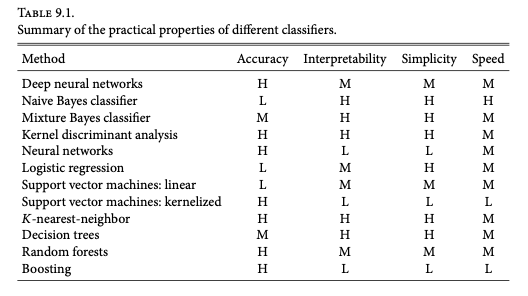

(We'll look at neural networks next week)

Naive Bayes and its variants are by far the easiest to compute. Linear support vector machines are more expensive, though several fast algorithms exist. Random forests can be easily parallelized. 

We saw before that Scikit-learn has tools for computing ROC curves, which is implemented as follows.  

In [77]:
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics

X = np.random.random((100,2))
y = (X[:,0] + X[:,1] > 1).astype(int)

gnb = GaussianNB().fit(X,y)
y_prob = gnb.predict_proba(X)

# Compute precision/recall curve
pr, re, thresh = metrics.precision_recall_curve(y, y_prob[:,0])

# Compute ROC curve
tpr, fpr, thresh = metrics.roc_curve(y, y_prob[:,0])

Let's remember what they had to say when aggregated over many different classifiers:

![Ivezic, Figure 9.17](http://www.astroml.org/_images/fig_ROC_curve_1.png)

Here's an example with a different data set. Here we are trying to distinguish quasars (in black) from stars (in grey). We'll finish off today by looking at the classification performance of many different generative and discriminative classifiers for this problem.

GaussianNB
LinearDiscriminantAnalysis
QuadraticDiscriminantAnalysis
LogisticRegression
KNeighborsClassifier
DecisionTreeClassifier
GMMBayes


/Users/dgerosa/box/lib/python3.8/site-packages/sklearn/mixture/_base.py:286: ConvergenceWarning: Initialization 1 did not converge. Try different init parameters, or increase max_iter, tol or check for degenerate data.
  warnings.warn(


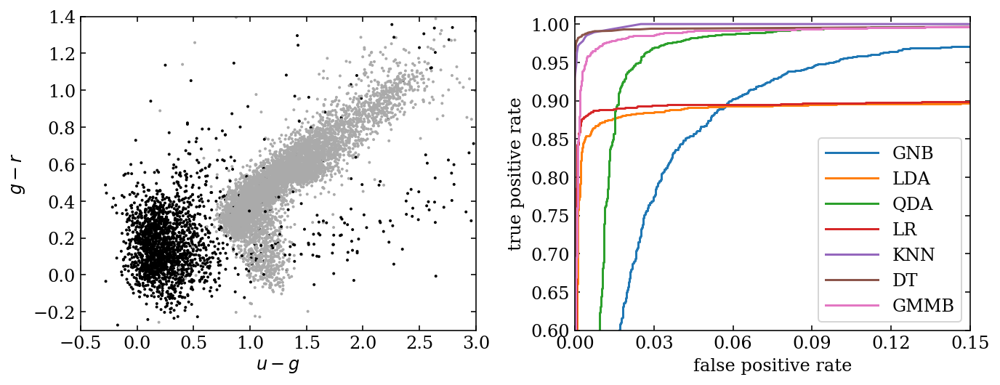

In [78]:
# Ivezic v2, Figure 9.18
# License: BSD
#   The figure produced by this code is published in the textbook
#   "Statistics, Data Mining, and Machine Learning in Astronomy" (2013)
#   For more information, see http://astroML.github.com
#   To report a bug or issue, use the following forum:
#    https://groups.google.com/forum/#!forum/astroml-general
from astroML.utils import split_samples

from sklearn.metrics import roc_curve
from sklearn.naive_bayes import GaussianNB
from sklearn.discriminant_analysis import (LinearDiscriminantAnalysis,
                                           QuadraticDiscriminantAnalysis)
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from astroML.classification import GMMBayes


#----------------------------------------------------------------------
# This function adjusts matplotlib settings for a uniform feel in the textbook.
# Note that with usetex=True, fonts are rendered with LaTeX.  This may
# result in an error if LaTeX is not installed on your system.  In that case,
# you can set usetex to False.
if "setup_text_plots" not in globals():
    from astroML.plotting import setup_text_plots
setup_text_plots(fontsize=12, usetex=False)

#------------------------------------------------------------
# Fetch data and split into training and test samples
from astroML.datasets import fetch_dr7_quasar
from astroML.datasets import fetch_sdss_sspp

quasars = fetch_dr7_quasar()
stars = fetch_sdss_sspp()

# Truncate data for speed
quasars = quasars[::5]
stars = stars[::5]

# stack colors into matrix X
Nqso = len(quasars)
Nstars = len(stars)
X = np.empty((Nqso + Nstars, 4), dtype=float)

X[:Nqso, 0] = quasars['mag_u'] - quasars['mag_g']
X[:Nqso, 1] = quasars['mag_g'] - quasars['mag_r']
X[:Nqso, 2] = quasars['mag_r'] - quasars['mag_i']
X[:Nqso, 3] = quasars['mag_i'] - quasars['mag_z']

X[Nqso:, 0] = stars['upsf'] - stars['gpsf']
X[Nqso:, 1] = stars['gpsf'] - stars['rpsf']
X[Nqso:, 2] = stars['rpsf'] - stars['ipsf']
X[Nqso:, 3] = stars['ipsf'] - stars['zpsf']

y = np.zeros(Nqso + Nstars, dtype=int)
y[:Nqso] = 1

# split into training and test sets
(X_train, X_test), (y_train, y_test) = split_samples(X, y, [0.9, 0.1],
                                                     random_state=0)


#------------------------------------------------------------
# Compute fits for all the classifiers
def compute_results(*args):
    names = []
    probs = []

    for classifier, kwargs in args:
        print(classifier.__name__)
        model = classifier(**kwargs)
        model.fit(X, y)
        y_prob = model.predict_proba(X_test)

        names.append(classifier.__name__)
        probs.append(y_prob[:, 1])

    return names, probs

LRclass_weight = dict([(i, np.sum(y_train == i)) for i in (0, 1)])

names, probs = compute_results((GaussianNB, {}),
                               (LinearDiscriminantAnalysis, {}),
                               (QuadraticDiscriminantAnalysis, {}),
                               (LogisticRegression,
                                dict(class_weight=LRclass_weight)),
                               (KNeighborsClassifier,
                                dict(n_neighbors=10)),
                               (DecisionTreeClassifier,
                                dict(random_state=0, max_depth=12,
                                     criterion='entropy')),
                               (GMMBayes, dict(n_components=3, tol=1E-5,
                                               covariance_type='full')))

#------------------------------------------------------------
# Plot results
fig = plt.figure(figsize=(10, 4))
fig.subplots_adjust(left=0.1, right=0.95, bottom=0.15, top=0.9, wspace=0.25)

# First axis shows the data
ax1 = fig.add_subplot(121)
im = ax1.scatter(X_test[:, 0], X_test[:, 1], c=y_test, s=4,
                 linewidths=0, edgecolors='none',
                 cmap=plt.cm.binary)
im.set_clim(-0.5, 1)
ax1.set_xlim(-0.5, 3.0)
ax1.set_ylim(-0.3, 1.4)
ax1.set_xlabel('$u - g$')
ax1.set_ylabel('$g - r$')

labels = dict(GaussianNB='GNB',
              LinearDiscriminantAnalysis='LDA',
              QuadraticDiscriminantAnalysis='QDA',
              KNeighborsClassifier='KNN',
              DecisionTreeClassifier='DT',
              GMMBayes='GMMB',
              LogisticRegression='LR')

# Second axis shows the ROC curves
ax2 = fig.add_subplot(122)
for name, y_prob in zip(names, probs):
    fpr, tpr, thresholds = roc_curve(y_test, y_prob)

    fpr = np.concatenate([[0], fpr])
    tpr = np.concatenate([[0], tpr])

    ax2.plot(fpr, tpr, label=labels[name])

ax2.legend(loc=4)
ax2.set_xlabel('false positive rate')
ax2.set_ylabel('true positive rate')
ax2.set_xlim(0, 0.15)
ax2.set_ylim(0.6, 1.01)
ax2.xaxis.set_major_locator(plt.MaxNLocator(5))

plt.show()

### Time to get your hands dirty! Can a computer learn if we're going to detect gravitational waves?

This episode of "time to get your hands dirty" is about something I studied carefully in the past: gravitational-wave selection effects. 


![](https://www.ligo.caltech.edu/system/news_items/images/53/page/Virgo_aerial_view_01.jpg?1506530275)



All experiments have selection effects. Some sources are easier to detect than others which distorts the population of sources we observe (this crucial in astronomy! Surveys are typically flux limited). In order to decided if a feature in the observed population of objects is telling us something new about reality, we need to understand and model our selection effects (for instance: it would be wrong to say that all stars are close by just because we can't observe those that are very far!). 
 
**The goal here is to machine-learn the LIGO detectability: can we *predict* if a gravitational-wave source will be detected?**  

[This dataset](https://github.com/dgerosa/pdetclassifier/releases/download/v0.2/sample_2e7_design_precessing_higherordermodes_3detectors.h5) contains simulated gravitational-wave signals from merging black holes (careful the file size is >1 GB). You can read this data format with `h5py`.

In particular, each source has the following features:
- `mtot`: the total mass of the binary
- `q`: the mass ratio
- `chi1x`, `chi1y`, `chi1z`, `chi2x`, `chi2y`, `chi2z`: the components of the black-hole spins in a suitable reference frame.
- `ra`, `dec`: the location of the source in the sky
- `iota`: the inclination of the orbital plane'
- `psi`: the polarization angle (gravitational waves have two polarization states much like light)
- `z`: the redshift

The detectability is defined using the `snr` (signal-to-noise ratio) computed with a state-of-the-art model of the LIGO/Virgo detector network. Some (many?) of you will have studied this in Sesana's gravitational-wave course; [see here](https://arxiv.org/abs/1908.11170) for a nice write-up. All you need to know now is that we threshold the `snr` values and assume that LIGO will (not) see a source if `snr`>12 (`snr`<12). The resulting 0-1 labels are reported in the `det` attribute in the dataset.

Today's task is to train a classifier (you decide which one!) and separate sources that are detectables from those that aren't. 

Be creative! This is a challenge! Let's see who gets the  higher completeness and/or the smaller contamination (on a validation set, of course! Careful with overfitting here!).

*Tips*:
- You can downsample the data for debugging purposes
- You can also use only some of the features. By experience, the most important ones are those involving masses and redshift.




[My exploration](https://github.com/dgerosa/astrostatistics_bicocca_2024/blob/main/solutions/S18_SNRclassifier.ipynb)

### The best I could do...

Together with Alberto Vecchio and Geraint Prattent, I tackled this classification problem with deep-learning: [arXiv:2007.06585](https://arxiv.org/abs/2007.06585). Next time we look into deep learning.

In the paper we reached an accuracy (true positive + true negative / total) of $98.4\%$. The data you're using are those of the green curve in Fig 2. Could you do better? If yes, please tell me how!

I should have really put a figure with my ROC in that paper but I didn't! Deep learning people liked the accuracy and I just went with the flow.


### Another idea

Here are other ideas that I haven't explored in a paper (yet?). 

- Using the same data, we could run a regressor on `snr` instead of a classifier on `det`. We can then threshold the predictions (instead of tresholding the data like we're doing now). Would this give a better performance?

- How about trying to reduce the dimensionality of the dataset with a PCA-type algorithm to ease the classification problem?

Please let me know if you give it a try and what you find! 




# Feedback!

Please help me with this class! I want to make it better!

https://forms.gle/2xPGGx3WgJHCYtnf9


----

# Deep Learning: I

*Davide Gerosa (Milano-Bicocca)* 

##### Reading/watching

- [Textbook](http://press.princeton.edu/titles/10159.html) Chapter 9.
- [Neural Networks Demystified](https://www.youtube.com/watch?v=bxe2T-V8XRs&list=PLiaHhY2iBX9hdHaRr6b7XevZtgZRa1PoU&ab_channel=WelchLabs) youtube playlist.

##### Dig deeper:

- ["Hands-On Machine Learning with Scikit-Learn, Keras, and TensorFlow", Aurelien Geron](https://www.oreilly.com/library/view/hands-on-machine-learning/9781492032632/). 
-  ["Neural Networks and Deep Learning"](http://neuralnetworksanddeeplearning.com/index.html). Free online book!
- Many many blogs and videos. Deep learning as a million applications that go well beyond astrophysics. There is truly excellent content accessibile out there with just a tiny bit of googling.


This course is based on previous work by many people. See [here]((https://github.com/dgerosa/astrostatistics_bicocca_2024/blob/main/README.md) for credits.

---

![](https://d1m75rqqgidzqn.cloudfront.net/wp-data/2021/03/15175845/April-28-deep-learning-applications-infograph.png)

We'll be talking about neural networks and deep learning today.


- [Baron (2019)](https://arxiv.org/abs/1904.07248) wrote a nice overview of deep learning applications in astronomy (it's relatively recent, but things goe so fast in this field!)
- Closer to my field, [Cuoco (2020)](https://arxiv.org/abs/2005.03745) also has a nice review.



 [Neural Networks Demystified](https://www.youtube.com/watch?v=bxe2T-V8XRs&list=PLiaHhY2iBX9hdHaRr6b7XevZtgZRa1PoU&ab_channel=WelchLabs) is a popular (and really excellent) series of videos that provide a particularly helpful intro that simplifies the explanation. You should definitely watch it all before studying this material.


Before we delve into neural networks, let me introduce a few useful concepts.

In [29]:
import numpy as np
from matplotlib import pyplot as plt
%matplotlib inline
%config InlineBackend.figure_format='retina'

## Loss Functions <a class="anchor" id="one"></a>

A **[loss function](https://en.wikipedia.org/wiki/Loss_functions_for_classification)** is like a cost function, or a likelihood, or optimization function, or an objective function. We're trying to minimize the offset between a model and some data. The difference with a loss function is that we evaluate it on a single training example rather than the full data set.

- Whether you realize it or not, you are typically working with **$L2$ loss functions**:
$$(y-f(x))^2,$$
where the corresponding ***cost function*** is the mean of those for all $x_i$ or the **Mean Squared Error (MSE)** (just another name for $\chi^2$, which of course is related to the probability of Gaussian uncertainties).


- We also talked about **$L1$ loss functions** way back when we looked at the ***Huber loss*** which was more robust to outliers:
$$|y-f(x)|,$$
and the L1 penalty was important in LASSO regression.

For classification we plot the **loss vs. $(y\times f(x))$**, where the latter corresponds to the known class (either $+1$ or $-1$) times the predicted value. If that product is positive, we predict $+1$. If it is negative, we predict $-1$. We define the loss to be zero for $y*f(x)=1$, that is, when we have gotten the right answer.

So what do the mean squared error (MSE or $L2$) and mean absolute error (MAE or $L1$) look like for classification?

In [30]:
# Mathematical formulas for various loss functions
def log_loss(raw_model_output):
    return np.log(1+np.exp(-raw_model_output))

def hinge_loss(raw_model_output):
    return np.maximum(0,1-raw_model_output)
 
def l2(raw_model_output):
    return (raw_model_output-1)**2  

def l1(raw_model_output):
    return np.abs(raw_model_output-1)  
 
def zero_one(raw_model_output):
    return np.where(raw_model_output < 0, 1, 0)   

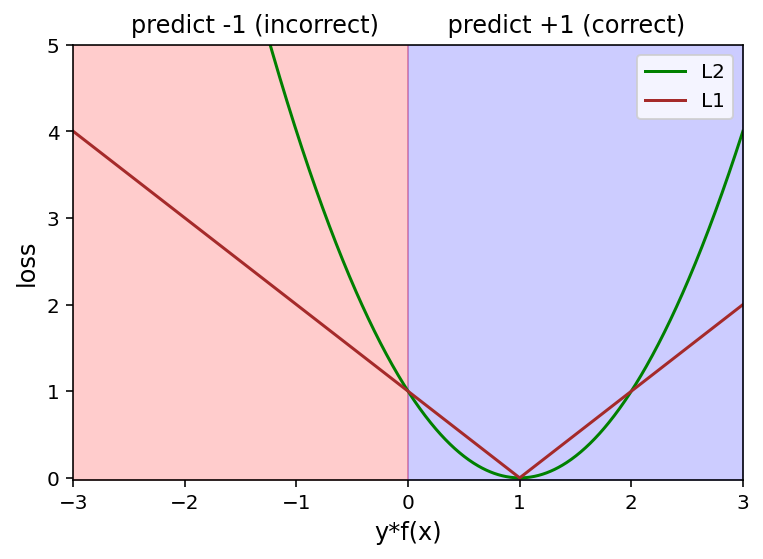

In [31]:
# Create a grid of values and plot
grid = np.linspace(-3,3,1000)
plt.plot(grid, l2(grid), "g", label='L2')
plt.plot(grid, l1(grid), "brown", label='L1')

plt.fill_between([0,3], y1=-0.02, y2=5,
                 color="b", alpha=0.2)
plt.fill_between([-3,0], y1=-0.02, y2=5,
                 color="r", alpha=0.2)
plt.xlim([-3,3])
plt.ylim([-0.02,5])
plt.xlabel("y*f(x)", fontsize=12)
plt.ylabel("loss", fontsize=12)
plt.title("predict -1 (incorrect)         predict +1 (correct)", fontsize=12)
plt.legend()

plt.show()

This does something reasonable for $y*f(x)\le1$.  However, look what happens at larger values (where we are even more confident that $y*f(x)$ is positive and that our class should be $+1$.  The loss goes **up**.  That's bad.

Now, you may be wondering how $y*f(x)$ can be larger than 1. Here's how this works.

$f(x)$ isn't just a value between $-1$ and $1$-- it is a function. For example, let's say that our training data looks like this (where `xx` are features and `yy` are class labels):

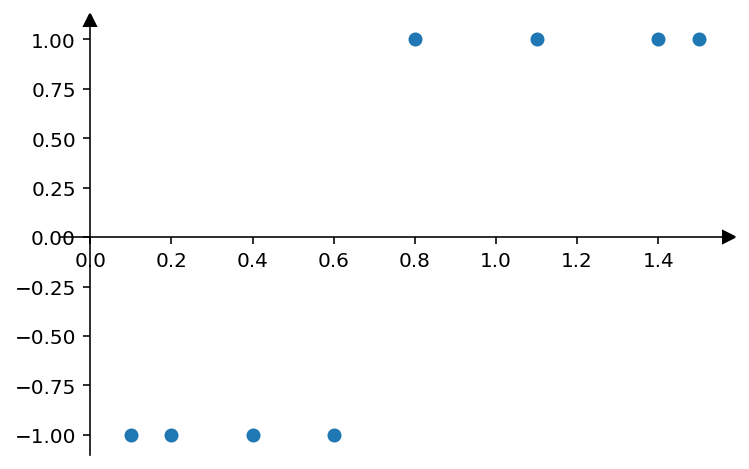

In [32]:
xx = np.array([0.1, 0.2, 0.4, 0.6,
               0.8, 1.1, 1.4, 1.5])
yy = np.array([-1, -1, -1, -1,
               1, 1, 1, 1])

if 1:
    
    fig = plt.figure(1)
    ax = fig.add_subplot(1, 1, 1)

    # Move left y-axis and bottim x-axis to centre, passing through (0,0)
    ax.spines['left'].set_position(('axes',0.045))
    ax.spines['bottom'].set_position('center')

    # Eliminate upper and right axes
    ax.spines['right'].set_color('none')
    ax.spines['top'].set_color('none')

    # Show ticks in the left and lower axes only
    ax.xaxis.set_ticks_position('bottom')
    ax.yaxis.set_ticks_position('left')
    
    ax.plot(1, 0, ">k", transform=ax.get_yaxis_transform(), clip_on=False)
    ax.plot(0, 1, "^k", transform=ax.get_xaxis_transform(), clip_on=False)
        
    ax.scatter(xx,yy)

Now let's fit a linear model to the training data:

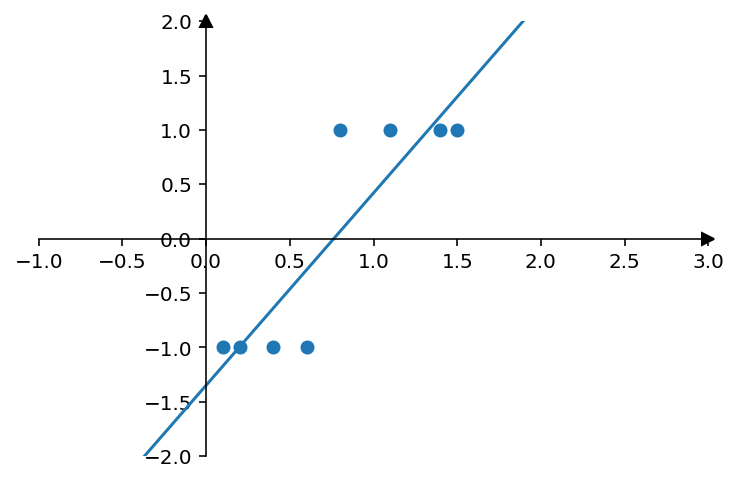

In [33]:
from sklearn.linear_model import LinearRegression

linreg = LinearRegression()
linreg.fit(xx[:,None],yy)
ypred = linreg.predict(grid[:,None])

if 1:
    
    fig = plt.figure(1)
    ax = fig.add_subplot(1, 1, 1)

    # Move left y-axis and bottim x-axis to centre, passing through (0,0)
    ax.spines['left'].set_position(('axes',0.25))
    ax.spines['bottom'].set_position('center')

    # Eliminate upper and right axes
    ax.spines['right'].set_color('none')
    ax.spines['top'].set_color('none')

    # Show ticks in the left and lower axes only
    ax.xaxis.set_ticks_position('bottom')
    ax.yaxis.set_ticks_position('left')
    
    ax.plot(1, 0, ">k", transform=ax.get_yaxis_transform(), clip_on=False)
    ax.plot(0, 1, "^k", transform=ax.get_xaxis_transform(), clip_on=False)
    
    ax.plot(grid,ypred)
    ax.set_xlim([-1,3])
    ax.set_ylim([-2,2])
        
    ax.scatter(xx,yy)

We see that for $x$ greater than about 1.3, $f(x)$ can indeed be larger than 1 and so can $y*f(x)$, which is indicating an increased certainty of the $+1$ class. 

OK, so now we can understand the plot, but we still need a loss function that makes sense for classification.

- The first we'll try is the so-called **["Zero-One Loss"](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.zero_one_loss.html)** shown in **black** below. It is 1 for $yf(x)<0$ and 0 for $yf(x)>0$; thus the name. You increment the loss function by 1 every time you make a wrong prediction. It is just a count of the total number of mistakes.

However, the Zero-One loss is hard to minimize, so instead we can try something that allows the loss to be continuous function in $y*f(x)$.  

- The **[Hinge Loss](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.hinge_loss.html)**, which looks like
$${\rm max}(0,1-y*f(x)),$$
is plotted in **orange**. Here there is no contribution to the loss for values $\ge 1$, but there is a linearly increasing loss for smaller values. So, it penalizes both wrong predictions and also correct predictions that have low confidence.

- A **[Logistic Loss](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.log_loss.html#sklearn.metrics.log_loss)** (also called the *log loss* and *cross entropy loss*) function has similar properties as shown in **blue**, but is smoother and has slightly less and less penalty for more and more confident $+1$ predictions.

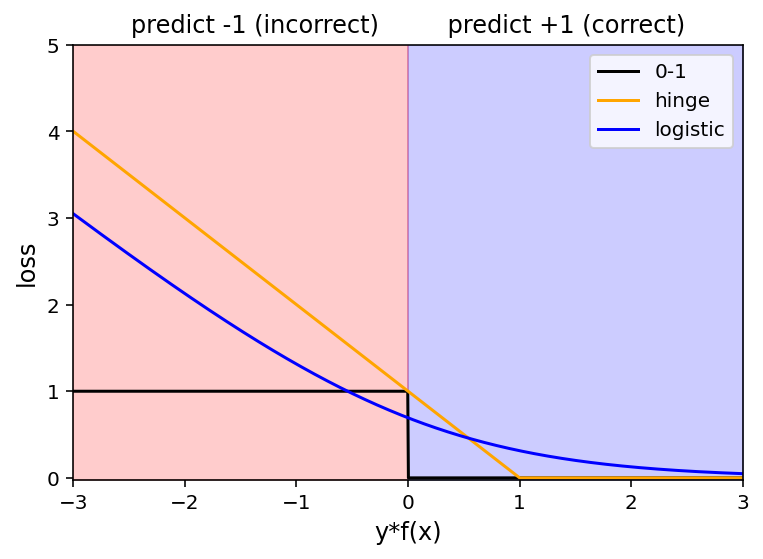

In [34]:
# Create a grid of values and plot
grid = np.linspace(-3,3,1000)

plt.plot(grid, zero_one(grid), "k", label='0-1')
plt.plot(grid, hinge_loss(grid), "orange", label='hinge')
plt.plot(grid, log_loss(grid), "b", label='logistic')

plt.fill_between([0,3], y1=-0.02, y2=5,
                 color="b", alpha=0.2)
plt.fill_between([-3,0], y1=-0.02, y2=5,
                 color="r", alpha=0.2)
plt.xlim([-3,3])
plt.ylim([-0.02,5])
plt.xlabel("y*f(x)",fontsize=12)
plt.ylabel("loss",fontsize=12)
plt.title("predict -1 (incorrect)         predict +1 (correct)",fontsize=12)
plt.legend()

plt.show()

## Common Loss Functions for Classification

### 1. Zero–One Loss
The 0–1 loss is  
$$
L_{0\text{-}1}(y, \hat y) =
\begin{cases}
0, & \text{if } y = \hat y,\\
1, & \text{if } y \neq \hat y.
\end{cases}
$$  
*Use-case:* Accuracy evaluation (non-differentiable, not used for gradient-based training).

---

### 2. Logistic (Cross‐Entropy) Loss

#### 2.1 Binary Cross‐Entropy  
For $y\in\{0,1\}$ and predicted probability $p = \hat p(y=1\mid x)$:
$$
L_{\rm log}(y, p)
= -\bigl[y\log p + (1-y)\log(1-p)\bigr].
$$

#### 2.2 Categorical Cross‐Entropy  
For $K$ classes with one-hot label vector $\mathbf{y}=(y_1,\dots,y_K)$ and predicted probabilities $\mathbf{p}=(p_1,\dots,p_K)$:
$$
L_{\rm CE}(\mathbf{y},\mathbf{p})
= -\sum_{k=1}^K y_k \,\log p_k.
$$

*Use-case:* Standard for logistic regression and neural nets with softmax output.

---

### 3. Hinge Loss

#### 3.1 Binary Hinge  
For labels $y\in\{-1,+1\}$ and score $f(x)$:
$$
L_{\rm hinge}(y, f(x))
= \max\bigl(0,\;1 - y\,f(x)\bigr).
$$

#### 3.2 Multi‐class Hinge (Crammer–Singer)  
Given scores $f_j(x)$ for each class $j$ and true class $y$:
$$
L_{\rm hinge\_mc}(y, \{f_j\})
= \max_{j \neq y}\Bigl[\,1 + f_j(x) - f_y(x)\Bigr]_+.
$$

*Use-case:* Support Vector Machines, large-margin classifiers.

---

### 4. Squared Hinge Loss
A smooth variant of hinge loss:
$$
L_{\rm sq\_hinge}(y, f(x))
= \bigl[\max(0,\;1 - y\,f(x))\bigr]^2.
$$

---

### 5. Exponential Loss
Used in AdaBoost:
$$
L_{\rm exp}(y, f(x))
= \exp\bigl(-y\,f(x)\bigr).
$$

---

### 6. Focal Loss
Adds a focusing term to cross-entropy (Lin et al. 2017):
$$
L_{\rm focal}(p_t)
= - (1 - p_t)^\gamma \,\log(p_t), 
\quad
p_t =
\begin{cases}
p & \text{if } y=1,\\
1-p & \text{if } y=0,
\end{cases}
$$
where $\gamma>0$ controls the focus on hard examples.

---

### 7. Kullback–Leibler (KL) Divergence
When matching distributions \(q\) and \(p\):
$$
L_{\rm KL}(q \,\|\, p)
= \sum_{k=1}^K q_k \,\log\frac{q_k}{p_k}.
$$

*Use-case:* Model distillation, distribution matching.

---

**Choosing a Loss:**  
- **Probabilistic models** (logistic regression, neural nets): use **cross-entropy**.  
- **Large-margin classifiers** (SVMs): use **hinge** or **squared hinge**.  
- **Imbalanced data**: consider **focal loss** or weighted cross-entropy.  
- **Boosting**: typically uses **exponential loss**.

For more see
- [Linear Classsifiers in Python course](https://learn.datacamp.com/courses/linear-classifiers-in-python).
- https://datascience103579984.wordpress.com/2019/09/18/linear-classifiers-in-python-from-datacamp/
- https://towardsdatascience.com/common-loss-functions-in-machine-learning-46af0ffc4d23
- https://www.analyticsvidhya.com/blog/2019/08/detailed-guide-7-loss-functions-machine-learning-python-code
- http://www.datasciencecourse.org/notes/linear_classification/

## Gradient Descent <a class="anchor" id="two"></a>

That brings us to the topic of **[Gradient Descent](https://en.wikipedia.org/wiki/Gradient_descent)** for finding the optimal extremal position of a cost function.

Throughout this couse we have been trying to determine model parameters, $\theta$, that minimize either the regression error or the classification error when fitting our training data (and not overfitting!). 

- Sometimes we have been able to write an analytic solution for $\theta$.
- In MCMC we semi-randomly sampled the multi-dimensional $\theta$ space to find the best answer (and map the full parameter posterior distribution along the way). 
- But what happens if you are stuck on top of a freezing cold mountain and you have no map and can't magically jump from place to place? You start walking **down**. That's the basic idea of ***gradient descent***--take a look around you, figure out which way is sloping downward the most and go *that* way.


![](https://upload.wikimedia.org/wikipedia/commons/c/c0/K2_Abruzzi_Spur.jpg)
*(For a pill of mountaineering history, this the parth used in the first ever successfull ascent to K2 in the Himalayas. It was accomplished by an Italian expedition in 1954 on the ridge that is now called the "Sperone degli Abruzzi").*




We are going to determine the local gradient of the loss function with respect to $\theta$ and go in the steepest direction, until the gradient is zero (and we have arrived at our destination).

Mathematically, for a simple linear model the MSE is defined as

$$ {\rm MSE}({\mathbf \theta}) = \frac{1}{N}(Y - X\theta)^T (Y - X\theta).$$

Therefore the partial derivative with respect to the vector of parameters $\theta$ is

$$\nabla_{\theta}{\rm MSE}({\mathbf \theta}) = \frac{2}{N}X^T(X\theta - Y).$$

That gives the uphill direction, but we want to move against the gradient, so we compute the next step as

$$\theta^{\rm next step} = \theta - \eta\nabla_{\theta}{\rm MSE}({\mathbf \theta}),$$

where $\eta$ is the **"learning rate"** and the rest are all matrices or vectors. 

- The initial values for $\theta$ are chosen randomly.
- The **[learning rate](https://en.wikipedia.org/wiki/Learning_rate)** controls how big your steps "down" are. 
- If your step size is too small, it will take too long to converge. 
- If it is too big, you might miss the bottom completely (and possibly end up diverging from the solution).  


![https://miro.medium.com/max/1400/0*GaO7X6j3coh3oNwf.png](https://miro.medium.com/max/1400/0*GaO7X6j3coh3oNwf.png)

We also have to be careful that we don't end up in a local minimum instead of the global minimum. One of the nice things about the $L2$ cost function is that it is guaranteed to have just a single global minimum. Gradient descent is also useful for regression where there are too many training points (or too many features) to fit into memory at a given time.

Here's an example from [Geron](https://github.com/ageron/handson-ml2) where we apply gradient descent to a simple linear regression problem.

In [42]:
np.random.seed(42)

# Run the next 4 cells
# N points randomly drawn from a linear distribution
N = 100
X = 2 * np.random.rand(N, 1)
y = 4 + 3 * X + np.random.randn(N, 1)

# Turn X into a matrix
X_b = np.c_[np.ones((100, 1)), X]  # add x0 = 1 to each 

# Grid for plotting
X_new = np.array([[0], [2]])
X_new_b = np.c_[np.ones((2, 1)), X_new]  # add x0 = 1 to each instance

X_b = np.c_[np.ones((100, 1)), X]  # add x0 = 1 to each instance

In [43]:
eta = 0.1  # learning rate
n_iterations = 100
theta = np.random.randn(2,1)  # random initialization

for iteration in range(n_iterations):
    gradients = 2/N * X_b.T.dot(X_b.dot(theta) - y)
    theta = theta - eta * gradients

In [44]:
n_lines=10
color_idx = np.linspace(0, 1, n_lines)

# Helper function
theta_path_bgd = []
def plot_gradient_descent(theta, eta, theta_path=None):
    m = len(X_b)
    plt.plot(X, y, "b.")
    n_iterations = 1000
    
    for iteration in range(n_iterations):
        if iteration < 10:
            y_predict = X_new_b.dot(theta)
            plt.plot(X_new, y_predict, color=plt.cm.cool(color_idx[iteration]))
            
        gradients = 2/m * X_b.T.dot(X_b.dot(theta) - y)
        theta = theta - eta * gradients
        if theta_path is not None:
            theta_path.append(theta)
            
    plt.xlabel("$x_1$", fontsize=18)
    plt.axis([0, 2, 0, 15])
    plt.title(r"$\eta = {}$".format(eta), fontsize=16)

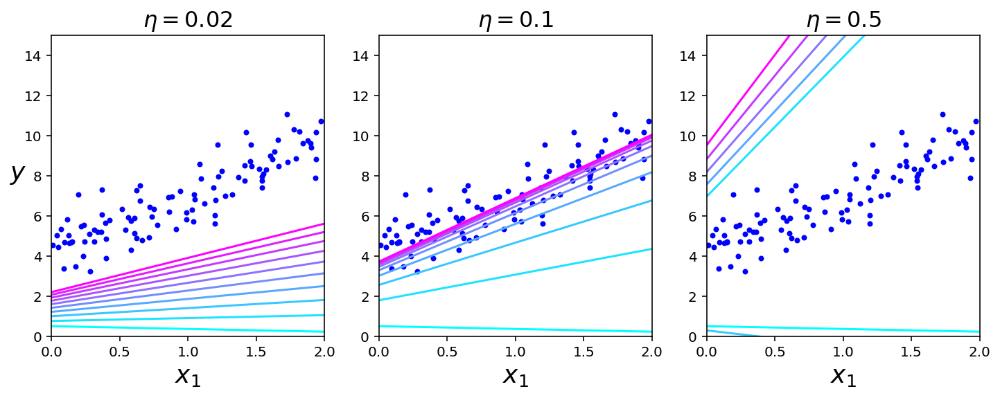

In [45]:
np.random.seed(42)
theta = np.random.randn(2,1)  # random initialization
plt.figure(figsize=(12,4))

plt.subplot(131); plot_gradient_descent(theta, eta=0.02)
plt.ylabel("$y$", rotation=0, fontsize=18)

plt.subplot(132); plot_gradient_descent(theta, eta=0.1, 
                                        theta_path=theta_path_bgd)
plt.subplot(133); plot_gradient_descent(theta, eta=0.5)
plt.show()

We've got a "three bears" scenario.

- On the left our learning rate is too low. We'll eventually get to the solution, but it will take a long time.  
- On the right it is too high and we have completely missed the solution.  
- In the middle the learning rate is just right.

**To do**: Let's try $\eta = 0.3$ and $0.4$ to see if we can understand what is going on in the right panel.

## AdaBoost <a class="anchor" id="three"></a>

When we introduced Boosting in *Classification II*, I didn't mention **[AdaBoost](https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.AdaBoostClassifier.html)** or **[Gradient Boosting](https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.GradientBoostingClassifier.html?highlight=gradient%20boosting#sklearn.ensemble.GradientBoostingClassifier)**, because it makes more sense to know about the other items above first. But ***AdaBoost = "Adaptive Boosting"***.

Below is an example of AdaBoost from [Geron](https://github.com/ageron/handson-ml2). See what happens when you change the learning rate, where half the learning rate means that weights are boosted half as much for each iteration.

In [46]:
# Run the next 3 cells
from sklearn.model_selection import train_test_split
from sklearn.datasets import make_moons

X, y = make_moons(n_samples=500, noise=0.30, random_state=42)
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=42)

In [18]:
#Helper function for plotting
from matplotlib.colors import ListedColormap
def plot_decision_boundary(clf, X, y, 
                           axes=[-1.5, 2.45, -1, 1.5], 
                           alpha=0.5, contour=True):
    x1s = np.linspace(axes[0], axes[1], 100)
    x2s = np.linspace(axes[2], axes[3], 100)
    x1, x2 = np.meshgrid(x1s, x2s)
    
    X_new = np.c_[x1.ravel(), x2.ravel()]
    y_pred = clf.predict(X_new).reshape(x1.shape)
    
    custom_cmap = ListedColormap(['#fafab0','#9898ff','#a0faa0'])
    plt.contourf(x1, x2, y_pred, alpha=0.3, cmap=custom_cmap)
    if contour:
        custom_cmap2 = ListedColormap(['#7d7d58','#4c4c7f','#507d50'])
        plt.contour(x1, x2, y_pred, cmap=custom_cmap2, alpha=0.8)
    plt.plot(X[:, 0][y==0], X[:, 1][y==0], "yo", alpha=alpha)
    plt.plot(X[:, 0][y==1], X[:, 1][y==1], "bs", alpha=alpha)
    
    plt.axis(axes)
    plt.xlabel(r"$x_1$", fontsize=18)
    plt.ylabel(r"$x_2$", fontsize=18, rotation=0)

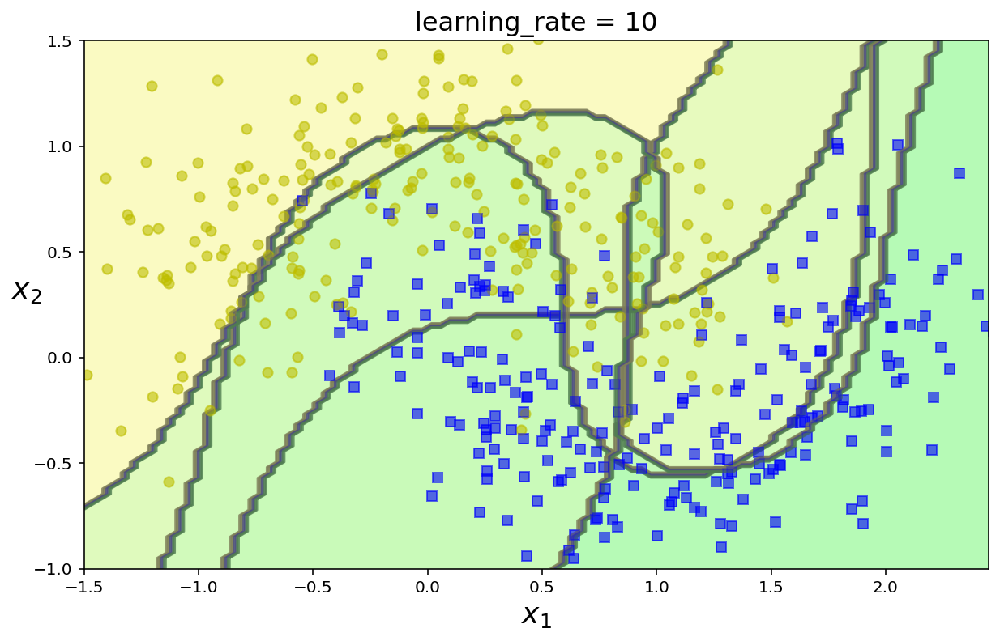

In [51]:
from sklearn.svm import SVC

learning_rate=10
m = len(X_train)

fix, axes = plt.subplots(ncols=1, figsize=(10,6))
sample_weights = np.ones(m)
for i in range(4):
    svm_clf = SVC(kernel="rbf", C=0.05, gamma="scale", random_state=42)
    svm_clf.fit(X_train, y_train, sample_weight=sample_weights)
    
    y_pred = svm_clf.predict(X_train)
    sample_weights[y_pred != y_train] *= (1 + learning_rate)
    
    plot_decision_boundary(svm_clf, X, y, alpha=0.2)
    plt.title("learning_rate = {}".format(learning_rate), fontsize=16)

plt.show()

**To do**: Let's try some learning rates between $0.1$ and $1.0$.  It is also important to note the order of these decision boundaries; that is, are they diverging?

---

# Neural Networks <a class="anchor" id="four"></a>

**[Artificial Neural Networks](https://en.wikipedia.org/wiki/Artificial_neural_network)** are a simplified computational architecture based loosely on the real neural networks found in brains.

![Neuron example](https://4.bp.blogspot.com/-Z5LfY6yoIcE/U-OFKWHoAbI/AAAAAAAAAKo/ytH6BzDLeo4/s1600/Picture-533.png)

The term "neural network" is overused and encompasses a huge variety of deep learning approaches. What we are going to explore is more properly called **[multi-layer perceptron](https://en.wikipedia.org/wiki/Multilayer_perceptron)**.

In the image below, 
- the circles on the ***left*** represent the **features/attributes** of our input data, $X$, which here is 3 dimensional.  
- the circles in the ***middle*** represent the **neurons**. They take in the information from the input and, based on some criterion decide whether or not to "fire". These middle layers are called "**hidden layers**".
- the collective results of the neurons in the hidden layer produce the **output**, $y$, which is represented by the circles on the ***right***, which here is 2 dimensional result.  
- the lines connecting the circles represent the synapses.  

This is a simple example with just one layer of neurons; however, there can be many layers of neurons.

![Cartoon of Neural Network](https://upload.wikimedia.org/wikipedia/commons/thumb/e/e4/Artificial_neural_network.svg/500px-Artificial_neural_network.svg.png)

### In more detail

The job of a synapse is to take input values and multiply them by some **weight**, $w$, and add a **bias**, $b$, before passing them to the neuron (hidden layer):

$$z = \sum_i w x_i + b$$

The bias determines the input level at which the neuron "fires". It is always present, and unique to each neuron, but we'll set that to zero for the sake of simplicity here.

The neuron then sums up the inputs from all of the synapses connected to it and applies an "**activation function**", e.g., a **[sigmoid](https://en.wikipedia.org/wiki/Sigmoid_function) activation function**.

$$a = \frac{1}{1+e^{-z}}.$$

![Sigmoid Function](https://upload.wikimedia.org/wikipedia/commons/thumb/8/88/Logistic-curve.svg/500px-Logistic-curve.svg.png)

> ***The neural network learns the weights and biases of the synapses that are needed to produce an accurate model of $y_{\rm train}$.***

![Ivezic Figure 9.17](https://www.astroml.org/_images/fig_neural_network_1.png)

- Rather than think about the inputs individually, we can write this process in matrix form as
$$Z^{(2)} = X W^{(1)}$$


- If $D$ is the number of attributes and $H$ is the number of neurons in the hidden layer, then $X$ is an $N\times D$ matrix, while $W^{(1)}$ is a $D\times H$ matrix.  The result, $Z^{(2)}$, is then an $N\times H$ matrix.


- We then apply the activation function to each entry of $Z^{(2)}$ independently: 
$$A^{(2)} = f(Z^{(2)}),$$
where $A^{(2)}$ is the output of the neurons in the hidden layer and is also $N\times H$.


- These values are then the inputs for the next set of synapses, where we multiply the inputs by another set of weights, $W^{(2)}:$
$$Z^{(3)} = A^{(2)} W^{(2)},$$
where $W^{(2)}$ is an $H\times O$ matrix and $Z^{(3)}$ is an $N\times O$ matrix with $O$-dimensional output.


- Another (potentially different type of) activation function is then applied to $Z^{(3)}$ to give
$$\hat{y} = g(Z^{(3)}),$$
which is our estimator of $y$.

---

For example we might have $N=100$ people with known height and weight, for whom we have measured

1. shoe size
2. belt size
3. hat size 

We are going to use this to predict the height and weight for people where we only know shoe size, belt size, and hat size.

The neural network essentially boils down to determining the weights and biases of the synapses, which are usually initialized randomly. We do that by minimizing the cost function (which compares the true values of $y$ to our predicted values).  Typically an MSE cost:

$$ {\rm Cost} = J = \sum\frac{1}{2}(y - \hat{y})^2.$$

If we just had 1 weight and we wanted to check 1000 possible values, that wouldn't be so bad. ***But...*** if we have 20 weights, that means checking $20^{1000}$ possible combinations. Remember the curse of dimensionality?  That might take a while. Indeed, far, far longer than the age of the Universe.

### Backpropagation

However some clever techniques have evolved out of realizing that we can write an **analytic formula for the *gradient* going backwards through the network, and use that to update our weights (and biases, of course)**.

For example, how about just checking 3 points for each weight and see if we can at least figure out which way is "down hill"? That's a start. We can rewrite $J$ as

$$ J = \sum\frac{1}{2}\left[y - g\left( f(X W^{(1)}) W^{(2)} \right) \right]^2$$

and then compute

$$\frac{\partial J}{\partial W}$$

in order to determine the slope of the cost function for each weight.  This is the **gradient descent** method, which we encountered before.  Your choice of cost function is important here; specifically you want it to be differentiable.

We'll want $\partial J/\partial W^{(1)}$ and $\partial J/\partial W^{(2)}$ separately. This allows us to ***[backpropagate](https://en.wikipedia.org/wiki/Backpropagation)*** the error contributions along each neuron and to change the weights where they most need to be changed.  It is like each observation gets a vote on which way is "down hill".  We compute the vector sum to decide the ultimate down hill direction.

Once we know the down hill direction from the derivative, we update the weights by subtracting a scalar (the *learning rate*) times that derivative from the original weights-- this is just gradient descent! This is obviously much faster than randomly sampling all the possible combinations of weights.  

I found Episode 4 of [Neural Networks Demystified](https://www.youtube.com/watch?v=bxe2T-V8XRs&list=PLiaHhY2iBX9hdHaRr6b7XevZtgZRa1PoU&ab_channel=WelchLabs) particularly clear on this!


In [22]:

from IPython.display import YouTubeVideo
YouTubeVideo('https://www.youtube.com/watch?v=GlcnxUlrtek&list=PLiaHhY2iBX9hdHaRr6b7XevZtgZRa1PoU&index=4&ab_channel=WelchLabs', width=1000, height=500)

### A computational digression

As you see, deep learning at the end of the day requires computing a ton of derivatives. Computing numerical derivatives is a tricky business. One could naively approximate

$$ f'(x) \sim \frac{f(x+ \Delta x) - f(x)}{\Delta x} $$

for a small value of $\Delta x$. If you try you'll quickly convince youself that this is numerically very unstable. One can use [finite difference methods](https://en.wikipedia.org/wiki/Finite_difference_method) of higer order that's not going to be viable for all the derivates a deep learning pipeline needs.

So why is deep learning so successfull and widely adopted? This is largely due to [automatic differentiation](https://en.wikipedia.org/wiki/Automatic_differentiation), which is in my opinion one of the smartest computational idea ever. 

The key idea is that a computer is a simple machine, even if the software we write can be very complicated. All a computer can do at the chip level are elementary arithmetic operations (addition, subtraction, multiplication, division, etc.) and elementary functions (exp, log, sin, cos, etc.). Given a complicated piece of software, one can track the (very long!) lists of elemetary function that are required to reproduce the result. With this list, computing a derivative is just a long but trivial application of the chain rule. In practice, this means that derivates of any oder can be computed accurately to working precision very quickly.

The other computational revolution behind the success of deep learning is the exploitation of [Graphic processing units (GPUs)](https://en.wikipedia.org/wiki/Graphics_processing_unit) instead of [Central processing units (CPUs)](https://en.wikipedia.org/wiki/Central_processing_unit). CPUs are the standard silicon chips used by all computers, including your laptopt. GPUs are graphic boards designed for expensive video rendering (the market is largely driven  by gaming professionals). It turns out they're extremely good at matrix multiplication, and deep learning has lots of matrices.



***Once the weights and biases are set through training, you've got your Neural Network classifier/regressor.***

![Ivezic Figure 9.17](https://www.astroml.org/_images/fig_neural_network_1.png)

Scikit-Learn has both **[unsupervised Neural Network](http://scikit-learn.org/stable/modules/neural_networks_unsupervised.html#neural-networks-unsupervised)** and **[supervised Neural Network](http://scikit-learn.org/stable/modules/neural_networks_supervised.html#neural-networks-supervised)** examples. 

Let's try to use the **multi-layer perceptron classifier** on the Boston House Price dataset (using 75% of the data for training and 25% for testing).

In [52]:
from sklearn.datasets import load_boston 
from sklearn.model_selection import train_test_split
from sklearn import preprocessing

boston = load_boston()

X = boston.data
y = boston.target

Xtrain, Xtest, ytrain, ytest = train_test_split(X, y, test_size=0.25, random_state=42)

Xtrain_scaled = preprocessing.scale(Xtrain)
Xtest_scaled = preprocessing.scale(Xtest)
Xscaled = preprocessing.scale(X)

/Users/dgerosa/box/lib/python3.8/site-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function load_boston is deprecated; `load_boston` is deprecated in 1.0 and will be removed in 1.2.

    The Boston housing prices dataset has an ethical problem. You can refer to
    the documentation of this function for further details.

    The scikit-learn maintainers therefore strongly discourage the use of this
    dataset unless the purpose of the code is to study and educate about
    ethical issues in data science and machine learning.

    In this special case, you can fetch the dataset from the original
    source::

        import pandas as pd
        import numpy as np

        data_url = "http://lib.stat.cmu.edu/datasets/boston"
        raw_df = pd.read_csv(data_url, sep="\s+", skiprows=22, header=None)
        data = np.hstack([raw_df.values[::2, :], raw_df.values[1::2, :2]])
        target = raw_df.values[1::2, 2]

    Alternative datasets include the California housing datase

[(13, 5), (5, 2), (2, 1)]


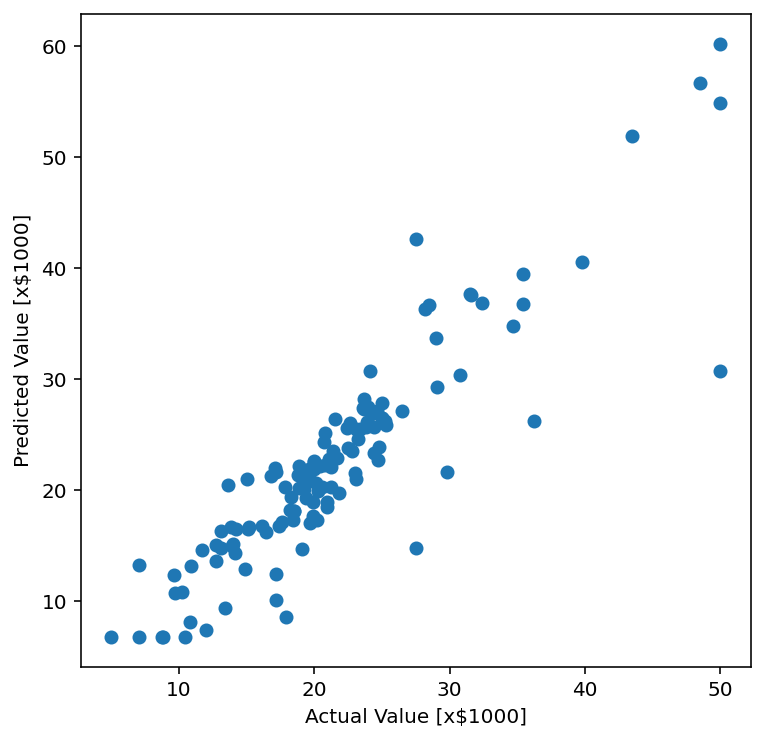

In [53]:
from sklearn.neural_network import MLPRegressor
    
clf = MLPRegressor(solver='lbfgs', alpha=1e-5, 
                   hidden_layer_sizes=(5,2), 
                   random_state=1, max_iter=5000)
clf.fit(Xtrain_scaled, ytrain)

# Look at the weights
print([coef.shape for coef in clf.coefs_])

ypred = clf.predict(Xtest_scaled)

fig = plt.figure(figsize=(6, 6))
plt.scatter(ytest,ypred)
plt.xlabel("Actual Value [x$1000]")
plt.ylabel("Predicted Value [x$1000]")
plt.show()

Of course, that only predicts the value for a fraction of the data set. Again, we can use Scikit-Learn's [cross_val_predict](http://scikit-learn.org/stable/modules/generated/sklearn.model_selection.cross_val_predict.html#sklearn.model_selection.cross_val_predict) to make predictions for the full data set.

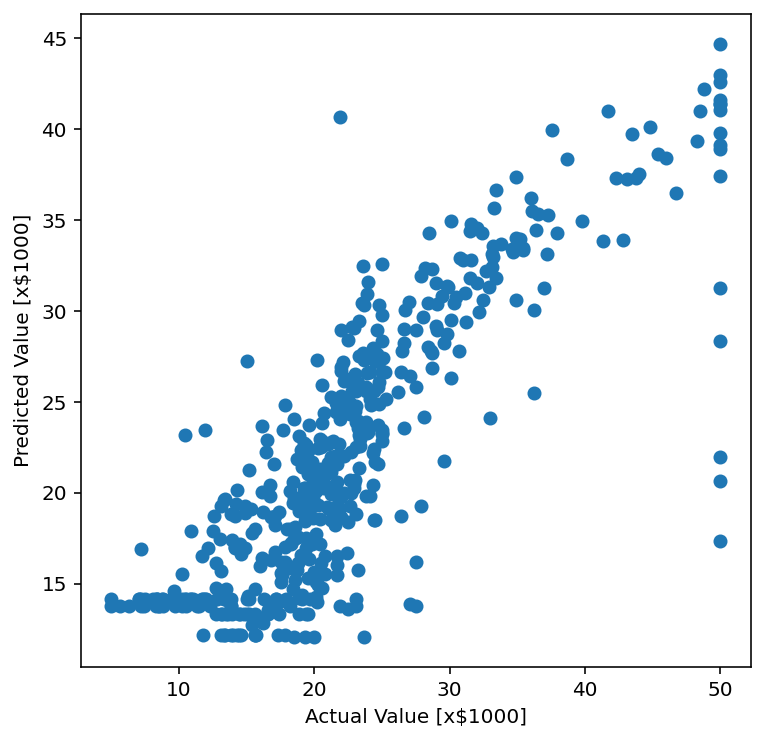

In [54]:
from sklearn.model_selection import cross_val_predict

yCVpred = cross_val_predict(clf, X, y, cv=5) # Complete

fig = plt.figure(figsize=(6, 6))
plt.scatter(y,yCVpred)
plt.xlabel("Actual Value [x$1000]")
plt.ylabel("Predicted Value [x$1000]")
plt.show()

Just as with other model hyperparameters, we can use cross-validation to determine the optimal number of layers, neurons per layer, etc. But for now, let's talk about some guidelines.

### Number of Layers

*Ivezic*: 

> "*For data that can be represented by a linear model, no layers are required (McCullagh & Nelder 1989).  A single layer network can approximate any continuous function.  Two layers can represent arbitrary decision boundaries for smooth functions (Lippmann 1987).  More layers can represent non-continuous or complex structure within the data.*"  

Think about why no layers are needed for linear regression.  We just connect our input to the output where the synapses are the weights (slopes) and the output neurons add the constant (intecept).

So you might start with a single layer, then add more layers and use cross-validation to determine when you are overfitting.

Say you had to draw a whole forest, but you couldn't cut and paste anything.  That would be very tedious.  But if you could draw just one leaf and copy that to make a small branch, then scale up a small branch to a big branch and copy that, then attach the branches to a tree trunk and then make copies of the full tree, you wouldn't have to draw all that much. **Each of the layers in a neural network handles more and more detailed aspects of the problem.**  

For image recognition, you might need dozens of layers, but also a huge training set to populate those layers.

### Number of Neurons

The number of neurons in each layer is also a free parameter. 

- ***Typically choose somewhere between twice the number of input nodes and a number between the number of input and output nodes.***


- If there are lots hidden layers (where "lots" is not clearly defined) then we call that a **deep neural network or [deep learning](https://en.wikipedia.org/wiki/Deep_learning)**. 


- Sometimes the number of neurons in each layer goes down.  But it can also be useful to have the same number in each layer so that there is only one hyperparameter (the number of neurons) and not one per layer.


- In practice a reasonable approach is to simply **specify many more layers and neurons than you need and perform regularization**. This can be as simple as just stopping the training when the cross-validation error reaches a minimum, which appropriately (for once) is called **[early stopping](https://en.wikipedia.org/wiki/Early_stopping)**.


While the number of neurons in the hidden layers are free parameters the number of input and output nodes are constrained by the data and the desired output.  For example, the MNIST digits data requires 784 input neurons (one for each pixel in the 28x28 images) and 10 output neurons (one for each class [digit]).  



### Activation Functions

The **[Activation function](https://en.wikipedia.org/wiki/Activation_function)** controls how much "signal" it takes for a neuron to "fire".  The more signal, the more likely the neuron will fire. See https://mlfromscratch.com/activation-functions-explained/#/

The cells below show different activation functions, using the same visualization as we used for loss functions.

In [57]:
# Mathematical formulas for activation functions
  
def binary(raw_model_output):
    return np.where(raw_model_output < 0, 
                    0, 
                    1)  

def sigmoid(raw_model_output):
    return 1.0 / (1 + np.exp(-raw_model_output))

def ReLU(raw_model_output):
    return np.where(raw_model_output < 0, 
                    0, 
                    raw_model_output)

def LReLU(raw_model_output):
    alpha=0.1
    return np.where(raw_model_output < 0, 
                    alpha*raw_model_output, 
                    raw_model_output)

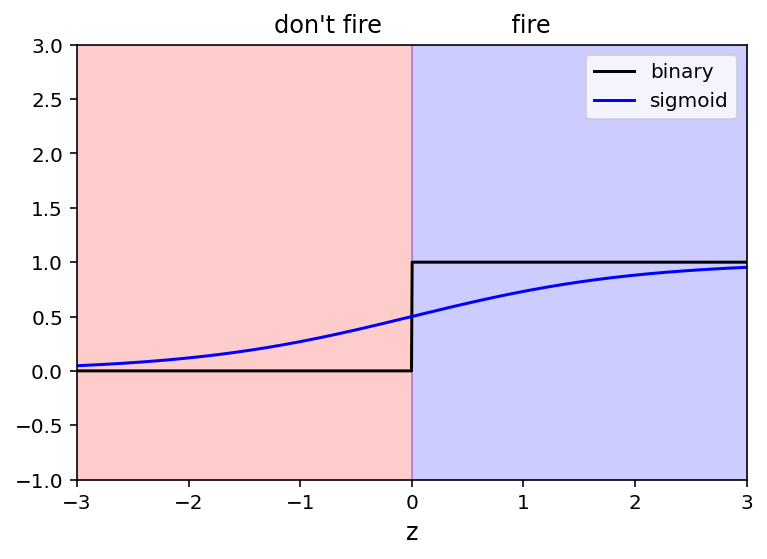

In [58]:
# Create a grid of values and plot
grid = np.linspace(-3,3,1000)
#plt.plot(grid, log_loss(grid), label='logistic')
plt.plot(grid, binary(grid), "k", label='binary')
plt.plot(grid, sigmoid(grid), "b", label='sigmoid')
#plt.plot(grid, ReLU(grid), label='ReLU')
#plt.plot(grid, LReLU(grid), label='LReLU')
#plt.plot(grid, l2(grid), label='L2')
#plt.plot(grid, l1(grid), label='L1')

plt.fill_between([0,3], y1=-1, y2=3, 
                 color="b", alpha=0.2)
plt.fill_between([-3,0], y1=-1, y2=3, 
                 color="r", alpha=0.2)
plt.xlim([-3,3])
plt.ylim([-1,3])
plt.xlabel("z",fontsize=12)
plt.title("don't fire                 fire",fontsize=12)
plt.legend()

plt.show()

"*On vs. Off*" activation actually isn't quite true or what we want. The way your eyes work is that you need 1-10 photons to trigger a rod, but several rods must be triggered to send a signal to the brain. The sigmoid activation function captures the probabilistic nature of neuron firing. More importantly it is differentiable, so can be used for backpropagation.

Another important aspect of non-linear activation functions is that they are what allow neural networks to solve non-linear problems.  If we used a strictly linear activation function, then we could only solve linear problems.  That is, you could fit a straight line, but not an exponential.


#### Vanishing and Exploding Gradients

However, neural network research suffered significant limitations and problems at the hands of the [vanishing and exploding gradients](https://en.wikipedia.org/wiki/Vanishing_gradient_problem) problem.  We won't go into detail there except to say that ***around 2010 there were suggestions for different activation functions that were published.***  

- For example, the **[Rectified Linear Unit (ReLU) activation function](https://www.wikiwand.com/en/Rectifier_(neural_networks))** is another commonly used activation function as it solves the vanishing gradient problem (since the gradient is only 0 or 1).
$${\rm ReLU}(z) = max(0,z)$$


- It isn't ideal both because the derivative is 0 for $z<0$ and it can end up producing dead nodes. However, it is fast and the resulting sparsity can be good (sort of like regularization).


- A number of papers since 2015 describe various improvements, including the **Leaky ReLU**, **Randomized Leaky ReLU**,  the **exponential linear unit (ELU)**, and **scaled exponential linear unit (SELU)**.


Note that the activation functions can be different in different layers.  For example, for regression, one typically doesn't use any activation function in the output layer as including one would restrict the range of possible outputs.

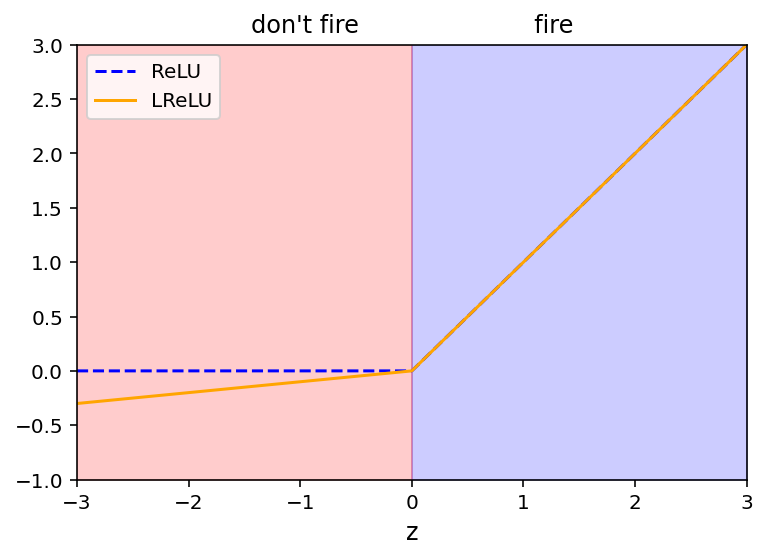

In [28]:
# Create a grid of values and plot
grid = np.linspace(-3,3,1000)
#plt.plot(grid, log_loss(grid), label='logistic')
#plt.plot(grid, binary(grid), "k", label='binary')
#plt.plot(grid, sigmoid(grid), "b", label='sigmoid')
plt.plot(grid, ReLU(grid), "b--", label='ReLU')
plt.plot(grid, LReLU(grid), "orange", label='LReLU')
#plt.plot(grid, l2(grid), label='L2')
#plt.plot(grid, l1(grid), label='L1')

plt.fill_between([0,3], y1=-1, y2=3, 
                 color="b", alpha=0.2)
plt.fill_between([-3,0], y1=-1, y2=3, 
                 color="r", alpha=0.2)
plt.xlim([-3,3])
plt.ylim([-1,3])
plt.xlabel("z",fontsize=12)
plt.title("don't fire                       fire",fontsize=12)
plt.legend()

plt.show()

Some general guidance on activation functions:
    
* **Use sigmoid (or softmax) for output of classification (with binary cross entropy loss)**


* **Use ReLU for regression on layers other than output (at least to start with because it is faster)**

### Regularization

Just as we can use regularization for standard regression and classification tasks, so too can we with neural networks.  

Not only can we apply the usual $L1$ (LASSO) or $L2$ (Ridge) regularization techniques, we can also use **dropout** which, as the name indicates, causes some neurons to be temporarily "dropped out" during training (usually by setting some probability for that to happen, typically 10-50%). After training, all of the neurons are used.

[Geron](https://www.oreilly.com/library/view/hands-on-machine-learning/9781492032632/) explains this in terms of a company needing to try to figure out how to adapt to a crucial employee being out sick for a period of time.  In the end, it can make the company stronger as more people (neurons) are able to handle certain parts of the process.


### Batch normalization

Just as it is often necessary to normalize or standardize our features, sometimes it is helpful to do the same to the output of the hidden layers.  This is called **[batch normalization](https://en.wikipedia.org/wiki/Batch_normalization)** and is done before passing the data to the activation function.  It make the process more stable and can also make it faster.  We'll do an example next time. 


### Data augmentation

Sometimes, transforming your data can result in a better fit; this is called **[data augmentation](https://en.wikipedia.org/wiki/Data_augmentation)** For instance, instead of feeding $x$, you can feed $x$ and $x^2$. This is particularly powerful when training on images. One can produce more training data by just rotating the available images. This helps the network in generalizing to the truly important features.

### Faster Optimizers

We aren't going to talk about optimizers, but it might be useful for you to have some options to feed into a search for the best parameter using cross validation.  For example **`['adam', 'sgd', 'adagrad']`**.

## Mind your set. Training, validation, and test.

As you see, a deep-learning implementations can have tens of hyperparameter (learning rate, number of layers, number of neurons per layer, free parameters in the activation function, batch size, regularization parameters, optimizer, dropouts, etc). This is where having a test set can save you from subtle overfitting.

- The parameters are inferred from the training set
- Performance is evaluated on the validation set. The developer (i.e. you!) uses this to tune the hyperparameters and obtain the best network.
- Once averything is decided and set in stone, the overall perfomance needs to be evaluated on an external test set (this is sometimes called "anallysis unblinding").


## Time to get your hands dirty. The Tensorflow playground.


Today we'll play with the TensorFlow playground. We'll see it next time, but Tensorflow is one of the main open-source deep learning libraries.

The playground provides some datasets and let you see what's going on during the training process in a nice, intuitive way. 

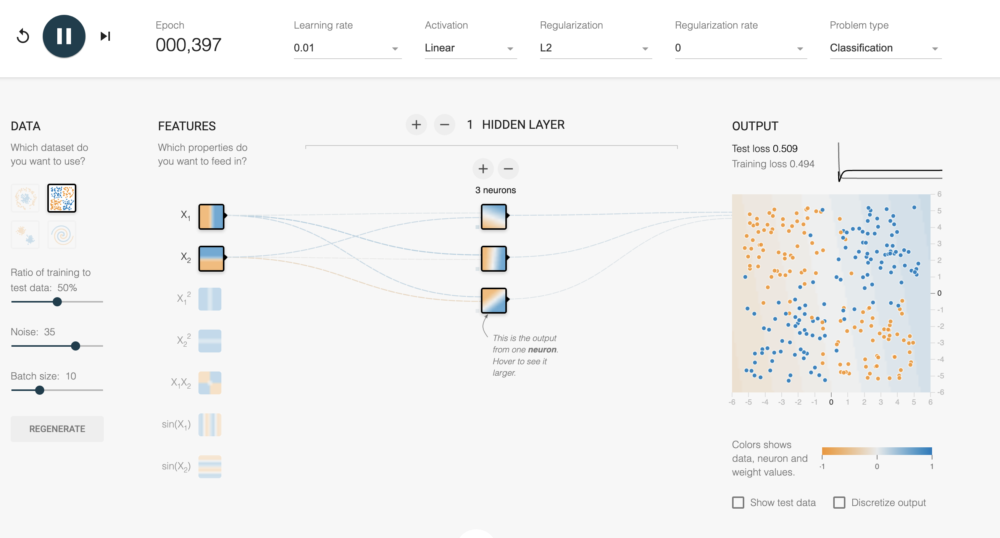

- We have a function $f(x_1,x_2)$ that returns +1 (blue) or -1 (organge).
- We are given a dataset and split it into training and testing. 
- Hit play, and the network starts training.
- The thickness of the line tells you how much that synapis contributes to the training.
- You can monitor progress on the top-right.
- The goal of the game is to minimize the loss function **on the test set** (I don't care about the loss function on the training set!).
- You can change everything but the type of problem, the test/train ratio, and the noise level.
- So feel free to play with activation function, number of layers, number of neuron per layers, learning rate, regularization, incoming features (data augmentation), etc. 


1) Let's start from [this dataset](https://playground.tensorflow.org/#activation=linear&regularization=L2&batchSize=10&dataset=xor&regDataset=reg-plane&learningRate=0.01&regularizationRate=0&noise=35&networkShape=1&seed=0.50246&showTestData=false&discretize=false&percTrainData=50&x=true&y=true&xTimesY=false&xSquared=false&ySquared=false&cosX=false&sinX=false&cosY=false&sinY=false&collectStats=false&problem=classification&initZero=false&hideText=false). Try to get the lowest score on the test set. Take a screenshot or we won't believe you! Let's draw a leaderboard.

2) Then move on to [this dataset](https://playground.tensorflow.org/#activation=relu&regularization=L2&batchSize=10&dataset=spiral&regDataset=reg-plane&learningRate=0.1&regularizationRate=0.01&noise=50&networkShape=3,2&seed=0.65406&showTestData=false&discretize=false&percTrainData=50&x=true&y=true&xTimesY=false&xSquared=false&ySquared=false&cosX=false&sinX=false&cosY=false&sinY=false&collectStats=false&problem=classification&initZero=false&hideText=false), which is more challenging. 

[My solution](https://github.com/dgerosa/astrostatistics_bicocca_2024/blob/main/solutions/S19_tensorflowplayground). Could anyone do better?

### Before next time

Please install the following deep learning libraries:

`pip install tensorflow`

`pip install torch torchvision`

It might take a while and you might need time to sort out errors, so please do it in advance.

# Feedback!

Please help me with this class! I want to make it better!

https://forms.gle/2xPGGx3WgJHCYtnf9


----

# Deep Learning: II

*Davide Gerosa (Milano-Bicocca)* 

##### Reading/watching

- [Textbook](http://press.princeton.edu/titles/10159.html) Chapter 9.
- [Neural Networks Demystified](https://www.youtube.com/watch?v=bxe2T-V8XRs&list=PLiaHhY2iBX9hdHaRr6b7XevZtgZRa1PoU&ab_channel=WelchLabs) youtube playlist.

##### Dig deeper:

- ["Hands-On Machine Learning with Scikit-Learn, Keras, and TensorFlow", Aurelien Geron](https://www.oreilly.com/library/view/hands-on-machine-learning/9781492032632/). 
-  ["Neural Networks and Deep Learning"](http://neuralnetworksanddeeplearning.com/index.html). Free online book!
- Many many blogs and videos. Deep learning as a million applications that go well beyond astrophysics. There is truly excellent content accessibile out there with just a tiny bit of googling.

This course is based on previous work by many people. See [here]((https://github.com/dgerosa/astrostatistics_bicocca_2024/blob/main/README.md) for credits.

---

Before starting today, let's install the two big Deep Learning packages out there. [Tensorflow](https://www.tensorflow.org/) and [PyTorch](https://pytorch.org/)-- the rivalry essentially boils down to Google versus Facebook. These are the public deep learning implementation of giant companies.

In general, I find TensorFlow more customizable and there are excellent tutorials around! Tensorflow is somewhat less readable while coding in Pytorch is a more "pythonic" experience (some operations feel more natural). But it's really a matter of taste here... In my research group we joined the Google camp and use TensorFlow. 


In [1]:
!pip install --upgrade pip

#### Tensorflow

In [2]:
!pip3 install tensorflow

#### PyTorch

In [3]:
!pip3 install torch torchvision

#### Keras

**[Keras](https://keras.io/)** is a deep learning API. Essentially it is Scikit-Learn for deep neural networks.

Keras needs a computational backend to handle the heavy computation.  Three popular (open sources) deep learning libraries are [TensorFlow](https://www.tensorflow.org/), Microsoft Cognitive Toolkit, and [Theano](http://www.deeplearning.net/software/theano/). TensorFlow now comes bundled with a version of Keras and that's what we'll use here (actually TensorFlow 2). PyTorch is another option. If you apply for a data-science job in industry knowing one of these tools might be the most useful thing for you to have learned.

In short, for neural networks:

> numpy -> tensorflow

> sklearn -> keras

In the same way that you can build a linear regression algorithm in numpy without using sklearn, you can build a neural network algorithm (not to mention linear regression) in tensorflow without using keras.  But just as sklearn makes our life easier, so too does keras.


Crucially, these libraries work with automatic differentiation. We won't call the autodiff modules explicitely but they are [tensorflow.GradientTape](https://www.tensorflow.org/api_docs/python/tf/GradientTape) and [torch.autograd](https://pytorch.org/tutorials/beginner/blitz/autograd_tutorial.html).


## Photo-z with deep learning <a class="anchor" id="one"></a>

An important problem in galaxy imaging is being able to use observed galaxy color data to estimate its redshift. This is sometimes called "photo-z". Now, on your humble computer, you will build a deep neural network that is trained on a sample of SDSS galaxy color data. You'll see that `pytorch` makes this quite easy.

In [4]:
import numpy as np
from matplotlib import pyplot as plt
%matplotlib inline
%config InlineBackend.figure_format='retina'

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.utils.data as torchdata

from astroML.datasets import fetch_sdss_specgals
from astroML.utils.decorators import pickle_results

from astroML.plotting import setup_text_plots
setup_text_plots(fontsize=8, usetex=False)

Read in and prepare the SDSS data.

In [5]:
# Fetch and prepare the data
data = fetch_sdss_specgals()

# put magnitudes into array
# normalize to zero mean and unit variance for easier training
datanormed = np.zeros((len(data), 6), 
                      dtype=np.float32)
for i, band in enumerate(['u', 'g', 'r', 'i', 'z']):
    band = 'modelMag_' + band
    datanormed[:, i] = ((data[band] - data[band].mean()) / 
                        data[band].std())

# put redshifts into array
datanormed[:, 5] = data['z']

Let's define a little helper class that will make our network. It is initialized with a given number of neurons in the single hidden layer. These neurons in the hidden layer connect to $5$ input variables (colors) and spits out 1 variable (redshift). You can also see that it uses ReLU activation for the neurons.

In [6]:
# define structure of neural net
class Net(nn.Module):
    def __init__(self, nhidden):
        super(Net, self).__init__()
        self.fc_h = nn.Linear(5, nhidden)
        self.fc_o = nn.Linear(nhidden, 1)

    def forward(self, x):
        h = F.relu(self.fc_h(x))
        z = self.fc_o(h)
        return z

Do a train-test split on the data.

In [7]:
# split data into 9:1 train:test
dataset = torchdata.TensorDataset(torch.tensor(datanormed[:, 0:5]),
                                  torch.tensor(datanormed[:, 5]).view(-1, 1))
trainnum = datanormed.shape[0] // 10 * 9
traindata, testdata = torchdata.random_split(dataset, 
                                             [trainnum, datanormed.shape[0] - trainnum])
traindataloader = torchdata.DataLoader(traindata, 
                                       batch_size=128, 
                                       shuffle=True)

Define a function to train the neural network. This looks like a lot of code, but the first block is the key. The network will have $4$ neurons in the hidden layer, and will use stochastic gradient descent to train the weights and biases.

In [8]:
@pickle_results('NNphotoz.pkl')
def train_NN():
    # 4 hidden layers
    model = Net(4)
    # MSE loss
    criterion = torch.nn.MSELoss(reduction='sum') 
    # stochastic gradient descent
    optimizer = torch.optim.SGD(model.parameters(), lr=0.001) 
    # Adaptive learning rate...
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, 
                                                           verbose=True, 
                                                           patience=5, 
                                                           threshold=1e-3)

    min_valid_loss = float('inf')
    badepochs = 0
    for t in range(100):
        train_loss = 0
        for i, databatch in enumerate(traindataloader, 0):
            photometry, redshifts = databatch
            optimizer.zero_grad()
            z_pred = model(photometry)
            loss = criterion(z_pred, redshifts)
            loss.backward()
            optimizer.step()
            train_loss += loss.item()

        with torch.no_grad():
            photometry = testdata[:][0]
            redshifts = testdata[:][1]
            z_pred = model(photometry)
            valid_loss = criterion(z_pred, redshifts)
            if t % 10 == 0:
                print('Epoch %3i: train loss %0.3e validation loss %0.3e' % (t, \
                        train_loss / len(traindata), valid_loss / len(testdata)))
            # stop training if validation loss has not fallen in 10 epochs
            if valid_loss > min_valid_loss*(1-1e-3):
                badepochs += 1
            else:
                min_valid_loss = valid_loss
                badepochs = 0
            if badepochs == 10:
                print('Finished training')
                break
        scheduler.step(valid_loss)
    return model

Let's train this thing. It should take about five minutes. 

In [10]:
model = train_NN()

@pickle_results: using precomputed results from 'NNphotoz.pkl'


In [11]:
print(model)

Net(
  (fc_h): Linear(in_features=5, out_features=4, bias=True)
  (fc_o): Linear(in_features=4, out_features=1, bias=True)
)


Plot the results.

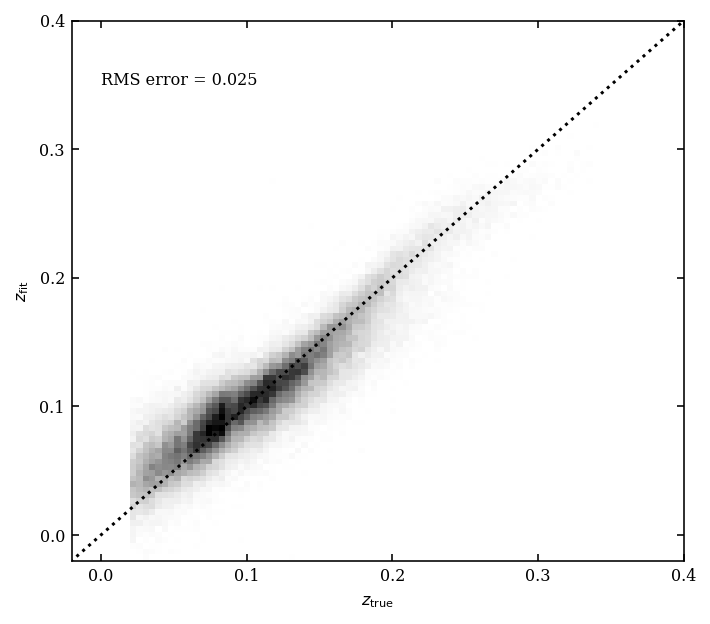

In [12]:
# plot the results
with torch.no_grad():
    photometry = testdata[:][0]
    redshifts = testdata[:][1]
    z_pred = model(photometry)
    fig = plt.figure(figsize=(5, 5))
    fig.subplots_adjust(wspace=0.25,
                        left=0.1, right=0.95,
                        bottom=0.15, top=0.9)

    ax = plt.axes()
    H, zs_bins, zp_bins = np.histogram2d(redshifts.numpy().flatten(), 
                                         z_pred.numpy().flatten(), 151)
    ax.imshow(H.T, origin='lower', interpolation='nearest', aspect='auto',
               extent=[zs_bins[0], zs_bins[-1], zp_bins[0], zp_bins[-1]],
               cmap=plt.cm.binary)
    ax.plot([-0.1, 0.4], [-0.1, 0.4], ':k')
    rms = np.sqrt(np.mean((z_pred-redshifts).numpy()**2))
    
    ax.text(0, 0.35, 'RMS error = %0.3f' % np.sqrt(np.mean((z_pred-
                                                            redshifts).numpy()**2)))
    ax.set_xlim(-0.02, 0.4001)
    ax.set_ylim(-0.02, 0.4001)
    ax.xaxis.set_major_locator(plt.MultipleLocator(0.1))
    ax.yaxis.set_major_locator(plt.MultipleLocator(0.1))
    
    ax.set_xlabel(r'$z_{\rm true}$')
    ax.set_ylabel(r'$z_{\rm fit}$')
    
    plt.show()

Not bad at all! Still, this was a relatively simple fully-connected network. Other problems will require more complexity...

## Another multilayer perceptron example

Let's go back to the dataset we used last week, when we classified gravitational-wave sources based on their LIGO detectability. I had previously tackled this problem using a multi-layer perceptron: https://arxiv.org/abs/2007.06585. This was implemented using TensorFlow

In [14]:
import deepdish
import os
import tensorflow as tf
from tensorflow import keras


def sperical_to_cartesian(mag,theta,phi):
    '''
    Convert spherical to cartesian coordinates
    '''
    coordx = mag * np.cos(phi) * np.sin(theta)
    coordy = mag * np.sin(phi) * np.sin(theta)
    coordz = mag * np.cos(theta)
    return coordx,coordy,coordz

massvar = ['mtot','q','z']
spinvar = ['chi1x','chi1y','chi1z','chi2x','chi2y','chi2z']
intrvar=massvar+spinvar
extrvar = ['iota','ra','dec','psi']
train_variables=intrvar+extrvar

def lookup_limits():
    '''
    Define the limits in all variables. If you want to change this, please check generate_binaries() and pdet() as well.
    '''

    limits={
        'mtot'  : [2,1000],
        'q'     : [0.1,1],
        'z'     : [1e-4,4],
        'chi1x'  : [-1,1],
        'chi1y'  : [-1,1],
        'chi1z'  : [-1,1],
        'chi2x'  : [-1,1],
        'chi2y'  : [-1,1],
        'chi2z'  : [-1,1],
        'iota'  : [0,np.pi],
        'ra'    : [-np.pi,np.pi],
        'dec'   : [-np.pi/2,np.pi/2],
        'psi'   : [0,np.pi]
        }

    return limits


def store_binaries(filename, N, approximant='IMRPhenomXPHM', noisecurve='design', SNRthreshold=12):
    ''' Generate binaries, compute SNR, and store'''

    inbinaries = generate_binaries(N)
    outbinaries = evaluate_binaries(inbinaries, approximant, noisecurve, SNRthreshold)

    deepdish.io.save(filename,outbinaries)
    return filename

def readsample(filename='sample.h5'):
    '''
    Read a validation sample that already exists
    '''
    return deepdish.io.load(filename)

def splittwo(binaries):
    '''
    Split sample into two subsamples of equal size
    '''

    one={}
    two={}
    for k in train_variables+['snr','det']:
        one[k],two[k] = np.split(binaries[k],2)
    one['N'],two['N']= len(one['mtot']),len(two['mtot'])

    return one,two


def rescale(x,var):
    '''
    Rescale variable sample x of variable var between -1 and 1
    '''

    limits=lookup_limits()
    if var not in limits:
        raise ValueError

    return 1-2*(np.array(x)-min(limits[var]))/(max(limits[var])-min(limits[var]))


def nnet_in(binaries):
    '''
    Prepare neural network inputs.
    '''

    return np.array([rescale(binaries[k],k) for k in train_variables]).T

def nnet_out(binaries, which='detnetwork'):
    '''
    Prepare neural network outputs.
    '''

    return binaries['det']


def trainnetwork(train_binaries,test_binaries,filename='trained.h5'):

    if not os.path.isfile(filename):

        train_in  = nnet_in(train_binaries)
        train_out = nnet_out(train_binaries)
        test_in  = nnet_in(test_binaries)
        test_out = nnet_out(test_binaries)

        # Kernel initializer
        my_init = keras.initializers.glorot_uniform(seed=1)
        # Define neural network architecture
        model = keras.Sequential([
            # Input layer, do not change
            tf.keras.layers.InputLayer(input_shape=np.shape(train_in[0])),
            # Inner layers, can add/change
            keras.layers.Dense(32,  activation='tanh',kernel_initializer=my_init),
            #keras.layers.Dense(16,  activation='tanh',kernel_initializer=my_init),
            #keras.layers.Dense(8,  activation='tanh',kernel_initializer=my_init),
            # Output layer, do not change
            keras.layers.Dense(1, activation='sigmoid',kernel_initializer=my_init)])

        model.compile(
            # Optimization algorithm, specify learning rate
            optimizer=keras.optimizers.Adam(learning_rate=1e-2),
            # Loss function for a binary classifier
            loss='binary_crossentropy',
            # Diagnostic quantities
            metrics=['accuracy'])

        # Decrease the learning rate exponentially after the first 10 epochs
        def scheduler(epoch, lr):
            if epoch < 10:
                return lr
            else:
                return lr * tf.math.exp(-0.05)

        # Actual Training
        history = model.fit(
            # Training inputs
            train_in,
            # Training outputs
            train_out,
            # Evaluate test set at each epoch
            validation_data=(test_in, test_out),
            # Batch size, default is 32
            #batch_size=32,
            # Number of epochs
            epochs=150,
            # Store the model with the best validation accuracy
            callbacks = [
                # Drecrease learning rate
                tf.keras.callbacks.LearningRateScheduler(scheduler),
                # Store the model with the best validation accuracy
                tf.keras.callbacks.ModelCheckpoint(
                    filepath=filename,
                    save_weights_only=False,
                    monitor='val_accuracy',
                    mode='max',
                    save_best_only=True),
                # Save logfiles for tensorboard
                tf.keras.callbacks.TensorBoard(log_dir="logs"+filename.split('.h5')[0], histogram_freq=1)],
            # Shuffle data at each epoch
            shuffle=True)

        # Store the last (not necessarily the best) iteration
        #model.save(filename)

    model = loadnetwork(filename)
    return model


def loadnetwork(filename,verbose=False):
    '''
    Load a trained neural network
    '''

    model = tf.keras.models.load_model(filename)
    if verbose:
        model.summary()

    return model


def testnetwork(model,binaries):
   '''
   Test network on a series of binaries
   '''
   test_in  = nnet_in(binaries)
   test_out = nnet_out(binaries)
   model.evaluate(test_in,  test_out, verbose=2)


def predictnetwork(model, binaries):
    '''
    Use a network to predict the detectability of a set of binaries.
    '''
    # Return the class (0 or 1) that is preferred
    predictions = np.squeeze((model.predict(nnet_in(binaries)) > 0.5).astype("int32"))
    return predictions


In [15]:
# Load sample
binaries= readsample('/Users/dgerosa/Downloads/sample_2e7_design_precessing_higherordermodes_3detectors.h5')

In [16]:
# Split test/training
train_binaries,test_binaries=splittwo(binaries)

In [15]:
# Train a neural network
trainnetwork(train_binaries,test_binaries,filename='trained.h5')

AttributeError: 'Config' object has no attribute 'keys'

In [17]:
# That's going to take ~12 hours on this laptopt (I don't have a GPU turned on...). Here is the trained file:
# https://github.com/dgerosa/pdetclassifier/blob/master/trained_2e7_design_precessing_higherordermodes_3detectors.h5

import requests
url = 'https://github.com/dgerosa/pdetclassifier/blob/master/trained_2e7_design_precessing_higherordermodes_3detectors.h5?raw=true'
r = requests.get(url, allow_redirects=True)
open('trained_2e7_design_precessing_higherordermodes_3detectors.h5', 'wb').write(r.content)


29608

In [18]:
import tensorflow as tf

# Load trained network
model = loadnetwork('trained_2e7_design_precessing_higherordermodes_3detectors.h5')

In [19]:
# Some downsampling, otherwise the evaluation takes to long for class
test_less={}
for k in ['mtot', 'q', 'z', 'chi1x', 'chi1y', 'chi1z', 'chi2x', 'chi2y', 'chi2z', 'iota', 'ra', 'dec', 'psi', 'snr', 'det']:
    test_less[k]=test_binaries[k][:100]

In [20]:
testnetwork(model,test_less)

4/4 - 0s - loss: 0.0682 - accuracy: 0.9800 - 320ms/epoch - 80ms/step


In [21]:
predictnetwork(model, test_less)

4/4 [==============================] - 0s 2ms/step


array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1,
       0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,
       0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1,
       0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0], dtype=int32)

## Convolutional Neural Networks (CNNs) <a class="anchor" id="two"></a>

Recent interest in neural networks surged in 2012 when a team using a deep **[convolutional neural network (CNN)](https://en.wikipedia.org/wiki/Convolutional_neural_network)** acheived record results classifying objects in the [ImageNet](http://image-net.org/) data set.

If you naively apply a multi-layer perceptron to an image, the first thing to do would be unravel the array of pixels into a long one-dimensional array (much like we did for the digits images a few weeks ago). That's fine but it's neglecting precious information, namely that pixels next to each other are correlated.

The idea behind CNNs is inspired by human visual perception. ***Each neuron in your visual cortex doesn't "see" all of what your eye can see at once*** and some neurons are more sensitive to one pattern over another (e.g., horizontal lines vs. vertical lines).  

Moreover, the simplest deeply connected neural networks would choke on "real" data which has far more than 28x28 pixels, and would require following tens of millions of connections. So we use a combination of 
- "convolution"
- "pooling" 

to reduce the dimensionality of the data first.

![Ivezic Figure 9.19](https://www.astroml.org/_images/fig_cnn_1.png)

### Convolutional Layers

In a convolutional layer, each neuron is not connected to each neuron in the previous layer, but only those that are within its "field of view" as defined by a kernel (filter).  We slide the kernel over the input layer and the value in the next layer depends only on those pixels.

![](https://miro.medium.com/max/4800/1*GcI7G-JLAQiEoCON7xFbhg.gif)

Here's another perspective that helps to visualize going from one layer to the next.

![Convolution example](https://docs-assets.developer.apple.com/published/09348c5368/a55b1477-4f79-4221-8aa1-ab3ae9f01f89.png)

Choosing a filter (kernel) with a certain pattern can help recognize certain types of features (like horizontal aor vertical lines).

![vertical filter](https://miro.medium.com/max/1338/1*7IEbBib7Yc7qST5IGQoYXA.jpeg)

![horizontal filter](https://miro.medium.com/max/1238/1*PSSAaH2pZbl5bK3Ef_zk4A.jpeg)

The purpose of the convolutional layers is really to capture high-level features in the images, like edges. 


This reminds me of polarized light, which is personally how I visualized CNN in my mind...




### Pooling Layers

It is common to follow the convolutional layer by a so-called "pooling layer", essentially to reduce the amount of data that needs to be processed.  The full architechture of a CNN might look something like this:

![CNN Example](https://www.researchgate.net/publication/331986593/figure/fig1/AS:740548759547904@1553571991001/The-classic-structure-of-CNN-it-consists-of-two-modules-Feature-extraction-module-FEM.ppm)

Where the pooling layers are reducing the number of pixels by averaging, summing, taking the max, etc. "**Max Pool**" is the most popular, and literally corresponds to taking the maximum of the convolution.

![Pooling example](https://miro.medium.com/max/1000/1*ydNsGDxMldAiq7b96GDQwg.jpeg)

or another way to see this is...

![](https://miro.medium.com/max/792/1*uoWYsCV5vBU8SHFPAPao-w.gif)

When we are done with convolution and pooling, the output gets fed into a regular, fully connected neural network that outputs the predictions.

- This is clearly much more sophisticated than our basic fully-connected multi-layer perceptron. "Deep" networks consist of tens of layers with thousands of neurons. **These large networks have become usable thanks to two breakthroughs: the use of sparse layers, and the power of graphics processing units (GPUs).**


- Sparse layers or convolutional layers in a deep network contain a large number of hidden nodes but very few synapses. The sparseness arises from the relatively small size of a typical convolution kernel (15x15 is a large kernel), so a hidden node representing one output of the convolution is connected to only a few input nodes. Compare this the our previous perceptron, in which every hidden node was connected to every input node.


- Even though the total number of connections is greatly reduced in the sparse layers, the total number of nodes and connections in a modern deep network is still enormous. Luckily, training these networks turns out to be a great task for GPU acceleration.


For further study, there are lots of resources for CNNs online.  For example, see
https://medium.com/analytics-vidhya/convolutional-neural-networks-cnn-explained-step-by-step-69137a54e5e7

Where does convolution fit in the process? 
1. Input Layer: Accepts the raw image data (e.g. 224x224x3 for an RGB image).
2. Convolutional Layers: These are the first set of layers where convolution happens. The convolution operation uses filters (kernels) to detect local patterns (e.g., edges, textures) in the input image by sliding the filter over the input and computing a dot product.
3. Activation Function (e.g. ReLU): Usually applied immediately after convolution to introduce non-linearity.
4. Pooling Layers: These reduce the spatial size (downsampling) and help the network be more invariant to small translations in the input.
5. Additional Convolutional and Pooling Layers: Often stacked to progressively build more abstract and complex features.
6. Fully Connected Layers: These are typically at the end and combine the features learned from earlier layers to make a final prediction.
7. Output Layer: Provides the final prediction (e.g., softmax probabilities for classification).

In a CNN, the kernel (also called a filter) is a small matrix (for example, 3x3 or 5x5) that slides over the input image to perform a convolution operation. The kernel’s characteristics—meaning its values—are learned automatically during training. Here’s how:

- Random Initialization: when training begins, the kernel values are initialized randomly (e.g. small numbers drawn from a normal or uniform distribution).

- Learning via Backpropagation: as the network processes training data (images with labels), it computes the loss (e.g. how far the prediction is from the true label).
- 
- Backpropagation computes the gradients of the loss with respect to each parameter in the network, including the kernel values.

- The optimizer (like SGD or Adam) uses these gradients to update the kernel values in the direction that reduces the loss.

- Feature Specialization: over many training iterations, the kernels learn to detect useful features in the input data:

        Early layers often learn edge detectors or texture detectors.

        Deeper layers learn more complex patterns like shapes, object parts, or even entire object structures.

The following cells are from Geron, Chapter 10, see 
https://github.com/ageron/handson-ml2/blob/master/10_neural_nets_with_keras.ipynb

We'll start by introducing the **Fashion MNIST data set**. The next cells load the data, define test, trainging, and validation sets; normalize the data; display an example image; list the possible target values ($y$), and show a 4x10 grid of examples.

In [22]:
from tensorflow import keras

fashion_mnist = keras.datasets.fashion_mnist
(X_train_full, y_train_full), (X_test, y_test) = fashion_mnist.load_data()

print(X_train_full.shape)
print(X_test.shape)

X_valid, X_train = X_train_full[:5000] / 255., X_train_full[5000:] / 255.
y_valid, y_train = y_train_full[:5000], y_train_full[5000:]
X_test = X_test / 255.

print(X_train.shape)
print(X_valid.shape)
print(X_test.shape)

(60000, 28, 28)
(10000, 28, 28)
(55000, 28, 28)
(5000, 28, 28)
(10000, 28, 28)


This data set is a huge collection of images of items of clothing.

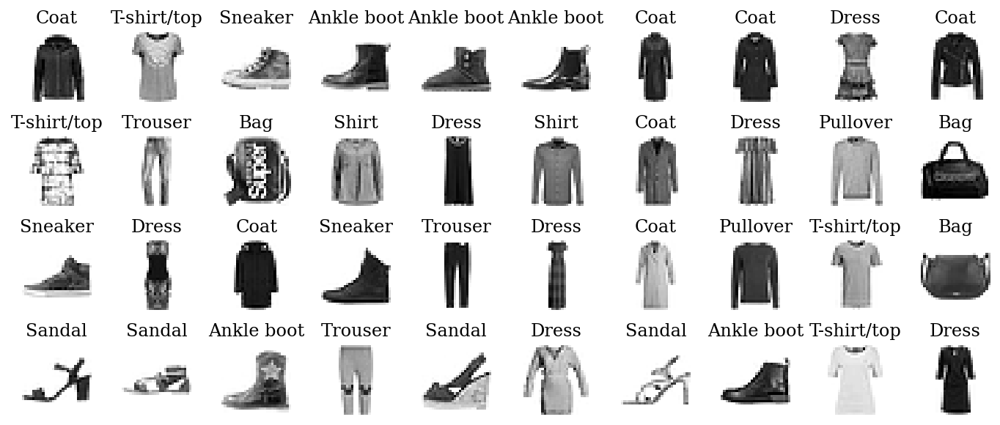

In [23]:
# Let's make a list of class names that we can refer to.
class_names = ["T-shirt/top", "Trouser", "Pullover", "Dress", "Coat",
               "Sandal", "Shirt", "Sneaker", "Bag", "Ankle boot"]

# Plot 4x10 array of images from the Fashion MNIST database
n_rows = 4
n_cols = 10
plt.figure(figsize=(n_cols * 1.2, n_rows * 1.2))
for row in range(n_rows):
    for col in range(n_cols):
        index = n_cols * row + col
        plt.subplot(n_rows, n_cols, index + 1)
        plt.imshow(X_train[index], cmap="binary", interpolation="nearest", origin='upper')
        plt.axis('off')
        plt.title(class_names[y_train[index]], fontsize=12)
plt.subplots_adjust(wspace=0.2, hspace=0.5)
plt.show()

We'll use `tensorflow` on this data set, through it's handy API `keras`. Since these are images and we want to preserve contextual information like edges, we'll build a CNN.

In [24]:
import tensorflow as tf

keras.backend.clear_session() # Make sure that we are starting a new model and not adding to an earlier one
np.random.seed(42) # Set the numpy and tensorflow random seeds so that we all get the same answer
tf.random.set_seed(42)

Normalize and prepare the data to pass into a network.

In [25]:
(X_train_full, y_train_full), (X_test, y_test) = keras.datasets.fashion_mnist.load_data()
X_train, X_valid = X_train_full[:-5000], X_train_full[-5000:]
y_train, y_valid = y_train_full[:-5000], y_train_full[-5000:]

X_mean = X_train.mean(axis=0, keepdims=True)
X_std = X_train.std(axis=0, keepdims=True) + 1e-7
X_train = (X_train - X_mean) / X_std
X_valid = (X_valid - X_mean) / X_std
X_test = (X_test - X_mean) / X_std


# Need to reshape for CNN
X_train = X_train[:, :, :, np.newaxis]
X_valid = X_valid[:,  :, :, np.newaxis]
X_test = X_test[:, :, :, np.newaxis]

print(len(X_train))
print(X_train.shape)
print(X_valid.shape)
print(X_test.shape)

55000
(55000, 28, 28, 1)
(5000, 28, 28, 1)
(10000, 28, 28, 1)


The next cell looks like a lot, but really it is just a sequential declaration of different types of layer in the network. It is a combination of **2D Convolution layers** (feature finding), **Max Pooling layers** (data reduction), folloed by some **Dense layers** (fully-connected layers at the end of the network for classification) and some **Dropout** incorporated to strengthen the overall network and make sure all the neurons are actually pulling their weight.

In [26]:
model = keras.models.Sequential([
    keras.layers.InputLayer(input_shape=[28, 28, 1]),
    keras.layers.Conv2D(filters=64, kernel_size=7, activation='relu', padding='same'),
    keras.layers.MaxPooling2D(pool_size=2),
    keras.layers.Conv2D(128, 3, activation='relu', padding='same'),
    keras.layers.Conv2D(128, 3, activation='relu', padding='same'),  
    keras.layers.MaxPooling2D(pool_size=2),
    keras.layers.Conv2D(256, 3, activation='relu', padding='same'),
    keras.layers.Conv2D(256, 3, activation='relu', padding='same'),
    keras.layers.MaxPooling2D(pool_size=2),
    keras.layers.Flatten(),
    keras.layers.Dense(units=128, activation='relu'),
    keras.layers.Dropout(0.5),
    keras.layers.Dense(units=64, activation='relu'),
    keras.layers.Dropout(0.5),
    keras.layers.Dense(units=10, activation='softmax'),
])   

In [27]:
print(model.summary())

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 28, 28, 64)        3200      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 14, 14, 64)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 14, 14, 128)       73856     
                                                                 
 conv2d_2 (Conv2D)           (None, 14, 14, 128)       147584    
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 7, 7, 128)        0         
 2D)                                                             
                                                                 
 conv2d_3 (Conv2D)           (None, 7, 7, 256)         2

**That's right...your CNN has ~1.5 million parameters that you are going to try to optimize on your machine...**

We'll only go through one epoch of optimization, but hopefully that will be enough to get us above $50\%$ accuracy.

In [28]:
#### This may take a while! Hopefully no more than 5 minutes for 1 epoch.
model.compile(loss="sparse_categorical_crossentropy", optimizer="nadam", metrics=["accuracy"])
clf = model.fit(X_train, y_train, epochs=1, validation_data=(X_valid, y_valid))

1719/1719 [==============================] - 275s 157ms/step - loss: 0.6925 - accuracy: 0.7585 - val_loss: 0.3788 - val_accuracy: 0.8670


In [29]:
# Evaluate the test set
model.evaluate(X_test, y_test)

313/313 [==============================] - 10s 33ms/step - loss: 0.3915 - accuracy: 0.8608


[0.39145106077194214, 0.86080002784729]

Predict values for first 3 test objects

In [37]:
X_new = X_test[:3]
y_proba = model.predict(X_new).round(2)
print(y_proba)

1/1 [==============================] - 0s 33ms/step
[[0.   0.   0.   0.   0.   0.   0.   0.   0.   1.  ]
 [0.   0.   0.99 0.   0.   0.   0.01 0.   0.   0.  ]
 [0.   1.   0.   0.   0.   0.   0.   0.   0.   0.  ]]


So, you can see that the output is a probability that the object belongs to each class (which has to sum to 1 across all the classes).  If we just want an "answer", we assign it to the class with the highest probability (done here with `predict_classes`).

In [38]:
y_pred = np.argmax(model.predict(X_new), axis=-1) #New way
print(y_pred)
print(np.array(class_names)[y_pred])

1/1 [==============================] - 0s 28ms/step
[9 2 1]
['Ankle boot' 'Pullover' 'Trouser']


Let's plot those and see if the predictions make sense.

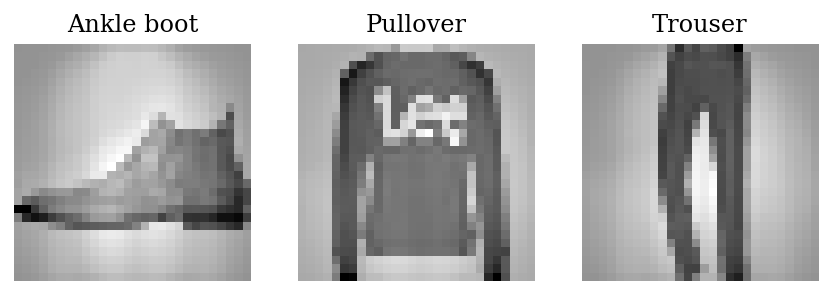

In [39]:
plt.figure(figsize=(7.2, 2.4))
for index, image in enumerate(X_new):
    plt.subplot(1, 3, index + 1)
    plt.imshow(image, cmap="binary", interpolation="nearest", origin='upper')
    plt.axis('off')
    plt.title(class_names[y_test[index]], fontsize=12)
plt.subplots_adjust(wspace=0.2, hspace=0.5)
plt.show()

Note that after you fit your model, you can save it and reload it at some later time (which is good because some models might take hours or days to train!)

In [40]:
# Save model
model.save("my_keras_model.h5")

# Reload model
model = keras.models.load_model("my_keras_model.h5")

Let's predict the values for 10 random objects. Display them with their actual labels first, then predict and display the predictions.

In [41]:
idx10 = np.random.choice(np.arange(len(y_test)), size=10, replace=False)
X_new = X_test[idx10]
y_pred = np.argmax(model.predict(X_new), axis=-1)

1/1 [==============================] - 0s 124ms/step


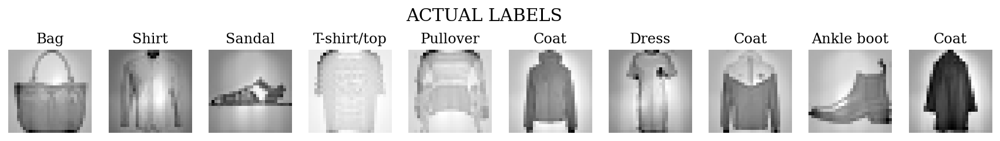

In [42]:
#Correct answers (y_test)
plt.figure(figsize=(15, 5))
for index, image in enumerate(X_new):
    plt.subplot(1, 10, index + 1)
    plt.imshow(image, cmap="binary", interpolation="nearest", origin='upper')
    plt.axis('off')
    plt.title(class_names[y_test[idx10[index]]], fontsize=12)
plt.subplots_adjust(wspace=0.2, hspace=0.5)
plt.suptitle('ACTUAL LABELS',y=0.7,fontsize=15)
plt.show()

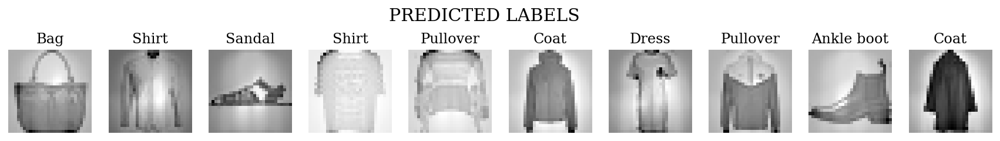

In [43]:
#Predicted answers (y_pred)
plt.figure(figsize=(15, 5))
for index, image in enumerate(X_new):
    plt.subplot(1, 10, index + 1)
    plt.imshow(image, cmap="binary", interpolation="nearest", origin='upper')
    plt.axis('off')
    plt.title(class_names[y_pred[index]], fontsize=12)
plt.subplots_adjust(wspace=0.2, hspace=0.5)
plt.suptitle('PREDICTED LABELS',y=0.7,fontsize=15)
plt.show()

Not too shabby!

## Autoencoders <a class="anchor" id="three"></a>

**Autoencoders are neural networks that copy their input to their output, but after passing the data through a compression bottleneck**. For example if there are 28x28 = 784 inputs, there will also be 784 outputs, but there will be one or more (odd, but symmetric) hidden layers with fewer neuron than that.

***Therefore the encoder layers learn a compressed representation of the data, with the decoder layers transforming the encodings back to the full data dimensionality.*** 

For example see 

![autoencoder structure](https://miro.medium.com/max/1400/1*44eDEuZBEsmG_TCAKRI3Kw@2x.png)

from
https://towardsdatascience.com/applied-deep-learning-part-3-autoencoders-1c083af4d798

You can think of this as doing **PCA with a neural network** -- breaking our data down into the only the most important features that we actually *need* (finding the intrinsic dimensionality). In fact, if the network uses only linear (or no) activation functions and $L2$ cost function, then we have exactly PCA.  

How might this be useful?  Well, for example we can use it to reconstruct MNIST digits that have had noise added to them:

![autoencoder example](https://miro.medium.com/max/1400/1*SxwRp9i23OM0Up4sEze1QQ@2x.png)

More exciting possibilities are: 

- Using autoencoders for "**unsupervised pretraining**". For example you have data that is only partially labeled (at least not enough to do traditional supervised classification).  We can train an autoencoder on the full data set, then used the encoder part as the base of a regular neural network that is trained on the labeled data that we do have. This is found to be a much more efficient way of initializing weights and biases than starting from random, because you are "cheating" a bit by already figuring out some of the data structure using the autoencoder. See Geron Figure 17.6.
- **[Anomaly detection](https://scikit-learn.org/stable/modules/outlier_detection.html)** (remember the old problem of figuring out if two samples are extracted from the same distribution?) e.g. https://towardsdatascience.com/anomaly-detection-with-autoencoder-b4cdce4866a6 and https://towardsdatascience.com/anomaly-detection-using-autoencoders-5b032178a1ea. See also
https://www.pyimagesearch.com/2020/03/02/anomaly-detection-with-keras-tensorflow-and-deep-learning/ and 
https://towardsdatascience.com/autoencoder-neural-network-for-anomaly-detection-with-unlabeled-dataset-af9051a048.

### Variational Autoencoders

More common in astronomy are **variational autoencoders**, partly because the "latent space" (i.e. the compressed representation of the data) that results from a standard autoencoder doesn't necessarily map continuously to the data (e.g., if your training data don't represent the possibilities or span of the full data space). 

We won't go into detail, just realize that these are something that you might try if you were otherwise going to try an autoencoder to tackle your problem. **Instead of the encoder layers compressing the data down to a single point in the "latent space", it is mapped to a continuous distribution** (imagine if PCA gave you a probabilistic compression). The prior on this continuous distribution is a Gaussian with mean and variance. ***Therefore the intuition for variational autoencoders is that the mean vector centers the average encoding of the data point, while the variance samples around this average encoding.*** This allows the encoding and decoding to interpolate much more smoothly across the training data. 

![Ivezic Figure 9.21](https://www.astroml.org/_images/fig_vae_1.png)


This one below is an example of a variational autoencoder trained on SDSS spectra using `pytorch`.

I won't cover this in class because there won't be time, but I'll leave it here for you as a further worked out example


In [49]:
from astroML.datasets import sdss_corrected_spectra
from astroML.plotting import setup_text_plots
setup_text_plots(fontsize=8, usetex=False)

# Fetch and prepare the data
data = sdss_corrected_spectra.fetch_sdss_corrected_spectra()
spectra = sdss_corrected_spectra.reconstruct_spectra(data)
wavelengths = sdss_corrected_spectra.compute_wavelengths(data)

# normalize spectra by integrated flux and subtract out mean, for easier training
spectranorms = np.mean(spectra, axis=1)
normedspectra = spectra / spectranorms[:, None]
meanspectrum = np.mean(normedspectra, axis=0)
normedspectra -= meanspectrum[None, :]

# split data into 3:1 train:test
torch.manual_seed(802)  # seed used for book figure
dataset = torchdata.TensorDataset(torch.tensor(normedspectra))
trainnum = normedspectra.shape[0] // 4 * 3
traindata, testdata = torchdata.random_split(dataset, 
                                             [trainnum, normedspectra.shape[0] - trainnum])
traindataloader = torchdata.DataLoader(traindata, batch_size=128, shuffle=True)

Now define the structure of the variational autoencoder. 
- In the top block you can see that the first layer reduces the $1000$-D input down to $250$.
- We then pass to a $2$D mean and variance layer from which the compressed "latent" parameters can be probabilistically drawn. This means that we compressing down from a 1000 flux channels to a 2D compressed representation.
- The decoding layers decompress the sampled latent parameters and scale back up to the full 1000 flux channel dimensions.

In [50]:
# define structure of variation autoencoder
class VAE(nn.Module):
    def __init__(self, nhidden=250):
        super(VAE, self).__init__()

        # encoding layers
        self.encode_fc = nn.Linear(1000, nhidden)
        self.mu        = nn.Linear(nhidden, 2)
        self.logvar    = nn.Linear(nhidden, 2)

        # decoding layers
        self.decode_fc = nn.Linear(2, nhidden)
        self.output    = nn.Linear(nhidden, 1000)

    def encode(self, x):
        h = F.relu(self.encode_fc(x))
        return self.mu(h), self.logvar(h)

    def reparameterize(self, mu, logvar):
        std = torch.exp(0.5*logvar)
        eps = torch.randn_like(std)
        return eps.mul(std).add_(mu)

    def decode(self, z):
        h = F.relu(self.decode_fc(z))
        return self.output(h)

    def forward(self, x):
        mu, logvar = self.encode(x)
        z = self.reparameterize(mu, logvar)
        return self.decode(z), mu, logvar

The loss is a modified version of the usual MSE, where we use the **Kullback-Leibler divergence** to asses how close the latent parameter distribution is to a Gaussian. 

In [51]:
# add KL divergence to loss function
def VAEloss(criterion, recon_x, x, mu, logvar):
    return criterion(recon_x, x) - 0.5 * torch.sum(1 + logvar - 
                                                   mu.pow(2) - 
                                                   logvar.exp())

Another large block that is essentially just training the network.

In [52]:
def train_model():
    model = VAE()
    criterion = torch.nn.MSELoss(reduction='sum')
    optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, 
                                                           verbose=True, 
                                                           patience=5, 
                                                           threshold=1e-3)

    min_valid_loss = float('inf')
    badepochs = 0
    for t in range(1000):
        train_loss = 0
        for i, databatch in enumerate(traindataloader, 0):
            specbatch = databatch[0]
            optimizer.zero_grad()
            recon, mu, logvar = model(specbatch)
            loss = VAEloss(criterion, recon, 
                           specbatch, mu, logvar)
            loss.backward()
            optimizer.step()
            train_loss += loss.item()

        with torch.no_grad():
            testspec = testdata[:][0]
            recon, mu, logvar = model(testspec)
            valid_loss = VAEloss(criterion, recon, 
                                 testspec, mu, logvar)
            if t % 10 == 0:
                print('Epoch %3i: train loss %6.1f validation loss %6.1f' % \
                        (t, train_loss / len(traindata), valid_loss / len(testdata)))
            # stop training if validation loss has not fallen in 10 epochs
            if valid_loss > min_valid_loss*(1-1e-3):
                badepochs += 1
            else:
                min_valid_loss = valid_loss
                badepochs = 0
            if badepochs == 10:
                print('Finished training')
                break
        scheduler.step(valid_loss)
    return model

In [53]:
print(model)

Let's train this thing! (Takes less than a minute)

In [54]:
model = train_model()

Epoch   0: train loss 2276.2 validation loss 1259.7
Epoch  10: train loss  423.4 validation loss  405.2
Epoch  20: train loss  233.2 validation loss  309.6
Epoch  30: train loss  181.3 validation loss  281.8
Epoch  40: train loss  149.2 validation loss  265.0
Epoch  50: train loss  125.7 validation loss  255.4
Epoch  60: train loss  111.5 validation loss  240.3
Epoch  70: train loss  100.4 validation loss  233.0
Epoch 00075: reducing learning rate of group 0 to 1.0000e-05.
Epoch  80: train loss   95.5 validation loss  228.0
Epoch 00088: reducing learning rate of group 0 to 1.0000e-06.
Epoch  90: train loss   94.4 validation loss  227.6
Finished training


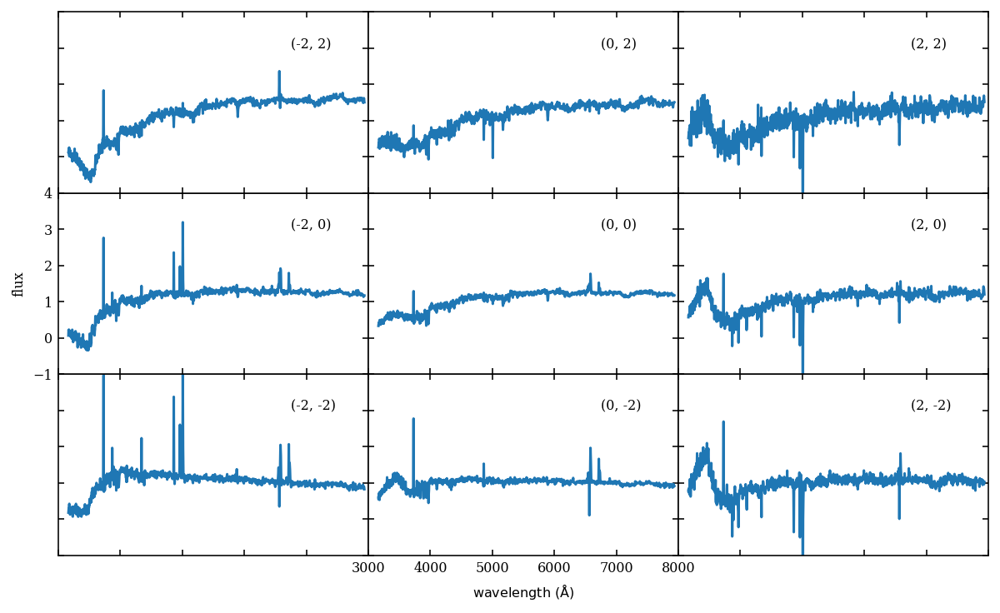

In [55]:
# plot results
with torch.no_grad():
    # sort latent parameters from most constrained to least constrained
    testspec = dataset[:][0]
    recon, mu, logvar = model(testspec)
    zorder = np.argsort(np.mean(logvar.numpy(), axis=0))

    fig = plt.figure(figsize=(10, 6))
    fig.subplots_adjust(hspace=0, wspace=0)
    parvalues = [-2.,0.,2.]
    for i, z1 in enumerate(parvalues):
        for j, z2 in enumerate(parvalues):
            # get z1 to vary left to right, z2 bottom to top
            ax = fig.add_subplot(3, 3, (2-j)*len(parvalues)+i+1)

            z = np.zeros((1,2), dtype=np.float32)
            z[0, zorder] = z1, z2 # set z1 is more constrained of the two latent parameters
            spectrum = model.decode(torch.tensor(z))
            ax.plot(wavelengths, meanspectrum+spectrum.numpy()[0,:])
            ax.text(6750, 3, '(%i, %i)' % (z1,z2))

            ax.set_xlim(3000, 8000)
            ax.set_ylim(-1, 4)

            if i == 0 and j == 1:
                ax.set_ylabel('flux')
            else:
                ax.yaxis.set_major_formatter(plt.NullFormatter())
            if j == 0 and i == 1:
                ax.set_xlabel(r'${\rm wavelength\ (\AA)}$')
            else:
                ax.xaxis.set_major_formatter(plt.NullFormatter())
plt.show()

The spectra above are generated from our variational autoencoder. As mentioned, the encoder was limited to two components (2D compressed latent space). As neurons are progressively activated in the latent space, we generate a smooth transition from spectra consistent with quiscent to star-forming galaxies. The numbers in each panel indicate the activation value of the two neurons in the latent space.

## Generative Adversarial Networks (GANs) <a class="anchor" id="four"></a>

Finally here's a brief discussion on GANs, which are one of latest innovation in deep learning.

GANs are pure evil, see https://www.unrealperson.com/.

But they are also brilliant, incredibly useful, and relatively new ([Goodfellow et al 2014](https://papers.nips.cc/paper/5423-generative-adversarial-nets.pdf)). The idea builds logically on autoencoders.
1. We have a generator (like the decoder part of an autoencoder) that can produce fake data (e.g., an image). 
2. Then we have a discriminator (a standard binary classifier) that tries to distinguish fake data from real.  
3. Then the generator learns to produce more and more accurate images to trick the discriminator -- without ever seeing any real images -- it just has the feedback from the discriminator.
4. We are pitting artifical neural networks against themselves to make them stronger. What could possibly go wrong, right?

![](https://learning.oreilly.com/library/view/java-deep-learning/9781788997454/assets/2cf8b4f1-7163-4af1-aa4b-6066329d554a.png)

For more, see
https://towardsdatascience.com/understanding-generative-adversarial-networks-gans-cd6e4651a29

Astronomy has seen some interesting uses of autoencoders and GANs in recent years.  For example:
    
- https://arxiv.org/abs/1702.00403    
- https://www.aanda.org/articles/aa/full_html/2017/07/aa30240-16/aa30240-16.html

More generally, these are some applications of deep networks to GW detection (my main interest):

- https://arxiv.org/pdf/1711.03121.pdf
- https://arxiv.org/pdf/1812.02183.pdf

I'm afraid that is all the time we can spend on deep learning. One of the coolest thing I didn't have time to talk about are the so-called **Masked Autoregressive Flows**, introduced by [Papamakarios et al (2017)](https://arxiv.org/abs/1705.07057). MAF are the latest answer to the long-standing problem of density estimation (remember how tricky it can be to choose the number of bins? Now tackle that problem with the full power of deep learning!). In my research field: [Wong et al 2020](https://arxiv.org/abs/2002.09491)

I'm not saying that you are ready for a data science job after these two lectures, but you now know more than the majority of astrophysicists that talk about neural networks, and you have used the two big codes. There are tons of useful videos, tutorials, and online courses that can take you further if you are interested in deep learning.

Another tool you may be interested in: https://astronn.readthedocs.io/en/latest/index.html

## Time to get your hands dirty. Galaxies vs quasars with neural networks.

Let's go back to our galaxy vs quasar data we've used in a previous exercise. 

1. Read in SDSS galaxy color data from `solutions/galaxyquasar.csv`. Create arrays for the $(u-g)$, $(g-r)$, $(r-i)$, and $(i-z)$ colors. Also create an array with the class labels where galaxy=$0$ and quasar=$1$. 

2. Now we're going to fit a neural network classifier. First, scale your data appropriately and do a 30% train/test split.

3. Now train the classifier. Use one the package among those we've seen. These include Tensorflow via keras, pytorch, and the [multilayer perceptron classifier](sklearn.neural_network.MLPClassifier) implemented in scikit-learn. My solution uses the latter, but this is an opportunity to pick the one you're most interested in learning. 

3. Start from a network architecture with a single hidden layer with 5 neurons, using the `adam` solver, the `relu` activation function, and a learninig rate of `0.001`. Plot the resulting ROC curve. 

4. Now let's optimize the hyperparameters of your network. Explore different hyperparameters and see what fits the data best.  Do your best now to optimize the network architecture. Be creative!

5. Is your best result comparable with the simpler classifiers we've seen before? Do we need deep learning here? If yes, which features are captured best?


A few tips:

- In scikit-learn, remember that you can utilize all availables cores on your machine with `n_jobs=-1`. Print out the classification score for the training data, and the best parameters obtained by the cross validation.
- If it takes too long, run the hyperparameter optimization on a subset of the training set. Then retrain the full network using the best hyperparameters only.
- On cross validation, for scikit learn we've seen how to use `GridSearchCV` already. For Tensorflow, there's a really cool tool called [Tensorboard](https://www.tensorflow.org/tensorboard)

[My solution](https://github.com/dgerosa/astrostatistics_bicocca_2024/blob/main/solutions/S20_galaxyquasar2.ipynb)

----

# That's all folks!

![](https://imgs.xkcd.com/comics/data_trap.png)

Credit: [xkcd 2582](https://xkcd.com/2582/)

## Extra material

The repository has two additional lectures on time series data which, unfortunately, I didn't have time to cover. 

## Feedback!

Please remember my feedback form

https://forms.gle/2xPGGx3WgJHCYtnf9

## Many ideas for Master's thesis projects with me and the rest of my research group

Here we are: https://davidegerosa.com/group/

Here are the amazing folks I'm working with. Come and have a chat, we are always looking for new friends!

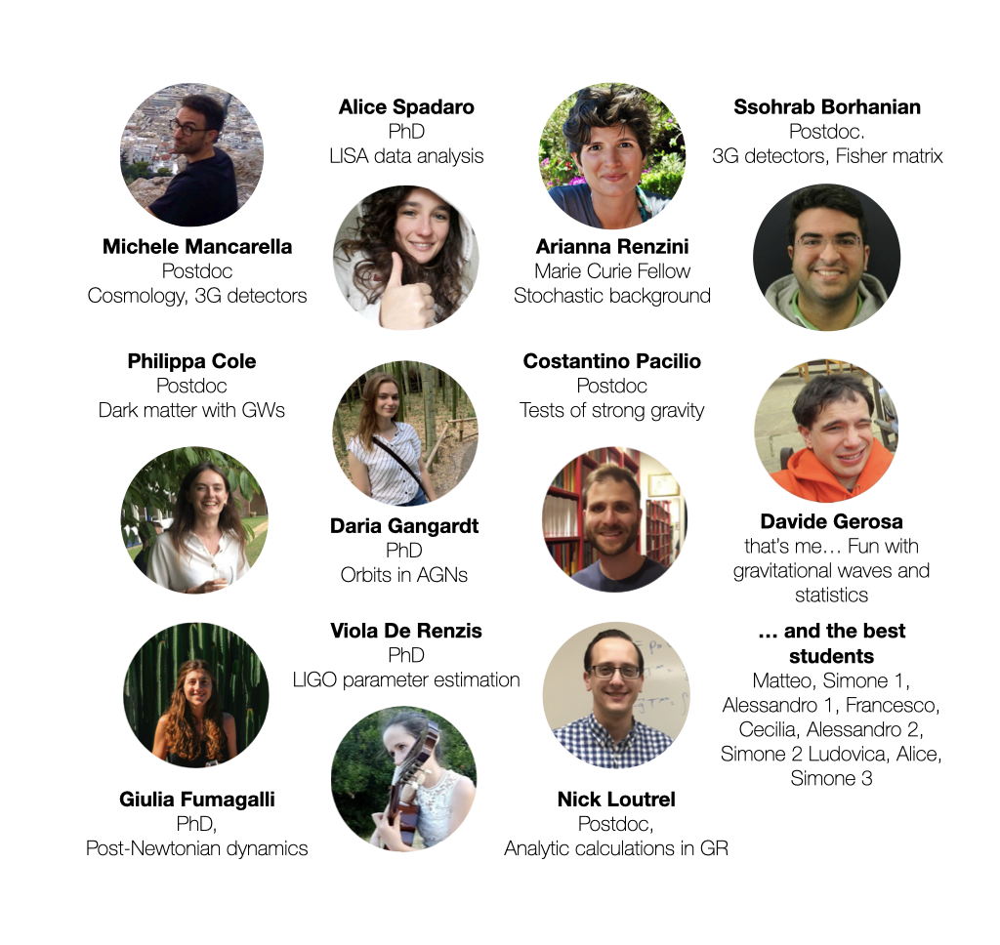